In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rc_context
import seaborn as sns
from tqdm import tqdm

import scanpy as sc

import os

# Load data

In [2]:
# Load clustering results
clustering = pd.read_csv(r'.\results\coclustering_df.csv', index_col=0)

In [3]:
# Load dot locations
dots = pd.read_csv(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\detected_dots\hydrogel_df.csv', index_col=0)

# Find cell positions, and combined into dataframe

## Position of cell in fov

In [4]:
cell_positions = dots.groupby('cellID').mean()

In [5]:
# cell_positions['z'] = cell_positions['z'] * 0.3

In [6]:
row = []
col = []
z = []
for item in clustering['cell_id'].tolist():
    row.append(cell_positions.loc[item]['row'])
    col.append(cell_positions.loc[item]['col'])
    z.append(cell_positions.loc[item]['z'])
    
clustering.insert(loc=clustering.shape[1], column='row', value=row)
clustering.insert(loc=clustering.shape[1], column='col', value=col)
clustering.insert(loc=clustering.shape[1], column='z', value=z)

## center positions of each fov

In [7]:
# fov_center = pd.read_csv(r'..\fov_pos.csv', index_col=0)

In [8]:
# fov_x_l = []
# fov_y_l = []
# for_z_l = []
# for item in tqdm(clustering['fov'].tolist()):
#     idx = fov_center['fov'].tolist().index(item)
#     fov_x_l.append(fov_center.loc[idx]['x'])
#     fov_y_l.append(fov_center.loc[idx]['y'])
#     for_z_l.append(fov_center.loc[idx]['z'])

In [9]:
# clustering['row'] = clustering['row'] * (249.6/2304) + fov_y_l
# clustering['col'] = clustering['col'] * (249.6/2304) + fov_x_l
# clustering['z'] = clustering['z'] * (2304/249.6) + for_z_l

# Distance between cells

In [10]:
from scipy.spatial.distance import pdist, squareform

In [11]:
fov_l = []
for item in clustering['cell_id'].tolist():
    temp = item.split('_')
    fov_l.append(temp[0]+'_'+temp[1])
clustering.insert(loc=clustering.shape[1], column='fov', value=fov_l)

In [12]:
clustering['row'] = clustering['row'] * (249.6/2304)
clustering['col'] = clustering['col'] * (249.6/2304)
clustering['z'] = clustering['z'] * 0.3

In [13]:
# well_l = []
# for item in tqdm(clustering['fov'].tolist()):
#     idx = fov_center['fov'].tolist().index(item)
#     well_l.append(fov_center.loc[idx]['well'])
# clustering.insert(loc=clustering.shape[1], column='well', value=well_l)

In [14]:
distances = pdist(clustering.values[:,7:10].astype(float), metric='euclidean')
dist_mt = squareform(distances)

In [15]:
clustering

,cell_id,tsne_x,tsne_y,count_cluster,corr_cluster,variability_cluster,embedding_cluster,row,col,z,fov
0,bm_001_01,8.868031,-3.315093,5,0,0,6,20.035635,57.409649,4.225214,bm_001
1,bm_001_02,8.882203,-3.187938,5,0,2,2,31.243614,9.958765,3.353119,bm_001
2,bm_001_03,14.334660,24.242184,0,5,2,4,92.328458,22.663978,3.173320,bm_001
3,bm_001_04,13.764641,14.325944,0,0,2,4,152.689342,157.185698,3.171798,bm_001
4,bm_001_05,17.643368,23.257067,0,1,2,4,187.094618,127.339359,2.588213,bm_001
...,...,...,...,...,...,...,...,...,...,...,...
548,uc_047_01,-27.891300,-7.664570,3,0,1,0,37.226841,142.987894,2.909622,uc_047
549,uc_047_02,-25.876694,-4.180927,3,0,1,0,27.037536,186.450017,2.815035,uc_047
550,uc_047_03,-25.171670,-6.899519,3,4,1,0,122.226043,145.570720,2.665610,uc_047
551,uc_047_04,-9.660682,-10.071799,3,4,1,0,123.253815,59.046940,2.508213,uc_047


<AxesSubplot:>

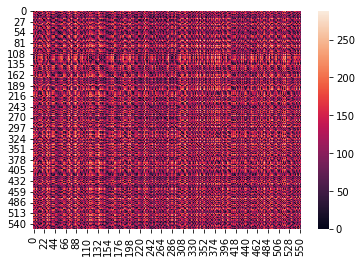

In [16]:
sns.heatmap(dist_mt)

## Count clusters

In [17]:
cluster_by_count = clustering.groupby('count_cluster')

In [18]:
distance_df = pd.DataFrame(dist_mt, index=clustering['cell_id'].tolist(), columns=clustering['cell_id'].tolist())

In [19]:
distance_df

,bm_001_01,bm_001_02,bm_001_03,bm_001_04,bm_001_05,bm_002_01,bm_002_02,bm_002_03,bm_002_04,bm_002_05,...,uc_046_02,uc_046_04,uc_046_12,uc_046_13,uc_046_14,uc_047_01,uc_047_02,uc_047_03,uc_047_04,uc_047_05
bm_001_01,0.000000,48.764390,80.216085,165.992095,181.111975,104.809801,6.694211,114.802231,129.473915,93.303241,...,132.030363,57.217316,132.009205,179.227242,146.254953,87.297791,129.237888,134.972909,103.245442,161.201392
bm_001_02,48.764390,0.000000,62.392411,190.853000,195.111056,150.614681,42.135920,154.140327,133.684201,84.446539,...,178.661314,50.917184,151.546438,208.968024,147.963085,133.164353,176.542183,163.306085,104.289212,161.158899
bm_001_03,80.216085,62.392411,0.000000,147.443309,141.201638,147.327978,76.424628,135.481576,76.262902,23.952990,...,175.535903,23.982876,105.691307,170.315753,88.316547,132.340857,176.320445,126.491860,47.754999,100.361137
bm_001_04,165.992095,190.853000,147.443309,0.000000,45.550714,112.885634,168.980222,75.983546,82.929210,126.974983,...,121.790418,143.009322,41.798762,27.430247,86.110883,116.332435,129.015131,32.606388,102.460268,91.405586
bm_001_05,181.111975,195.111056,141.201638,45.550714,0.000000,150.899460,182.552130,114.367482,65.606870,117.906456,...,163.946544,144.338398,50.785939,69.465490,59.348106,150.682880,170.623535,67.381900,93.485341,57.508541
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
uc_047_01,87.297791,133.164353,132.340857,116.332435,150.682880,17.546883,93.445384,41.973620,130.634055,129.039250,...,45.645235,111.273796,102.856931,117.095370,146.631709,0.000000,44.640643,85.038785,120.195196,160.909554
uc_047_02,129.237888,176.542183,176.320445,129.015131,170.623535,29.103038,135.663544,57.620447,165.190861,171.294987,...,8.257244,155.739828,129.401378,119.893452,179.654575,44.640643,0.000000,103.595324,159.653407,192.710221
uc_047_03,134.972909,163.306085,126.491860,32.606388,67.381900,83.693658,138.363812,46.993293,75.856533,108.947380,...,97.239162,118.057562,30.975455,45.670768,85.345848,85.038785,103.595324,0.000000,86.530027,95.420655
uc_047_04,103.245442,104.289212,47.754999,102.460268,93.485341,131.207002,102.266611,108.669727,29.438107,25.202882,...,156.731357,53.780161,60.951312,127.170655,44.252507,120.195196,159.653407,86.530027,0.000000,58.542860


In [21]:
cell_pairs = []
cluster_pairs = []
distance = []
for i in range(clustering.shape[0]):
    for j in range(clustering.shape[0]):
        cell1 = clustering.iloc[i]['cell_id']
        cell2 = clustering.iloc[j]['cell_id']
        fov1 = clustering.iloc[i]['fov']
        fov2 = clustering.iloc[j]['fov']
        if fov1 == fov2 and ((cell1,cell2) not in cell_pairs) and ((cell2,cell1) not in cell_pairs):
            cluster1 = clustering.iloc[i]['count_cluster']
            cluster2 = clustering.iloc[j]['count_cluster']
            if cluster1 <= cluster2:
                cell_pairs.append((cell1,cell2))
                cluster_pairs.append(str(cluster1)+'_'+str(cluster2))
            else:
                cell_pairs.append((cell2,cell1))
                cluster_pairs.append(str(cluster2)+'_'+str(cluster1))
            distance.append(distance_df.loc[cell1,cell2])

In [22]:
cell_pairs = np.array(cell_pairs)
cluster_pairs = np.array(cluster_pairs)

In [23]:
# valid_pairs = []
# for i,item in enumerate(cell_pairs):
#     idx1 = clustering['cell_id'].tolist().index(item[0])
#     idx2 = clustering['cell_id'].tolist().index(item[1])
#     if clustering.iloc[idx1]['fov'] == clustering.iloc[idx2]['fov']:
#         valid_pairs.append(True)
#     else:
#         valid_pairs.append(False)

In [24]:
# assert(len(valid_pairs) == distances.shape[0])

In [25]:
distance_df = {'distance': distance,
               'cell_1': cell_pairs[:, 0],
               'cell_2': cell_pairs[:, 1],
               'cluster_pair': cluster_pairs}
distance_df = pd.DataFrame(distance_df)

In [26]:
mean_cluster_dist = distance_df.groupby('cluster_pair').mean()

In [27]:
cluster_distances = np.zeros((9,9))
for i in range(9):
    for j in range(9):
        if i <= j:
            if str(i)+'_'+str(j) in mean_cluster_dist.index:
                cluster_distances[i,j] = mean_cluster_dist.loc[str(i)+'_'+str(j)]['distance']
        else:
            cluster_distances[i,j] = cluster_distances[j,i]

In [28]:
cluster_distances = pd.DataFrame(cluster_distances, index=range(9), columns=range(9))

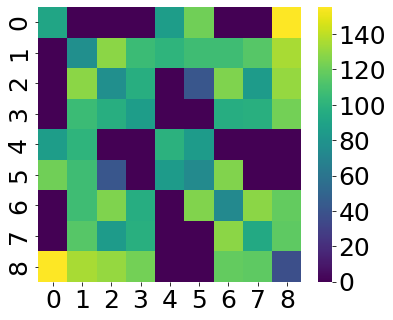

In [29]:
with rc_context({'figure.figsize': (6, 5),'font.size': 25}):
    sns.heatmap(cluster_distances, cmap='viridis')
    plt.tight_layout()
    # plt.savefig(r'.\figures\count_cluster_distances.png', dpi=300)

## patch correlation clusters

In [30]:
corr_pairs = []
var_pairs = []
embedding_pairs = []
for i in range(distance_df.shape[0]):
    cell1 = distance_df.iloc[i]['cell_1']
    cell2 = distance_df.iloc[i]['cell_2']
    idx1 = clustering['cell_id'].tolist().index(cell1)
    idx2 = clustering['cell_id'].tolist().index(cell2)
    corr_pairs.append(str(clustering.iloc[idx1]['corr_cluster'])+'_'+str(clustering.iloc[idx2]['corr_cluster']))
    var_pairs.append(str(clustering.iloc[idx1]['variability_cluster'])+'_'+str(clustering.iloc[idx2]['variability_cluster']))
    embedding_pairs.append(str(clustering.iloc[idx1]['embedding_cluster'])+'_'+str(clustering.iloc[idx2]['embedding_cluster']))

In [31]:
corr_pairs = np.array(corr_pairs)
var_pairs = np.array(var_pairs)
embedding_pairs = np.array(embedding_pairs)

distance_df.insert(loc=distance_df.shape[1], column='corr_cluster_pair', value=corr_pairs)
distance_df.insert(loc=distance_df.shape[1], column='variability_cluster_pair', value=var_pairs)
distance_df.insert(loc=distance_df.shape[1], column='embedding_cluster_pair', value=embedding_pairs)

In [32]:
mean_corr_dist = distance_df.groupby('corr_cluster_pair').mean()

In [33]:
cluster_distances = np.zeros((9,9))
for i in range(9):
    for j in range(9):
        if i <= j:
            if str(i)+'_'+str(j) in mean_corr_dist.index:
                cluster_distances[i,j] = mean_corr_dist.loc[str(i)+'_'+str(j)]['distance']
        else:
            cluster_distances[i,j] = cluster_distances[j,i]

In [34]:
cluster_distances = pd.DataFrame(cluster_distances, index=range(9), columns=range(9))

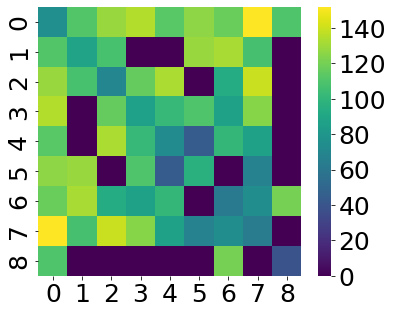

In [35]:
with rc_context({'figure.figsize': (6, 5),'font.size': 25}):
    sns.heatmap(cluster_distances, cmap='viridis')
    plt.tight_layout()
    # plt.savefig(r'.\figures\correlation_cluster_distances.png', dpi=300)

## variability distances

In [36]:
mean_var_dist = distance_df.groupby('variability_cluster_pair').mean()

In [37]:
cluster_distances = np.zeros((9,9))
for i in range(9):
    for j in range(9):
        if i <= j:
            if str(i)+'_'+str(j) in mean_var_dist.index:
                cluster_distances[i,j] = mean_var_dist.loc[str(i)+'_'+str(j)]['distance']
        else:
            cluster_distances[i,j] = cluster_distances[j,i]

cluster_distances = pd.DataFrame(cluster_distances, index=range(9), columns=range(9))

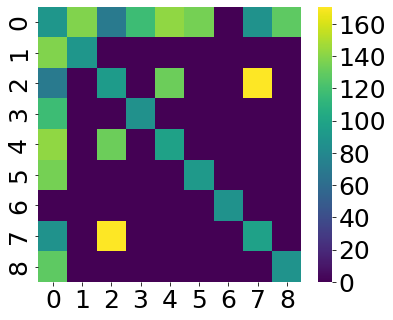

In [38]:
with rc_context({'figure.figsize': (6, 5),'font.size': 25}):
    sns.heatmap(cluster_distances, cmap='viridis')
    plt.tight_layout()
    # plt.savefig(r'.\figures\variability_cluster_distances.png', dpi=300)

## embedding distances

In [39]:
mean_embedding_dist = distance_df.groupby('embedding_cluster_pair').mean()

In [40]:
cluster_distances = np.zeros((7,7))
for i in range(7):
    for j in range(7):
        if i <= j:
            if str(i)+'_'+str(j) in mean_embedding_dist.index:
                cluster_distances[i,j] = mean_embedding_dist.loc[str(i)+'_'+str(j)]['distance']
        else:
            cluster_distances[i,j] = cluster_distances[j,i]

cluster_distances = pd.DataFrame(cluster_distances, index=range(7), columns=range(7))

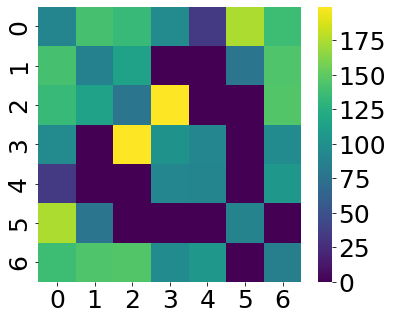

In [41]:
with rc_context({'figure.figsize': (6, 5),'font.size': 25}):
    sns.heatmap(cluster_distances, cmap='viridis')
    plt.tight_layout()
    # plt.savefig(r'.\figures\embedding_cluster_distances.png', dpi=300)

In [42]:
# distance_df.to_csv(r'.\results\cluster_distances.csv')

# Cross cluster distances

In [43]:
distance_df

,distance,cell_1,cell_2,cluster_pair,corr_cluster_pair,variability_cluster_pair,embedding_cluster_pair
0,0.000000,bm_001_01,bm_001_01,5_5,0_0,0_0,6_6
1,48.764390,bm_001_01,bm_001_02,5_5,0_0,0_2,6_2
2,80.216085,bm_001_03,bm_001_01,0_5,5_0,2_0,4_6
3,165.992095,bm_001_04,bm_001_01,0_5,0_0,2_0,4_6
4,181.111975,bm_001_05,bm_001_01,0_5,1_0,2_0,4_6
...,...,...,...,...,...,...,...
3640,86.530027,uc_047_03,uc_047_04,3_3,4_4,1_1,0_0
3641,95.420655,uc_047_03,uc_047_05,3_3,4_4,1_1,0_0
3642,0.000000,uc_047_04,uc_047_04,3_3,4_4,1_1,0_0
3643,58.542860,uc_047_04,uc_047_05,3_3,4_4,1_1,0_0


In [44]:
count_corr_pairs = []
corr_count_pairs = []
count_var_pairs = []
var_count_pairs = []
count_embedding_pairs = []
embedding_count_pairs = []
for i in tqdm(range(distance_df.shape[0])):
    cell1 = distance_df.iloc[i]['cell_1']
    cell2 = distance_df.iloc[i]['cell_2']
    idx1 = clustering['cell_id'].tolist().index(cell1)
    idx2 = clustering['cell_id'].tolist().index(cell2)
    count_corr_pairs.append(clustering.iloc[idx1]['count_cluster'].astype(str)+'_'+clustering.iloc[idx2]['corr_cluster'].astype(str))
    corr_count_pairs.append(clustering.iloc[idx2]['count_cluster'].astype(str)+'_'+clustering.iloc[idx1]['corr_cluster'].astype(str))
    
    count_var_pairs.append(clustering.iloc[idx1]['count_cluster'].astype(str)+'_'+clustering.iloc[idx2]['variability_cluster'].astype(str))
    var_count_pairs.append(clustering.iloc[idx2]['count_cluster'].astype(str)+'_'+clustering.iloc[idx1]['variability_cluster'].astype(str))
    
    count_embedding_pairs.append(clustering.iloc[idx1]['count_cluster'].astype(str)+'_'+clustering.iloc[idx2]['embedding_cluster'].astype(str))
    embedding_count_pairs.append(clustering.iloc[idx2]['count_cluster'].astype(str)+'_'+clustering.iloc[idx1]['embedding_cluster'].astype(str))

 23%|██▎       | 832/3645 [00:01<00:04, 688.04it/s]

100%|██████████| 3645/3645 [00:05<00:00, 722.84it/s]


In [45]:
intercluster_distances = {'distance': distance_df['distance'].tolist()+distance_df['distance'].tolist(),
                          'count_corr': count_corr_pairs+corr_count_pairs,
                          'count_var': count_var_pairs+var_count_pairs,
                          'count_embedding': count_embedding_pairs+embedding_count_pairs}
intercluster_distances = pd.DataFrame(intercluster_distances)

## count and correlation

In [159]:
mean_embedding_dist = intercluster_distances.groupby('count_corr').mean()

In [160]:
cluster_distances = np.zeros((9,9))
for i in range(9):
    for j in range(9):
        if str(i)+'_'+str(j) in mean_embedding_dist.index:
            cluster_distances[i,j] = mean_embedding_dist.loc[str(i)+'_'+str(j)]['distance']

cluster_distances = pd.DataFrame(cluster_distances, index=range(9), columns=range(9))

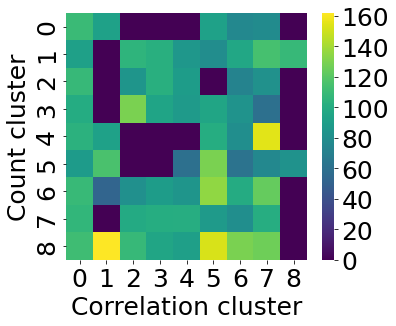

In [161]:
with rc_context({'figure.figsize': (6, 5),'font.size': 25}):
    sns.heatmap(cluster_distances, cmap='viridis')
    plt.xlabel('Correlation cluster', fontsize=25)
    plt.ylabel('Count cluster', fontsize=25)
    plt.tight_layout()
    plt.savefig(r'.\figures\count_correlation_cluster_distances.png', dpi=300)

## count and network variability

In [162]:
mean_embedding_dist = intercluster_distances.groupby('count_var').mean()

In [163]:
cluster_distances = np.zeros((9,9))
for i in range(9):
    for j in range(9):
        if str(i)+'_'+str(j) in mean_embedding_dist.index:
            cluster_distances[i,j] = mean_embedding_dist.loc[str(i)+'_'+str(j)]['distance']

cluster_distances = pd.DataFrame(cluster_distances, index=range(9), columns=range(9))

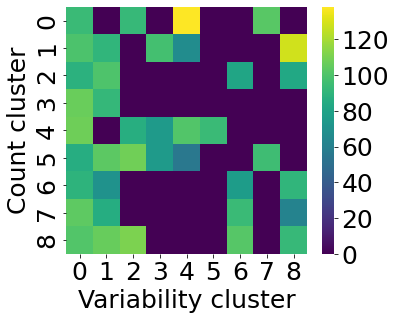

In [164]:
with rc_context({'figure.figsize': (6, 5),'font.size': 25}):
    sns.heatmap(cluster_distances, cmap='viridis')
    plt.xlabel('Variability cluster', fontsize=25)
    plt.ylabel('Count cluster', fontsize=25)
    plt.tight_layout()
    plt.savefig(r'.\figures\count_variability_cluster_distances.png', dpi=300)

## count and gae embedding

In [165]:
mean_embedding_dist = intercluster_distances.groupby('count_embedding').mean()

In [166]:
cluster_distances = np.zeros((9,7))
for i in range(9):
    for j in range(7):
        if str(i)+'_'+str(j) in mean_embedding_dist.index:
            cluster_distances[i,j] = mean_embedding_dist.loc[str(i)+'_'+str(j)]['distance']

cluster_distances = pd.DataFrame(cluster_distances, index=range(9), columns=range(7))

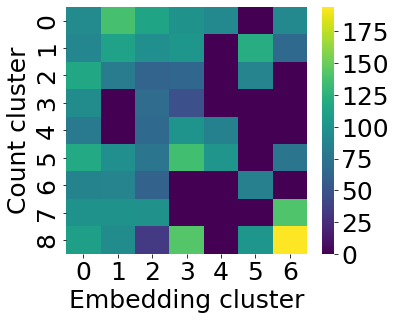

In [167]:
with rc_context({'figure.figsize': (6, 5),'font.size': 25}):
    sns.heatmap(cluster_distances, cmap='viridis')
    plt.xlabel('Embedding cluster', fontsize=25)
    plt.ylabel('Count cluster', fontsize=25)
    plt.tight_layout()
    plt.savefig(r'.\figures\count_embedding_cluster_distances.png', dpi=300)

In [168]:
intercluster_distances.to_csv(r'.\results\intercluster_distances.csv')

# Latent distance v. spatial distance correlation

## cosine similarity between data points

In [46]:
from sklearn.metrics.pairwise import cosine_similarity
from sklearn import linear_model
import scipy.stats as stats

In [47]:
count_adata = sc.read_h5ad(r'.\results\count_adata.h5ad')
count_colors = count_adata.uns['leiden_colors']

corr_adata = sc.read_h5ad(r'.\results\corr_adata.h5ad')
corr_colors = corr_adata.uns['leiden_colors']

var_adata = sc.read_h5ad(r'.\results\var_adata.h5ad')
var_colors = var_adata.uns['leiden_colors']

embedding_adata = sc.read_h5ad(r'.\results\embedding_adata.h5ad')
embedding_colors = embedding_adata.uns['leiden_colors']

In [48]:
count_cosine = cosine_similarity(count_adata.X)
count_cosine = pd.DataFrame(count_cosine,
                            index=count_adata.obs['cell_id'].tolist(),
                            columns=count_adata.obs['cell_id'].tolist())

In [49]:
similarity_l = np.zeros(distance_df.shape[0])
for i in range(distance_df.shape[0]):
    cell1 = distance_df.iloc[i]['cell_1']
    cell2 = distance_df.iloc[i]['cell_2']
    similarity_l[i] = count_cosine.loc[cell1,cell2]

distance_df.insert(loc=distance_df.shape[1], column='count_similarity', value=similarity_l)

In [50]:
distance_df

,distance,cell_1,cell_2,cluster_pair,corr_cluster_pair,variability_cluster_pair,embedding_cluster_pair,count_similarity
0,0.000000,bm_001_01,bm_001_01,5_5,0_0,0_0,6_6,1.000000
1,48.764390,bm_001_01,bm_001_02,5_5,0_0,0_2,6_2,0.915071
2,80.216085,bm_001_03,bm_001_01,0_5,5_0,2_0,4_6,0.504823
3,165.992095,bm_001_04,bm_001_01,0_5,0_0,2_0,4_6,0.380389
4,181.111975,bm_001_05,bm_001_01,0_5,1_0,2_0,4_6,0.366587
...,...,...,...,...,...,...,...,...
3640,86.530027,uc_047_03,uc_047_04,3_3,4_4,1_1,0_0,0.893173
3641,95.420655,uc_047_03,uc_047_05,3_3,4_4,1_1,0_0,0.930831
3642,0.000000,uc_047_04,uc_047_04,3_3,4_4,1_1,0_0,1.000000
3643,58.542860,uc_047_04,uc_047_05,3_3,4_4,1_1,0_0,0.882699


In [51]:
distance_df = distance_df[distance_df['cell_1']!=distance_df['cell_2']]

In [52]:
# distance_df.to_csv(r'.\results\count_cluster_distances.csv')

c:\Users\zfang38\Anaconda3\envs\skim\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


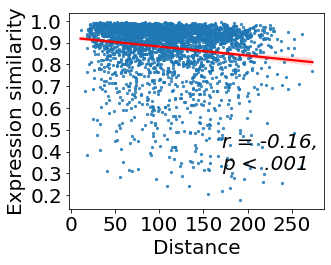

In [53]:
# labels = ['0','5','10','15','20','25','30']
with rc_context({'font.size':20}):
    fig,ax = plt.subplots(1,1,figsize=(5,4))
    r_score, p_value = stats.pearsonr(distance_df['distance'],distance_df['count_similarity'])
    pl = sns.regplot(distance_df['distance'], distance_df['count_similarity'], ax=ax, scatter_kws={'s': 5}, line_kws={'color': 'red'})
    pl.set(xlabel='Distance', ylabel='Expression similarity')
    pl.text(0.6, 0.2, f'r = {r_score:.2f}, \np < .001', fontstyle='italic', transform=ax.transAxes)

    plt.tight_layout()
    # plt.savefig(r'.\figures\expression cosine similarity to cell distance.png')

## eucledean distance between data points

In [54]:
from sklearn.metrics.pairwise import pairwise_distances


In [55]:
count_similarity = pairwise_distances(count_adata.X, metric='euclidean')
count_similarity = pd.DataFrame(count_similarity,
                            index=count_adata.obs['cell_id'].tolist(),
                            columns=count_adata.obs['cell_id'].tolist())

In [56]:
similarity_l = np.zeros(distance_df.shape[0])
for i in range(distance_df.shape[0]):
    cell1 = distance_df.iloc[i]['cell_1']
    cell2 = distance_df.iloc[i]['cell_2']
    similarity_l[i] = count_similarity.loc[cell1,cell2]

distance_df.insert(loc=distance_df.shape[1], column='count_euclidean_similarity', value=similarity_l)

In [57]:
distance_df = distance_df[distance_df['cell_1']!=distance_df['cell_2']]

c:\Users\zfang38\Anaconda3\envs\skim\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


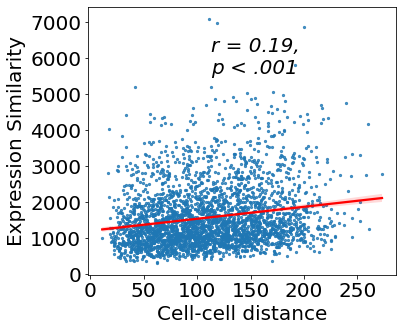

In [58]:
# labels = ['0','5','10','15','20','25','30']
with rc_context({'font.size':20}):
    fig,ax = plt.subplots(1,1,figsize=(6,5))
    r_score, p_value = stats.pearsonr(distance_df['distance'],distance_df['count_euclidean_similarity'])
    pl = sns.regplot(distance_df['distance'], distance_df['count_euclidean_similarity'], ax=ax, scatter_kws={'s': 5}, line_kws={'color':'red'})
    pl.set(xlabel='Cell-cell distance', ylabel='Expression Similarity')
    pl.text(0.4, 0.75, f'r = {r_score:.2f}, \np < .001', fontstyle='italic', transform=ax.transAxes)

    plt.tight_layout()
    # plt.savefig(r'.\figures\distance expression similarity regression.png')

# Cell types visualization

In [59]:
import tifffile
from skimage.filters import threshold_otsu
from skimage import io, color, measure
from skimage.segmentation import find_boundaries

c:\Users\zfang38\Anaconda3\envs\skim\lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


## Load cluster colors

In [60]:
import scanpy as sc

## count cluster similar cluster, shorter distance

In [61]:
scale = 249.6/2304
z_scale = 0.3/1

In [62]:
distance_df = pd.read_csv(r'.\results\cluster_distances.csv', index_col=0)

In [63]:
fov = []
for item in distance_df['cell_1'].tolist():
    fov.append(item.split('_')[0]+'_'+item.split('_')[1])
distance_df.insert(loc=distance_df.shape[1], column='fov', value=fov)

In [64]:
distance_df[distance_df['cell_2'] == 'bm_031_15']

,distance,cell_1,cell_2,cluster_pair,corr_cluster_pair,variability_cluster_pair,embedding_cluster_pair,fov
1578,141.845113,bm_031_01,bm_031_15,1_5,0_0,0_3,2_2,bm_031
1593,139.698263,bm_031_02,bm_031_15,1_5,0_0,3_3,0_2,bm_031
1607,142.042302,bm_031_03,bm_031_15,1_5,0_0,3_3,2_2,bm_031
1620,86.946915,bm_031_04,bm_031_15,1_5,6_0,3_3,2_2,bm_031
1632,104.611822,bm_031_05,bm_031_15,1_5,6_0,3_3,2_2,bm_031
1643,109.313007,bm_031_06,bm_031_15,5_5,0_0,3_3,2_2,bm_031
1653,60.191007,bm_031_07,bm_031_15,1_5,6_0,3_3,2_2,bm_031
1662,59.968887,bm_031_08,bm_031_15,4_5,6_0,3_3,2_2,bm_031
1670,88.561944,bm_031_09,bm_031_15,1_5,0_0,3_3,2_2,bm_031
1677,73.044890,bm_031_10,bm_031_15,5_5,0_0,3_3,2_2,bm_031


In [65]:
dots = pd.read_csv(r'..\..\20220211_MSC_hydrogel\00_analysis\detected_dots\hydrogel_df.csv',index_col=0)

In [66]:
fov = []
for item in dots['cellID'].tolist():
    fov.append(item.split('_')[0]+'_'+item.split('_')[1])

In [67]:
dots.insert(loc=dots.shape[1], column='fov', value=fov)

### uc 003 cluster 2, 7 near

In [299]:
cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']
uc_003_dist = distance_df[distance_df['cluster_pair']=='2_7']

clusters = {}
for item in cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = count_adata.obs['leiden'].tolist()[idx]

In [300]:
clusters

{'uc_003_01': '2',
 'uc_003_02': '7',
 'uc_003_03': '7',
 'uc_003_04': '7',
 'uc_003_05': '2'}

In [301]:
uc_003_dots = []
clustering = []
for item in cells:
    uc_003_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
uc_003_dots = pd.concat(uc_003_dots)

In [302]:
uc_003_dots.insert(loc=uc_003_dots.shape[1], column='clustering', value=clustering)

In [303]:
dots_by_cluster = uc_003_dots.groupby('clustering')

In [304]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\masks\003_mask.tif')
mask = (mask==1).astype('int') + (mask==2).astype('int') + (mask==3).astype('int') + (mask==4).astype('int') + (mask==5).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
outline_row = []
outline_col = []
for i in range(1,5):
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

In [305]:
distance_pairs = [('uc_003_01','uc_003_02'),('uc_003_01','uc_003_03'),('uc_003_01','uc_003_04')]

In [306]:
uc_003_centers = uc_003_dots.groupby('cellID').mean()

In [307]:
uc_003_centers.loc['uc_003_01']['row']

507.33590669626585

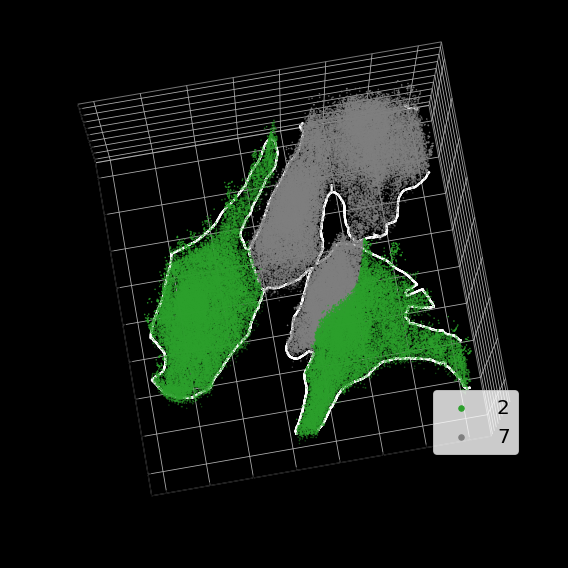

In [308]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='w')

for cluster in uc_003_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster)]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=0.3,color=color,label=cluster)

# for pair in distance_pairs:
#     ax.plot([uc_003_centers.loc[pair[0]]['row']*scale,uc_003_centers.loc[pair[1]]['row']*scale],
#             [uc_003_centers.loc[pair[0]]['col']*scale,uc_003_centers.loc[pair[1]]['col']*scale],
#             [(uc_003_centers.loc[pair[0]]['z']*z_scale)-25,(uc_003_centers.loc[pair[1]]['z']*z_scale)-25],
#             color='r',linewidth=5)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=10)

plt.tight_layout()

plt.savefig(r'.\figures\uc_003_count_cluster_dist.png',dpi=300)

#### important nodes and edges, uc003 -1, -3

In [318]:
uc_003_1_explanation = pd.read_pickle(r'.\results\explainer\uc_003_01.pkl')
uc_003_3_explanation = pd.read_pickle(r'.\results\explainer\uc_003_03.pkl')

In [16]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [167]:
proxi_by_cell = proxi_df.groupby('cellID')

In [327]:
uc_003_1_proxi = proxi_by_cell.get_group('uc_003_01')
uc_003_3_proxi = proxi_by_cell.get_group('uc_003_03')

In [328]:
uc_003_1_edge_colors = uc_003_1_explanation['edge_mask']
uc_003_1_edge_colors = (uc_003_1_edge_colors - uc_003_1_edge_colors.min()) / (uc_003_1_edge_colors.max() - uc_003_1_edge_colors.min())

uc_003_1_node_colors = uc_003_1_explanation['node_mask']
uc_003_1_node_colors = np.abs(uc_003_1_node_colors)
uc_003_1_node_colors = np.sum(uc_003_1_node_colors,axis=1)
uc_003_1_node_colors = (uc_003_1_node_colors - uc_003_1_node_colors.min()) / (uc_003_1_node_colors.max() - uc_003_1_node_colors.min())


uc_003_3_edge_colors = uc_003_3_explanation['edge_mask']
uc_003_3_edge_colors = (uc_003_3_edge_colors - uc_003_3_edge_colors.min()) / (uc_003_3_edge_colors.max() - uc_003_3_edge_colors.min())

uc_003_3_node_colors = uc_003_3_explanation['node_mask']
uc_003_3_node_colors = np.abs(uc_003_3_node_colors)
uc_003_3_node_colors = np.sum(uc_003_3_node_colors,axis=1)
uc_003_3_node_colors = (uc_003_3_node_colors - uc_003_3_node_colors.min()) / (uc_003_3_node_colors.max() - uc_003_3_node_colors.min())

In [329]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index('uc_003_01.pkl')
idx2 = fn_l.index('uc_003_03.pkl')

uc_003_1_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        uc_003_1_filtered_edges.append(item)

uc_003_3_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        uc_003_3_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_42752\1884418479.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


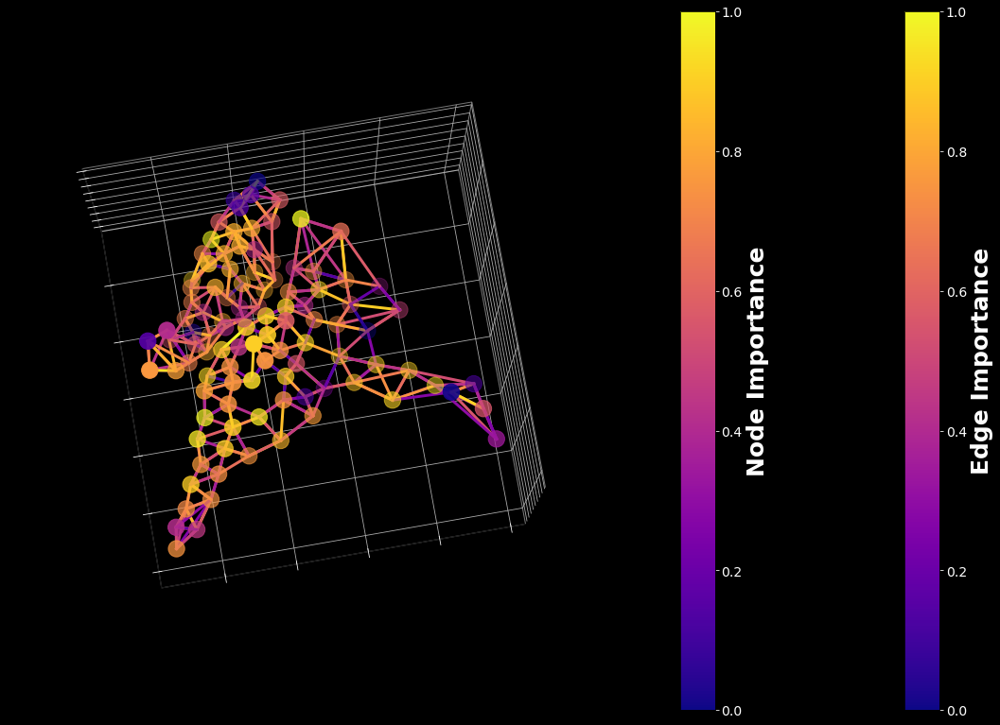

In [335]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(uc_003_1_node_colors)
    ax.scatter(uc_003_1_proxi['row']*scale, uc_003_1_proxi['col']*scale, uc_003_1_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(uc_003_3_node_colors)
    ax.scatter(uc_003_3_proxi['row']*scale, uc_003_3_proxi['col']*scale, uc_003_3_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(uc_003_1_filtered_edges)):
        item = uc_003_1_filtered_edges[i]
        edge_c = edge_cmap(uc_003_1_edge_colors[i])
        ax.plot([uc_003_1_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_1_proxi.loc[item[1]]['row'].astype('float')*scale],
                [uc_003_1_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_1_proxi.loc[item[1]]['col'].astype('float')*scale],
                [uc_003_1_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(uc_003_3_filtered_edges)):
        item = uc_003_3_filtered_edges[i]
        edge_c = edge_cmap(uc_003_3_edge_colors[i])
        ax.plot([uc_003_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['row'].astype('float')*scale],
                [uc_003_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['col'].astype('float')*scale],
                [uc_003_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_003_01_03_graph_importance.png')

#### Neighboring cells patch networks, cell 1-3

In [161]:
embedding = pd.read_csv(r'.\results\gae_embedded_features.csv',index_col=0)

In [162]:
embedding

,1,2,3,4,5,6,7,8,9,10,...,96,97,98,99,100,row,col,z,cluster,cellID
bm_001_01_0,0.133491,0.049819,-0.216774,0.015934,-0.083404,0.150778,0.288539,0.058014,-0.011838,0.066314,...,0.251209,0.047553,0.160021,0.113359,0.050917,167.983607,580.934426,13.459016,0,bm_001_01
bm_001_01_1,-0.175297,0.057750,-0.045509,0.187772,-0.073505,-0.048532,0.123248,-0.066662,0.321819,-0.226296,...,0.356954,-0.061827,-0.047485,0.196687,-0.118396,219.658333,492.091667,16.541667,5,bm_001_01
bm_001_01_2,-0.094484,-0.035670,-0.064323,0.000226,-0.140458,0.104816,0.068818,0.140446,-0.051742,0.002350,...,0.118130,-0.097594,-0.044369,0.038023,0.057828,137.956522,548.521739,13.391304,1,bm_001_01
bm_001_01_3,-0.211751,-0.005190,-0.031677,0.066307,-0.111203,-0.012707,0.027698,0.088333,0.122412,-0.158073,...,0.114330,-0.030061,-0.007405,0.253388,-0.006455,176.945455,526.390909,10.318182,9,bm_001_01
bm_001_01_4,0.102304,0.059926,-0.180779,0.010392,-0.101629,0.113652,0.209493,0.034273,-0.047150,0.045001,...,0.225894,-0.016591,0.116273,0.069692,0.089192,148.495413,575.954128,14.669725,0,bm_001_01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
uc_047_05_46,-0.259811,-0.167347,0.103615,-0.202420,-0.195573,-0.049169,-0.301129,0.228135,0.059822,-0.144613,...,-0.035543,-0.266260,-0.111388,0.056950,-0.147607,1724.725000,472.520000,12.935000,2,uc_047_05
uc_047_05_47,0.154123,-0.178316,-0.122551,-0.015987,-0.124164,-0.068107,-0.020095,-0.171674,0.093814,-0.010315,...,0.049071,0.154365,-0.063477,-0.249080,-0.277742,1602.498728,531.333333,9.824427,8,uc_047_05
uc_047_05_48,0.124094,0.152764,0.031000,-0.089696,-0.358432,-0.169728,0.326231,0.135734,-0.333806,-0.057691,...,-0.095819,-0.056547,-0.126515,0.011176,0.158422,1488.423280,691.671958,10.142857,6,uc_047_05
uc_047_05_49,0.066837,-0.056448,0.023526,0.046105,-0.232864,0.119689,0.166379,0.157568,0.230702,0.079585,...,0.008037,-0.108842,0.060741,-0.070457,-0.087670,1857.138365,673.716981,10.062893,0,uc_047_05


In [336]:
uc_003_1 = embedding[embedding['cellID']=='uc_003_01']
uc_003_3 = embedding[embedding['cellID']=='uc_003_03']
uc_003_patches = pd.concat([uc_003_1,uc_003_3])

In [337]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\masks\003_mask.tif')
mask = (mask==1).astype('int') + (mask==3).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\imgs\003_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

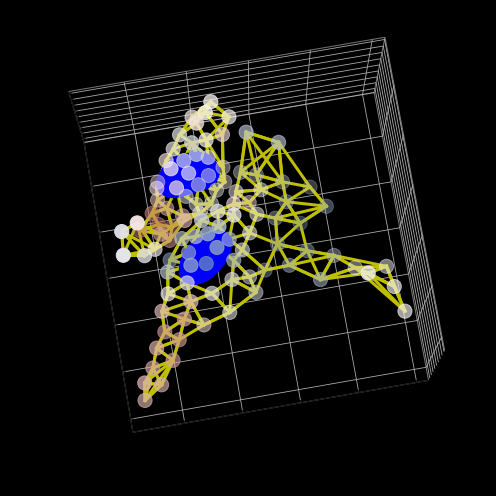

In [347]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(uc_003_patches['row']*scale,uc_003_patches['col']*scale,uc_003_patches['z']*z_scale,s=200,
           c = uc_003_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(uc_003_1_filtered_edges)):
    item = uc_003_1_filtered_edges[i]
    edge_c = edge_cmap(uc_003_1_edge_colors[i])
    ax.plot([uc_003_1_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_1_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_1_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_003_3_filtered_edges)):
    item = uc_003_3_filtered_edges[i]
    edge_c = edge_cmap(uc_003_3_edge_colors[i])
    ax.plot([uc_003_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_003_01-03_embedding_24_interactions.png')

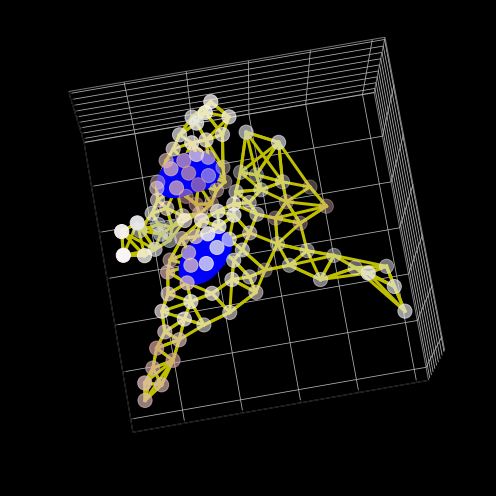

In [346]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(uc_003_patches['row']*scale,uc_003_patches['col']*scale,uc_003_patches['z']*z_scale,s=200,
           c = uc_003_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(uc_003_1_filtered_edges)):
    item = uc_003_1_filtered_edges[i]
    edge_c = edge_cmap(uc_003_1_edge_colors[i])
    ax.plot([uc_003_1_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_1_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_1_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_003_3_filtered_edges)):
    item = uc_003_3_filtered_edges[i]
    edge_c = edge_cmap(uc_003_3_edge_colors[i])
    ax.plot([uc_003_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_003_01-03_embedding_59_interactions.png')

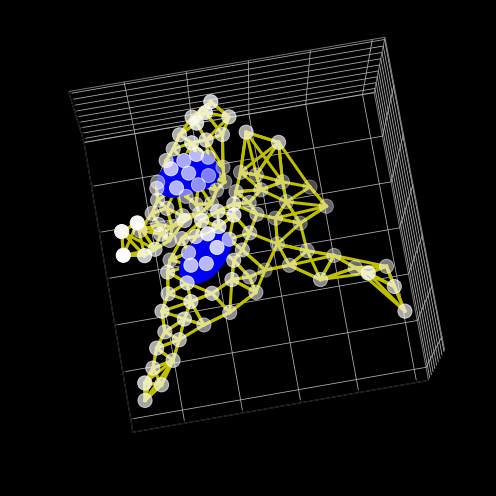

In [376]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
ax.scatter(uc_003_patches['row']*scale,uc_003_patches['col']*scale,uc_003_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_003_1_filtered_edges)):
    item = uc_003_1_filtered_edges[i]
    edge_c = edge_cmap(uc_003_1_edge_colors[i])
    ax.plot([uc_003_1_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_1_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_1_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_003_3_filtered_edges)):
    item = uc_003_3_filtered_edges[i]
    edge_c = edge_cmap(uc_003_3_edge_colors[i])
    ax.plot([uc_003_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_003_01-03_patch_networks.png')

In [382]:
patch_labels = []
for item in uc_003_1_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

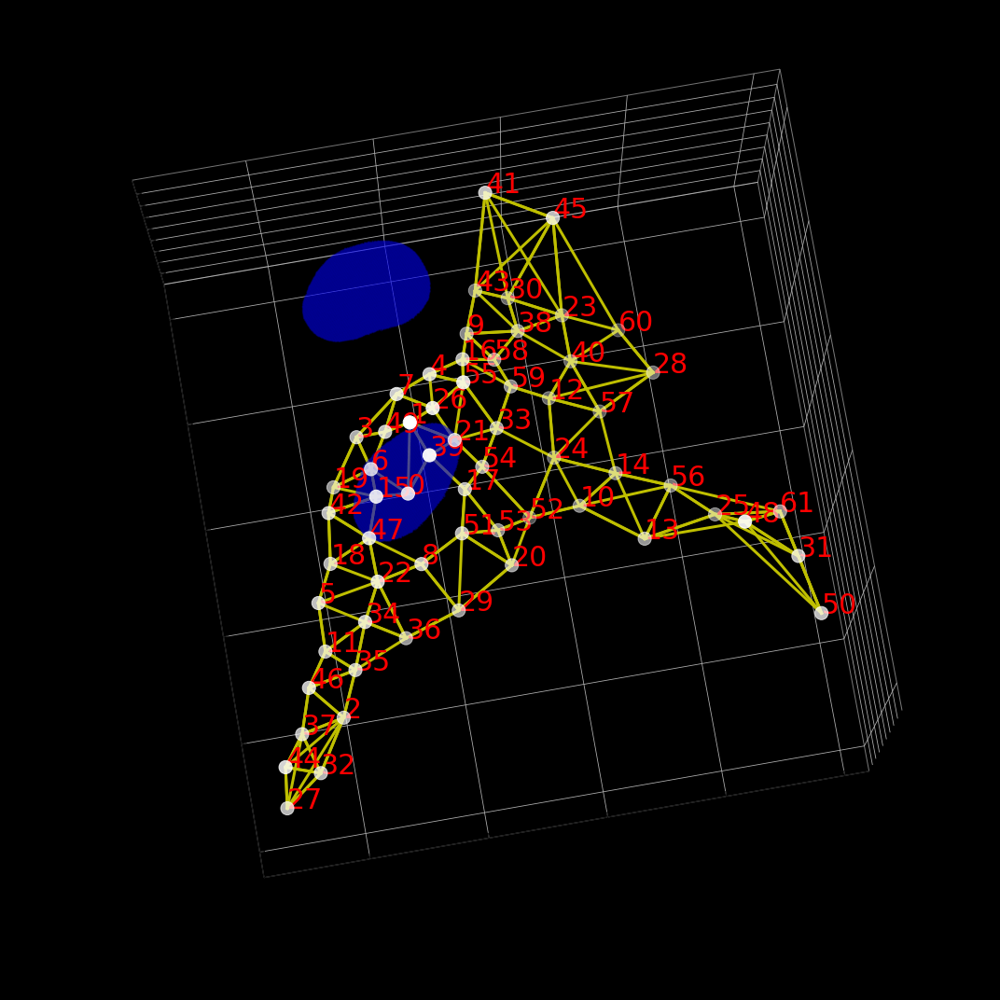

In [388]:

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
uc_003_1_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_01']
ax.scatter(uc_003_1_patches['row']*scale,uc_003_1_patches['col']*scale,uc_003_1_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_003_1_filtered_edges)):
    item = uc_003_1_filtered_edges[i]
    edge_c = edge_cmap(uc_003_1_edge_colors[i])
    ax.plot([uc_003_1_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_1_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_1_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in uc_003_1_patches.index.tolist():
    ax.text(uc_003_1_patches.loc[idx]['row']*scale,
            uc_003_1_patches.loc[idx]['col']*scale,
            uc_003_1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

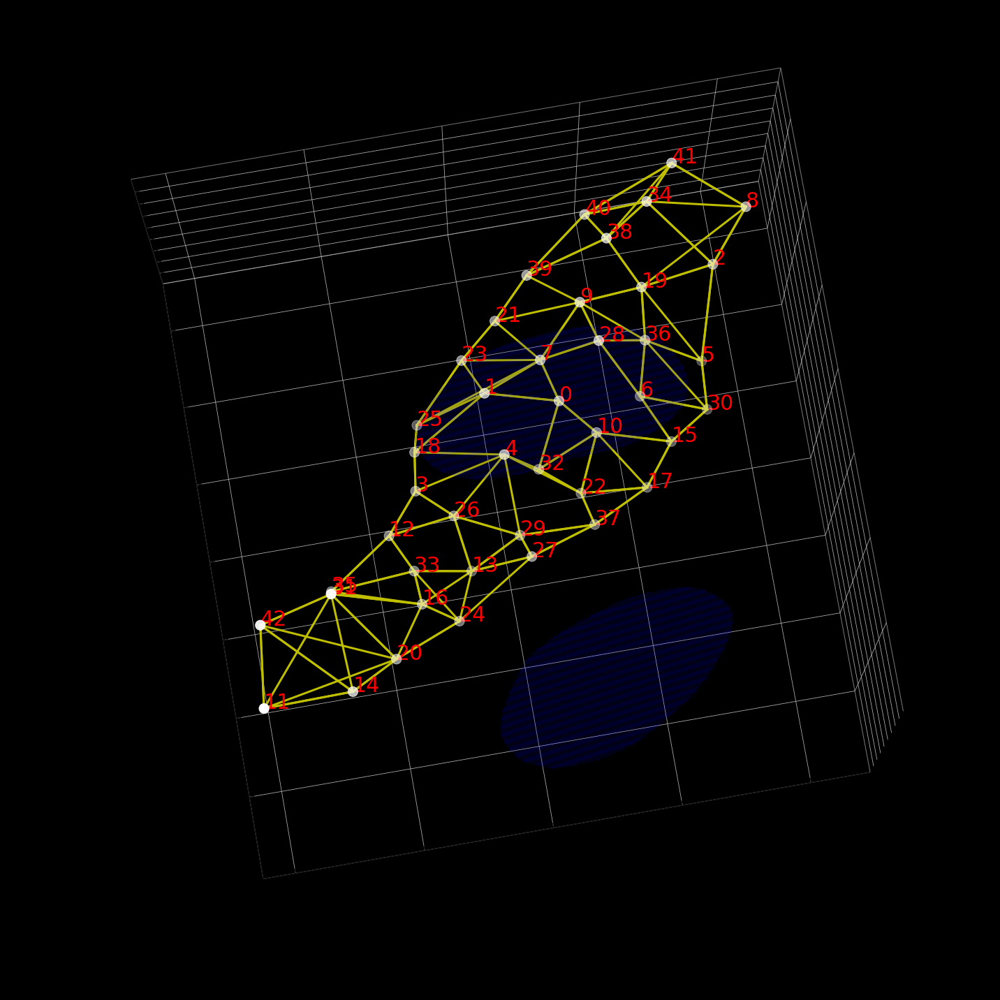

In [389]:
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

uc_003_3_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_03']
ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
ax.scatter(uc_003_3_patches['row']*scale,uc_003_3_patches['col']*scale,uc_003_3_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_003_3_filtered_edges)):
    item = uc_003_3_filtered_edges[i]
    edge_c = edge_cmap(uc_003_3_edge_colors[i])
    ax.plot([uc_003_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in uc_003_3_patches.index.tolist():
    ax.text(uc_003_3_patches.loc[idx]['row']*scale,
            uc_003_3_patches.loc[idx]['col']*scale,
            uc_003_3_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01-03_patch_networks.png')

In [160]:
uc003_1_boarder = [42,19,3,7,4,16,9,43,47,15,6,49,1,26,55]
uc003_3_boarder = [20,24,27,37,17,15,30,5,19,36,6,10,22,29,13,16]

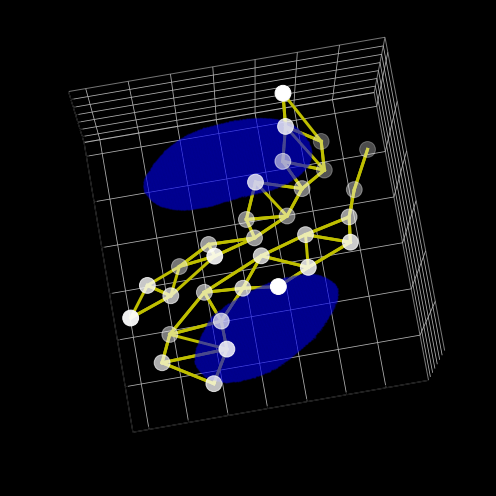

In [406]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)

uc_003_1_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_01']
boarder_index = []
for p in uc003_1_boarder:
    boarder_index.append('uc_003_01_'+str(p))
uc_003_1_patches = uc_003_1_patches.loc[boarder_index]
ax.scatter(uc_003_1_patches['row']*scale,uc_003_1_patches['col']*scale,uc_003_1_patches['z']*z_scale,s=250,
           color='w')

uc_003_3_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_03']
boarder_index = []
for p in uc003_3_boarder:
    boarder_index.append('uc_003_03_'+str(p))
uc_003_3_patches = uc_003_3_patches.loc[boarder_index]
ax.scatter(uc_003_3_patches['row']*scale,uc_003_3_patches['col']*scale,uc_003_3_patches['z']*z_scale,s=250,
           color='w')

for edge in uc_003_1_filtered_edges:
    patch1 = uc_003_1_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_003_1_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_003_1_patches.index.tolist() and patch2 in uc_003_1_patches.index.tolist():
        ax.plot([uc_003_1_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_003_1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_003_1_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_003_1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_003_1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_003_1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in uc_003_3_filtered_edges:
    patch1 = uc_003_3_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_003_3_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_003_3_patches.index.tolist() and patch2 in uc_003_3_patches.index.tolist():
        ax.plot([uc_003_3_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_003_3_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_003_3_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

KeyError: "None of [Index(['uc_003_01_18', 'uc_003_01_25', 'uc_003_01_23', 'uc_003_01_21',\n       'uc_003_01_39', 'uc_003_01_40', 'uc_003_01_34', 'uc_003_01_38',\n       'uc_003_01_9', 'uc_003_01_7', 'uc_003_01_1', 'uc_003_01_4',\n       'uc_003_01_3', 'uc_003_01_12', 'uc_003_01_26'],\n      dtype='object')] are in the [index]"

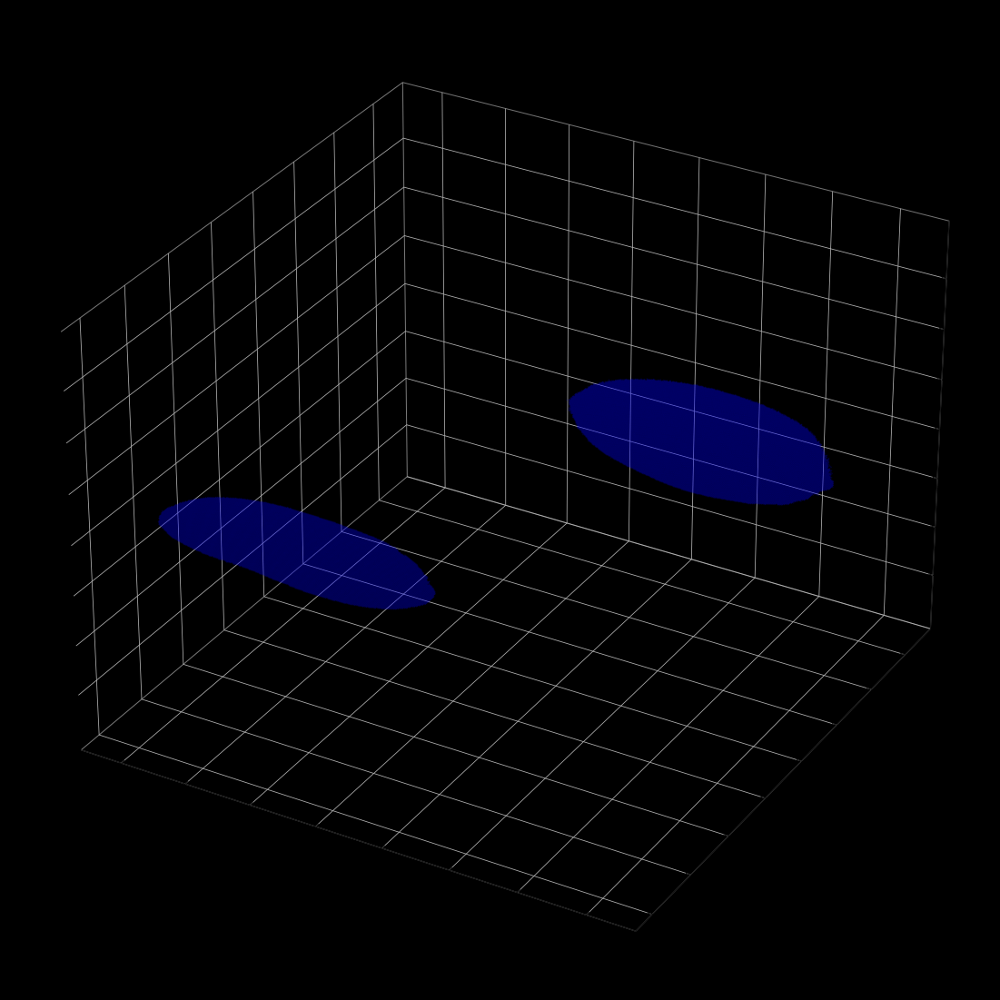

In [203]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)

uc_003_1_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_01']
boarder_index = []
for p in uc003_1_boarder:
    boarder_index.append('uc_003_01_'+str(p))
uc_003_1_patches = uc_003_1_patches.loc[boarder_index]
ax.scatter(uc_003_1_patches['row']*scale,uc_003_1_patches['col']*scale,uc_003_1_patches['z']*z_scale,s=250,
           color='w')

uc_003_3_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_03']
boarder_index = []
for p in uc003_3_boarder:
    boarder_index.append('uc_003_03_'+str(p))
uc_003_3_patches = uc_003_3_patches.loc[boarder_index]
ax.scatter(uc_003_3_patches['row']*scale,uc_003_3_patches['col']*scale,uc_003_3_patches['z']*z_scale,s=250,
           color='w')

for edge in uc_003_1_filtered_edges:
    patch1 = uc_003_1_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_003_1_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_003_1_patches.index.tolist() and patch2 in uc_003_1_patches.index.tolist():
        ax.plot([uc_003_1_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_003_1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_003_1_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_003_1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_003_1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_003_1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in uc_003_3_filtered_edges:
    patch1 = uc_003_3_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_003_3_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_003_3_patches.index.tolist() and patch2 in uc_003_3_patches.index.tolist():
        ax.plot([uc_003_3_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_003_3_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_003_3_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)
        
for idx in uc_003_1_patches.index.tolist():
    ax.text(uc_003_1_patches.loc[idx]['row']*scale,
            uc_003_1_patches.loc[idx]['col']*scale,
            uc_003_1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
for idx in uc_003_3_patches.index.tolist():
    ax.text(uc_003_3_patches.loc[idx]['row']*scale,
            uc_003_3_patches.loc[idx]['col']*scale,
            uc_003_3_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

#### Neighboring cells patch importance, cell 3-4

In [165]:
uc_003_3_explanation = pd.read_pickle(r'.\results\explainer\uc_003_03.pkl')
uc_003_4_explanation = pd.read_pickle(r'.\results\explainer\uc_003_04.pkl')

In [168]:
uc_003_3_proxi = proxi_by_cell.get_group('uc_003_03')
uc_003_4_proxi = proxi_by_cell.get_group('uc_003_04')

In [169]:
uc_003_3_edge_colors = uc_003_3_explanation['edge_mask']
uc_003_3_edge_colors = (uc_003_3_edge_colors - uc_003_3_edge_colors.min()) / (uc_003_3_edge_colors.max() - uc_003_3_edge_colors.min())

uc_003_3_node_colors = uc_003_3_explanation['node_mask']
uc_003_3_node_colors = np.abs(uc_003_3_node_colors)
uc_003_3_node_colors = np.sum(uc_003_3_node_colors,axis=1)
uc_003_3_node_colors = (uc_003_3_node_colors - uc_003_3_node_colors.min()) / (uc_003_3_node_colors.max() - uc_003_3_node_colors.min())


uc_003_4_edge_colors = uc_003_4_explanation['edge_mask']
uc_003_4_edge_colors = (uc_003_4_edge_colors - uc_003_4_edge_colors.min()) / (uc_003_4_edge_colors.max() - uc_003_4_edge_colors.min())

uc_003_4_node_colors = uc_003_4_explanation['node_mask']
uc_003_4_node_colors = np.abs(uc_003_4_node_colors)
uc_003_4_node_colors = np.sum(uc_003_4_node_colors,axis=1)
uc_003_4_node_colors = (uc_003_4_node_colors - uc_003_4_node_colors.min()) / (uc_003_4_node_colors.max() - uc_003_4_node_colors.min())

In [173]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index('uc_003_03.pkl')
idx2 = fn_l.index('uc_003_04.pkl')

uc_003_3_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        uc_003_3_filtered_edges.append(item)

uc_003_4_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        uc_003_4_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\3456476181.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


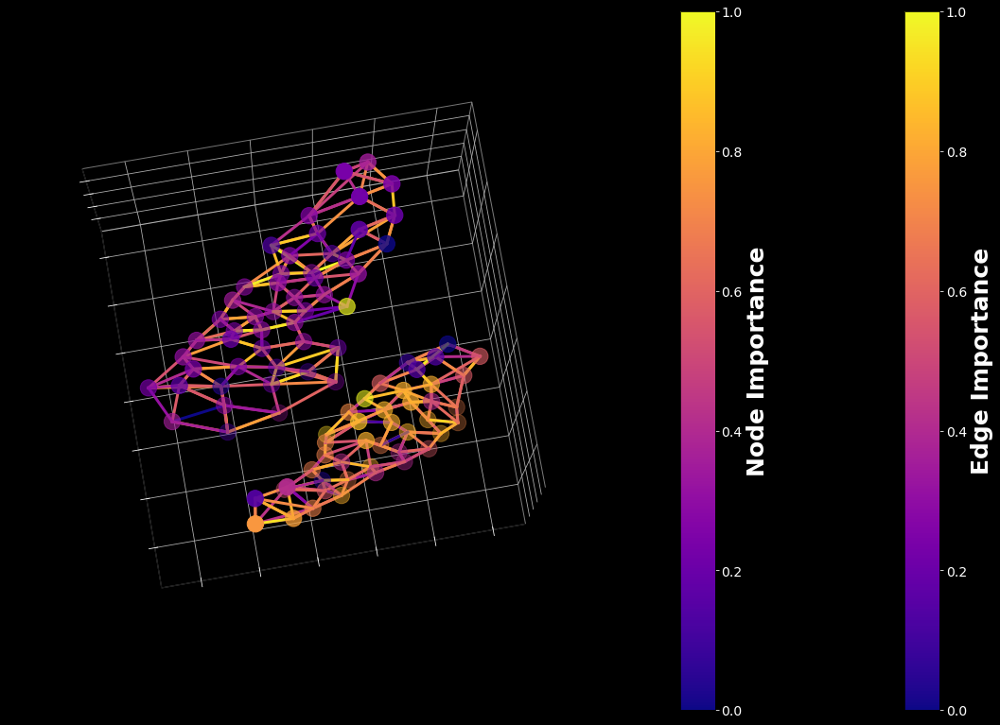

In [174]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma
    
    node_c = node_cmap(uc_003_3_node_colors)
    ax.scatter(uc_003_3_proxi['row']*scale, uc_003_3_proxi['col']*scale, uc_003_3_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(uc_003_4_node_colors)
    ax.scatter(uc_003_4_proxi['row']*scale, uc_003_4_proxi['col']*scale, uc_003_4_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(uc_003_3_filtered_edges)):
        item = uc_003_3_filtered_edges[i]
        edge_c = edge_cmap(uc_003_3_edge_colors[i])
        ax.plot([uc_003_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['row'].astype('float')*scale],
                [uc_003_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['col'].astype('float')*scale],
                [uc_003_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(uc_003_4_filtered_edges)):
        item = uc_003_4_filtered_edges[i]
        edge_c = edge_cmap(uc_003_4_edge_colors[i])
        ax.plot([uc_003_4_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_4_proxi.loc[item[1]]['row'].astype('float')*scale],
                [uc_003_4_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_4_proxi.loc[item[1]]['col'].astype('float')*scale],
                [uc_003_4_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_4_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_003_03_04_graph_importance.png')

#### neighboring patches networks, uc_003_03 and uc_003_04

In [175]:
uc_003_3 = embedding[embedding['cellID']=='uc_003_03']
uc_003_4 = embedding[embedding['cellID']=='uc_003_04']
uc_003_patches = pd.concat([uc_003_3,uc_003_4])

In [176]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\masks\003_mask.tif')
mask = (mask==3).astype('int') + (mask==4).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\imgs\003_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

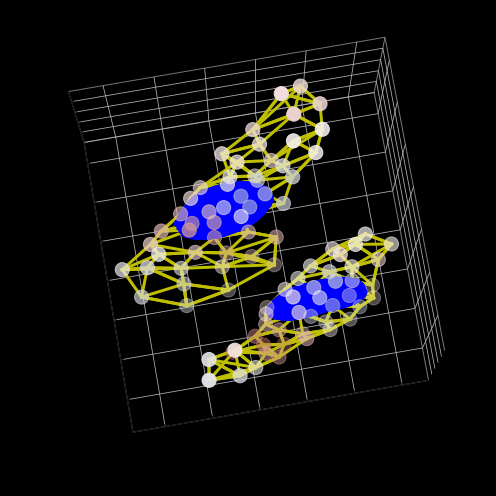

In [179]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(uc_003_patches['row']*scale,uc_003_patches['col']*scale,uc_003_patches['z']*z_scale,s=200,
           c = uc_003_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(uc_003_3_filtered_edges)):
    item = uc_003_3_filtered_edges[i]
    edge_c = edge_cmap(uc_003_3_edge_colors[i])
    ax.plot([uc_003_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_003_4_filtered_edges)):
    item = uc_003_4_filtered_edges[i]
    edge_c = edge_cmap(uc_003_4_edge_colors[i])
    ax.plot([uc_003_4_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_4_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_4_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_4_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_4_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_4_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_003_03-04_embedding_24_interactions.png')

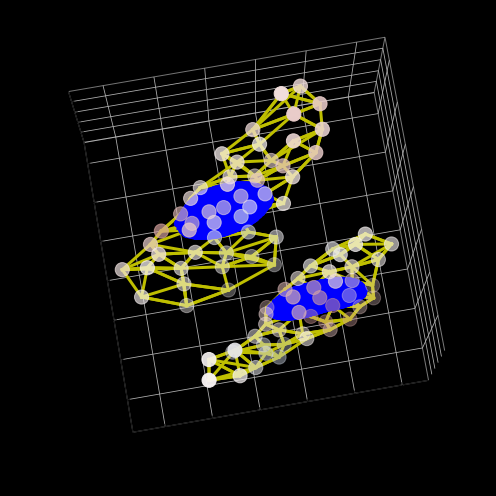

In [180]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(uc_003_patches['row']*scale,uc_003_patches['col']*scale,uc_003_patches['z']*z_scale,s=200,
           c = uc_003_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(uc_003_3_filtered_edges)):
    item = uc_003_3_filtered_edges[i]
    edge_c = edge_cmap(uc_003_3_edge_colors[i])
    ax.plot([uc_003_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_003_4_filtered_edges)):
    item = uc_003_4_filtered_edges[i]
    edge_c = edge_cmap(uc_003_4_edge_colors[i])
    ax.plot([uc_003_4_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_4_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_4_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_4_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_4_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_4_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_003_03-04_embedding_59_interactions.png')

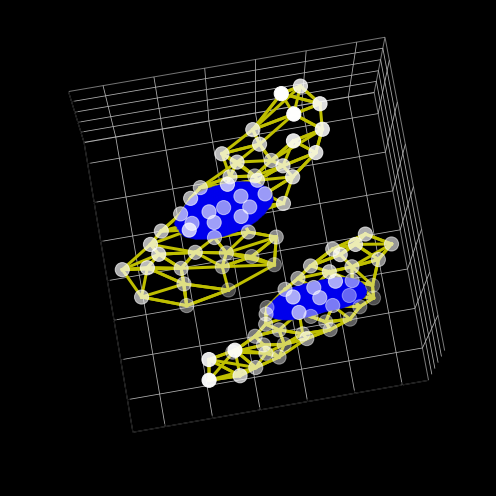

In [181]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
ax.scatter(uc_003_patches['row']*scale,uc_003_patches['col']*scale,uc_003_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_003_3_filtered_edges)):
    item = uc_003_3_filtered_edges[i]
    edge_c = edge_cmap(uc_003_3_edge_colors[i])
    ax.plot([uc_003_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_003_4_filtered_edges)):
    item = uc_003_4_filtered_edges[i]
    edge_c = edge_cmap(uc_003_4_edge_colors[i])
    ax.plot([uc_003_4_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_4_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_4_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_4_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_4_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_4_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_003_03-04_patch_networks.png')

In [191]:
patch_labels = []
uc_003_3_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_03']
for item in uc_003_3_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

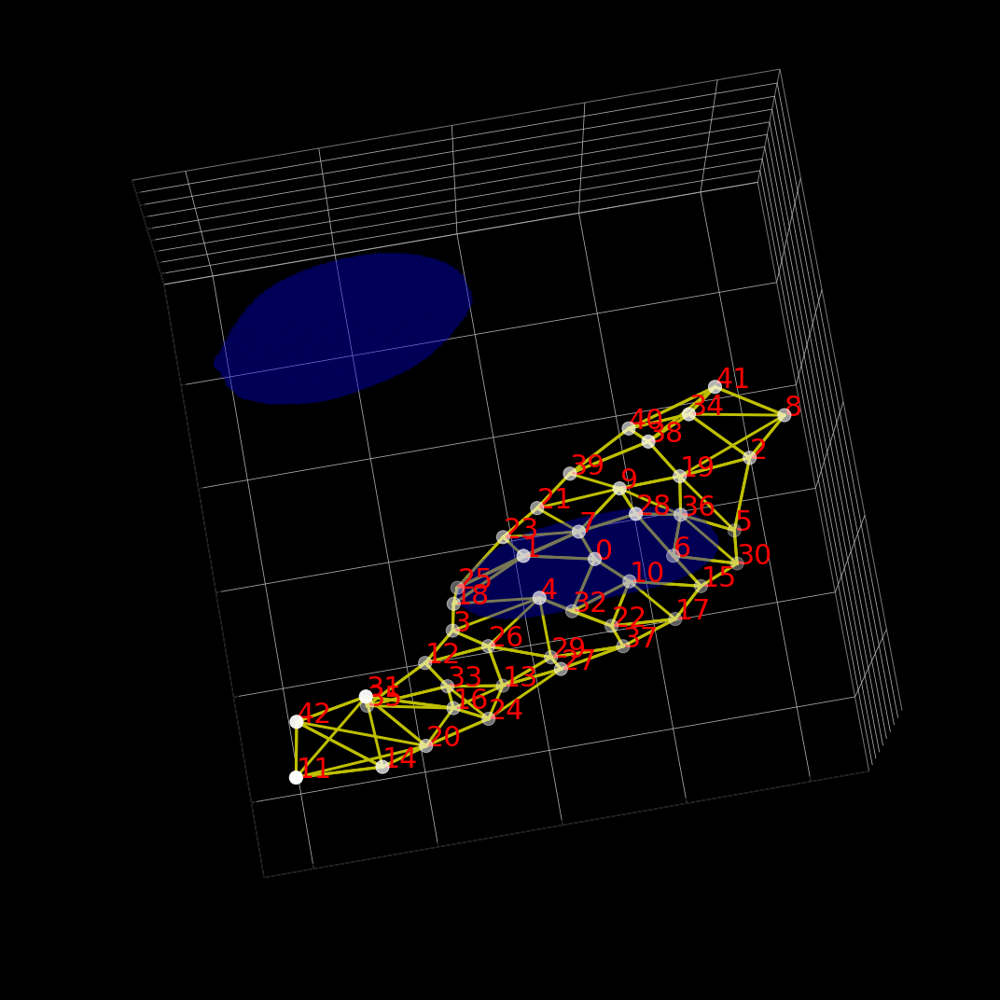

In [195]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
uc_003_1_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_01']
ax.scatter(uc_003_3_patches['row']*scale,uc_003_3_patches['col']*scale,uc_003_3_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_003_3_filtered_edges)):
    item = uc_003_3_filtered_edges[i]
    edge_c = edge_cmap(uc_003_3_edge_colors[i])
    ax.plot([uc_003_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in uc_003_3_patches.index.tolist():
    ax.text(uc_003_3_patches.loc[idx]['row']*scale,
            uc_003_3_patches.loc[idx]['col']*scale,
            uc_003_3_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [196]:
patch_labels = []
uc_003_4_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_04']
for item in uc_003_4_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

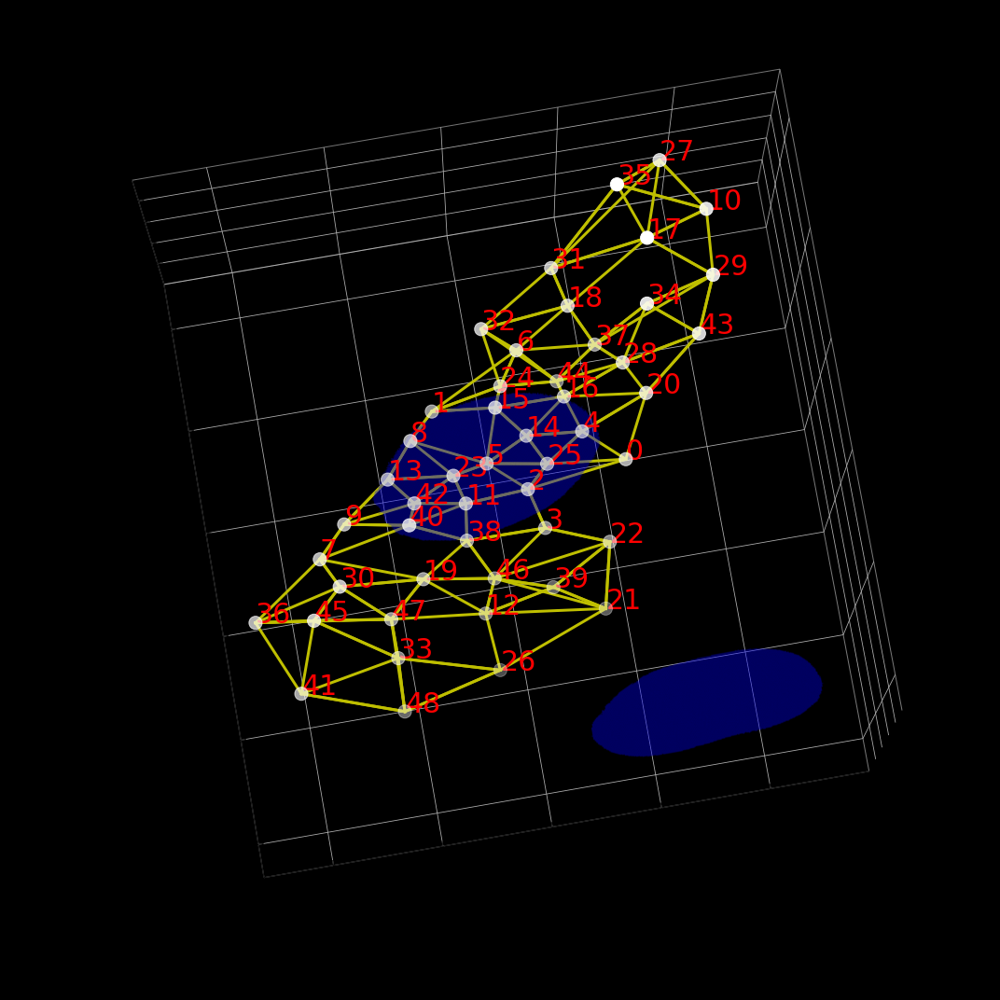

In [198]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
uc_003_4_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_04']
ax.scatter(uc_003_4_patches['row']*scale,uc_003_4_patches['col']*scale,uc_003_4_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_003_4_filtered_edges)):
    item = uc_003_4_filtered_edges[i]
    edge_c = edge_cmap(uc_003_4_edge_colors[i])
    ax.plot([uc_003_4_proxi.loc[item[0]]['row'].astype('float')*scale, uc_003_4_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_003_4_proxi.loc[item[0]]['col'].astype('float')*scale, uc_003_4_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_003_4_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_003_4_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in uc_003_4_patches.index.tolist():
    ax.text(uc_003_4_patches.loc[idx]['row']*scale,
            uc_003_4_patches.loc[idx]['col']*scale,
            uc_003_4_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [200]:
uc003_3_boarder = [18,25,23,21,39,40,34,38,9,7,1,4,3,12,26]
uc003_4_boarder = [41,48,33,47,12,26,21,39,22]

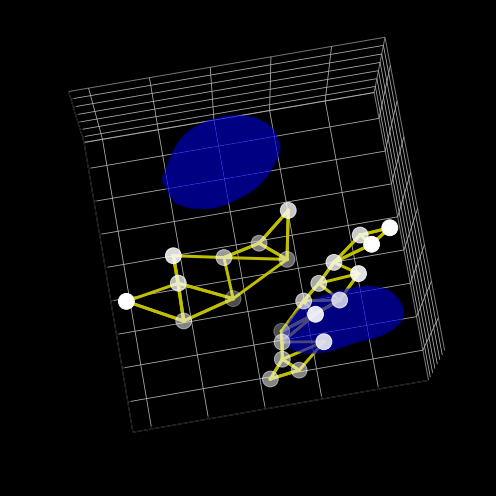

In [202]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

uc_003_3_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_03']
boarder_index = []
for p in uc003_3_boarder:
    boarder_index.append('uc_003_03_'+str(p))
uc_003_3_patches = uc_003_3_patches.loc[boarder_index]
ax.scatter(uc_003_3_patches['row']*scale,uc_003_3_patches['col']*scale,uc_003_3_patches['z']*z_scale,s=250,
           color='w')

uc_003_4_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_04']
boarder_index = []
for p in uc003_4_boarder:
    boarder_index.append('uc_003_04_'+str(p))
uc_003_4_patches = uc_003_4_patches.loc[boarder_index]
ax.scatter(uc_003_4_patches['row']*scale,uc_003_4_patches['col']*scale,uc_003_4_patches['z']*z_scale,s=250,
           color='w')


for edge in uc_003_3_filtered_edges:
    patch1 = uc_003_3_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_003_3_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_003_3_patches.index.tolist() and patch2 in uc_003_3_patches.index.tolist():
        ax.plot([uc_003_3_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_003_3_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_003_3_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in uc_003_4_filtered_edges:
    patch1 = uc_003_4_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_003_4_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_003_4_patches.index.tolist() and patch2 in uc_003_4_patches.index.tolist():
        ax.plot([uc_003_4_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_003_4_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_003_4_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_003_4_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_003_4_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_003_4_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\uc_003_03-04_boarder_patches.png')

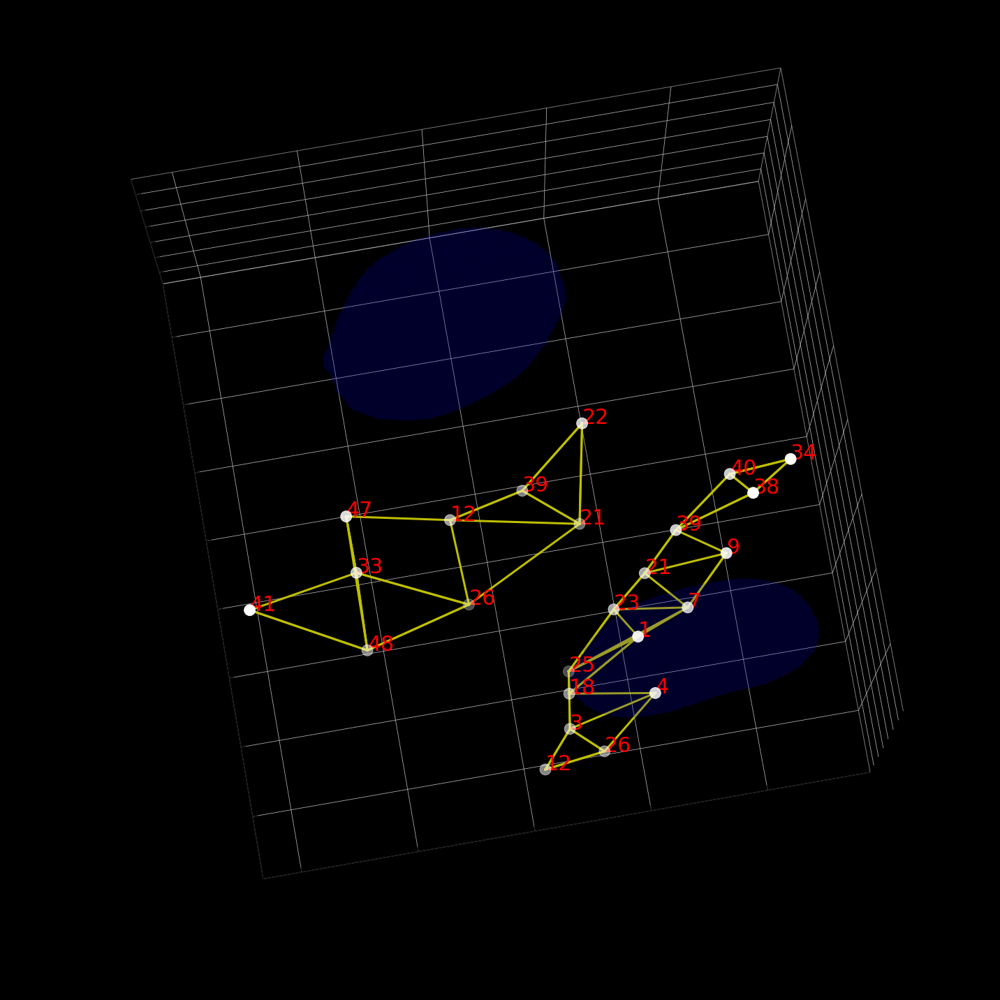

In [204]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)

uc_003_3_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_03']
boarder_index = []
for p in uc003_3_boarder:
    boarder_index.append('uc_003_03_'+str(p))
uc_003_3_patches = uc_003_3_patches.loc[boarder_index]
ax.scatter(uc_003_3_patches['row']*scale,uc_003_3_patches['col']*scale,uc_003_3_patches['z']*z_scale,s=250,
           color='w')

uc_003_4_patches = uc_003_patches[uc_003_patches['cellID']=='uc_003_04']
boarder_index = []
for p in uc003_4_boarder:
    boarder_index.append('uc_003_04_'+str(p))
uc_003_4_patches = uc_003_4_patches.loc[boarder_index]
ax.scatter(uc_003_4_patches['row']*scale,uc_003_4_patches['col']*scale,uc_003_4_patches['z']*z_scale,s=250,
           color='w')


for edge in uc_003_3_filtered_edges:
    patch1 = uc_003_3_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_003_3_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_003_3_patches.index.tolist() and patch2 in uc_003_3_patches.index.tolist():
        ax.plot([uc_003_3_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_003_3_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_003_3_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_003_3_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_003_3_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_003_3_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in uc_003_4_filtered_edges:
    patch1 = uc_003_4_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_003_4_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_003_4_patches.index.tolist() and patch2 in uc_003_4_patches.index.tolist():
        ax.plot([uc_003_4_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_003_4_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_003_4_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_003_4_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_003_4_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_003_4_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)



for idx in uc_003_3_patches.index.tolist():
    ax.text(uc_003_3_patches.loc[idx]['row']*scale,
            uc_003_3_patches.loc[idx]['col']*scale,
            uc_003_3_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in uc_003_4_patches.index.tolist():
    ax.text(uc_003_4_patches.loc[idx]['row']*scale,
            uc_003_4_patches.loc[idx]['col']*scale,
            uc_003_4_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

### uc 002 (hetero)

#### uc 002 full fov

In [228]:
cells = ['uc_002_01','uc_002_03','uc_002_04','uc_002_05']
uc_002_dist = distance_df[distance_df['fov']=='uc_002']

clusters = {}
for item in cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = count_adata.obs['leiden'].tolist()[idx]

In [229]:
clusters

{'uc_002_01': '6', 'uc_002_03': '2', 'uc_002_04': '6', 'uc_002_05': '6'}

In [230]:
uc_002_dots = []
clustering = []
for item in cells:
    uc_002_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
uc_002_dots = pd.concat(uc_002_dots)

In [231]:
uc_002_dots.insert(loc=uc_002_dots.shape[1], column='clustering', value=clustering)
dots_by_cluster = uc_002_dots.groupby('clustering')

In [232]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\masks\002_mask.tif')
mask = (mask==1).astype('int') + (mask==3).astype('int') + (mask==4).astype('int') + (mask==5).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
outline_row = []
outline_col = []
for i in range(1,4):
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

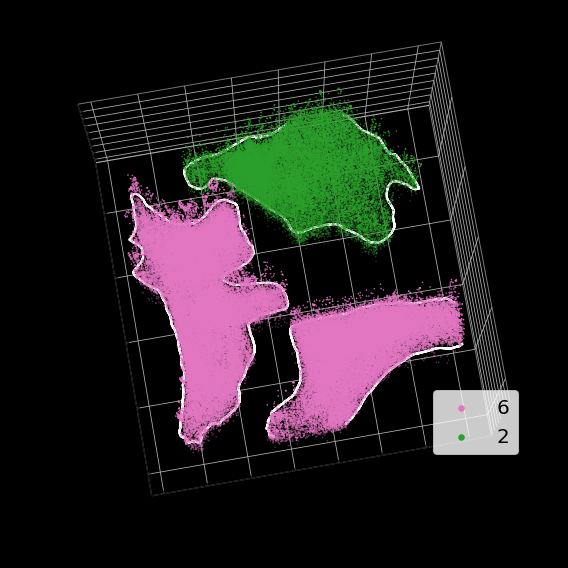

In [234]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='w')

for cluster in uc_002_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster)]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=0.3,color=color,label=cluster)

# for pair in distance_pairs:
#     ax.plot([uc_003_centers.loc[pair[0]]['row']*scale,uc_003_centers.loc[pair[1]]['row']*scale],
#             [uc_003_centers.loc[pair[0]]['col']*scale,uc_003_centers.loc[pair[1]]['col']*scale],
#             [(uc_003_centers.loc[pair[0]]['z']*z_scale)-25,(uc_003_centers.loc[pair[1]]['z']*z_scale)-25],
#             color='r',linewidth=5)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=10)

plt.tight_layout()

plt.savefig(r'.\figures\uc_002_count_cluster_colored.png',dpi=300)

#### important nodes and edges, uc002 3, 5

In [248]:
uc_002_3_explanation = pd.read_pickle(r'.\results\explainer\uc_002_03.pkl')
uc_002_5_explanation = pd.read_pickle(r'.\results\explainer\uc_002_05.pkl')

In [249]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [250]:
proxi_by_cell = proxi_df.groupby('cellID')

In [280]:
uc_002_3_proxi = proxi_by_cell.get_group('uc_002_03')
uc_002_5_proxi = proxi_by_cell.get_group('uc_002_05')

In [252]:
uc_002_3_edge_colors = uc_002_3_explanation['edge_mask']
uc_002_3_edge_colors = (uc_002_3_edge_colors - uc_002_3_edge_colors.min()) / (uc_002_3_edge_colors.max() - uc_002_3_edge_colors.min())

uc_002_3_node_colors = uc_002_3_explanation['node_mask']
uc_002_3_node_colors = np.abs(uc_002_3_node_colors)
uc_002_3_node_colors = np.sum(uc_002_3_node_colors,axis=1)
uc_002_3_node_colors = (uc_002_3_node_colors - uc_002_3_node_colors.min()) / (uc_002_3_node_colors.max() - uc_002_3_node_colors.min())


uc_002_5_edge_colors = uc_002_5_explanation['edge_mask']
uc_002_5_edge_colors = (uc_002_5_edge_colors - uc_002_5_edge_colors.min()) / (uc_002_5_edge_colors.max() - uc_002_5_edge_colors.min())

uc_002_5_node_colors = uc_002_5_explanation['node_mask']
uc_002_5_node_colors = np.abs(uc_002_5_node_colors)
uc_002_5_node_colors = np.sum(uc_002_5_node_colors,axis=1)
uc_002_5_node_colors = (uc_002_5_node_colors - uc_002_5_node_colors.min()) / (uc_002_5_node_colors.max() - uc_002_5_node_colors.min())

In [253]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index('uc_002_03.pkl')
idx2 = fn_l.index('uc_002_05.pkl')

uc_002_3_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        uc_002_3_filtered_edges.append(item)

uc_002_5_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        uc_002_5_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\4112609684.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


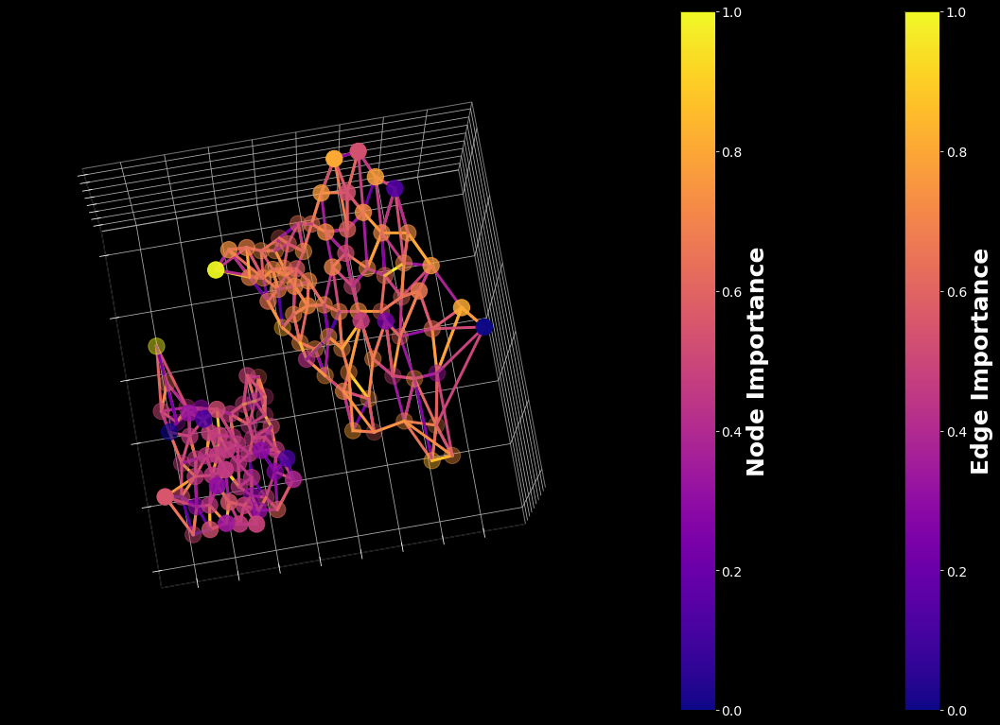

In [254]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(uc_002_3_node_colors)
    ax.scatter(uc_002_3_proxi['row']*scale, uc_002_3_proxi['col']*scale, uc_002_3_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(uc_002_5_node_colors)
    ax.scatter(uc_002_5_proxi['row']*scale, uc_002_5_proxi['col']*scale, uc_002_5_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(uc_002_3_filtered_edges)):
        item = uc_002_3_filtered_edges[i]
        edge_c = edge_cmap(uc_002_3_edge_colors[i])
        ax.plot([uc_002_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_002_3_proxi.loc[item[1]]['row'].astype('float')*scale],
                [uc_002_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_002_3_proxi.loc[item[1]]['col'].astype('float')*scale],
                [uc_002_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_002_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(uc_002_5_filtered_edges)):
        item = uc_002_5_filtered_edges[i]
        edge_c = edge_cmap(uc_002_5_edge_colors[i])
        ax.plot([uc_002_5_proxi.loc[item[0]]['row'].astype('float')*scale, uc_002_5_proxi.loc[item[1]]['row'].astype('float')*scale],
                [uc_002_5_proxi.loc[item[0]]['col'].astype('float')*scale, uc_002_5_proxi.loc[item[1]]['col'].astype('float')*scale],
                [uc_002_5_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_002_5_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_002_02_05_graph_importance.png')

#### neighboring patches networks, uc_002_03 and uc_002_05

In [235]:
uc_002_3 = embedding[embedding['cellID']=='uc_002_03']
uc_002_5 = embedding[embedding['cellID']=='uc_002_05']
uc_002_patches = pd.concat([uc_002_3,uc_002_5])

In [236]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\masks\002_mask.tif')
mask = (mask==3).astype('int') + (mask==5).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\imgs\002_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

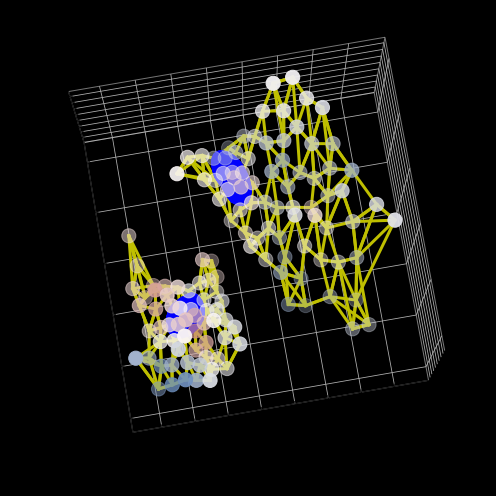

In [257]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(uc_002_patches['row']*scale,uc_002_patches['col']*scale,uc_002_patches['z']*z_scale,s=200,
           c = uc_002_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(uc_002_3_filtered_edges)):
    item = uc_002_3_filtered_edges[i]
    edge_c = edge_cmap(uc_002_3_edge_colors[i])
    ax.plot([uc_002_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_002_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_002_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_002_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_002_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_002_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_002_5_filtered_edges)):
    item = uc_002_5_filtered_edges[i]
    edge_c = edge_cmap(uc_002_5_edge_colors[i])
    ax.plot([uc_002_5_proxi.loc[item[0]]['row'].astype('float')*scale, uc_002_5_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_002_5_proxi.loc[item[0]]['col'].astype('float')*scale, uc_002_5_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_002_5_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_002_5_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_002_02-05_embedding_24_interactions.png')

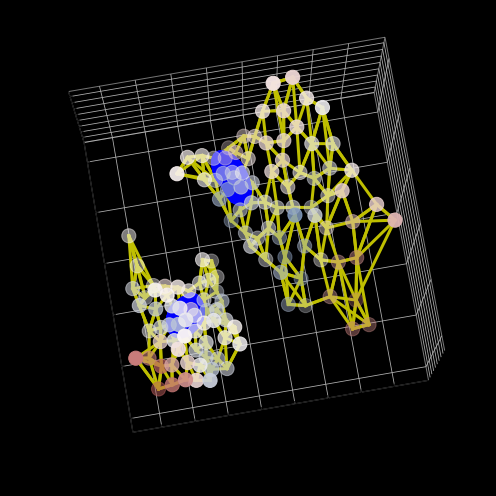

In [258]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(uc_002_patches['row']*scale,uc_002_patches['col']*scale,uc_002_patches['z']*z_scale,s=200,
           c = uc_002_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(uc_002_3_filtered_edges)):
    item = uc_002_3_filtered_edges[i]
    edge_c = edge_cmap(uc_002_3_edge_colors[i])
    ax.plot([uc_002_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_002_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_002_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_002_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_002_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_002_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_002_5_filtered_edges)):
    item = uc_002_5_filtered_edges[i]
    edge_c = edge_cmap(uc_002_5_edge_colors[i])
    ax.plot([uc_002_5_proxi.loc[item[0]]['row'].astype('float')*scale, uc_002_5_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_002_5_proxi.loc[item[0]]['col'].astype('float')*scale, uc_002_5_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_002_5_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_002_5_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_002_03-05_embedding_59_interactions.png')

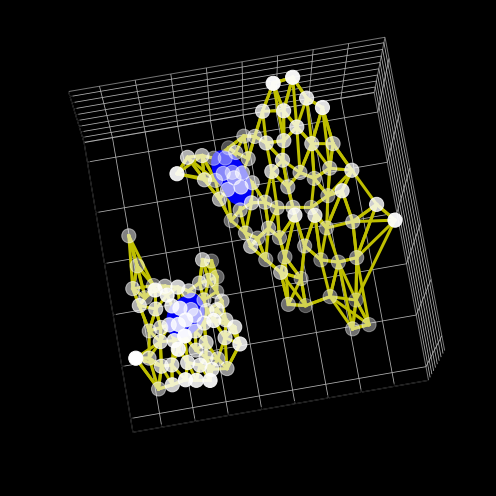

In [262]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
ax.scatter(uc_002_patches['row']*scale,uc_002_patches['col']*scale,uc_002_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_002_3_filtered_edges)):
    item = uc_002_3_filtered_edges[i]
    edge_c = edge_cmap(uc_002_3_edge_colors[i])
    ax.plot([uc_002_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_002_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_002_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_002_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_002_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_002_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_002_5_filtered_edges)):
    item = uc_002_5_filtered_edges[i]
    edge_c = edge_cmap(uc_002_5_edge_colors[i])
    ax.plot([uc_002_5_proxi.loc[item[0]]['row'].astype('float')*scale, uc_002_5_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_002_5_proxi.loc[item[0]]['col'].astype('float')*scale, uc_002_5_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_002_5_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_002_5_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_002_03-05_patch_networks.png')

In [264]:
patch_labels = []
uc_002_3_patches = uc_002_patches[uc_002_patches['cellID']=='uc_002_03']
for item in uc_002_3_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

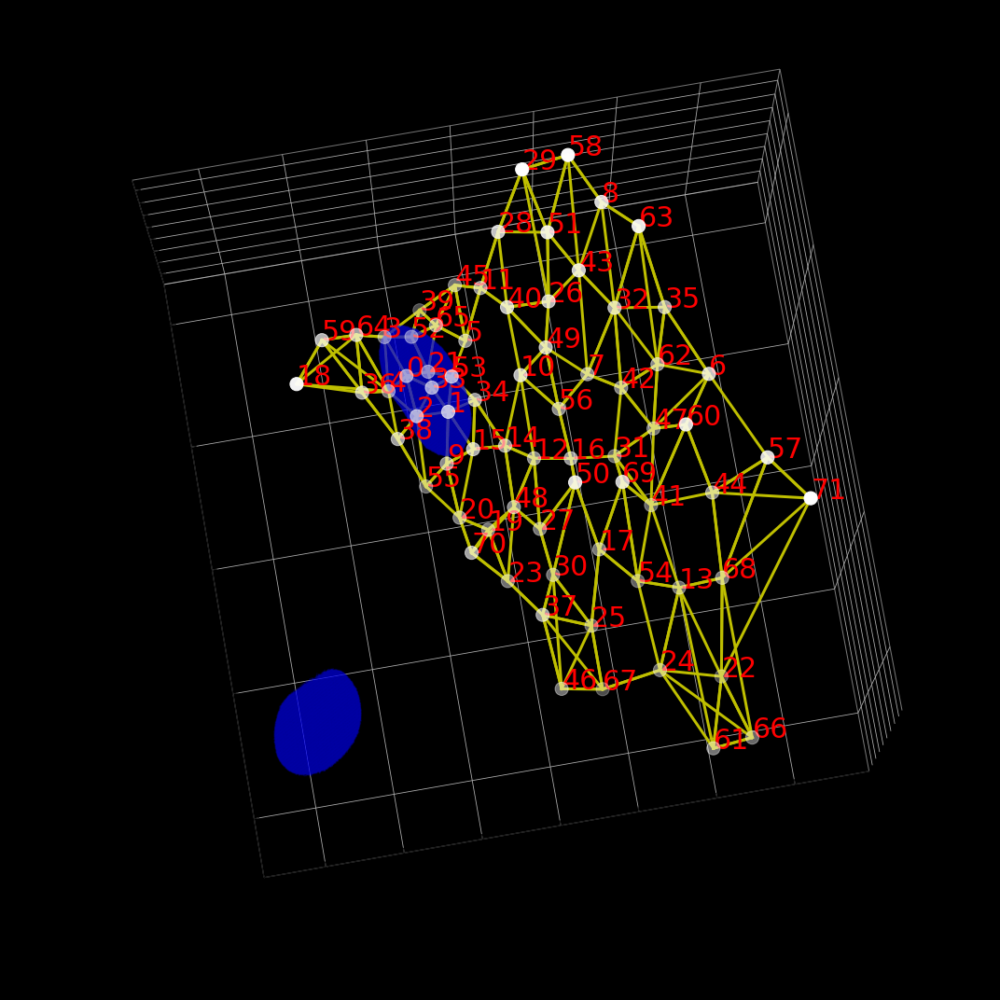

In [266]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
uc_002_3_patches = uc_002_patches[uc_002_patches['cellID']=='uc_002_03']
ax.scatter(uc_002_3_patches['row']*scale,uc_002_3_patches['col']*scale,uc_002_3_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_002_3_filtered_edges)):
    item = uc_002_3_filtered_edges[i]
    edge_c = edge_cmap(uc_002_3_edge_colors[i])
    ax.plot([uc_002_3_proxi.loc[item[0]]['row'].astype('float')*scale, uc_002_3_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_002_3_proxi.loc[item[0]]['col'].astype('float')*scale, uc_002_3_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_002_3_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_002_3_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in uc_002_3_patches.index.tolist():
    ax.text(uc_002_3_patches.loc[idx]['row']*scale,
            uc_002_3_patches.loc[idx]['col']*scale,
            uc_002_3_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [267]:
patch_labels = []
uc_002_5_patches = uc_002_patches[uc_002_patches['cellID']=='uc_002_05']
for item in uc_002_5_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

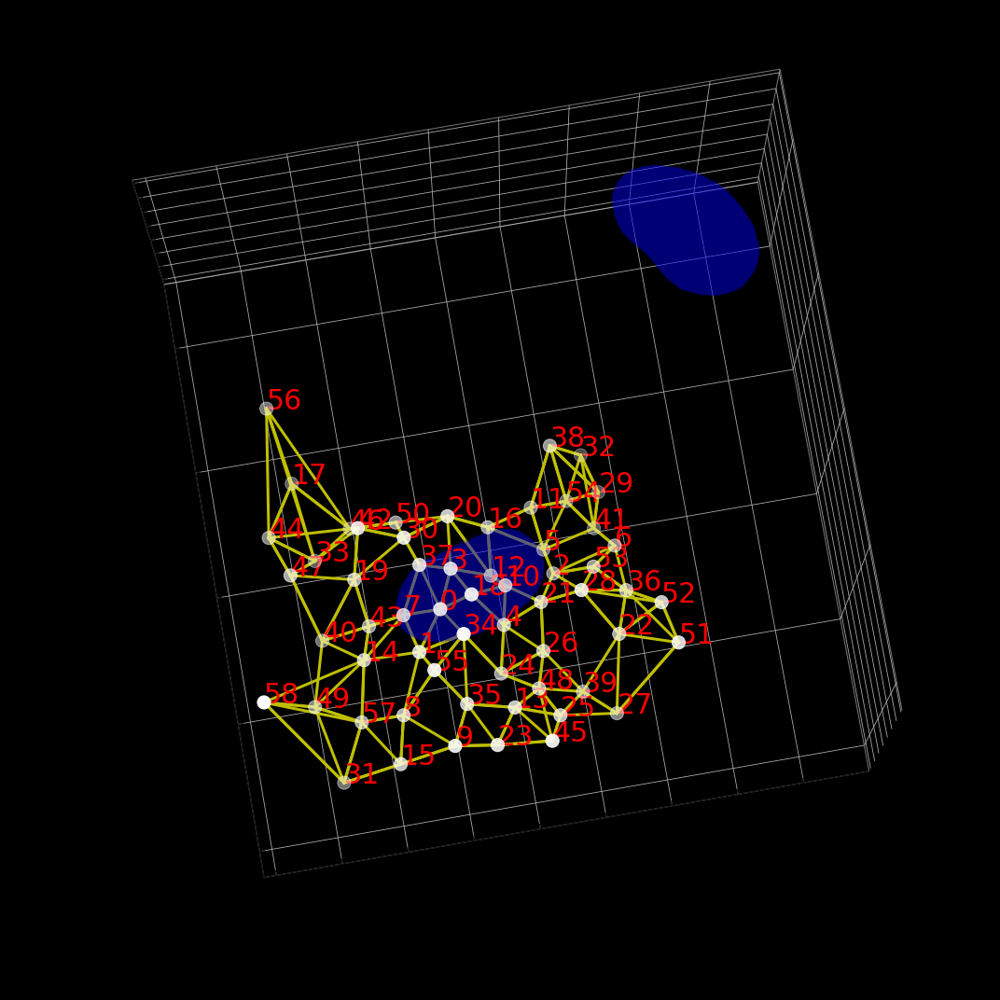

In [268]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
uc_002_5_patches = uc_002_patches[uc_002_patches['cellID']=='uc_002_05']
ax.scatter(uc_002_5_patches['row']*scale,uc_002_5_patches['col']*scale,uc_002_5_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_002_5_filtered_edges)):
    item = uc_002_5_filtered_edges[i]
    edge_c = edge_cmap(uc_002_5_edge_colors[i])
    ax.plot([uc_002_5_proxi.loc[item[0]]['row'].astype('float')*scale, uc_002_5_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_002_5_proxi.loc[item[0]]['col'].astype('float')*scale, uc_002_5_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_002_5_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_002_5_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in uc_002_5_patches.index.tolist():
    ax.text(uc_002_5_patches.loc[idx]['row']*scale,
            uc_002_5_patches.loc[idx]['col']*scale,
            uc_002_5_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [275]:
uc002_3_boarder = [38,55,20,70,19,23,27,48,14,15,1]
uc002_5_boarder = [38,32,29,54,11,41,6,53,28,2,5]

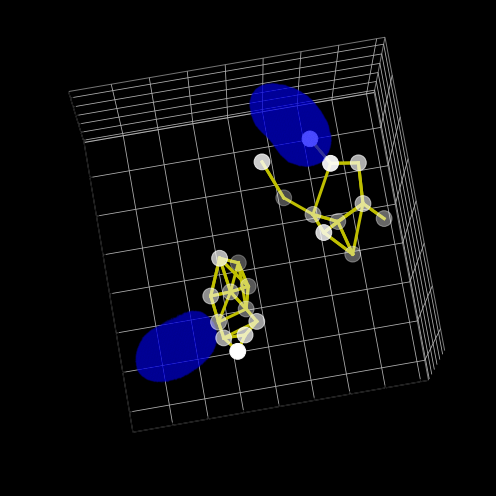

In [276]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

uc_002_3_patches = uc_002_patches[uc_002_patches['cellID']=='uc_002_03']
boarder_index = []
for p in uc002_3_boarder:
    boarder_index.append('uc_002_03_'+str(p))
uc_002_3_patches = uc_002_3_patches.loc[boarder_index]
ax.scatter(uc_002_3_patches['row']*scale,uc_002_3_patches['col']*scale,uc_002_3_patches['z']*z_scale,s=250,
           color='w')

uc_002_5_patches = uc_002_patches[uc_002_patches['cellID']=='uc_002_05']
boarder_index = []
for p in uc002_5_boarder:
    boarder_index.append('uc_002_05_'+str(p))
uc_002_5_patches = uc_002_5_patches.loc[boarder_index]
ax.scatter(uc_002_5_patches['row']*scale,uc_002_5_patches['col']*scale,uc_002_5_patches['z']*z_scale,s=250,
           color='w')


for edge in uc_002_3_filtered_edges:
    patch1 = uc_002_3_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_002_3_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_002_3_patches.index.tolist() and patch2 in uc_002_3_patches.index.tolist():
        ax.plot([uc_002_3_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_002_3_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_002_3_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_002_3_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_002_3_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_002_3_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in uc_002_5_filtered_edges:
    patch1 = uc_002_5_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_002_5_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_002_5_patches.index.tolist() and patch2 in uc_002_5_patches.index.tolist():
        ax.plot([uc_002_5_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_002_5_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_002_5_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_002_5_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_002_5_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_002_5_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\uc_002_03-05_boarder_patches.png')

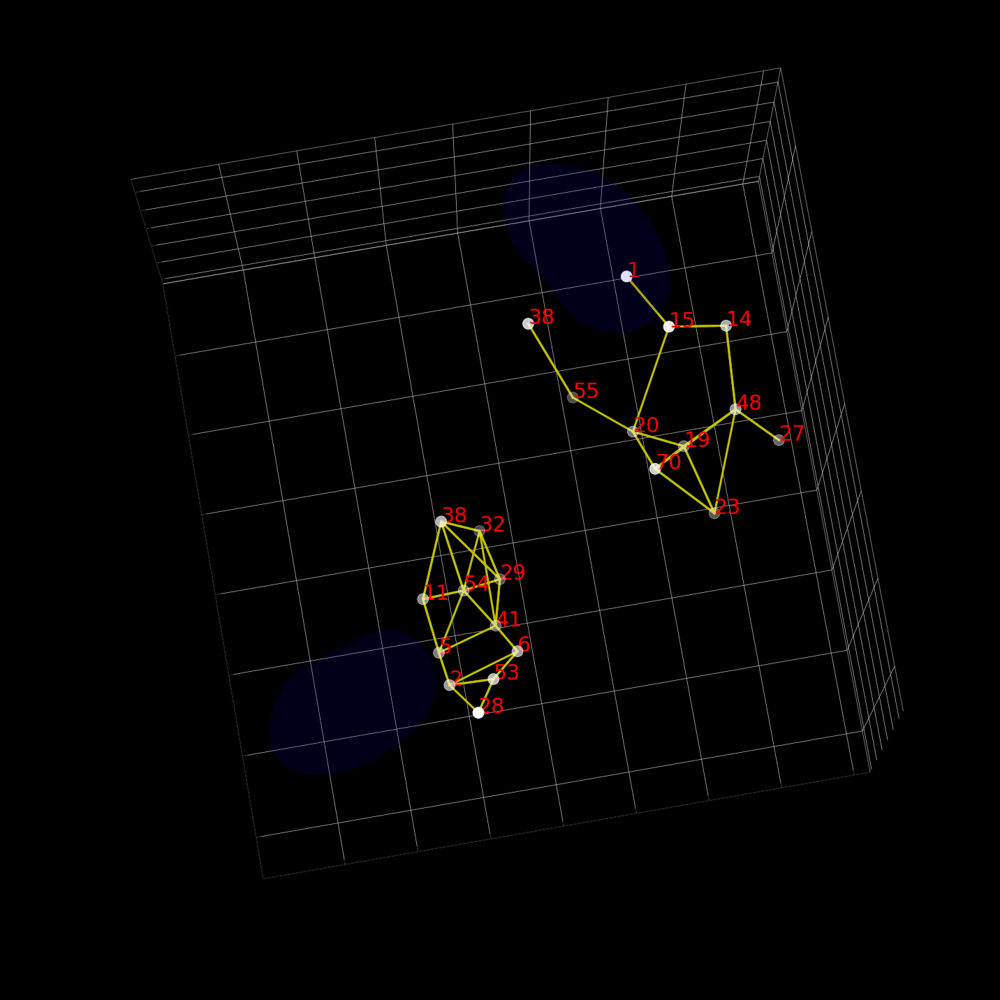

In [279]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

uc_002_3_patches = uc_002_patches[uc_002_patches['cellID']=='uc_002_03']
boarder_index = []
for p in uc002_3_boarder:
    boarder_index.append('uc_002_03_'+str(p))
uc_002_3_patches = uc_002_3_patches.loc[boarder_index]
ax.scatter(uc_002_3_patches['row']*scale,uc_002_3_patches['col']*scale,uc_002_3_patches['z']*z_scale,s=250,
           color='w')

uc_002_5_patches = uc_002_patches[uc_002_patches['cellID']=='uc_002_05']
boarder_index = []
for p in uc002_5_boarder:
    boarder_index.append('uc_002_05_'+str(p))
uc_002_5_patches = uc_002_5_patches.loc[boarder_index]
ax.scatter(uc_002_5_patches['row']*scale,uc_002_5_patches['col']*scale,uc_002_5_patches['z']*z_scale,s=250,
           color='w')


for edge in uc_002_3_filtered_edges:
    patch1 = uc_002_3_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_002_3_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_002_3_patches.index.tolist() and patch2 in uc_002_3_patches.index.tolist():
        ax.plot([uc_002_3_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_002_3_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_002_3_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_002_3_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_002_3_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_002_3_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in uc_002_5_filtered_edges:
    patch1 = uc_002_5_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_002_5_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_002_5_patches.index.tolist() and patch2 in uc_002_5_patches.index.tolist():
        ax.plot([uc_002_5_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_002_5_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_002_5_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_002_5_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_002_5_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_002_5_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)



for idx in uc_002_3_patches.index.tolist():
    ax.text(uc_002_3_patches.loc[idx]['row']*scale,
            uc_002_3_patches.loc[idx]['col']*scale,
            uc_002_3_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in uc_002_5_patches.index.tolist():
    ax.text(uc_002_5_patches.loc[idx]['row']*scale,
            uc_002_5_patches.loc[idx]['col']*scale,
            uc_002_5_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

### uc 034, 1, 2, 8

#### uc 034 full fov

In [331]:
cells = ['uc_034_01','uc_034_02','uc_034_08']
uc_034_dist = distance_df[distance_df['fov']=='uc_034']

clusters = {}
for item in cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = count_adata.obs['leiden'].tolist()[idx]

In [332]:
clusters

{'uc_034_01': '3', 'uc_034_02': '1', 'uc_034_08': '3'}

In [333]:
uc_034_dots = []
clustering = []
for item in cells:
    uc_034_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
uc_034_dots = pd.concat(uc_034_dots)

In [334]:
uc_034_dots.insert(loc=uc_034_dots.shape[1], column='clustering', value=clustering)
dots_by_cluster = uc_034_dots.groupby('clustering')

In [335]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\masks\034_mask.tif')
mask = (mask==1).astype('int') + (mask==2).astype('int') + (mask==8).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
outline_row = []
outline_col = []
for i in range(1,4):
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

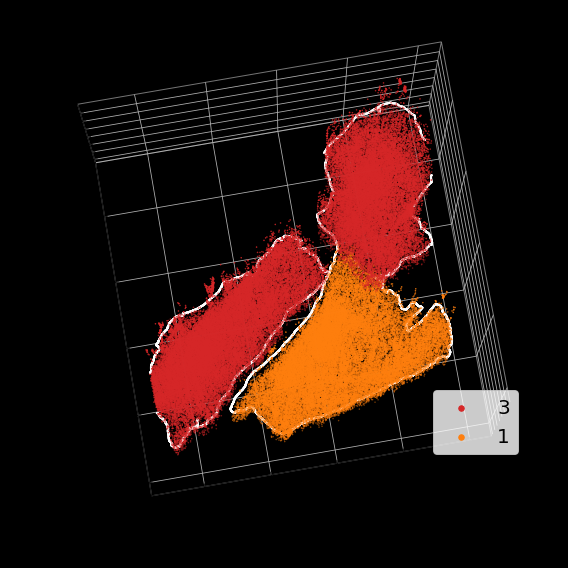

In [336]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='w')

for cluster in uc_034_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster)]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=0.3,color=color,label=cluster)

# for pair in distance_pairs:
#     ax.plot([uc_003_centers.loc[pair[0]]['row']*scale,uc_003_centers.loc[pair[1]]['row']*scale],
#             [uc_003_centers.loc[pair[0]]['col']*scale,uc_003_centers.loc[pair[1]]['col']*scale],
#             [(uc_003_centers.loc[pair[0]]['z']*z_scale)-25,(uc_003_centers.loc[pair[1]]['z']*z_scale)-25],
#             color='r',linewidth=5)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=10)

plt.tight_layout()

plt.savefig(r'.\figures\uc_034_count_cluster_colored.png',dpi=300)

#### important nodes and edges, 2,8 hetero

In [337]:
uc_034_2_explanation = pd.read_pickle(r'.\results\explainer\uc_034_02.pkl')
uc_034_8_explanation = pd.read_pickle(r'.\results\explainer\uc_034_08.pkl')

In [338]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [339]:
proxi_by_cell = proxi_df.groupby('cellID')

In [340]:
uc_034_2_proxi = proxi_by_cell.get_group('uc_034_02')
uc_034_8_proxi = proxi_by_cell.get_group('uc_034_08')

In [341]:
uc_034_2_edge_colors = uc_034_2_explanation['edge_mask']
uc_034_2_edge_colors = (uc_034_2_edge_colors - uc_034_2_edge_colors.min()) / (uc_034_2_edge_colors.max() - uc_034_2_edge_colors.min())

uc_034_2_node_colors = uc_034_2_explanation['node_mask']
uc_034_2_node_colors = np.abs(uc_034_2_node_colors)
uc_034_2_node_colors = np.sum(uc_034_2_node_colors,axis=1)
uc_034_2_node_colors = (uc_034_2_node_colors - uc_034_2_node_colors.min()) / (uc_034_2_node_colors.max() - uc_034_2_node_colors.min())


uc_034_8_edge_colors = uc_034_8_explanation['edge_mask']
uc_034_8_edge_colors = (uc_034_8_edge_colors - uc_034_8_edge_colors.min()) / (uc_034_8_edge_colors.max() - uc_034_8_edge_colors.min())

uc_034_8_node_colors = uc_034_8_explanation['node_mask']
uc_034_8_node_colors = np.abs(uc_034_8_node_colors)
uc_034_8_node_colors = np.sum(uc_034_8_node_colors,axis=1)
uc_034_8_node_colors = (uc_034_8_node_colors - uc_034_8_node_colors.min()) / (uc_034_8_node_colors.max() - uc_034_8_node_colors.min())

In [342]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index('uc_034_02.pkl')
idx2 = fn_l.index('uc_034_08.pkl')

uc_034_2_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        uc_034_2_filtered_edges.append(item)

uc_034_8_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        uc_034_8_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\3759544037.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


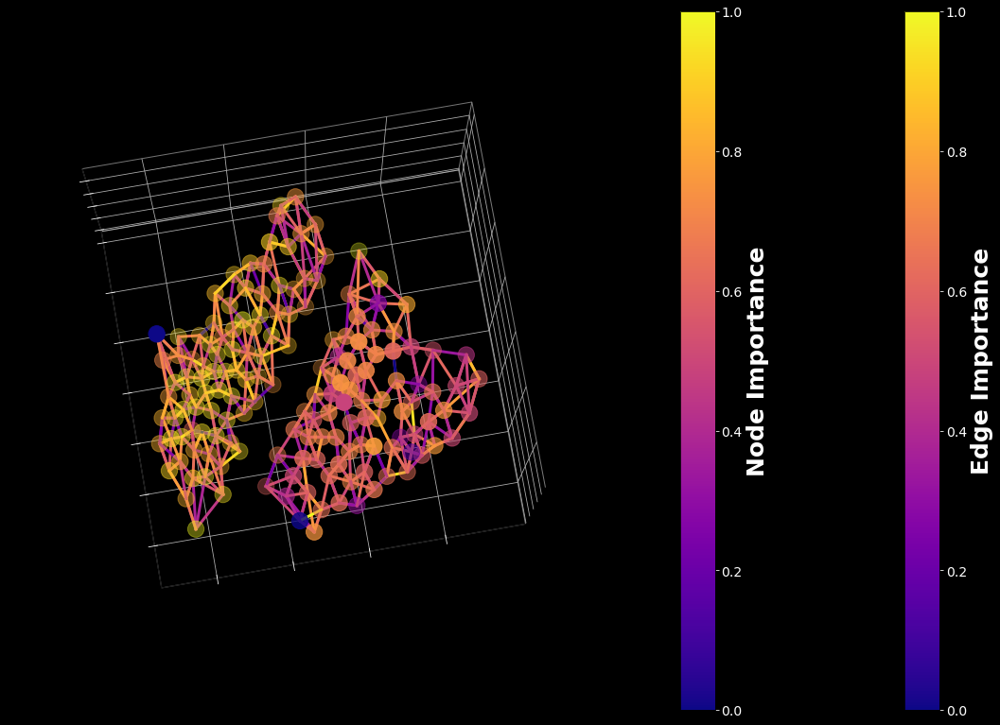

In [343]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(uc_034_2_node_colors)
    ax.scatter(uc_034_2_proxi['row']*scale, uc_034_2_proxi['col']*scale, uc_034_2_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(uc_034_8_node_colors)
    ax.scatter(uc_034_8_proxi['row']*scale, uc_034_8_proxi['col']*scale, uc_034_8_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(uc_034_2_filtered_edges)):
        item = uc_034_2_filtered_edges[i]
        edge_c = edge_cmap(uc_034_2_edge_colors[i])
        ax.plot([uc_034_2_proxi.loc[item[0]]['row'].astype('float')*scale, uc_034_2_proxi.loc[item[1]]['row'].astype('float')*scale],
                [uc_034_2_proxi.loc[item[0]]['col'].astype('float')*scale, uc_034_2_proxi.loc[item[1]]['col'].astype('float')*scale],
                [uc_034_2_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_034_2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(uc_034_8_filtered_edges)):
        item = uc_034_8_filtered_edges[i]
        edge_c = edge_cmap(uc_034_8_edge_colors[i])
        ax.plot([uc_034_8_proxi.loc[item[0]]['row'].astype('float')*scale, uc_034_8_proxi.loc[item[1]]['row'].astype('float')*scale],
                [uc_034_8_proxi.loc[item[0]]['col'].astype('float')*scale, uc_034_8_proxi.loc[item[1]]['col'].astype('float')*scale],
                [uc_034_8_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_034_8_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_034_02_08_graph_importance.png')

#### neighboring patches networks, uc_034_02 and uc_034_08

In [344]:
uc_034_2 = embedding[embedding['cellID']=='uc_034_02']
uc_034_8 = embedding[embedding['cellID']=='uc_034_08']
uc_034_patches = pd.concat([uc_034_2,uc_034_8])

In [345]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\masks\034_mask.tif')
mask = (mask==2).astype('int') + (mask==8).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\imgs\034_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

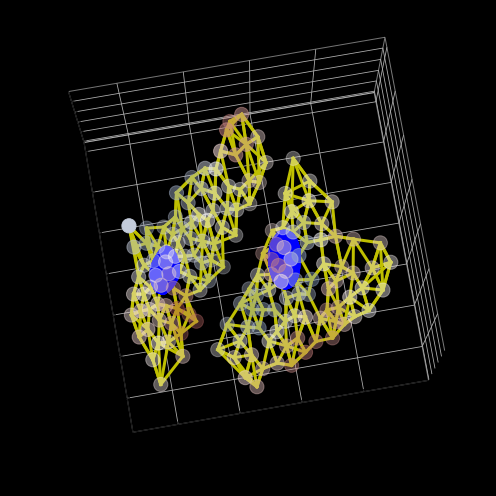

In [346]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(uc_034_patches['row']*scale,uc_034_patches['col']*scale,uc_034_patches['z']*z_scale,s=200,
           c = uc_034_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(uc_034_2_filtered_edges)):
    item = uc_034_2_filtered_edges[i]
    edge_c = edge_cmap(uc_034_2_edge_colors[i])
    ax.plot([uc_034_2_proxi.loc[item[0]]['row'].astype('float')*scale, uc_034_2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_034_2_proxi.loc[item[0]]['col'].astype('float')*scale, uc_034_2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_034_2_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_034_2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_034_8_filtered_edges)):
    item = uc_034_8_filtered_edges[i]
    edge_c = edge_cmap(uc_034_8_edge_colors[i])
    ax.plot([uc_034_8_proxi.loc[item[0]]['row'].astype('float')*scale, uc_034_8_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_034_8_proxi.loc[item[0]]['col'].astype('float')*scale, uc_034_8_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_034_8_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_034_8_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_034_02-08_embedding_24_interactions.png')

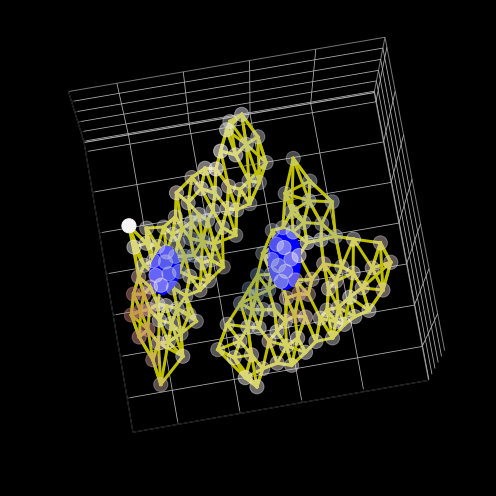

In [347]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(uc_034_patches['row']*scale,uc_034_patches['col']*scale,uc_034_patches['z']*z_scale,s=200,
           c = uc_034_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(uc_034_2_filtered_edges)):
    item = uc_034_2_filtered_edges[i]
    edge_c = edge_cmap(uc_034_2_edge_colors[i])
    ax.plot([uc_034_2_proxi.loc[item[0]]['row'].astype('float')*scale, uc_034_2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_034_2_proxi.loc[item[0]]['col'].astype('float')*scale, uc_034_2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_034_2_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_034_2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_034_8_filtered_edges)):
    item = uc_034_8_filtered_edges[i]
    edge_c = edge_cmap(uc_034_8_edge_colors[i])
    ax.plot([uc_034_8_proxi.loc[item[0]]['row'].astype('float')*scale, uc_034_8_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_034_8_proxi.loc[item[0]]['col'].astype('float')*scale, uc_034_8_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_034_8_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_034_8_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_034_02-08_embedding_59_interactions.png')

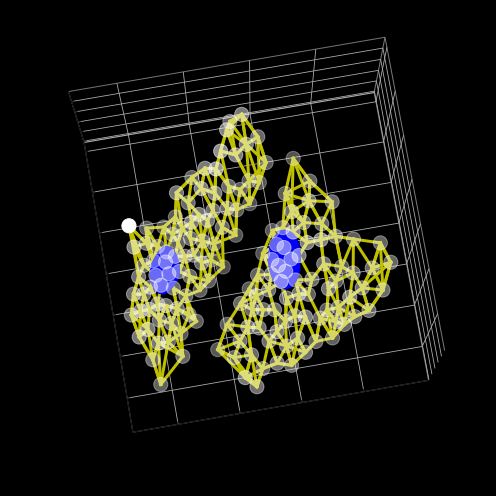

In [348]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
ax.scatter(uc_034_patches['row']*scale,uc_034_patches['col']*scale,uc_034_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_034_2_filtered_edges)):
    item = uc_034_2_filtered_edges[i]
    edge_c = edge_cmap(uc_034_2_edge_colors[i])
    ax.plot([uc_034_2_proxi.loc[item[0]]['row'].astype('float')*scale, uc_034_2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_034_2_proxi.loc[item[0]]['col'].astype('float')*scale, uc_034_2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_034_2_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_034_2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(uc_034_8_filtered_edges)):
    item = uc_034_8_filtered_edges[i]
    edge_c = edge_cmap(uc_034_8_edge_colors[i])
    ax.plot([uc_034_8_proxi.loc[item[0]]['row'].astype('float')*scale, uc_034_8_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_034_8_proxi.loc[item[0]]['col'].astype('float')*scale, uc_034_8_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_034_8_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_034_8_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_034_02-08_patch_networks.png')

In [349]:
patch_labels = []
uc_034_2_patches = uc_034_patches[uc_034_patches['cellID']=='uc_034_02']
for item in uc_034_2_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

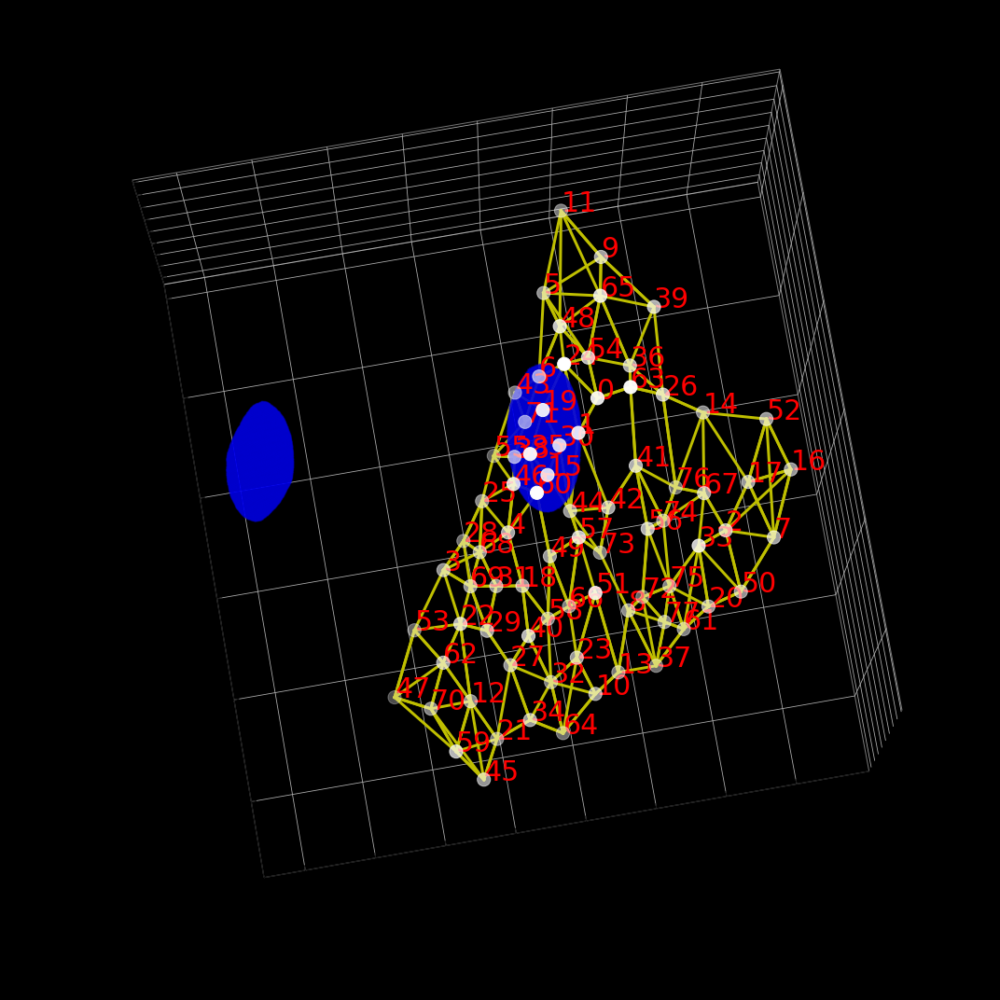

In [350]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
uc_034_2_patches = uc_034_patches[uc_034_patches['cellID']=='uc_034_02']
ax.scatter(uc_034_2_patches['row']*scale,uc_034_2_patches['col']*scale,uc_034_2_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_034_2_filtered_edges)):
    item = uc_034_2_filtered_edges[i]
    edge_c = edge_cmap(uc_034_2_edge_colors[i])
    ax.plot([uc_034_2_proxi.loc[item[0]]['row'].astype('float')*scale, uc_034_2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_034_2_proxi.loc[item[0]]['col'].astype('float')*scale, uc_034_2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_034_2_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_034_2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in uc_034_2_patches.index.tolist():
    ax.text(uc_034_2_patches.loc[idx]['row']*scale,
            uc_034_2_patches.loc[idx]['col']*scale,
            uc_034_2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [351]:
patch_labels = []
uc_034_8_patches = uc_034_patches[uc_034_patches['cellID']=='uc_034_08']
for item in uc_034_8_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

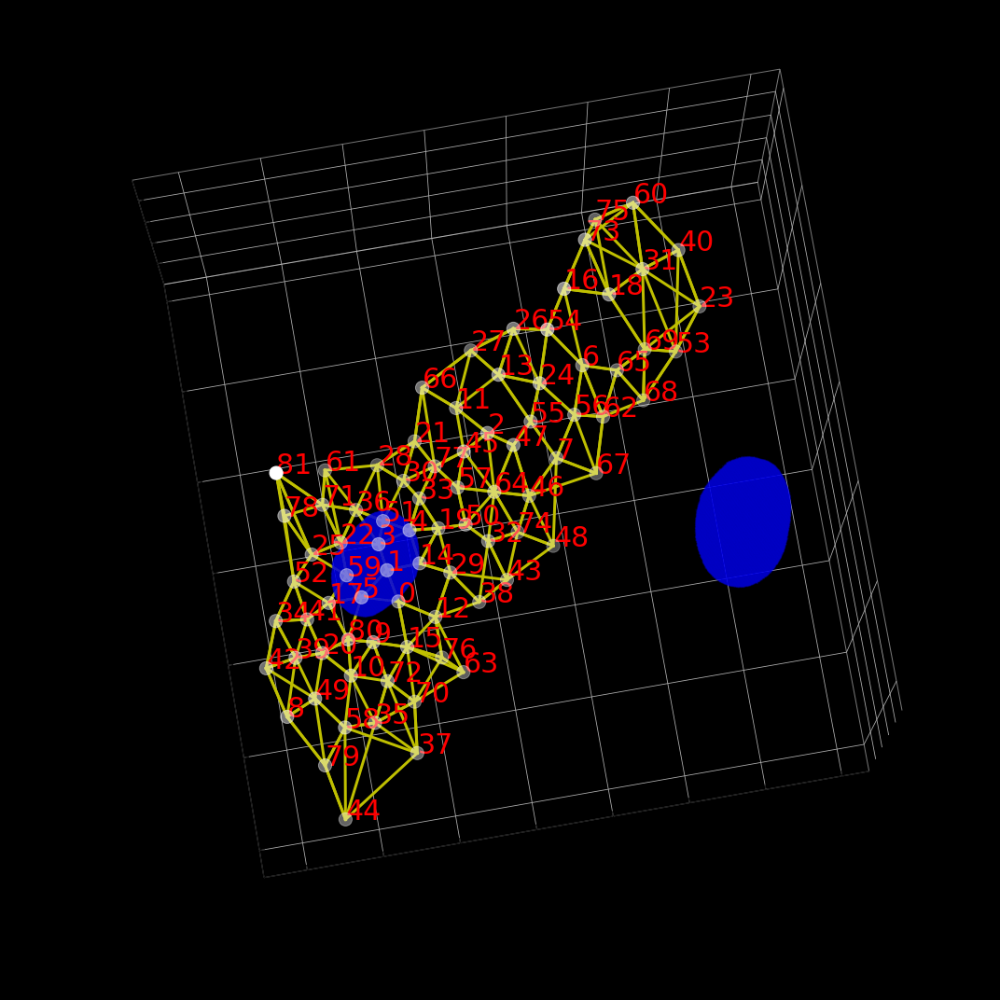

In [352]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
uc_034_8_patches = uc_034_patches[uc_034_patches['cellID']=='uc_034_08']
ax.scatter(uc_034_8_patches['row']*scale,uc_034_8_patches['col']*scale,uc_034_8_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(uc_034_8_filtered_edges)):
    item = uc_034_8_filtered_edges[i]
    edge_c = edge_cmap(uc_034_8_edge_colors[i])
    ax.plot([uc_034_8_proxi.loc[item[0]]['row'].astype('float')*scale, uc_034_8_proxi.loc[item[1]]['row'].astype('float')*scale],
            [uc_034_8_proxi.loc[item[0]]['col'].astype('float')*scale, uc_034_8_proxi.loc[item[1]]['col'].astype('float')*scale],
            [uc_034_8_proxi.loc[item[0]]['z'].astype('float')*z_scale, uc_034_8_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in uc_034_8_patches.index.tolist():
    ax.text(uc_034_8_patches.loc[idx]['row']*scale,
            uc_034_8_patches.loc[idx]['col']*scale,
            uc_034_8_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [380]:
uc_034_2_boarder = [5,48,6,43,55,28,53,47,70,62,22,69,68,4,46,38,3,71,19,24,25]
uc_034_8_boarder = [23,53,68,62,67,48,43,38,12,63,70,15,76,0,29,32,74,46,7,56,65,6,69]

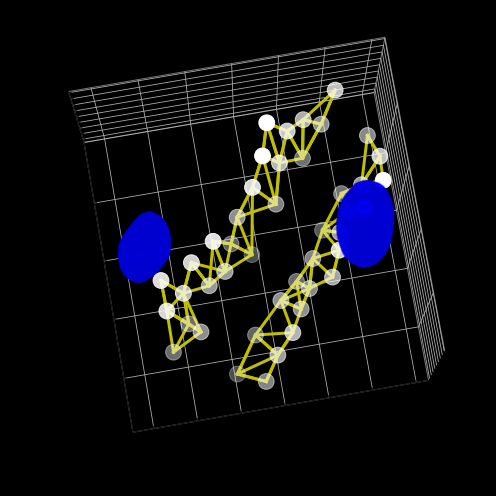

In [381]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

uc_034_2_patches = uc_034_patches[uc_034_patches['cellID']=='uc_034_02']
boarder_index = []
for p in uc_034_2_boarder:
    boarder_index.append('uc_034_02_'+str(p))
uc_034_2_patches = uc_034_2_patches.loc[boarder_index]
ax.scatter(uc_034_2_patches['row']*scale,uc_034_2_patches['col']*scale,uc_034_2_patches['z']*z_scale,s=250,
           color='w')

uc_034_8_patches = uc_034_patches[uc_034_patches['cellID']=='uc_034_08']
boarder_index = []
for p in uc_034_8_boarder:
    boarder_index.append('uc_034_08_'+str(p))
uc_034_8_patches = uc_034_8_patches.loc[boarder_index]
ax.scatter(uc_034_8_patches['row']*scale,uc_034_8_patches['col']*scale,uc_034_8_patches['z']*z_scale,s=250,
           color='w')


for edge in uc_034_2_filtered_edges:
    patch1 = uc_034_2_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_034_2_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_034_2_patches.index.tolist() and patch2 in uc_034_2_patches.index.tolist():
        ax.plot([uc_034_2_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_034_2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_034_2_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_034_2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_034_2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_034_2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in uc_034_8_filtered_edges:
    patch1 = uc_034_8_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_034_8_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_034_8_patches.index.tolist() and patch2 in uc_034_8_patches.index.tolist():
        ax.plot([uc_034_8_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_034_8_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_034_8_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_034_8_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_034_8_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_034_8_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\uc_034_02-08_boarder_patches.png')

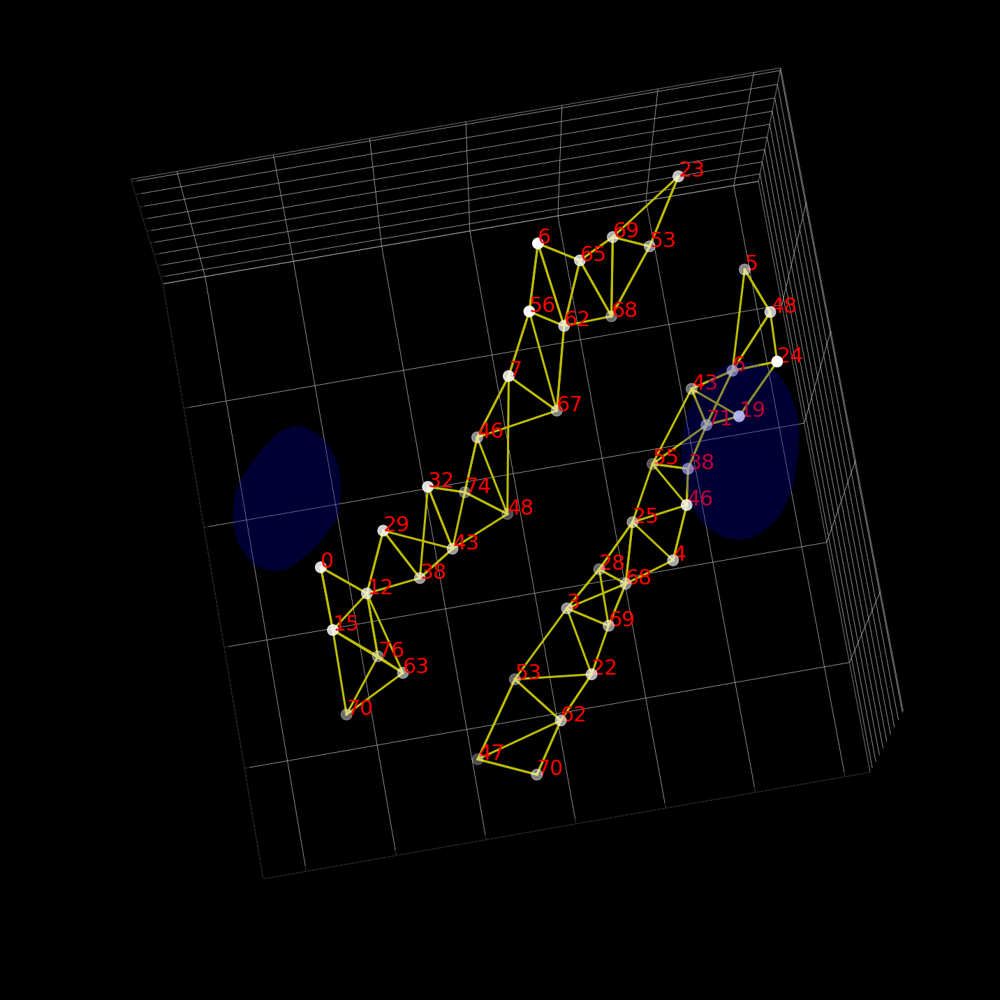

In [382]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

uc_034_2_patches = uc_034_patches[uc_034_patches['cellID']=='uc_034_02']
boarder_index = []
for p in uc_034_2_boarder:
    boarder_index.append('uc_034_02_'+str(p))
uc_034_2_patches = uc_034_2_patches.loc[boarder_index]
ax.scatter(uc_034_2_patches['row']*scale,uc_034_2_patches['col']*scale,uc_034_2_patches['z']*z_scale,s=250,
           color='w')

uc_034_8_patches = uc_034_patches[uc_034_patches['cellID']=='uc_034_08']
boarder_index = []
for p in uc_034_8_boarder:
    boarder_index.append('uc_034_08_'+str(p))
uc_034_8_patches = uc_034_8_patches.loc[boarder_index]
ax.scatter(uc_034_8_patches['row']*scale,uc_034_8_patches['col']*scale,uc_034_8_patches['z']*z_scale,s=250,
           color='w')


for edge in uc_034_2_filtered_edges:
    patch1 = uc_034_2_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_034_2_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_034_2_patches.index.tolist() and patch2 in uc_034_2_patches.index.tolist():
        ax.plot([uc_034_2_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_034_2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_034_2_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_034_2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_034_2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_034_2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in uc_034_8_filtered_edges:
    patch1 = uc_034_8_proxi.loc[edge[0]]['patch_name']
    patch2 = uc_034_8_proxi.loc[edge[1]]['patch_name']
    if patch1 in uc_034_8_patches.index.tolist() and patch2 in uc_034_8_patches.index.tolist():
        ax.plot([uc_034_8_proxi.loc[edge[0]]['row'].astype('float')*scale, uc_034_8_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [uc_034_8_proxi.loc[edge[0]]['col'].astype('float')*scale, uc_034_8_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [uc_034_8_proxi.loc[edge[0]]['z'].astype('float')*z_scale, uc_034_8_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

# for idx in uc_034_2_patches.index.tolist():
#     ax.text(uc_034_2_patches.loc[idx]['row']*scale,
#             uc_034_2_patches.loc[idx]['col']*scale,
#             uc_034_2_patches.loc[idx]['z']*z_scale,
#             idx.split('_')[-1],color='r',fontsize=30)



for idx in uc_034_8_patches.index.tolist():
    ax.text(uc_034_8_patches.loc[idx]['row']*scale,
            uc_034_8_patches.loc[idx]['col']*scale,
            uc_034_8_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in uc_034_2_patches.index.tolist():
    ax.text(uc_034_2_patches.loc[idx]['row']*scale,
            uc_034_2_patches.loc[idx]['col']*scale,
            uc_034_2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

#### important nodes and edges, 1,8 homo

In [392]:
cell1_explanation = pd.read_pickle(r'.\results\explainer\uc_034_01.pkl')
cell2_explanation = pd.read_pickle(r'.\results\explainer\uc_034_08.pkl')

In [393]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [394]:
proxi_by_cell = proxi_df.groupby('cellID')

In [395]:
cell1_proxi = proxi_by_cell.get_group('uc_034_01')
cell2_proxi = proxi_by_cell.get_group('uc_034_08')

In [396]:
cell1_edge_colors = cell1_explanation['edge_mask']
cell1_edge_colors = (cell1_edge_colors - cell1_edge_colors.min()) / (cell1_edge_colors.max() - cell1_edge_colors.min())

cell1_node_colors = cell1_explanation['node_mask']
cell1_node_colors = np.abs(cell1_node_colors)
cell1_node_colors = np.sum(cell1_node_colors,axis=1)
cell1_node_colors = (cell1_node_colors - cell1_node_colors.min()) / (cell1_node_colors.max() - cell1_node_colors.min())


cell2_edge_colors = cell2_explanation['edge_mask']
cell2_edge_colors = (cell2_edge_colors - cell2_edge_colors.min()) / (cell2_edge_colors.max() - cell2_edge_colors.min())

cell2_node_colors = cell2_explanation['node_mask']
cell2_node_colors = np.abs(cell2_node_colors)
cell2_node_colors = np.sum(cell2_node_colors,axis=1)
cell2_node_colors = (cell2_node_colors - cell2_node_colors.min()) / (cell2_node_colors.max() - cell2_node_colors.min())

In [397]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index('uc_034_01.pkl')
idx2 = fn_l.index('uc_034_08.pkl')

cell1_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        cell1_filtered_edges.append(item)

cell2_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        cell2_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\390761149.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


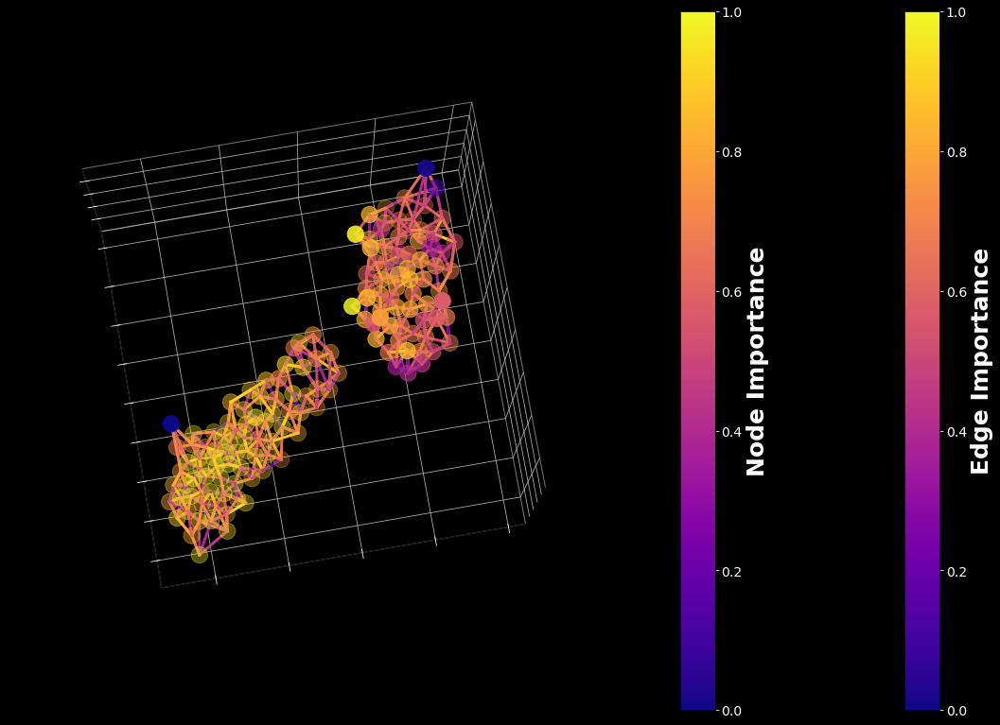

In [398]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(cell1_node_colors)
    ax.scatter(cell1_proxi['row']*scale, cell1_proxi['col']*scale, cell1_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(cell2_node_colors)
    ax.scatter(cell2_proxi['row']*scale, cell2_proxi['col']*scale, cell2_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(cell1_filtered_edges)):
        item = cell1_filtered_edges[i]
        edge_c = edge_cmap(uc_034_2_edge_colors[i])
        ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(cell2_filtered_edges)):
        item = cell2_filtered_edges[i]
        edge_c = edge_cmap(cell2_edge_colors[i])
        ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_034_01_08_graph_importance.png')

#### neighboring patches networks, uc_034_02 and uc_034_08

In [399]:
cell1 = embedding[embedding['cellID']=='uc_034_01']
cell2 = embedding[embedding['cellID']=='uc_034_08']
fov_patches = pd.concat([cell1,cell2])

In [400]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\masks\034_mask.tif')
mask = (mask==1).astype('int') + (mask==8).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\imgs\034_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

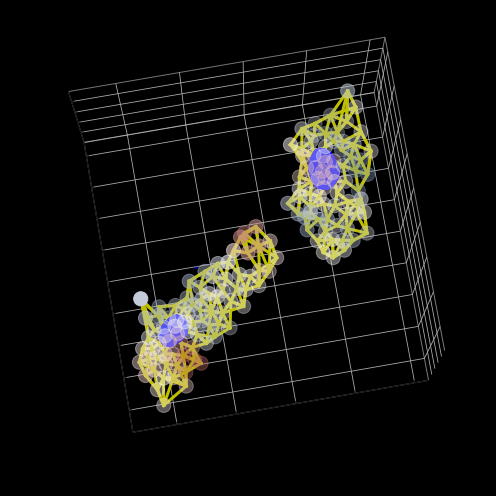

In [401]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_034_01-08_embedding_24_interactions.png')

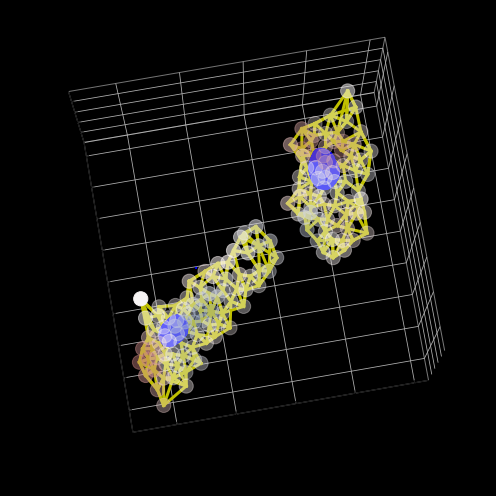

In [402]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_034_01-08_embedding_59_interactions.png')

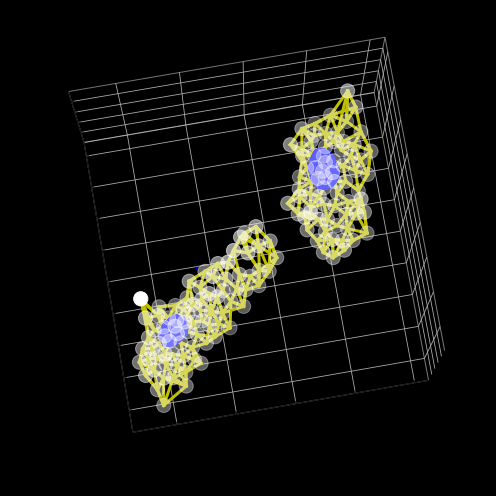

In [404]:
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = 'w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_034_01-08_patch_networks.png')

In [405]:
patch_labels = []
cell1_patches = fov_patches[fov_patches['cellID']=='uc_034_01']
for item in cell1_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

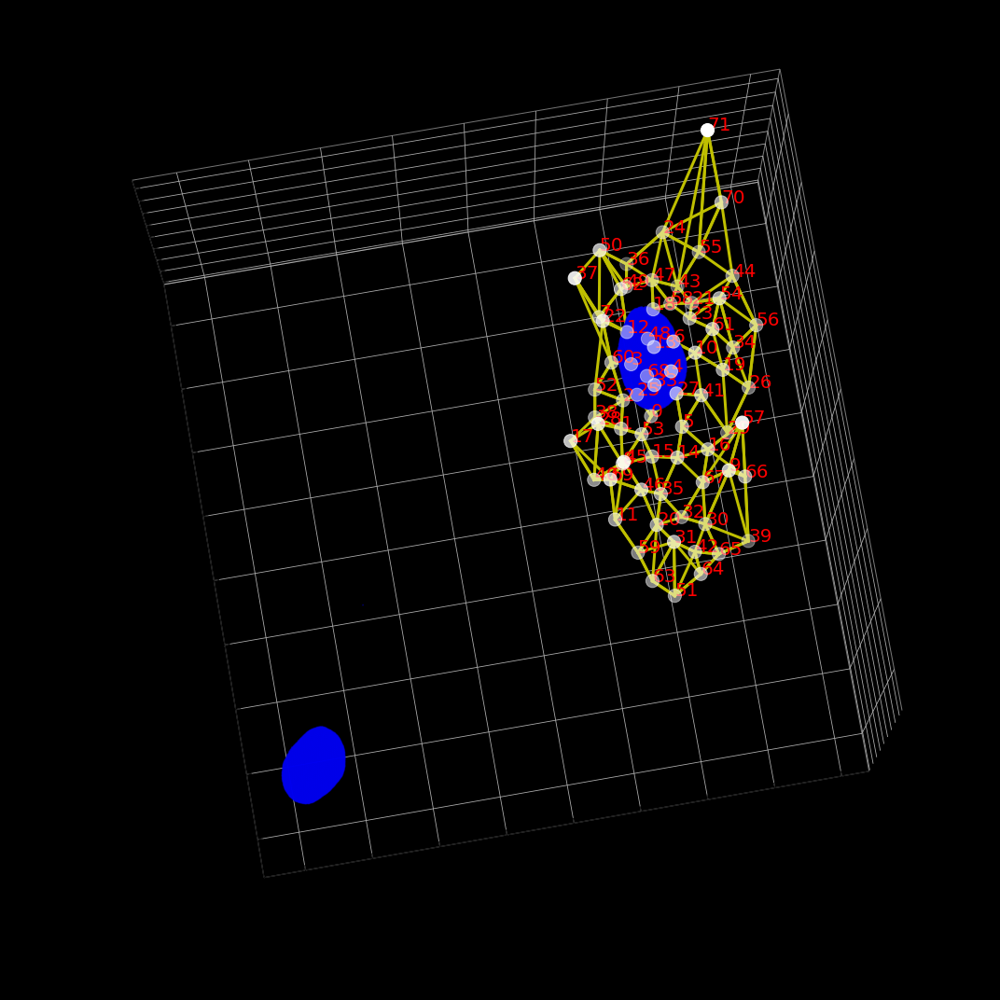

In [407]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell1_patches = fov_patches[fov_patches['cellID']=='uc_034_01']
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=20)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [408]:
patch_labels = []
cell2_patches = fov_patches[fov_patches['cellID']=='uc_034_08']
for item in cell2_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

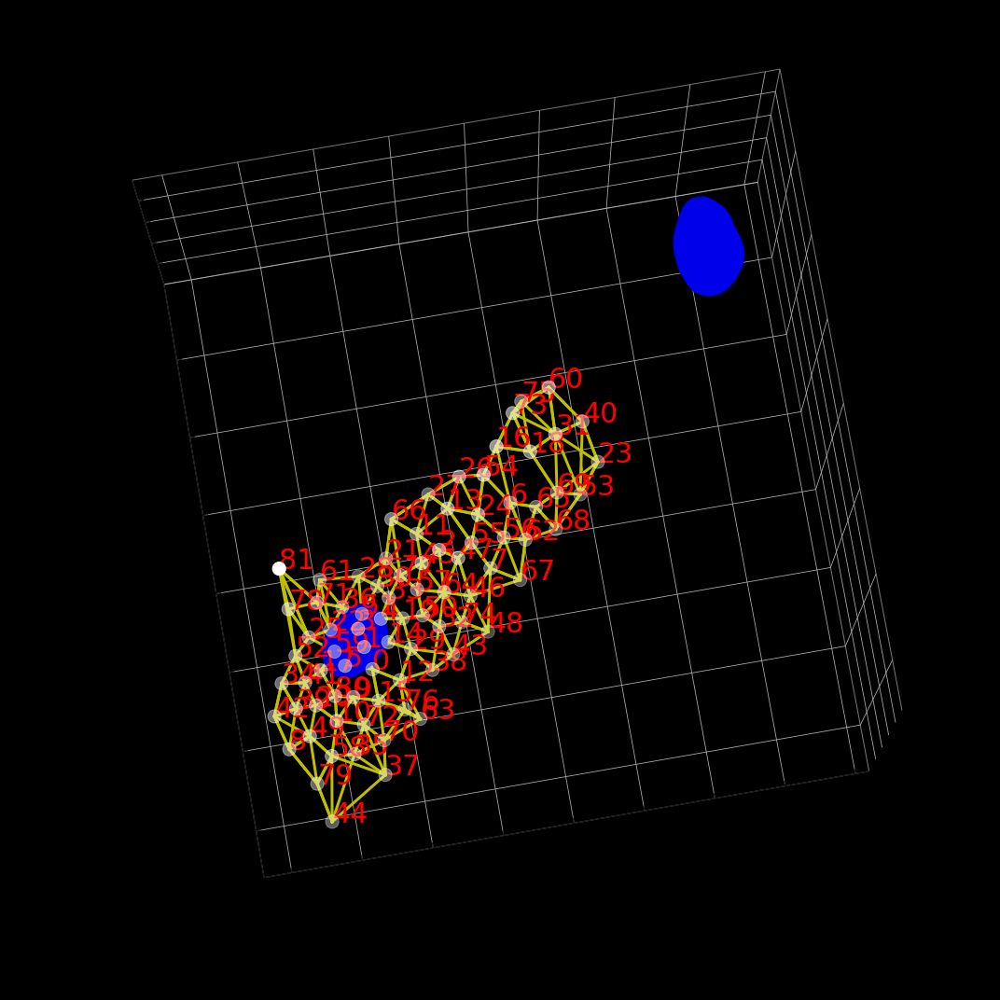

In [409]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell2_patches = fov_patches[fov_patches['cellID']=='uc_034_08']
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [419]:
cell1_boarder = [11,40,69,38,28,1,46,45]
cell2_boarder = [60,40,23,75,31,53]

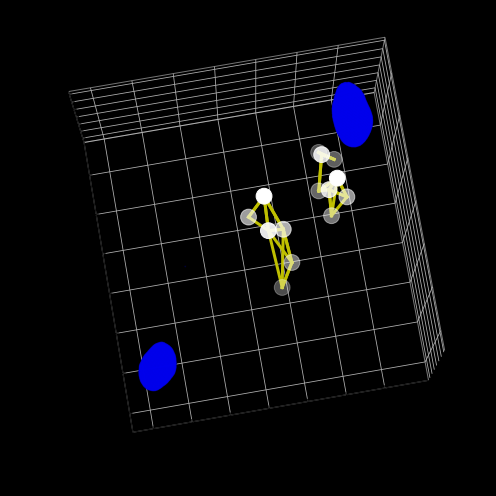

In [420]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']=='uc_034_01']
boarder_index = []
for p in cell1_boarder:
    boarder_index.append('uc_034_01_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']=='uc_034_08']
boarder_index = []
for p in cell2_boarder:
    boarder_index.append('uc_034_08_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\uc_034_01-08_boarder_patches.png')

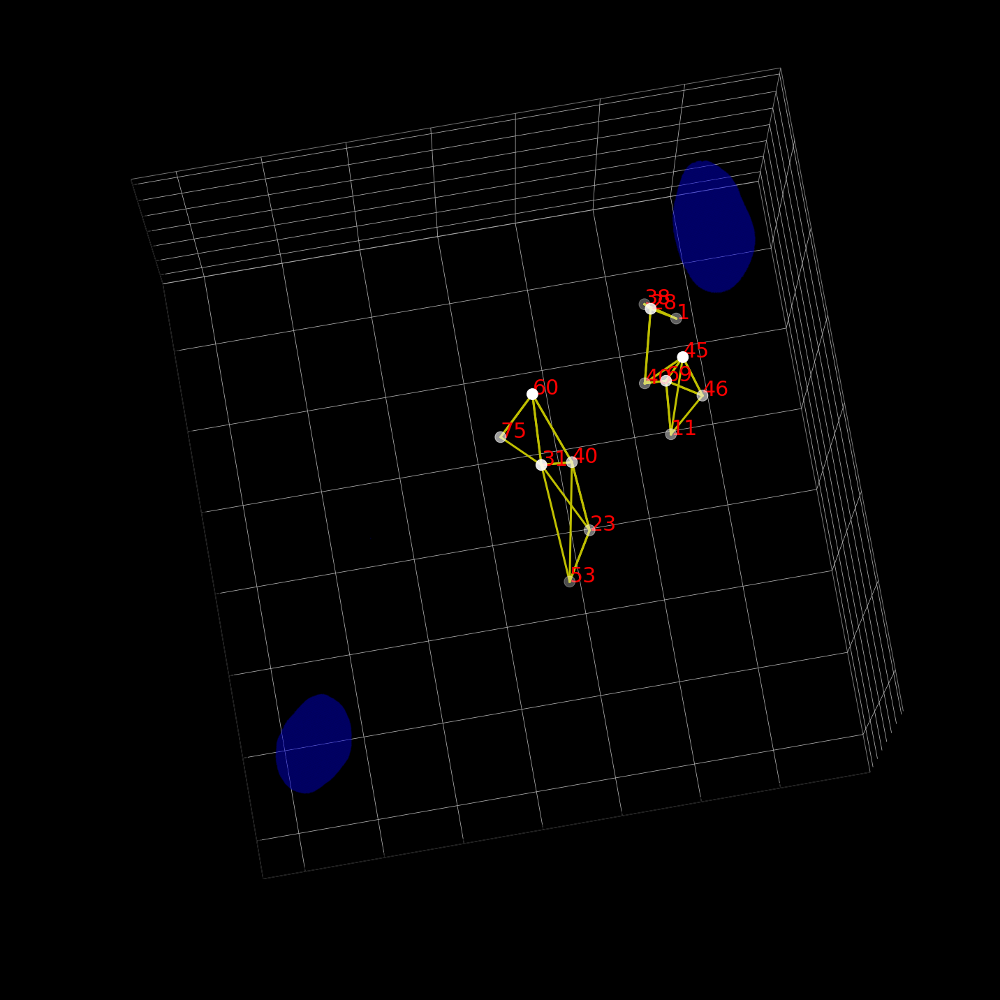

In [421]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']=='uc_034_01']
boarder_index = []
for p in cell1_boarder:
    boarder_index.append('uc_034_01_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']=='uc_034_08']
boarder_index = []
for p in cell2_boarder:
    boarder_index.append('uc_034_08_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

### uc 012, 4, 7, 8

#### uc 012 full fov

In [422]:
cells = ['uc_012_04','uc_012_07','uc_012_08']
uc_012_dist = distance_df[distance_df['fov']=='uc_012']

clusters = {}
for item in cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = count_adata.obs['leiden'].tolist()[idx]

In [423]:
clusters

{'uc_012_04': '2', 'uc_012_07': '2', 'uc_012_08': '8'}

In [425]:
fov_dots = []
clustering = []
for item in cells:
    fov_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
fov_dots = pd.concat(fov_dots)

In [426]:
fov_dots.insert(loc=fov_dots.shape[1], column='clustering', value=clustering)
dots_by_cluster = fov_dots.groupby('clustering')

In [427]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\masks\012_mask.tif')
mask = (mask==4).astype('int') + (mask==7).astype('int') + (mask==8).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
outline_row = []
outline_col = []
for i in range(1,3):
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

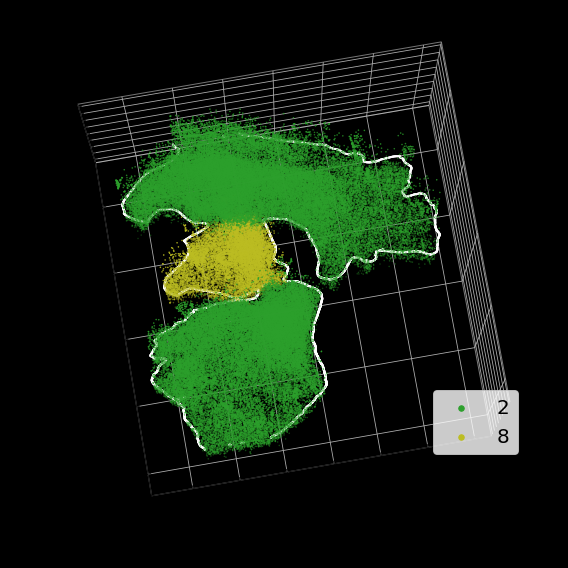

In [428]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='w')

for cluster in fov_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster)]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=0.3,color=color,label=cluster)

# for pair in distance_pairs:
#     ax.plot([uc_003_centers.loc[pair[0]]['row']*scale,uc_003_centers.loc[pair[1]]['row']*scale],
#             [uc_003_centers.loc[pair[0]]['col']*scale,uc_003_centers.loc[pair[1]]['col']*scale],
#             [(uc_003_centers.loc[pair[0]]['z']*z_scale)-25,(uc_003_centers.loc[pair[1]]['z']*z_scale)-25],
#             color='r',linewidth=5)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=10)

plt.tight_layout()

plt.savefig(r'.\figures\uc_012_count_cluster_colored.png',dpi=300)

#### important nodes and edges, 4,7 homo

In [429]:
cell1_explanation = pd.read_pickle(r'.\results\explainer\uc_012_04.pkl')
cell2_explanation = pd.read_pickle(r'.\results\explainer\uc_012_07.pkl')

In [430]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [431]:
proxi_by_cell = proxi_df.groupby('cellID')

In [432]:
cell1_proxi = proxi_by_cell.get_group('uc_012_04')
cell2_proxi = proxi_by_cell.get_group('uc_012_07')

In [433]:
cell1_edge_colors = cell1_explanation['edge_mask']
cell1_edge_colors = (cell1_edge_colors - cell1_edge_colors.min()) / (cell1_edge_colors.max() - cell1_edge_colors.min())

cell1_node_colors = cell1_explanation['node_mask']
cell1_node_colors = np.abs(cell1_node_colors)
cell1_node_colors = np.sum(cell1_node_colors,axis=1)
cell1_node_colors = (cell1_node_colors - cell1_node_colors.min()) / (cell1_node_colors.max() - cell1_node_colors.min())


cell2_edge_colors = cell2_explanation['edge_mask']
cell2_edge_colors = (cell2_edge_colors - cell2_edge_colors.min()) / (cell2_edge_colors.max() - cell2_edge_colors.min())

cell2_node_colors = cell2_explanation['node_mask']
cell2_node_colors = np.abs(cell2_node_colors)
cell2_node_colors = np.sum(cell2_node_colors,axis=1)
cell2_node_colors = (cell2_node_colors - cell2_node_colors.min()) / (cell2_node_colors.max() - cell2_node_colors.min())

In [434]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index('uc_012_04.pkl')
idx2 = fn_l.index('uc_012_07.pkl')

cell1_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        cell1_filtered_edges.append(item)

cell2_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        cell2_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\3302921709.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


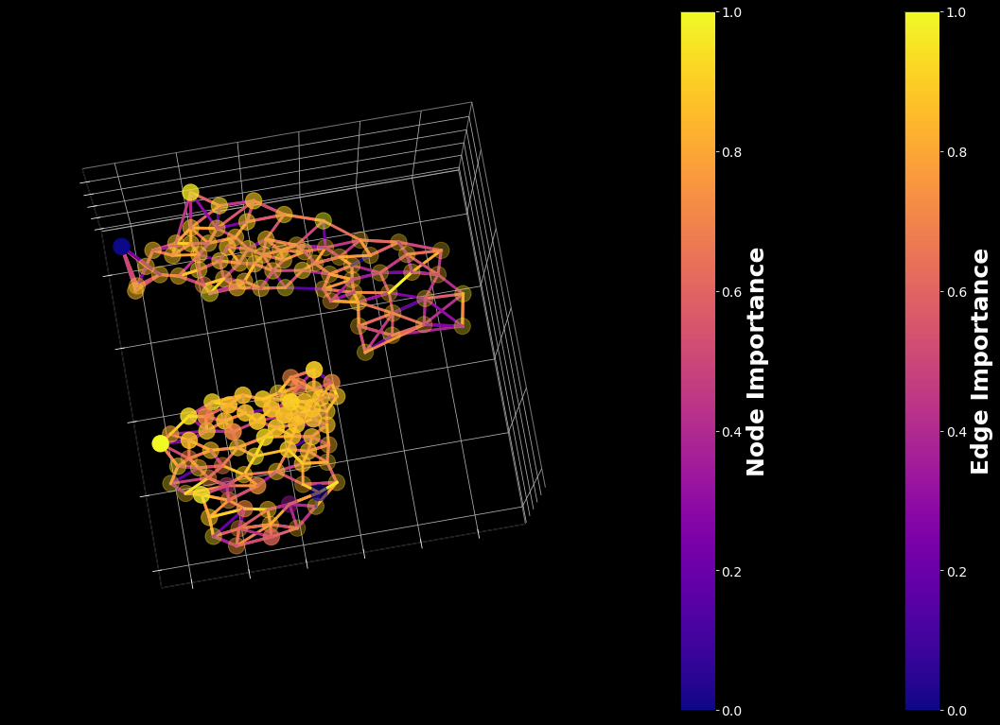

In [435]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(cell1_node_colors)
    ax.scatter(cell1_proxi['row']*scale, cell1_proxi['col']*scale, cell1_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(cell2_node_colors)
    ax.scatter(cell2_proxi['row']*scale, cell2_proxi['col']*scale, cell2_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(cell1_filtered_edges)):
        item = cell1_filtered_edges[i]
        edge_c = edge_cmap(uc_034_2_edge_colors[i])
        ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(cell2_filtered_edges)):
        item = cell2_filtered_edges[i]
        edge_c = edge_cmap(cell2_edge_colors[i])
        ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_012_04_07_graph_importance.png')

#### neighboring patches networks, uc_012_04 and uc_012_07

In [436]:
cell1 = embedding[embedding['cellID']=='uc_012_04']
cell2 = embedding[embedding['cellID']=='uc_012_07']
fov_patches = pd.concat([cell1,cell2])

In [437]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\masks\012_mask.tif')
mask = (mask==4).astype('int') + (mask==7).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\uc_rgb_combined\imgs\012_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

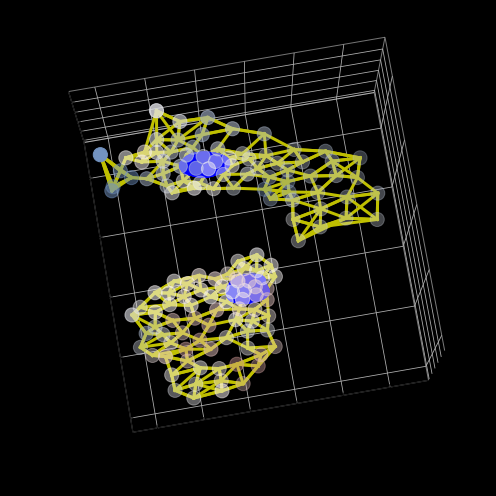

In [438]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_012_04-07_embedding_24_interactions.png')

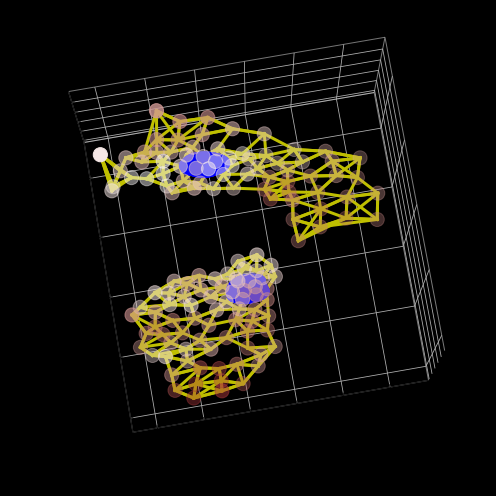

In [439]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_012_04-07_embedding_59_interactions.png')

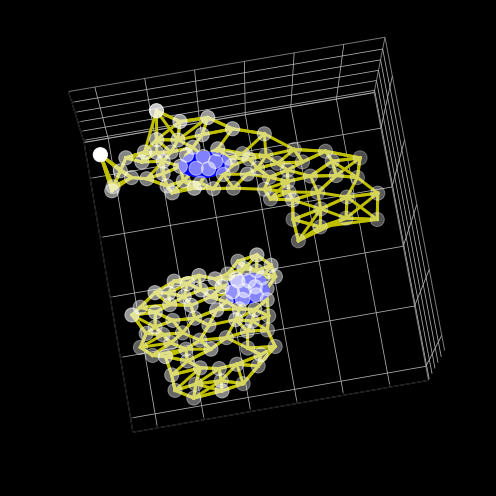

In [440]:
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = 'w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\uc_012_04-07_patch_networks.png')

In [441]:
patch_labels = []
cell1_patches = fov_patches[fov_patches['cellID']=='uc_012_04']
for item in cell1_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

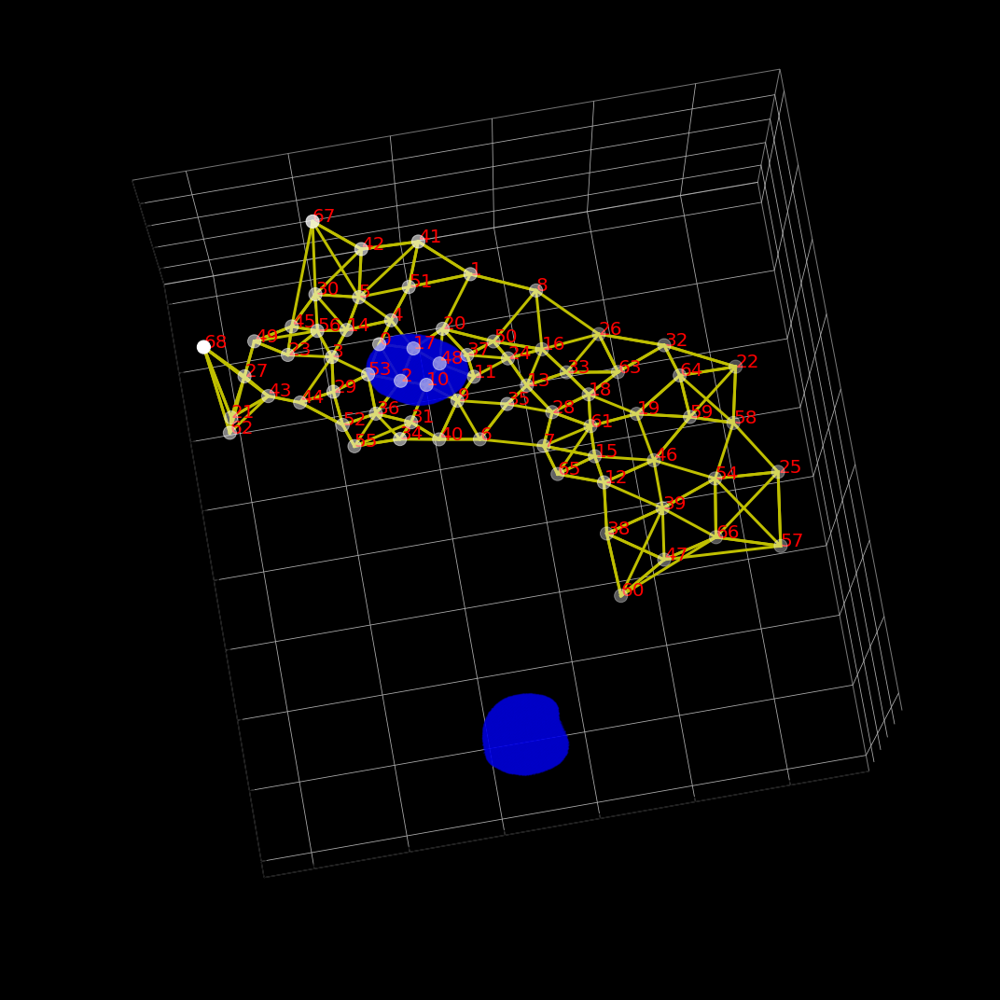

In [442]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell1_patches = fov_patches[fov_patches['cellID']=='uc_012_04']
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=20)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [443]:
patch_labels = []
cell2_patches = fov_patches[fov_patches['cellID']=='uc_012_07']
for item in cell2_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

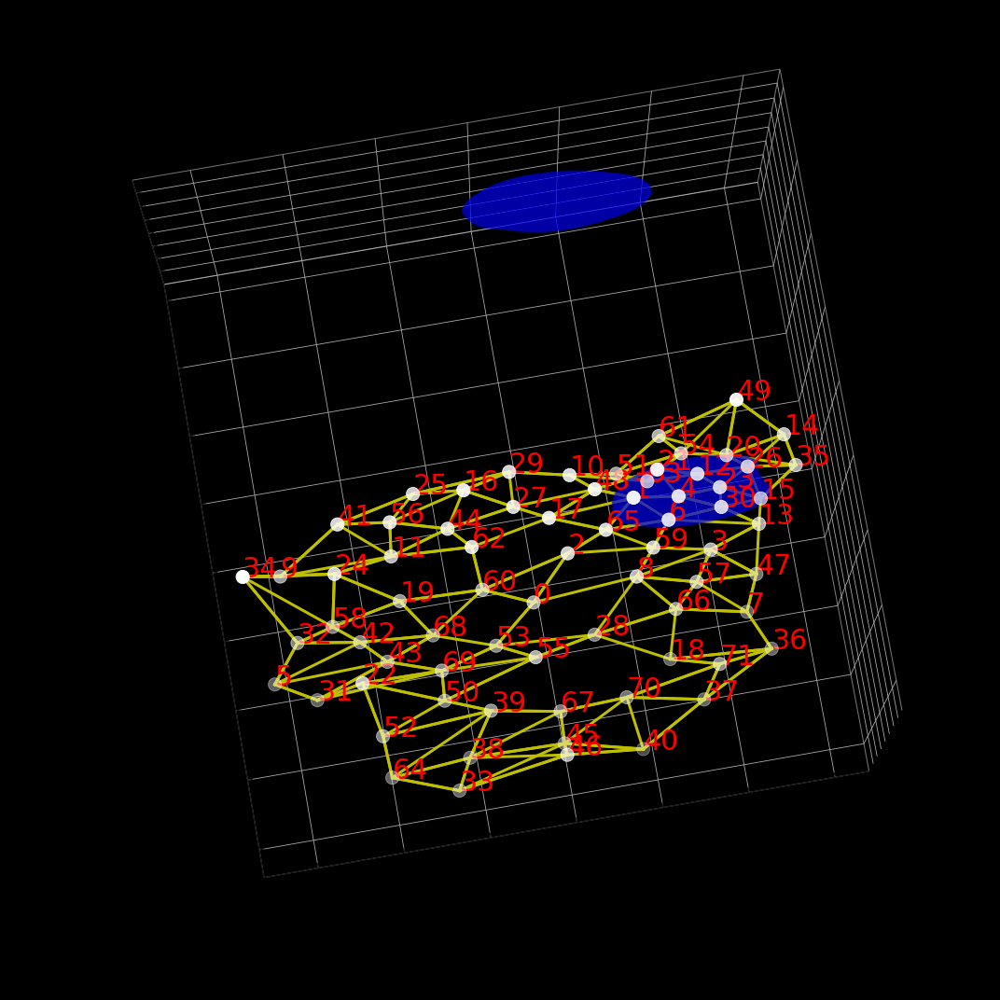

In [444]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell2_patches = fov_patches[fov_patches['cellID']=='uc_012_07']
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [449]:
cell1_boarder = [60,47,38,39,66]
cell2_boarder = [49,14,61,54,20,35]

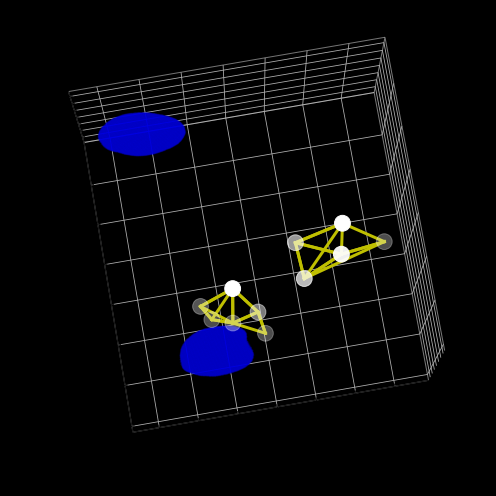

In [450]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']=='uc_012_04']
boarder_index = []
for p in cell1_boarder:
    boarder_index.append('uc_012_04_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']=='uc_012_07']
boarder_index = []
for p in cell2_boarder:
    boarder_index.append('uc_012_07_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\uc_012_04-07_boarder_patches.png')

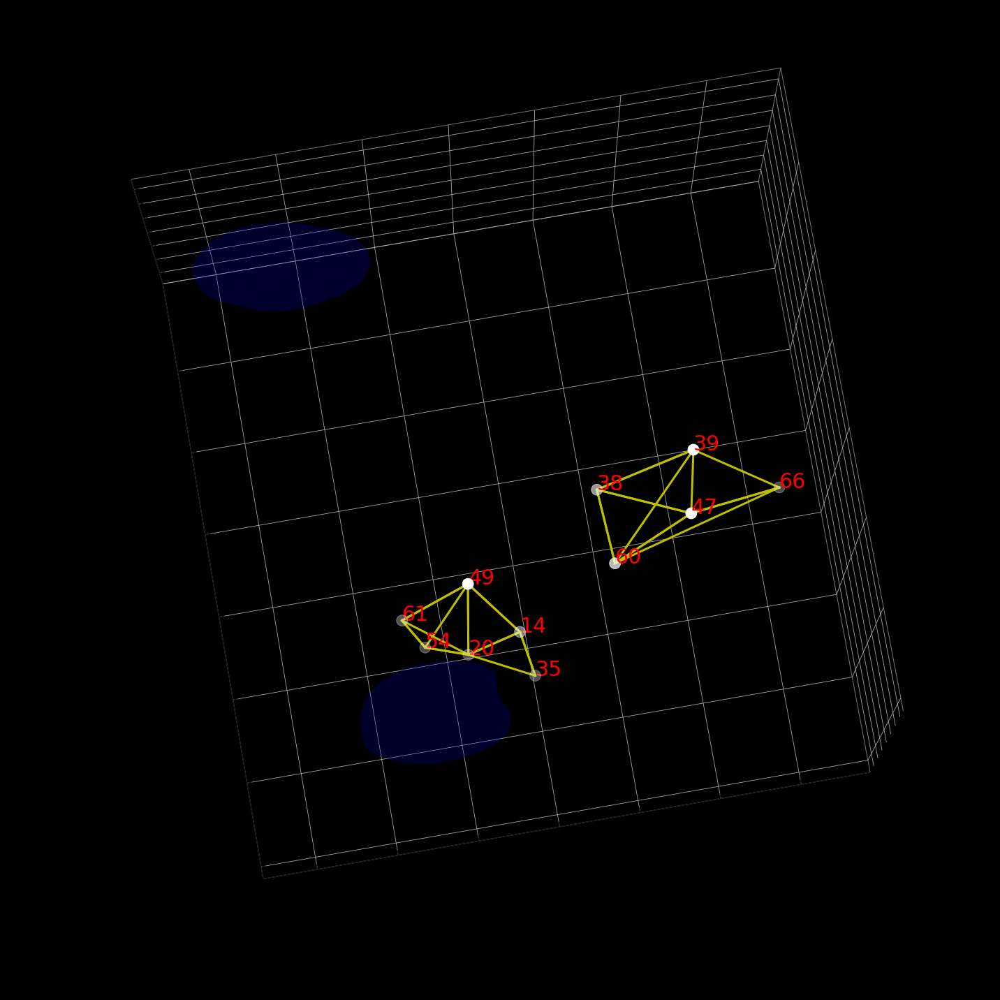

In [451]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']=='uc_012_04']
boarder_index = []
for p in cell1_boarder:
    boarder_index.append('uc_012_04_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']=='uc_012_07']
boarder_index = []
for p in cell2_boarder:
    boarder_index.append('uc_012_07_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

### bm 006, 10,11,12

#### bm 006 full fov

In [453]:
cells = ['bm_006_10','bm_006_11','bm_006_12']
fov_dist = distance_df[distance_df['fov']=='bm_006']

clusters = {}
for item in cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = count_adata.obs['leiden'].tolist()[idx]

In [454]:
clusters

{'bm_006_10': '0', 'bm_006_11': '0', 'bm_006_12': '0'}

In [455]:
fov_dots = []
clustering = []
for item in cells:
    fov_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
fov_dots = pd.concat(fov_dots)

In [456]:
fov_dots.insert(loc=fov_dots.shape[1], column='clustering', value=clustering)
dots_by_cluster = fov_dots.groupby('clustering')

In [457]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\006_mask.tif')
mask = (mask==10).astype('int') + (mask==11).astype('int') + (mask==12).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
outline_row = []
outline_col = []
for i in range(1,3):
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

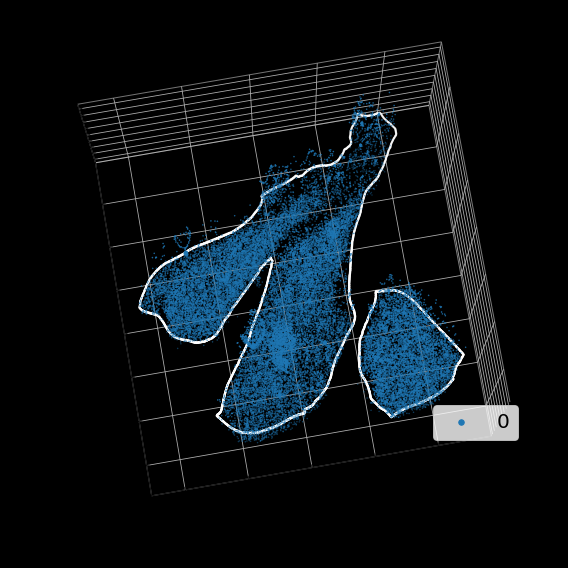

In [458]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='w')

for cluster in fov_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster)]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=0.3,color=color,label=cluster)

# for pair in distance_pairs:
#     ax.plot([uc_003_centers.loc[pair[0]]['row']*scale,uc_003_centers.loc[pair[1]]['row']*scale],
#             [uc_003_centers.loc[pair[0]]['col']*scale,uc_003_centers.loc[pair[1]]['col']*scale],
#             [(uc_003_centers.loc[pair[0]]['z']*z_scale)-25,(uc_003_centers.loc[pair[1]]['z']*z_scale)-25],
#             color='r',linewidth=5)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=10)

plt.tight_layout()

plt.savefig(r'.\figures\bm_006_count_cluster_colored.png',dpi=300)

#### bm_006 10,11 node importance

In [478]:
cell1 = 'bm_006_11'
cell2 = 'bm_006_12'
cell1_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell1+'.pkl'))
cell2_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell2+'.pkl'))

In [18]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [471]:
proxi_by_cell = proxi_df.groupby('cellID')

In [472]:
cell1_proxi = proxi_by_cell.get_group(cell1)
cell2_proxi = proxi_by_cell.get_group(cell2)

In [473]:
cell1_edge_colors = cell1_explanation['edge_mask']
cell1_edge_colors = (cell1_edge_colors - cell1_edge_colors.min()) / (cell1_edge_colors.max() - cell1_edge_colors.min())

cell1_node_colors = cell1_explanation['node_mask']
cell1_node_colors = np.abs(cell1_node_colors)
cell1_node_colors = np.sum(cell1_node_colors,axis=1)
cell1_node_colors = (cell1_node_colors - cell1_node_colors.min()) / (cell1_node_colors.max() - cell1_node_colors.min())


cell2_edge_colors = cell2_explanation['edge_mask']
cell2_edge_colors = (cell2_edge_colors - cell2_edge_colors.min()) / (cell2_edge_colors.max() - cell2_edge_colors.min())

cell2_node_colors = cell2_explanation['node_mask']
cell2_node_colors = np.abs(cell2_node_colors)
cell2_node_colors = np.sum(cell2_node_colors,axis=1)
cell2_node_colors = (cell2_node_colors - cell2_node_colors.min()) / (cell2_node_colors.max() - cell2_node_colors.min())

In [474]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index(cell1+'.pkl')
idx2 = fn_l.index(cell2+'.pkl')

cell1_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        cell1_filtered_edges.append(item)

cell2_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        cell2_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\622424494.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


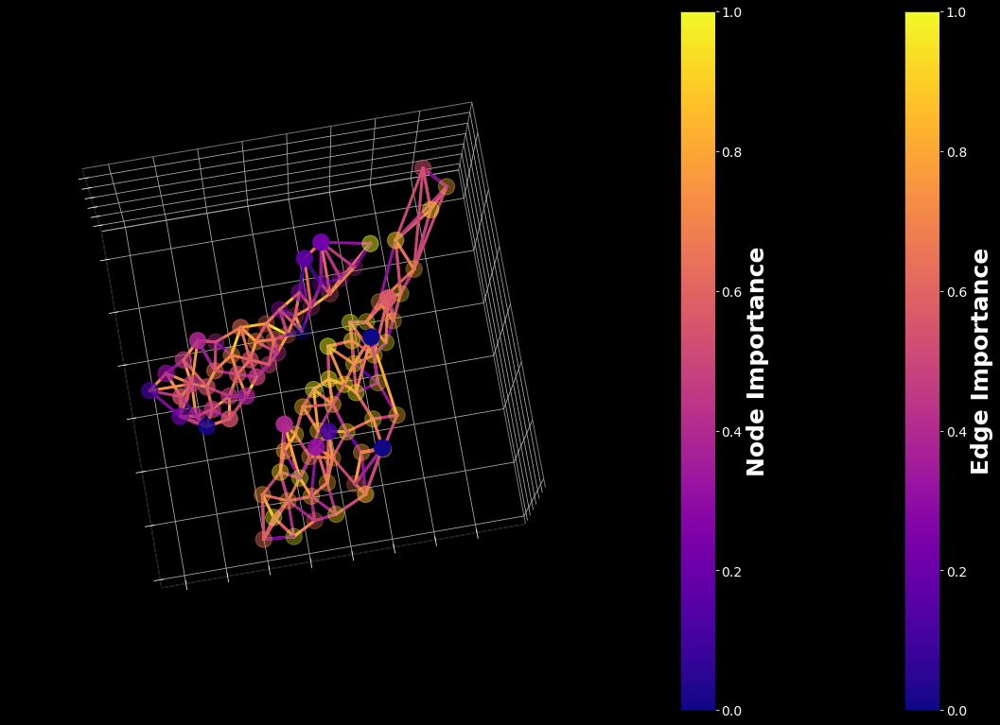

In [475]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(cell1_node_colors)
    ax.scatter(cell1_proxi['row']*scale, cell1_proxi['col']*scale, cell1_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(cell2_node_colors)
    ax.scatter(cell2_proxi['row']*scale, cell2_proxi['col']*scale, cell2_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(cell1_filtered_edges)):
        item = cell1_filtered_edges[i]
        edge_c = edge_cmap(uc_034_2_edge_colors[i])
        ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(cell2_filtered_edges)):
        item = cell2_filtered_edges[i]
        edge_c = edge_cmap(cell2_edge_colors[i])
        ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_006_11_12_graph_importance.png')

#### neighboring patches networks, uc_012_04 and uc_012_07

In [481]:
cell1_embedding = embedding[embedding['cellID']==cell1]
cell2_embedding = embedding[embedding['cellID']==cell2]
fov_patches = pd.concat([cell1_embedding,cell2_embedding])

In [482]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\006_mask.tif')
mask = (mask==11).astype('int') + (mask==12).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\imgs\006_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

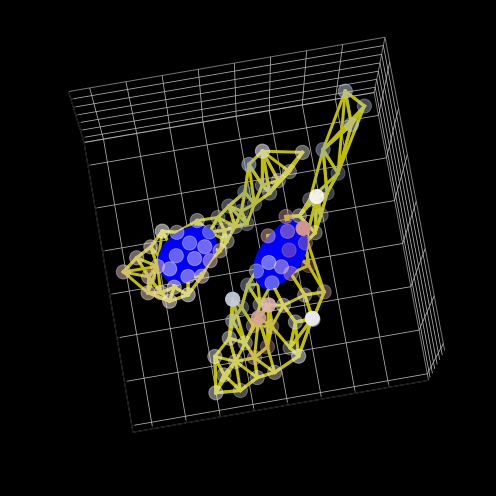

In [483]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_006_11-12_embedding_24_interactions.png')

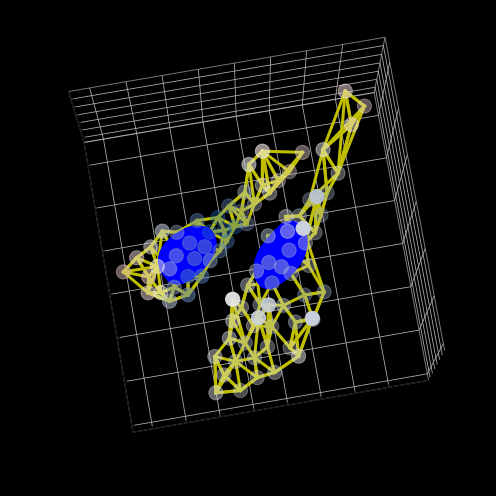

In [484]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_006_11-12_embedding_59_interactions.png')

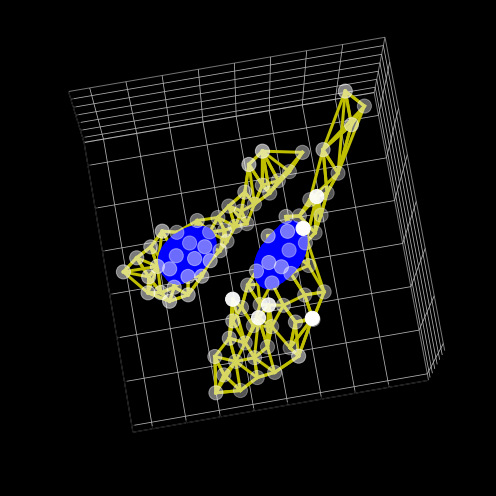

In [485]:
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = 'w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_006_11-12_patch_networks.png')

In [486]:
patch_labels = []
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
for item in cell1_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

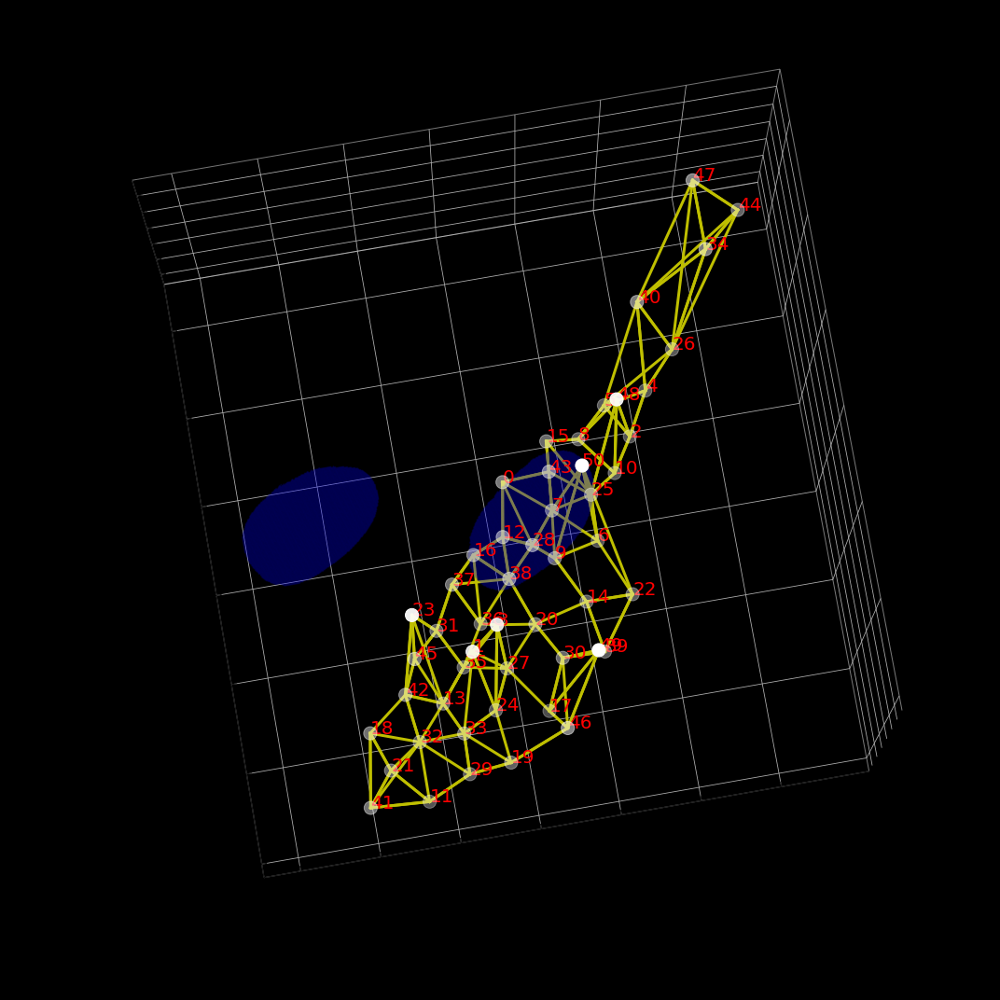

In [487]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=20)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [488]:
patch_labels = []
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
for item in cell2_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

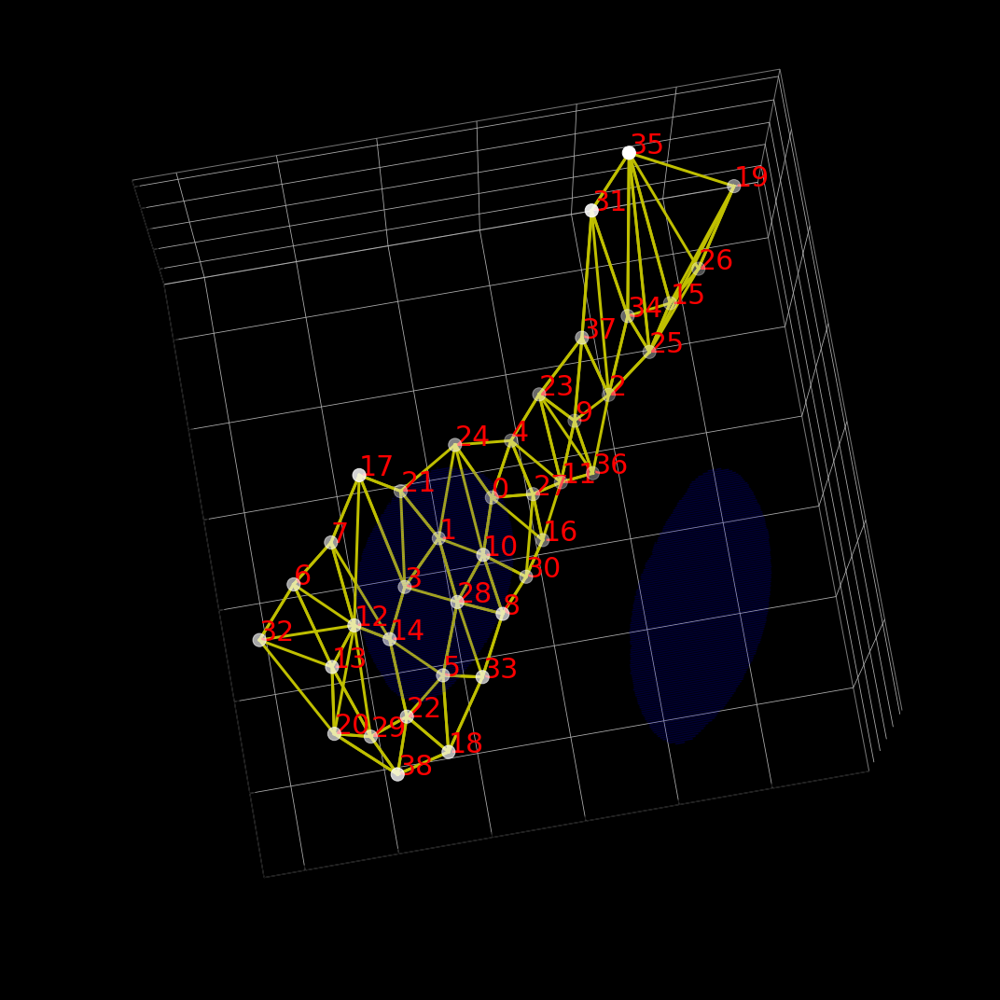

In [489]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [490]:
cell1_boarder = [47,40,5,8,15,0,12,16,37,23,31,45,42,18,32,13,35,1,36,38,28,7,25,10,2,4,26,34]
cell2_boarder = [33,8,30,16,11,36,2,25,15,26,34,37,9,27,0,10,28,5,18]

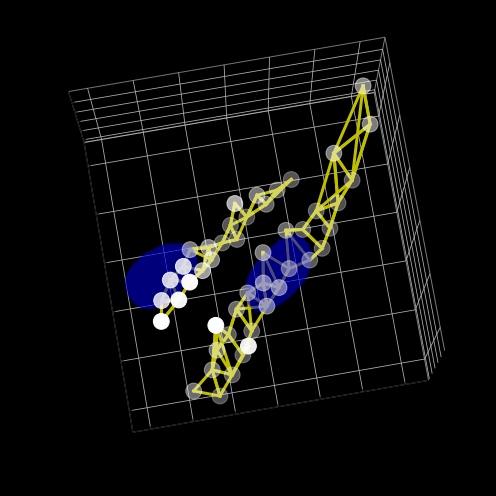

In [493]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\bm_006_11-12_boarder_patches.png')

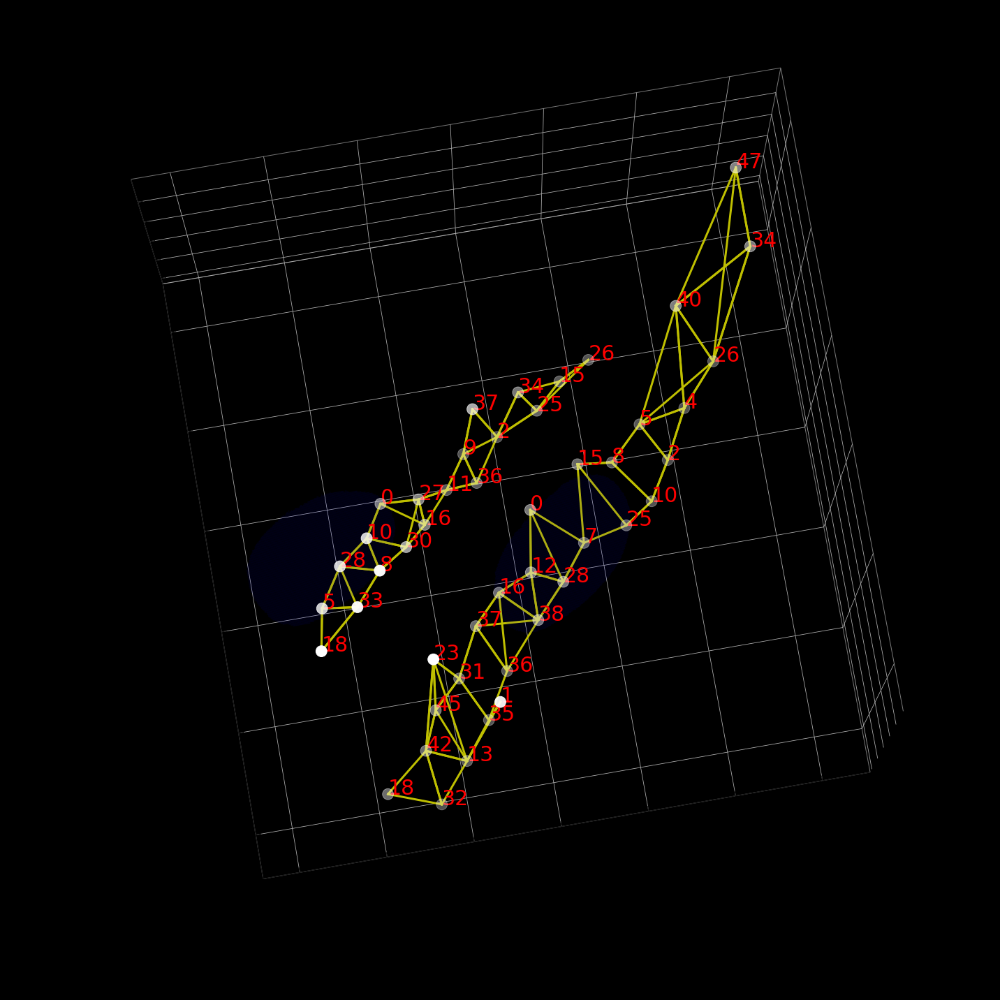

In [492]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

### bm007, 10, 11, 14

#### bm 007 full fov

In [514]:
cells = ['bm_007_10','bm_007_11','bm_007_14']
fov_dist = distance_df[distance_df['fov']=='bm_007']

clusters = {}
for item in cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = count_adata.obs['leiden'].tolist()[idx]

In [515]:
clusters

{'bm_007_10': '0', 'bm_007_11': '0', 'bm_007_14': '0'}

In [516]:
fov_dots = []
clustering = []
for item in cells:
    fov_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
fov_dots = pd.concat(fov_dots)

In [517]:
fov_dots.insert(loc=fov_dots.shape[1], column='clustering', value=clustering)
dots_by_cluster = fov_dots.groupby('clustering')

In [518]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\007_mask.tif')
mask = (mask==10).astype('int') + (mask==11).astype('int') + (mask==14).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
outline_row = []
outline_col = []
for i in range(1,3):
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

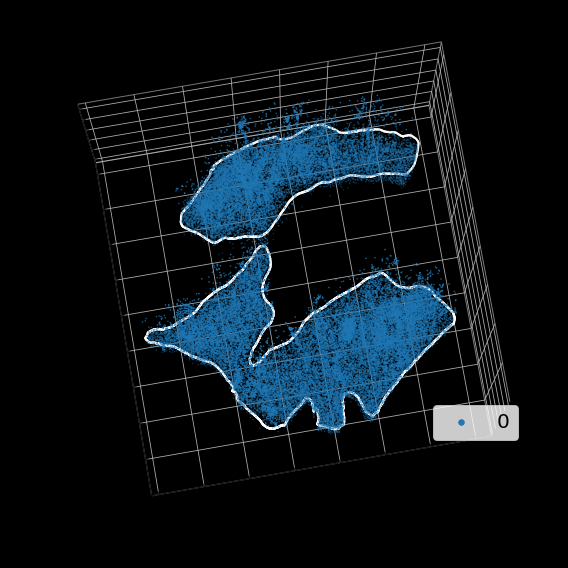

In [519]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='w')

for cluster in fov_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster)]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=0.3,color=color,label=cluster)

# for pair in distance_pairs:
#     ax.plot([uc_003_centers.loc[pair[0]]['row']*scale,uc_003_centers.loc[pair[1]]['row']*scale],
#             [uc_003_centers.loc[pair[0]]['col']*scale,uc_003_centers.loc[pair[1]]['col']*scale],
#             [(uc_003_centers.loc[pair[0]]['z']*z_scale)-25,(uc_003_centers.loc[pair[1]]['z']*z_scale)-25],
#             color='r',linewidth=5)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=10)

plt.tight_layout()

plt.savefig(r'.\figures\bm_007_count_cluster_colored.png',dpi=300)

#### bm_007 11,14 node importance

In [527]:
cell1 = 'bm_007_10'
cell2 = 'bm_007_14'
cell1_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell1+'.pkl'))
cell2_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell2+'.pkl'))

In [528]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [529]:
proxi_by_cell = proxi_df.groupby('cellID')

In [530]:
cell1_proxi = proxi_by_cell.get_group(cell1)
cell2_proxi = proxi_by_cell.get_group(cell2)

In [531]:
cell1_edge_colors = cell1_explanation['edge_mask']
cell1_edge_colors = (cell1_edge_colors - cell1_edge_colors.min()) / (cell1_edge_colors.max() - cell1_edge_colors.min())

cell1_node_colors = cell1_explanation['node_mask']
cell1_node_colors = np.abs(cell1_node_colors)
cell1_node_colors = np.sum(cell1_node_colors,axis=1)
cell1_node_colors = (cell1_node_colors - cell1_node_colors.min()) / (cell1_node_colors.max() - cell1_node_colors.min())


cell2_edge_colors = cell2_explanation['edge_mask']
cell2_edge_colors = (cell2_edge_colors - cell2_edge_colors.min()) / (cell2_edge_colors.max() - cell2_edge_colors.min())

cell2_node_colors = cell2_explanation['node_mask']
cell2_node_colors = np.abs(cell2_node_colors)
cell2_node_colors = np.sum(cell2_node_colors,axis=1)
cell2_node_colors = (cell2_node_colors - cell2_node_colors.min()) / (cell2_node_colors.max() - cell2_node_colors.min())

In [532]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index(cell1+'.pkl')
idx2 = fn_l.index(cell2+'.pkl')

cell1_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        cell1_filtered_edges.append(item)

cell2_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        cell2_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\3494886693.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


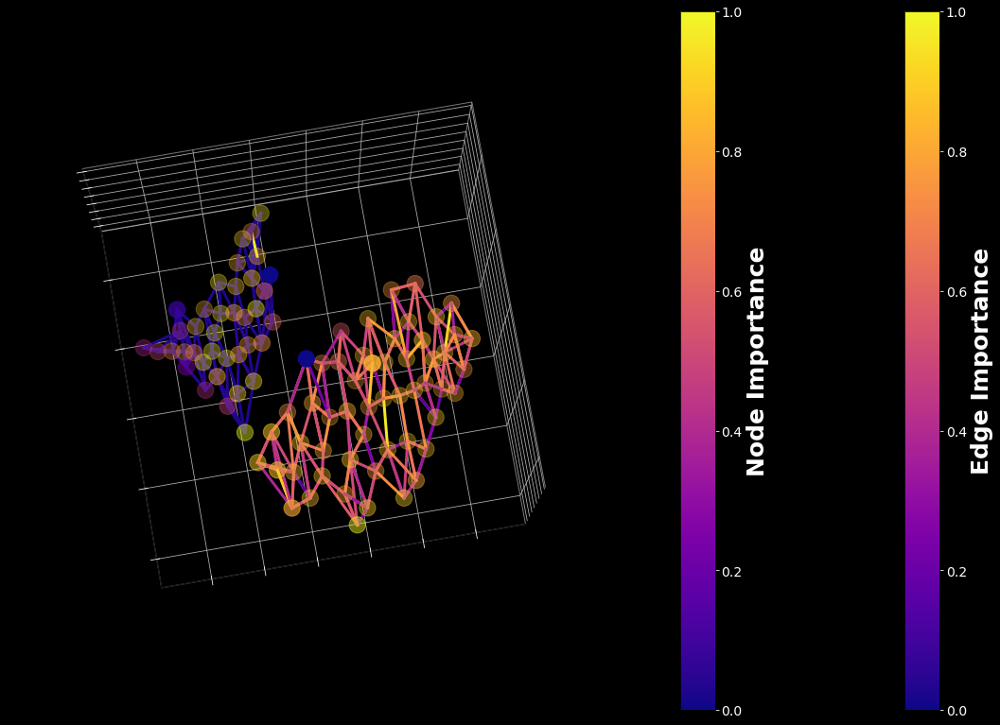

In [533]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(cell1_node_colors)
    ax.scatter(cell1_proxi['row']*scale, cell1_proxi['col']*scale, cell1_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(cell2_node_colors)
    ax.scatter(cell2_proxi['row']*scale, cell2_proxi['col']*scale, cell2_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(cell1_filtered_edges)):
        item = cell1_filtered_edges[i]
        edge_c = edge_cmap(uc_034_2_edge_colors[i])
        ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(cell2_filtered_edges)):
        item = cell2_filtered_edges[i]
        edge_c = edge_cmap(cell2_edge_colors[i])
        ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_007_10_14_graph_importance.png')

#### neighboring patches networks, uc_007_11 and uc_007_14

In [534]:
cell1_embedding = embedding[embedding['cellID']==cell1]
cell2_embedding = embedding[embedding['cellID']==cell2]
fov_patches = pd.concat([cell1_embedding,cell2_embedding])

In [538]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\007_mask.tif')
mask = (mask==10).astype('int') + (mask==14).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\imgs\007_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

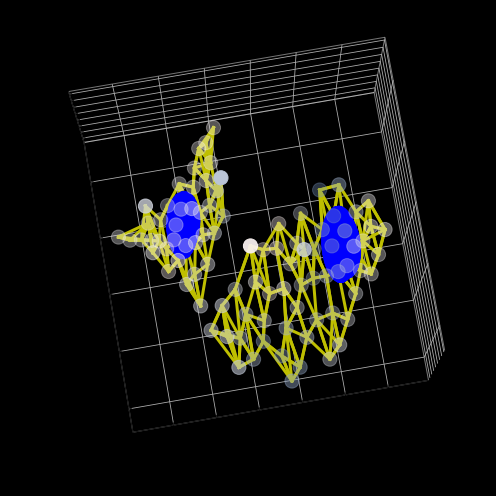

In [539]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_007_10-14_embedding_24_interactions.png')

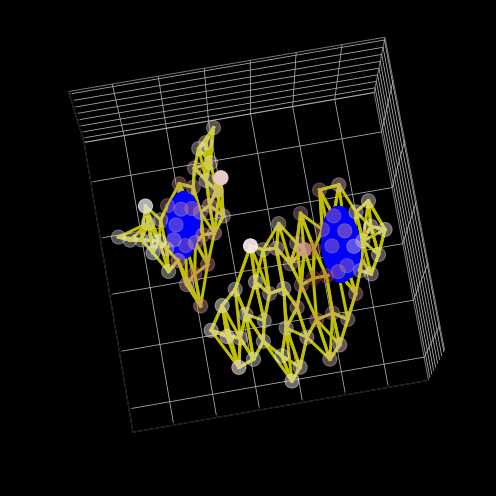

In [540]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_007_10-14_embedding_59_interactions.png')

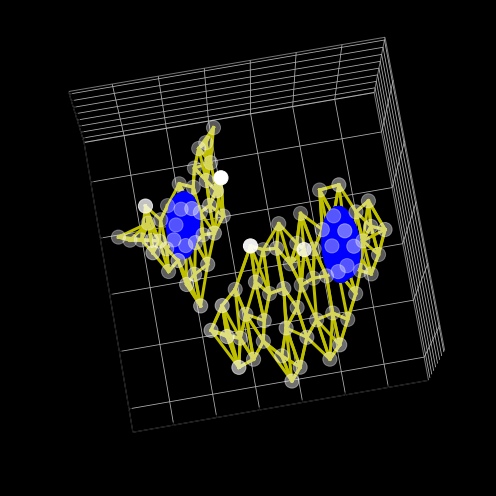

In [541]:
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = 'w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_007_10-14_patch_networks.png')

In [542]:
patch_labels = []
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
for item in cell1_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

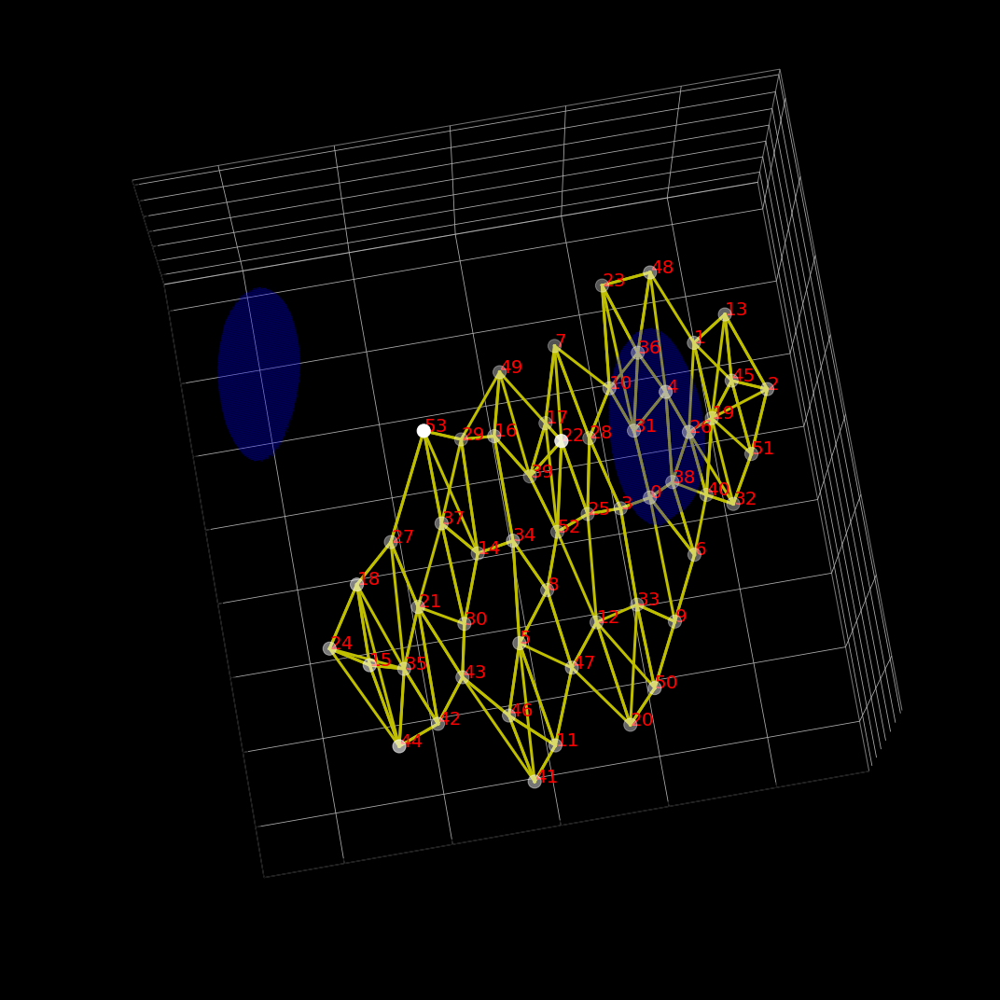

In [543]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=20)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [544]:
patch_labels = []
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
for item in cell2_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

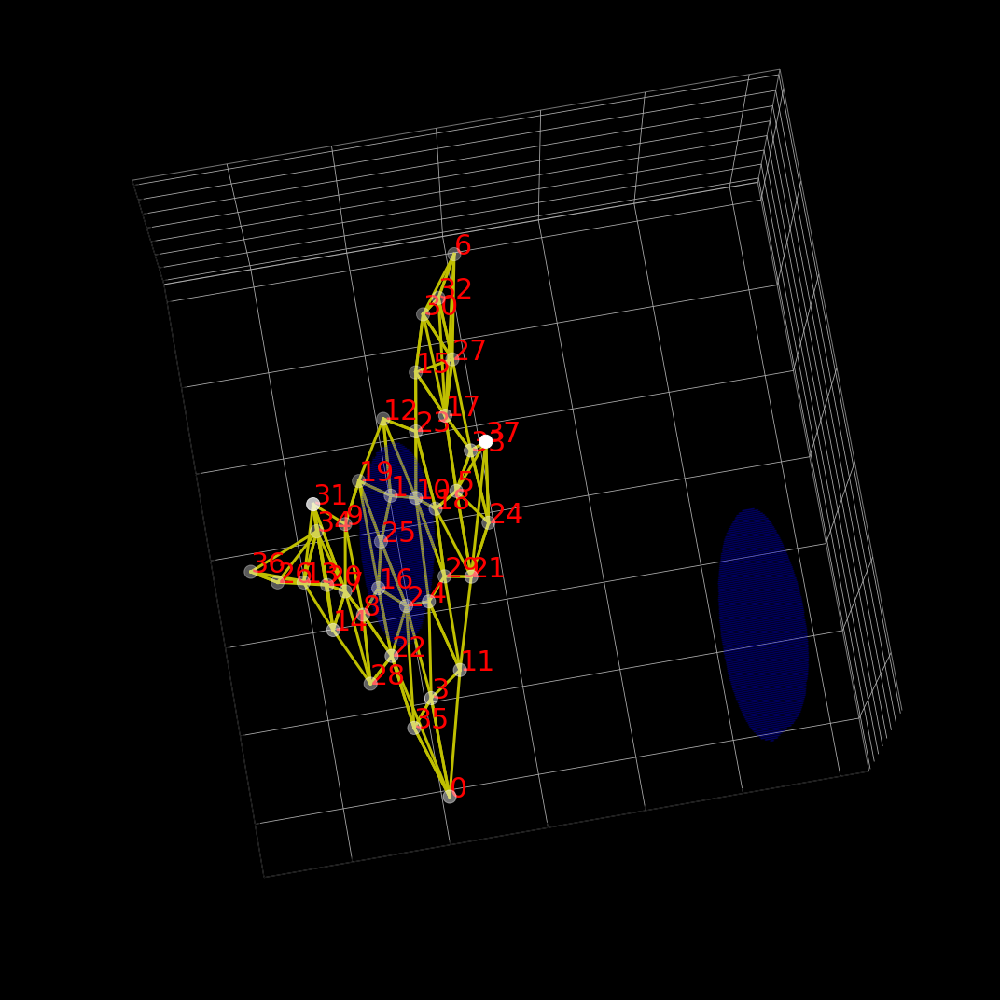

In [545]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [546]:
cell1_boarder = [24,18,27,53,37,21,15,35]
cell2_boarder = [0,11,21,24,35,3,4,29,18,5,33,37]

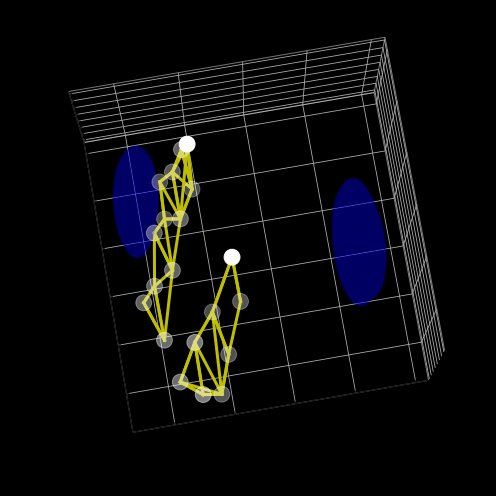

In [547]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\bm_007_10-14_boarder_patches.png')

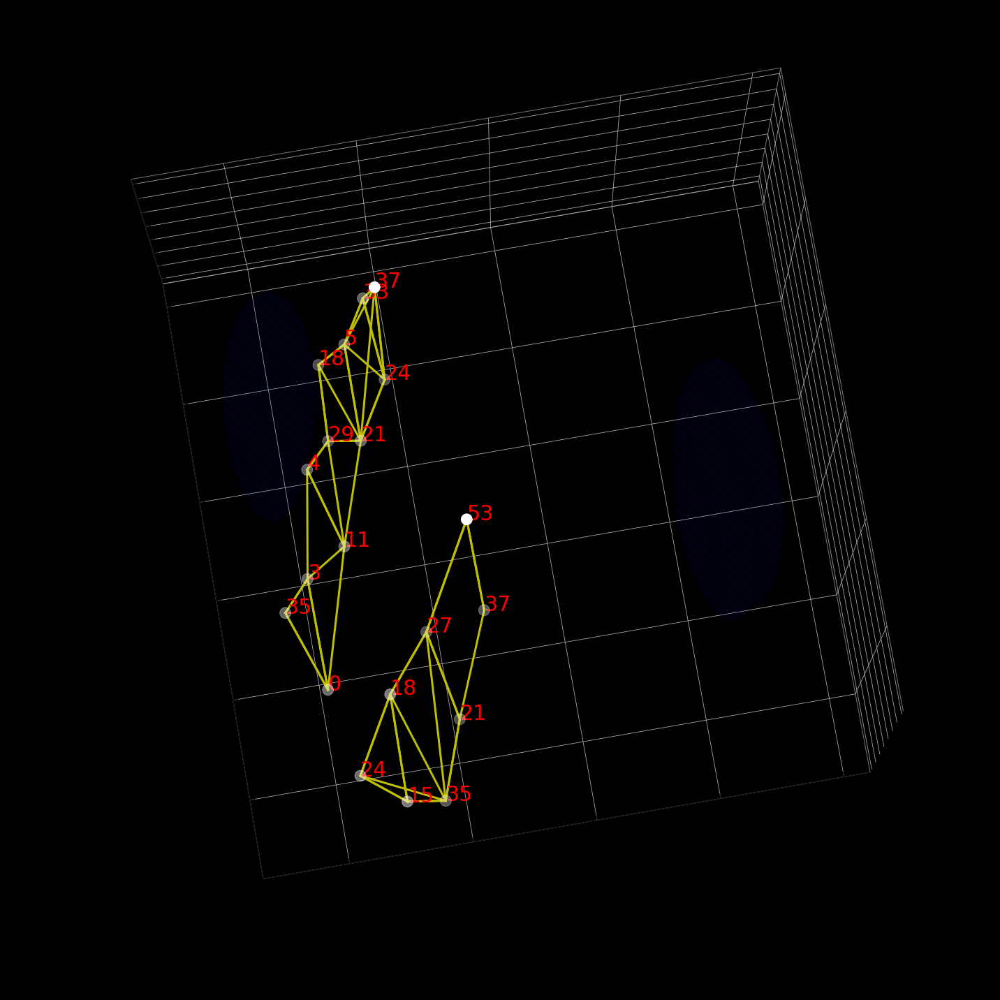

In [548]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

### bm032, 1, 2, 3, 4, 5

#### bm 032 full fov

In [564]:
cells = ['bm_032_01','bm_032_02','bm_032_03','bm_032_04','bm_032_05']
fov_dist = distance_df[distance_df['fov']=='bm_032']

clusters = {}
for item in cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = count_adata.obs['leiden'].tolist()[idx]

In [565]:
clusters

{'bm_032_01': '1',
 'bm_032_02': '5',
 'bm_032_03': '5',
 'bm_032_04': '5',
 'bm_032_05': '5'}

In [566]:
fov_dots = []
clustering = []
for item in cells:
    fov_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
fov_dots = pd.concat(fov_dots)

In [567]:
fov_dots.insert(loc=fov_dots.shape[1], column='clustering', value=clustering)
dots_by_cluster = fov_dots.groupby('clustering')

In [568]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\032_mask.tif')
mask = (mask==1).astype('int') + (mask==2).astype('int') + (mask==3).astype('int') + (mask==4).astype('int') + (mask==5).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
outline_row = []
outline_col = []
for i in range(1,6):
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

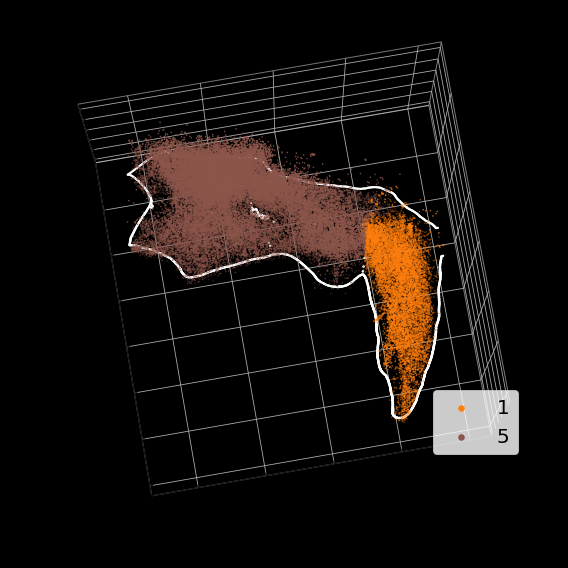

In [569]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='w')

for cluster in fov_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster)]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=0.3,color=color,label=cluster)

# for pair in distance_pairs:
#     ax.plot([uc_003_centers.loc[pair[0]]['row']*scale,uc_003_centers.loc[pair[1]]['row']*scale],
#             [uc_003_centers.loc[pair[0]]['col']*scale,uc_003_centers.loc[pair[1]]['col']*scale],
#             [(uc_003_centers.loc[pair[0]]['z']*z_scale)-25,(uc_003_centers.loc[pair[1]]['z']*z_scale)-25],
#             color='r',linewidth=5)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=10)

plt.tight_layout()

plt.savefig(r'.\figures\bm_032_count_cluster_colored.png',dpi=300)

#### bm_032 01,03 node importance

In [577]:
cell1 = 'bm_032_01'
cell2 = 'bm_032_03'
cell1_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell1+'.pkl'))
cell2_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell2+'.pkl'))

In [578]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [579]:
proxi_by_cell = proxi_df.groupby('cellID')

In [580]:
cell1_proxi = proxi_by_cell.get_group(cell1)
cell2_proxi = proxi_by_cell.get_group(cell2)

In [581]:
cell1_edge_colors = cell1_explanation['edge_mask']
cell1_edge_colors = (cell1_edge_colors - cell1_edge_colors.min()) / (cell1_edge_colors.max() - cell1_edge_colors.min())

cell1_node_colors = cell1_explanation['node_mask']
cell1_node_colors = np.abs(cell1_node_colors)
cell1_node_colors = np.sum(cell1_node_colors,axis=1)
cell1_node_colors = (cell1_node_colors - cell1_node_colors.min()) / (cell1_node_colors.max() - cell1_node_colors.min())


cell2_edge_colors = cell2_explanation['edge_mask']
cell2_edge_colors = (cell2_edge_colors - cell2_edge_colors.min()) / (cell2_edge_colors.max() - cell2_edge_colors.min())

cell2_node_colors = cell2_explanation['node_mask']
cell2_node_colors = np.abs(cell2_node_colors)
cell2_node_colors = np.sum(cell2_node_colors,axis=1)
cell2_node_colors = (cell2_node_colors - cell2_node_colors.min()) / (cell2_node_colors.max() - cell2_node_colors.min())

In [582]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index(cell1+'.pkl')
idx2 = fn_l.index(cell2+'.pkl')

cell1_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        cell1_filtered_edges.append(item)

cell2_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        cell2_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\1992981456.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


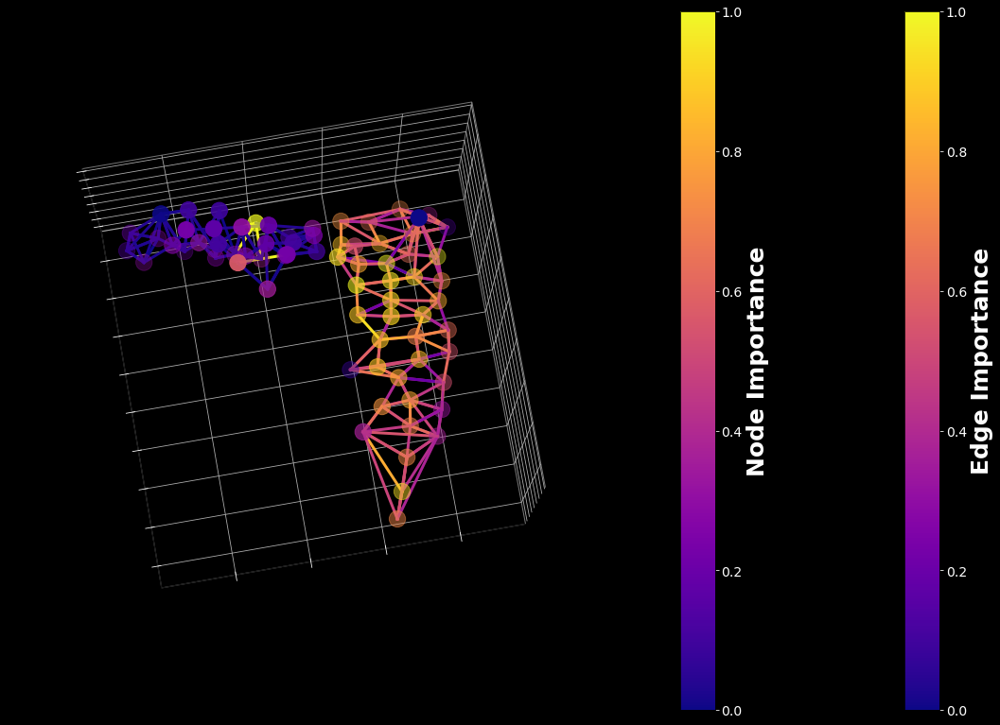

In [583]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(cell1_node_colors)
    ax.scatter(cell1_proxi['row']*scale, cell1_proxi['col']*scale, cell1_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(cell2_node_colors)
    ax.scatter(cell2_proxi['row']*scale, cell2_proxi['col']*scale, cell2_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(cell1_filtered_edges)):
        item = cell1_filtered_edges[i]
        edge_c = edge_cmap(uc_034_2_edge_colors[i])
        ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(cell2_filtered_edges)):
        item = cell2_filtered_edges[i]
        edge_c = edge_cmap(cell2_edge_colors[i])
        ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_032_01_03_graph_importance.png')

#### neighboring patches networks, uc_032_01 and uc_032_03

In [585]:
cell1_embedding = embedding[embedding['cellID']==cell1]
cell2_embedding = embedding[embedding['cellID']==cell2]
fov_patches = pd.concat([cell1_embedding,cell2_embedding])

In [586]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\032_mask.tif')
mask = (mask==1).astype('int') + (mask==3).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\imgs\032_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

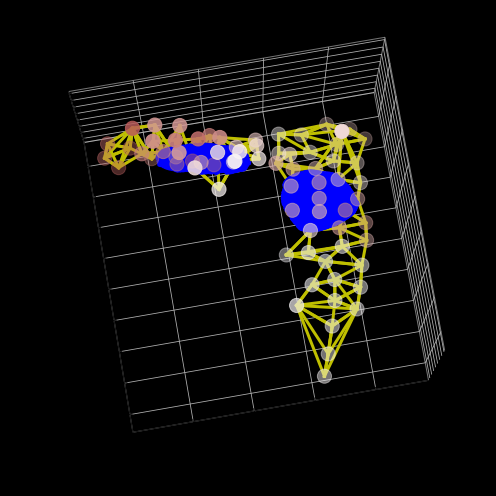

In [587]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_032_01-03_embedding_24_interactions.png')

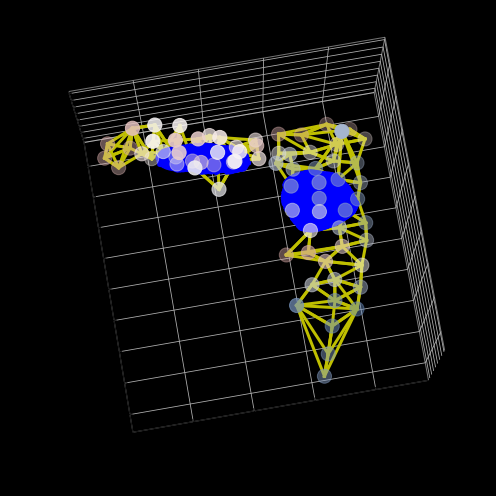

In [588]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_032_01-03_embedding_59_interactions.png')

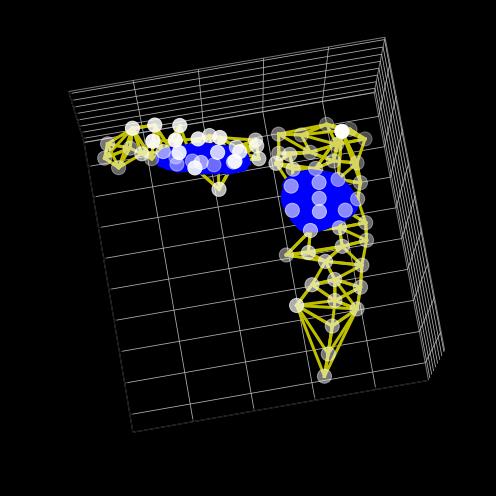

In [589]:
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = 'w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_032_01-03_patch_networks.png')

In [590]:
patch_labels = []
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
for item in cell1_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

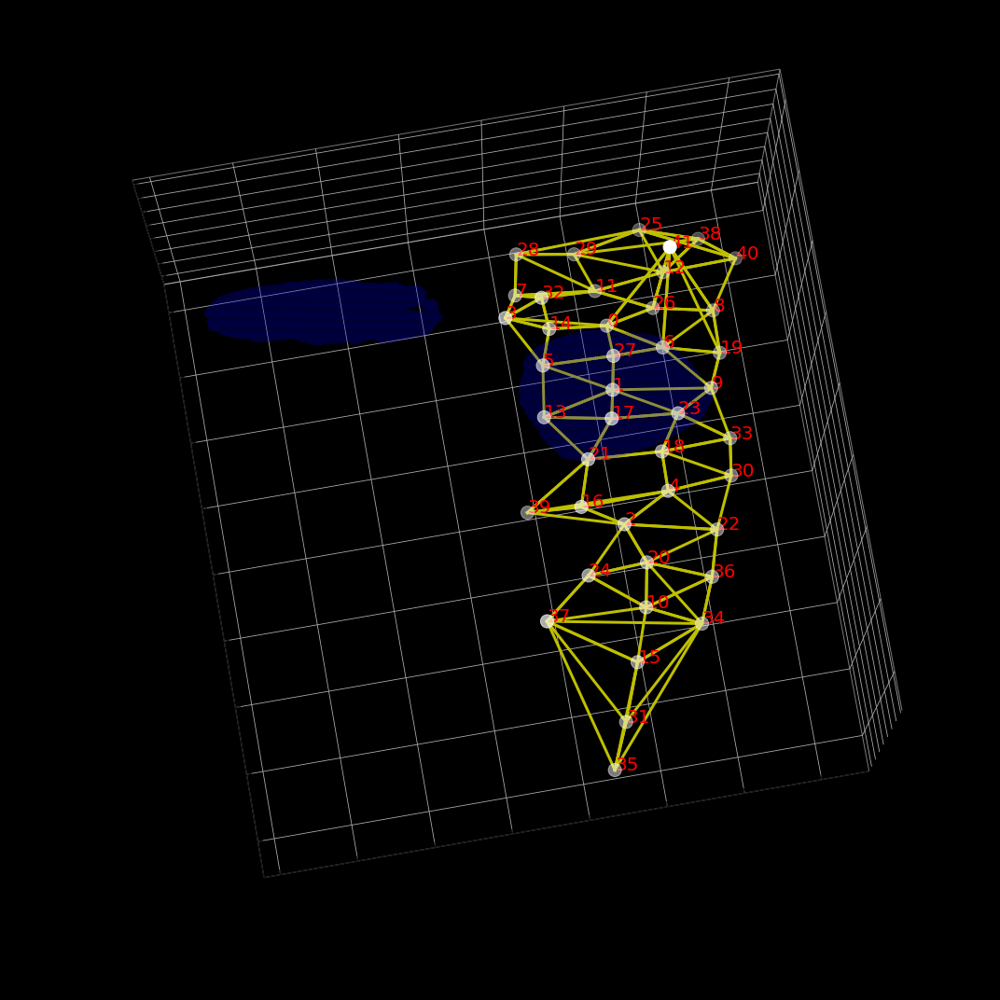

In [591]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=20)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [592]:
patch_labels = []
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
for item in cell2_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

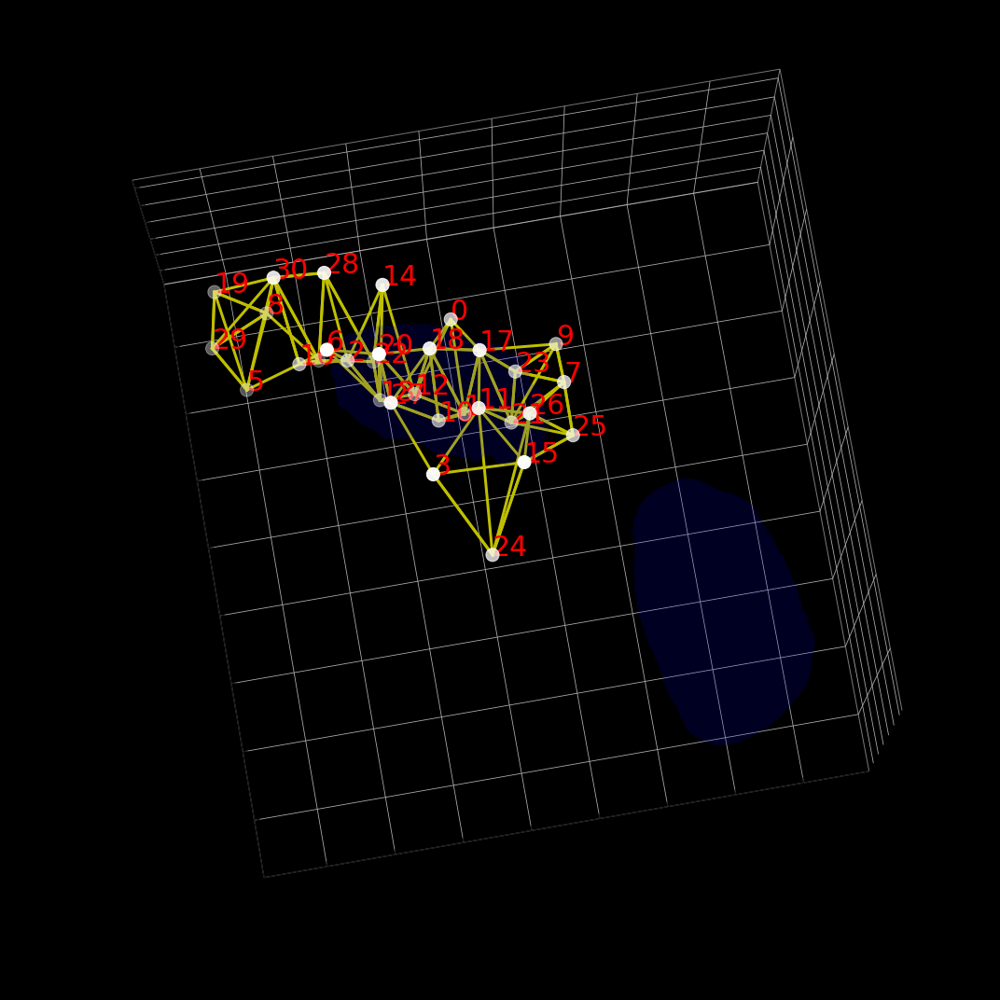

In [593]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [594]:
cell1_boarder = [28,7,3,14,32,29]
cell2_boarder = [9,7,25,15,26,23]

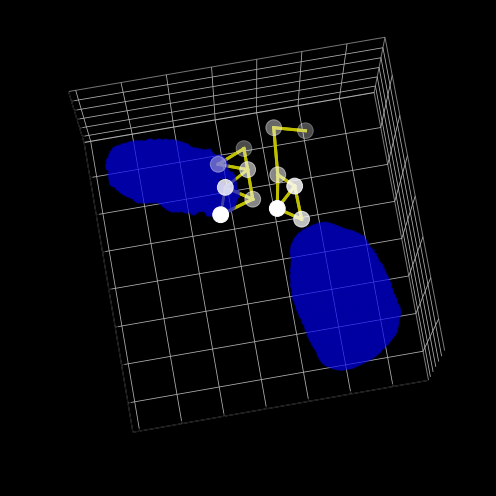

In [598]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.2)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\bm_032_01-03_boarder_patches.png')

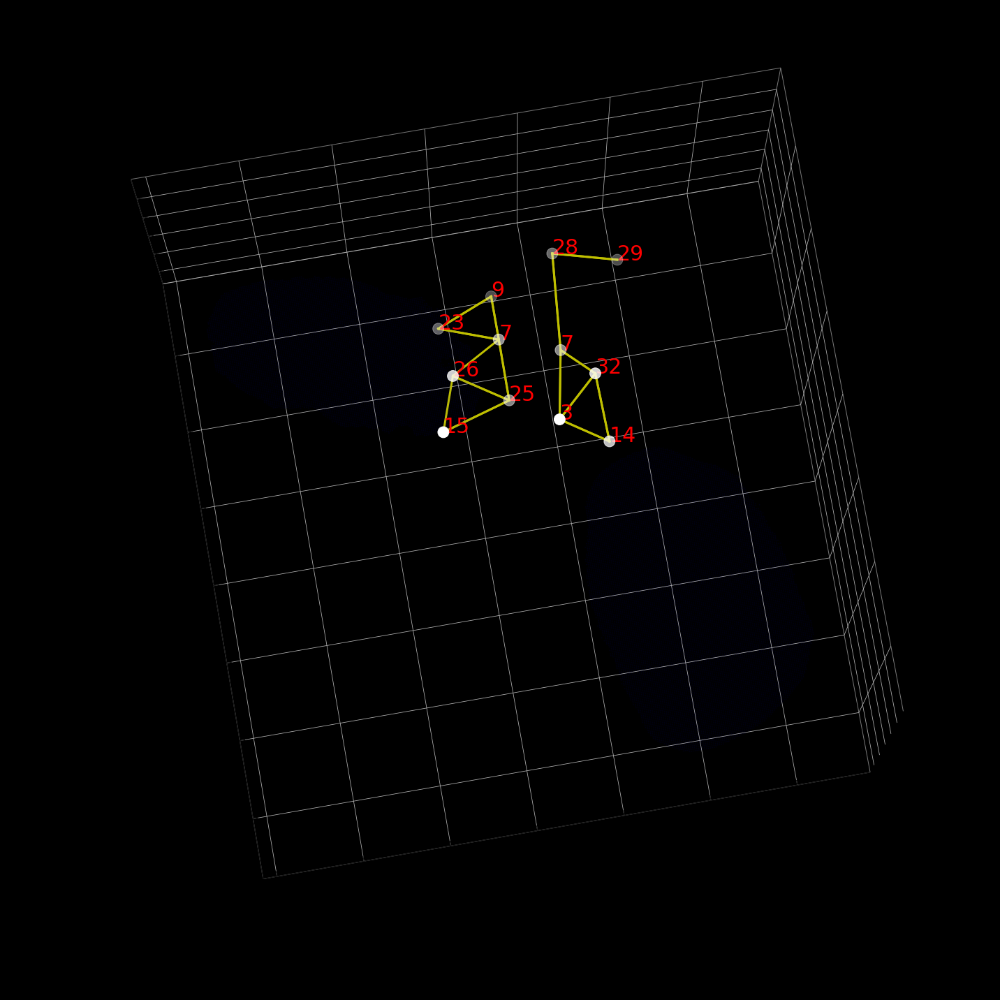

In [596]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

#### bm_032 02,03 node importance

In [599]:
cell1 = 'bm_032_02'
cell2 = 'bm_032_03'
cell1_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell1+'.pkl'))
cell2_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell2+'.pkl'))

In [600]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [601]:
proxi_by_cell = proxi_df.groupby('cellID')

In [602]:
cell1_proxi = proxi_by_cell.get_group(cell1)
cell2_proxi = proxi_by_cell.get_group(cell2)

In [603]:
cell1_edge_colors = cell1_explanation['edge_mask']
cell1_edge_colors = (cell1_edge_colors - cell1_edge_colors.min()) / (cell1_edge_colors.max() - cell1_edge_colors.min())

cell1_node_colors = cell1_explanation['node_mask']
cell1_node_colors = np.abs(cell1_node_colors)
cell1_node_colors = np.sum(cell1_node_colors,axis=1)
cell1_node_colors = (cell1_node_colors - cell1_node_colors.min()) / (cell1_node_colors.max() - cell1_node_colors.min())


cell2_edge_colors = cell2_explanation['edge_mask']
cell2_edge_colors = (cell2_edge_colors - cell2_edge_colors.min()) / (cell2_edge_colors.max() - cell2_edge_colors.min())

cell2_node_colors = cell2_explanation['node_mask']
cell2_node_colors = np.abs(cell2_node_colors)
cell2_node_colors = np.sum(cell2_node_colors,axis=1)
cell2_node_colors = (cell2_node_colors - cell2_node_colors.min()) / (cell2_node_colors.max() - cell2_node_colors.min())

In [604]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index(cell1+'.pkl')
idx2 = fn_l.index(cell2+'.pkl')

cell1_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        cell1_filtered_edges.append(item)

cell2_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        cell2_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\3279613219.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


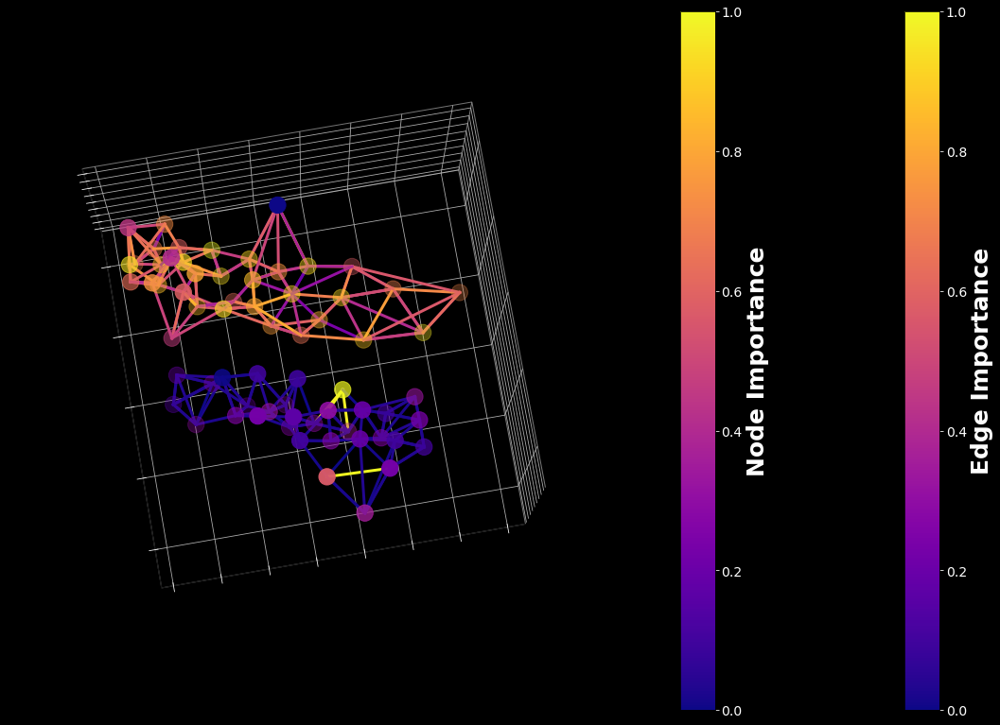

In [605]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(cell1_node_colors)
    ax.scatter(cell1_proxi['row']*scale, cell1_proxi['col']*scale, cell1_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(cell2_node_colors)
    ax.scatter(cell2_proxi['row']*scale, cell2_proxi['col']*scale, cell2_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(cell1_filtered_edges)):
        item = cell1_filtered_edges[i]
        edge_c = edge_cmap(uc_034_2_edge_colors[i])
        ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(cell2_filtered_edges)):
        item = cell2_filtered_edges[i]
        edge_c = edge_cmap(cell2_edge_colors[i])
        ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_032_02_03_graph_importance.png')

#### neighboring patches networks, uc_032_02 and uc_032_03

In [606]:
cell1_embedding = embedding[embedding['cellID']==cell1]
cell2_embedding = embedding[embedding['cellID']==cell2]
fov_patches = pd.concat([cell1_embedding,cell2_embedding])

In [607]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\032_mask.tif')
mask = (mask==2).astype('int') + (mask==3).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\imgs\032_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

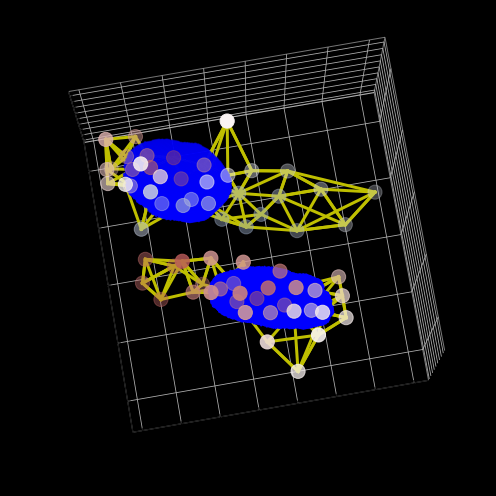

In [608]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_032_02-03_embedding_24_interactions.png')

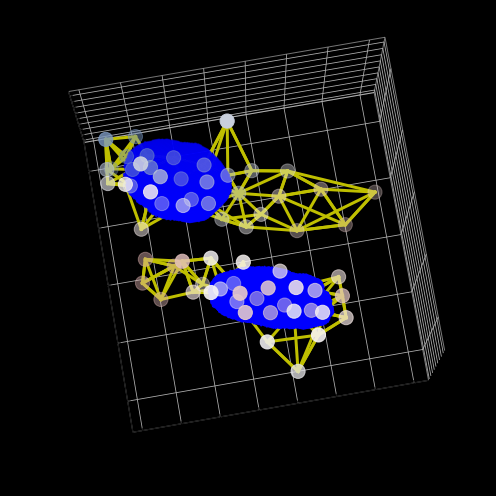

In [609]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_032_02-03_embedding_59_interactions.png')

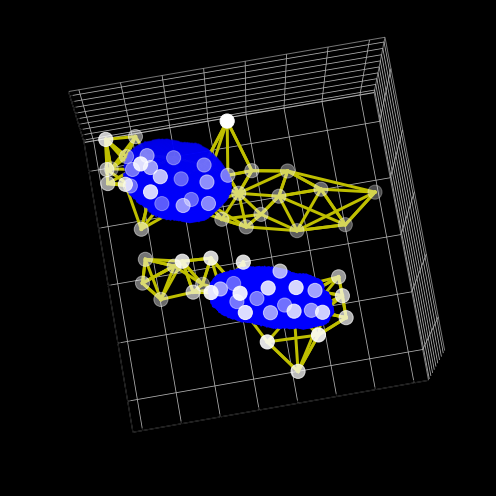

In [610]:
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = 'w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_032_02-03_patch_networks.png')

In [611]:
patch_labels = []
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
for item in cell1_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

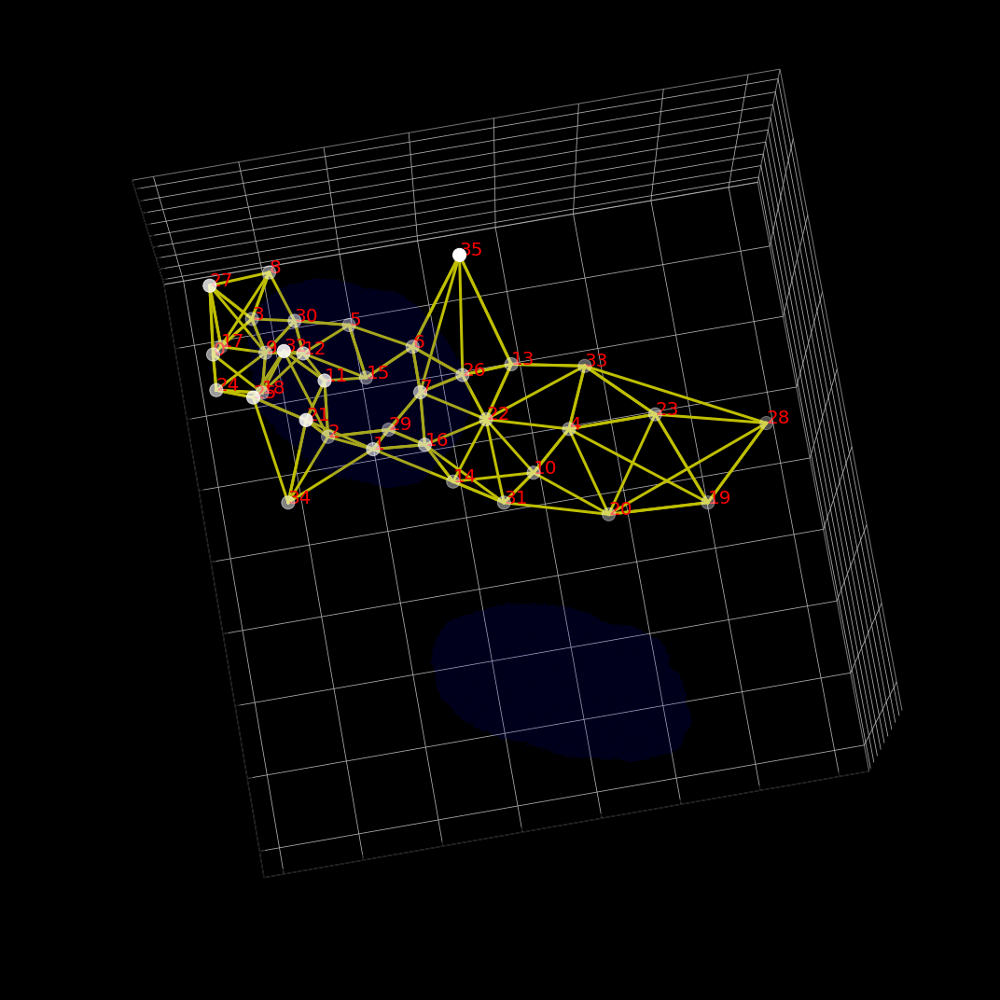

In [612]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=20)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [613]:
patch_labels = []
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
for item in cell2_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

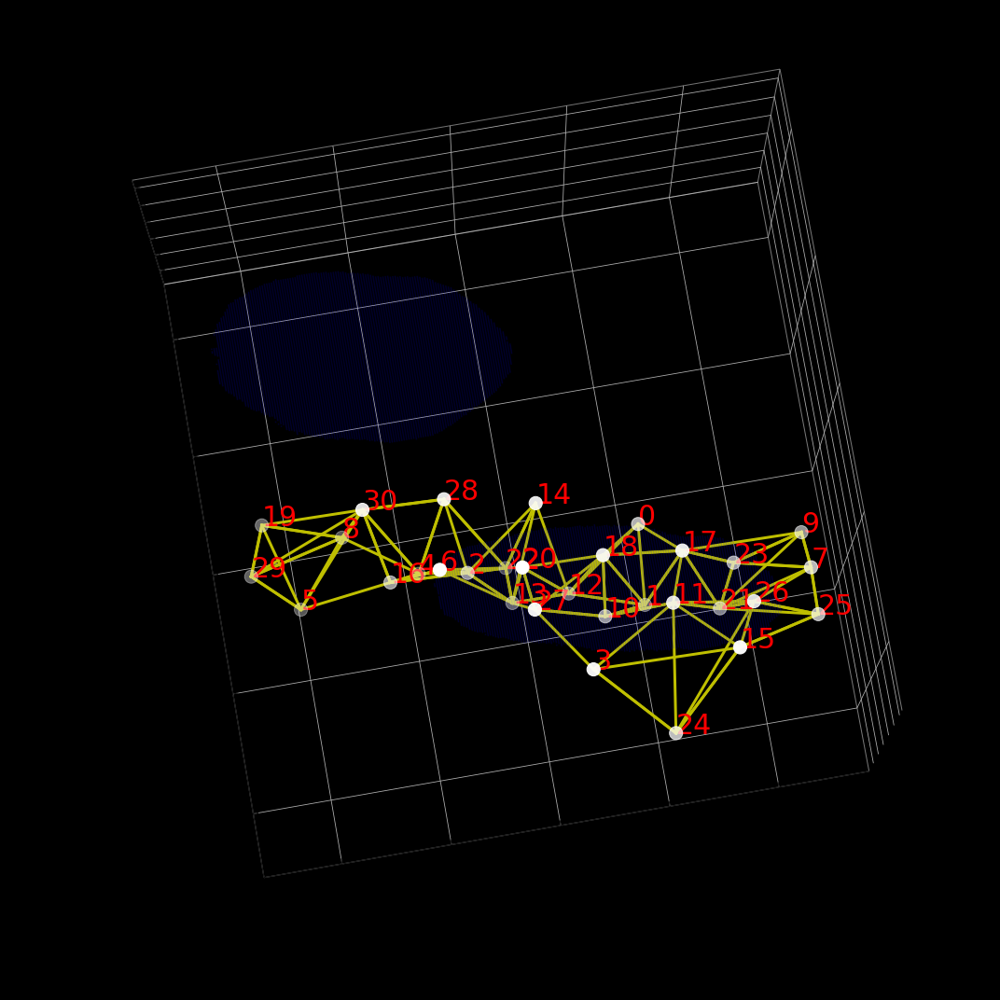

In [614]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [615]:
cell1_boarder = [34,1,14,31,20,19,23,4,10,32,16,29,2,21]
cell2_boarder = [19,30,28,14,0,17,9,7,23,11,1,18,20,22,2,6,8]

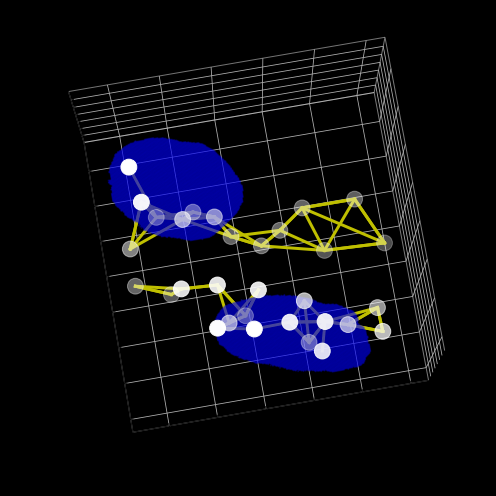

In [616]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.2)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\bm_032_02-03_boarder_patches.png')

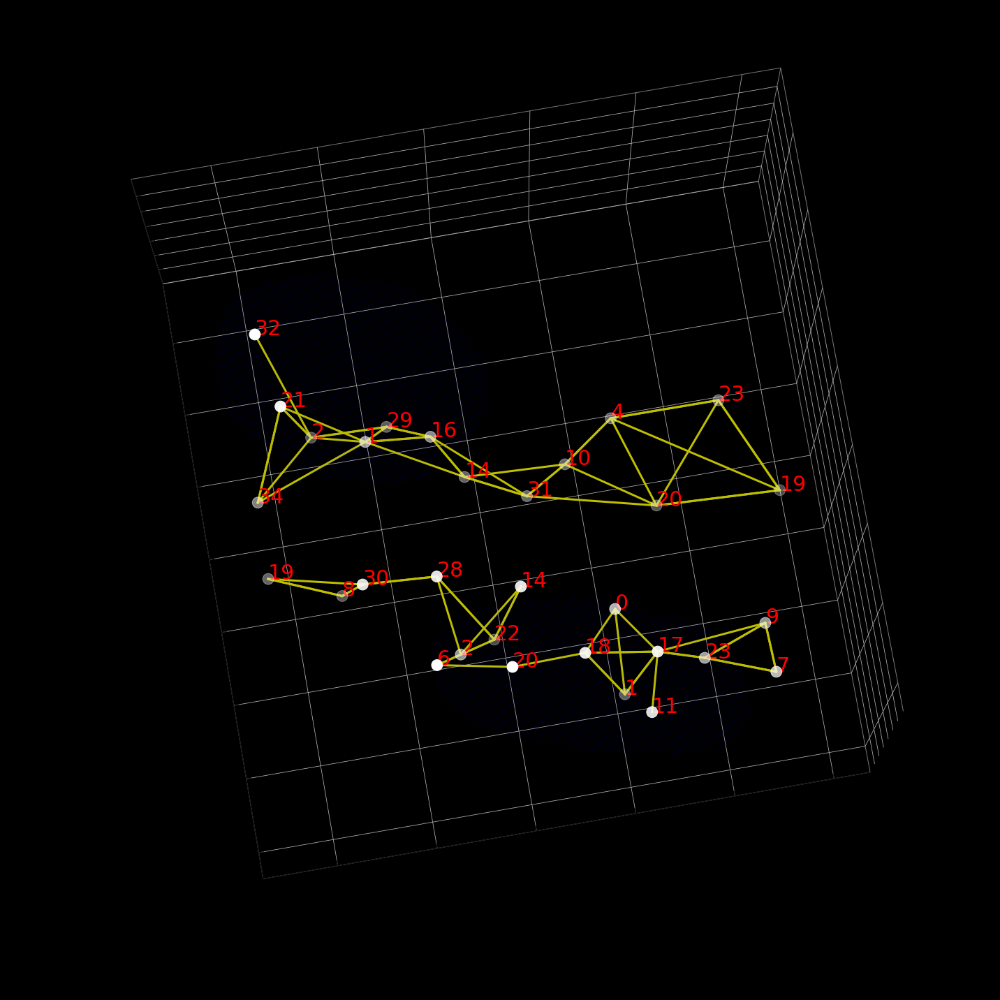

In [617]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

### bm 020, 05, 06

#### bm 020 full fov

In [635]:
cells = ['bm_020_05','bm_020_06']
fov_dist = distance_df[distance_df['fov']=='bm_020']

clusters = {}
for item in cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = count_adata.obs['leiden'].tolist()[idx]

In [636]:
clusters

{'bm_020_05': '0', 'bm_020_06': '8'}

In [637]:
fov_dots = []
clustering = []
for item in cells:
    fov_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
fov_dots = pd.concat(fov_dots)

In [638]:
fov_dots.insert(loc=fov_dots.shape[1], column='clustering', value=clustering)
dots_by_cluster = fov_dots.groupby('clustering')

In [639]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\020_mask.tif')
mask = (mask==5).astype('int') + (mask==6).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
outline_row = []
outline_col = []
for i in range(1,6):
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

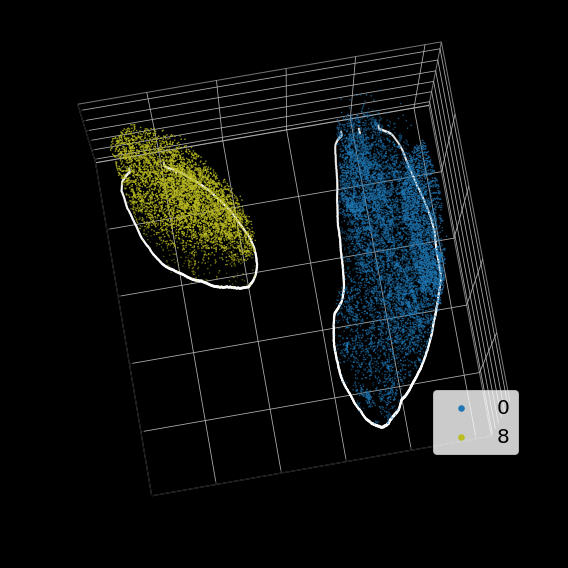

In [641]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='w')

for cluster in fov_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster)]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=0.3,color=color,label=cluster)

# for pair in distance_pairs:
#     ax.plot([uc_003_centers.loc[pair[0]]['row']*scale,uc_003_centers.loc[pair[1]]['row']*scale],
#             [uc_003_centers.loc[pair[0]]['col']*scale,uc_003_centers.loc[pair[1]]['col']*scale],
#             [(uc_003_centers.loc[pair[0]]['z']*z_scale)-25,(uc_003_centers.loc[pair[1]]['z']*z_scale)-25],
#             color='r',linewidth=5)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=10)

plt.tight_layout()

plt.savefig(r'.\figures\bm_020_count_cluster_colored.png',dpi=300)

#### bm_020 05,06 node importance

In [642]:
cell1 = 'bm_020_05'
cell2 = 'bm_020_06'
cell1_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell1+'.pkl'))
cell2_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell2+'.pkl'))

In [643]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [644]:
proxi_by_cell = proxi_df.groupby('cellID')

In [645]:
cell1_proxi = proxi_by_cell.get_group(cell1)
cell2_proxi = proxi_by_cell.get_group(cell2)

In [646]:
cell1_edge_colors = cell1_explanation['edge_mask']
cell1_edge_colors = (cell1_edge_colors - cell1_edge_colors.min()) / (cell1_edge_colors.max() - cell1_edge_colors.min())

cell1_node_colors = cell1_explanation['node_mask']
cell1_node_colors = np.abs(cell1_node_colors)
cell1_node_colors = np.sum(cell1_node_colors,axis=1)
cell1_node_colors = (cell1_node_colors - cell1_node_colors.min()) / (cell1_node_colors.max() - cell1_node_colors.min())


cell2_edge_colors = cell2_explanation['edge_mask']
cell2_edge_colors = (cell2_edge_colors - cell2_edge_colors.min()) / (cell2_edge_colors.max() - cell2_edge_colors.min())

cell2_node_colors = cell2_explanation['node_mask']
cell2_node_colors = np.abs(cell2_node_colors)
cell2_node_colors = np.sum(cell2_node_colors,axis=1)
cell2_node_colors = (cell2_node_colors - cell2_node_colors.min()) / (cell2_node_colors.max() - cell2_node_colors.min())

In [647]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index(cell1+'.pkl')
idx2 = fn_l.index(cell2+'.pkl')

cell1_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        cell1_filtered_edges.append(item)

cell2_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        cell2_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\623486452.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


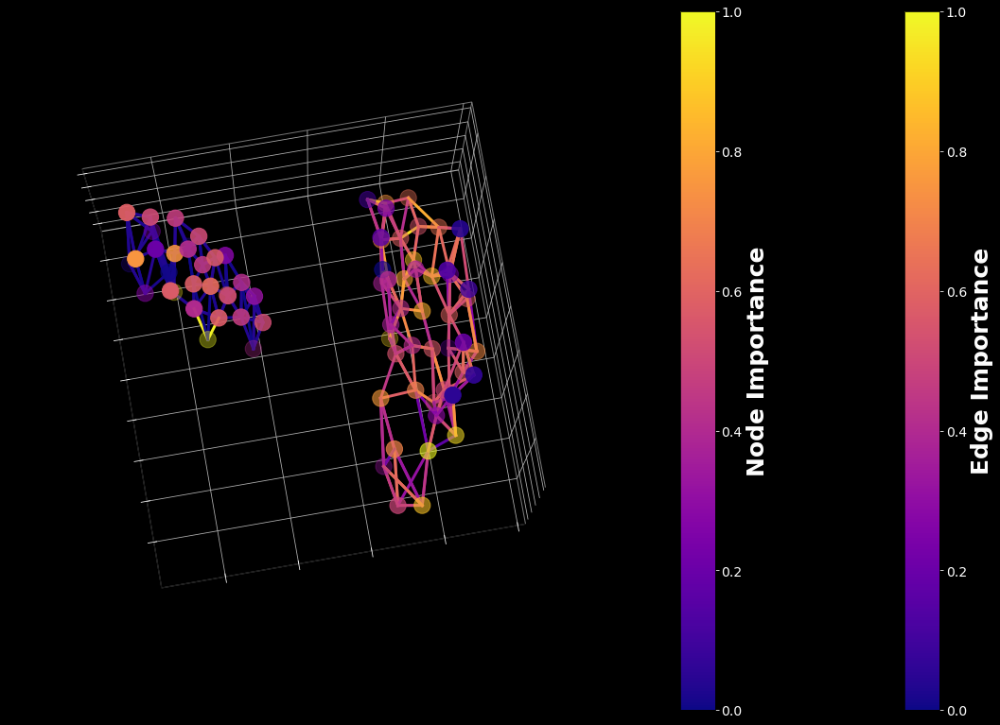

In [648]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(cell1_node_colors)
    ax.scatter(cell1_proxi['row']*scale, cell1_proxi['col']*scale, cell1_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(cell2_node_colors)
    ax.scatter(cell2_proxi['row']*scale, cell2_proxi['col']*scale, cell2_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(cell1_filtered_edges)):
        item = cell1_filtered_edges[i]
        edge_c = edge_cmap(uc_034_2_edge_colors[i])
        ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(cell2_filtered_edges)):
        item = cell2_filtered_edges[i]
        edge_c = edge_cmap(cell2_edge_colors[i])
        ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_020_05_06_graph_importance.png')

#### neighboring patches networks, uc_020_05 and uc_020_06

In [649]:
cell1_embedding = embedding[embedding['cellID']==cell1]
cell2_embedding = embedding[embedding['cellID']==cell2]
fov_patches = pd.concat([cell1_embedding,cell2_embedding])

In [650]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\020_mask.tif')
mask = (mask==5).astype('int') + (mask==6).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\imgs\020_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

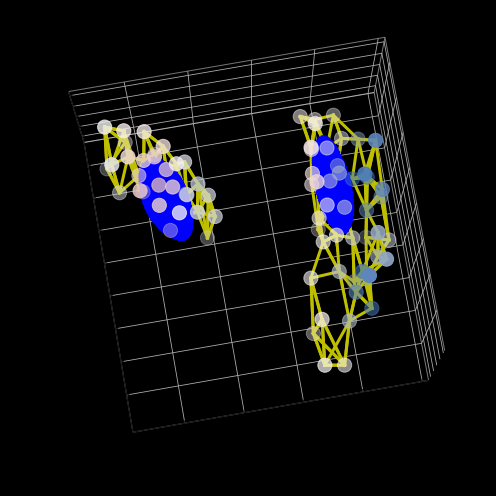

In [651]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_020_05-06_embedding_24_interactions.png')

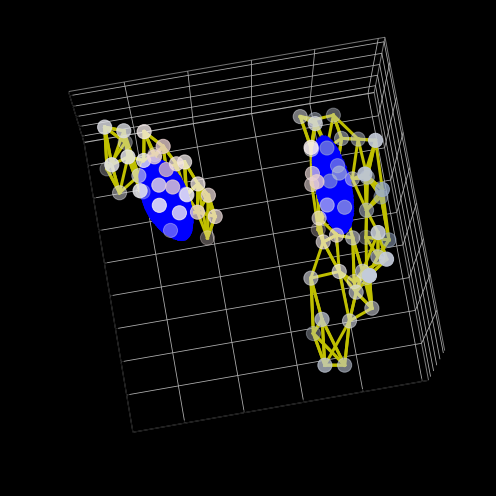

In [652]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_020_05-06_embedding_59_interactions.png')

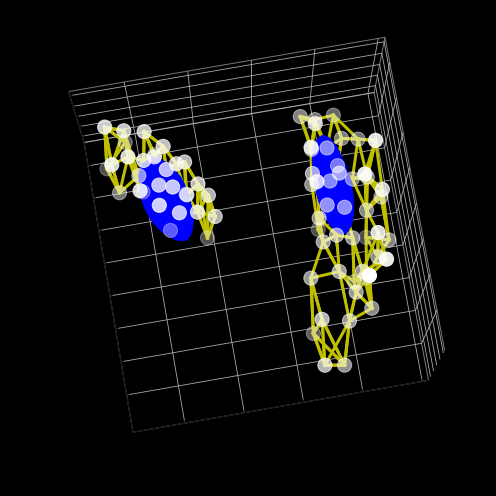

In [653]:
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = 'w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_020_05-06_patch_networks.png')

In [654]:
patch_labels = []
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
for item in cell1_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

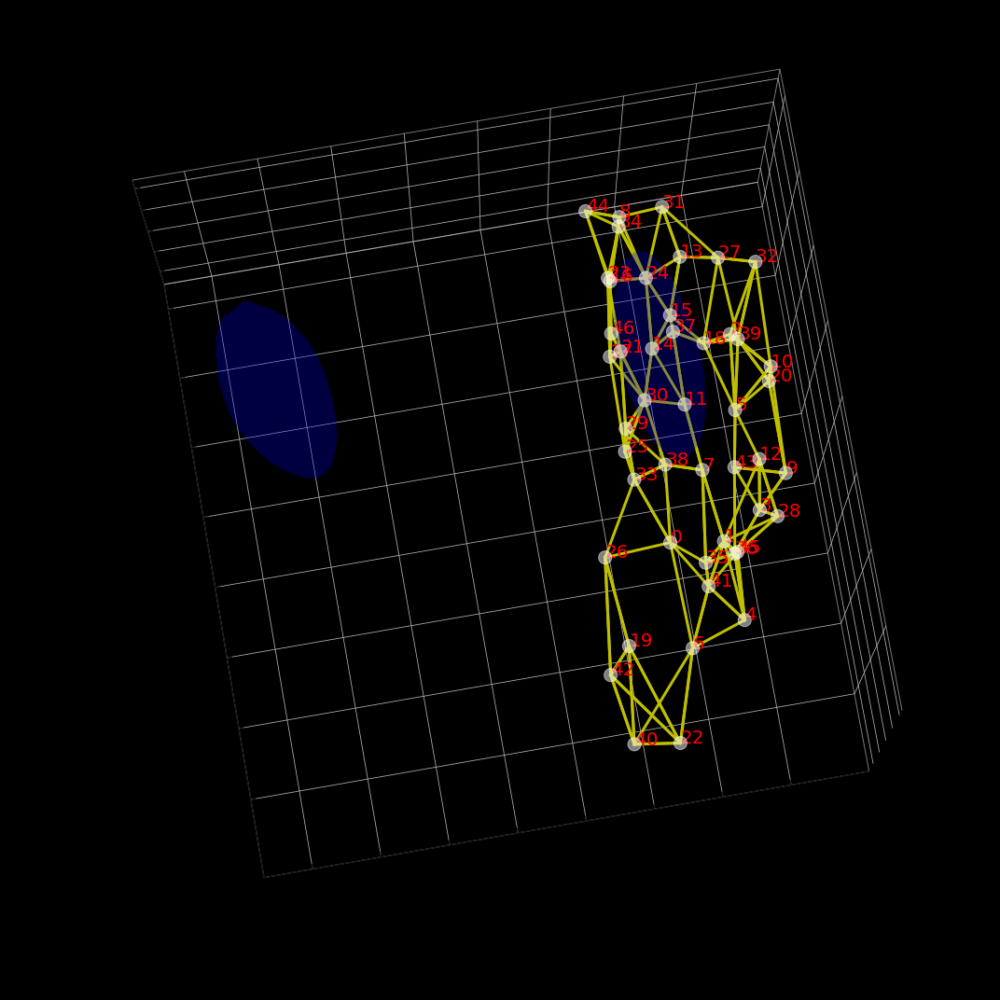

In [658]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=200,
           color='w',alpha=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=20)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [656]:
patch_labels = []
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
for item in cell2_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

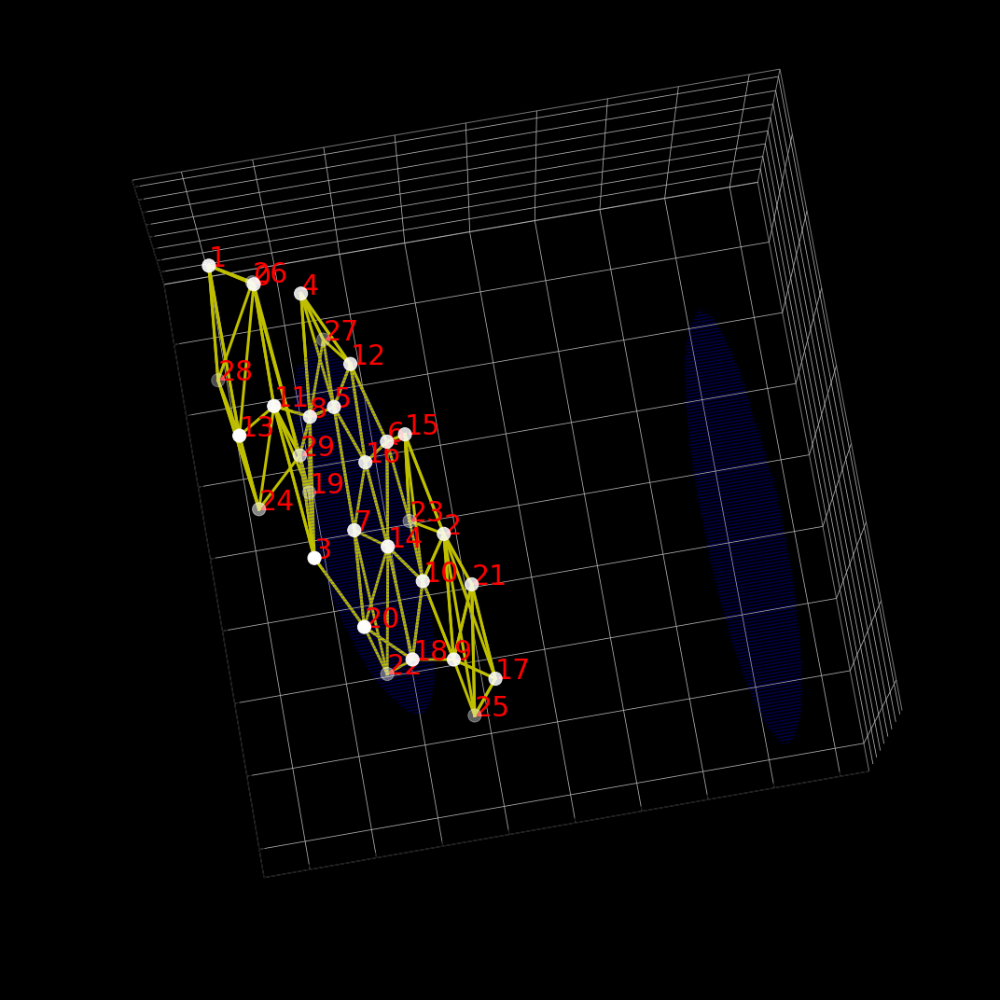

In [657]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [663]:
cell1_boarder = [44,23,16,8,34,46,17,21,29,25,33,38,30,14,24]
cell2_boarder = [21,17,25,2,9,10,23]

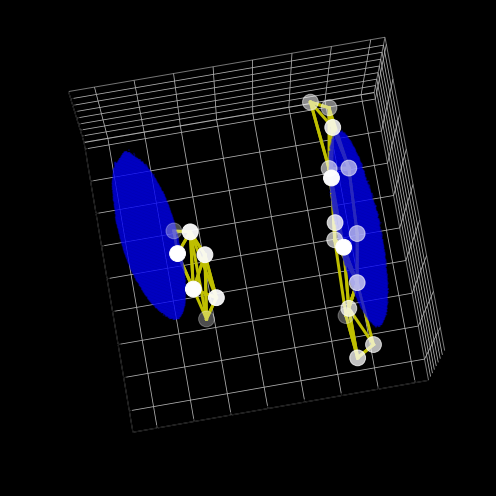

In [664]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.2)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\bm_020_05-06_boarder_patches.png')

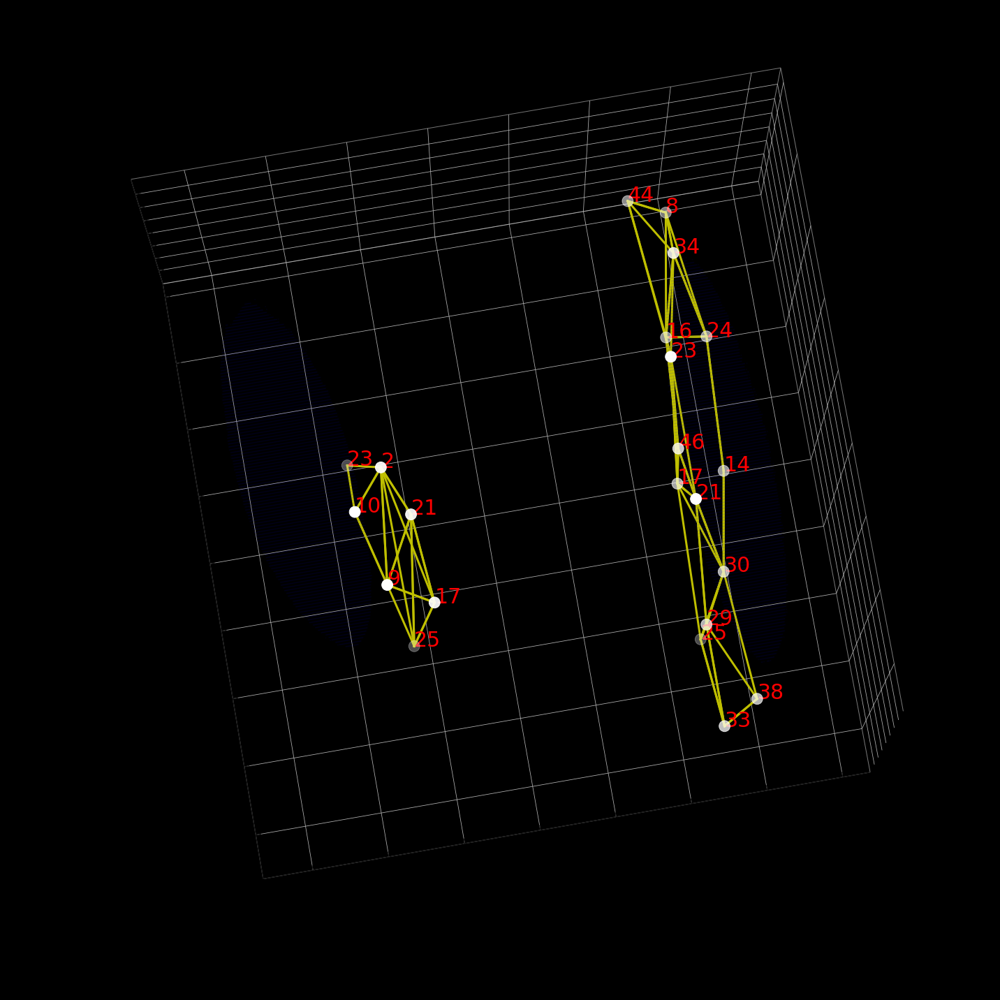

In [665]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

### bm031, 12, 15

#### bm 031 full fov

In [666]:
cells = ['bm_031_12','bm_031_15']
fov_dist = distance_df[distance_df['fov']=='bm_032']

clusters = {}
for item in cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = count_adata.obs['leiden'].tolist()[idx]

In [667]:
clusters

{'bm_031_12': '4', 'bm_031_15': '5'}

In [668]:
fov_dots = []
clustering = []
for item in cells:
    fov_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
fov_dots = pd.concat(fov_dots)

In [669]:
fov_dots.insert(loc=fov_dots.shape[1], column='clustering', value=clustering)
dots_by_cluster = fov_dots.groupby('clustering')

In [670]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\031_mask.tif')
mask = (mask==12).astype('int') + (mask==15).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
outline_row = []
outline_col = []
for i in range(1,6):
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

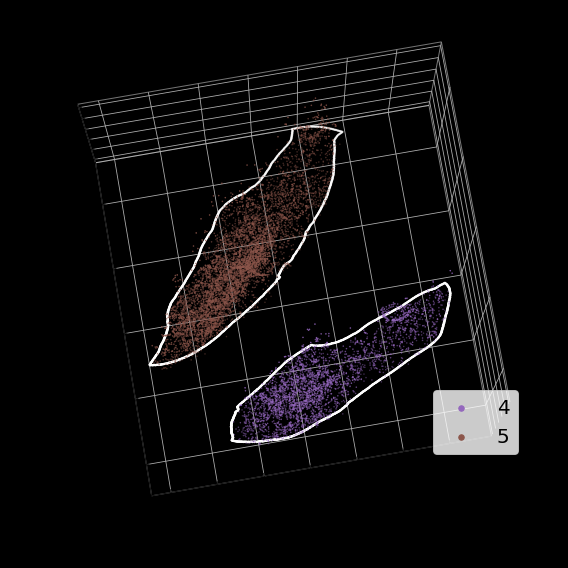

In [671]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='w')

for cluster in fov_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster)]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=0.3,color=color,label=cluster)

# for pair in distance_pairs:
#     ax.plot([uc_003_centers.loc[pair[0]]['row']*scale,uc_003_centers.loc[pair[1]]['row']*scale],
#             [uc_003_centers.loc[pair[0]]['col']*scale,uc_003_centers.loc[pair[1]]['col']*scale],
#             [(uc_003_centers.loc[pair[0]]['z']*z_scale)-25,(uc_003_centers.loc[pair[1]]['z']*z_scale)-25],
#             color='r',linewidth=5)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=10)

plt.tight_layout()

plt.savefig(r'.\figures\bm_031_count_cluster_colored.png',dpi=300)

#### bm_031 12,15 node importance

In [672]:
cell1 = 'bm_031_12'
cell2 = 'bm_031_15'
cell1_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell1+'.pkl'))
cell2_explanation = pd.read_pickle(os.path.join(r'.\results\explainer',cell2+'.pkl'))

In [673]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)
edges = pd.read_pickle(r'.\results\patch_connected_pairs.pkl')

In [674]:
proxi_by_cell = proxi_df.groupby('cellID')

In [675]:
cell1_proxi = proxi_by_cell.get_group(cell1)
cell2_proxi = proxi_by_cell.get_group(cell2)

In [676]:
cell1_edge_colors = cell1_explanation['edge_mask']
cell1_edge_colors = (cell1_edge_colors - cell1_edge_colors.min()) / (cell1_edge_colors.max() - cell1_edge_colors.min())

cell1_node_colors = cell1_explanation['node_mask']
cell1_node_colors = np.abs(cell1_node_colors)
cell1_node_colors = np.sum(cell1_node_colors,axis=1)
cell1_node_colors = (cell1_node_colors - cell1_node_colors.min()) / (cell1_node_colors.max() - cell1_node_colors.min())


cell2_edge_colors = cell2_explanation['edge_mask']
cell2_edge_colors = (cell2_edge_colors - cell2_edge_colors.min()) / (cell2_edge_colors.max() - cell2_edge_colors.min())

cell2_node_colors = cell2_explanation['node_mask']
cell2_node_colors = np.abs(cell2_node_colors)
cell2_node_colors = np.sum(cell2_node_colors,axis=1)
cell2_node_colors = (cell2_node_colors - cell2_node_colors.min()) / (cell2_node_colors.max() - cell2_node_colors.min())

In [677]:
fn_l = os.listdir(r'.\results\explainer')
fn_l.sort()

idx1 = fn_l.index(cell1+'.pkl')
idx2 = fn_l.index(cell2+'.pkl')

cell1_filtered_edges = []
for item in edges[idx1]:
    if item[0] == item[1]:
        continue
    else:
        cell1_filtered_edges.append(item)

cell2_filtered_edges = []
for item in edges[idx2]:
    if item[0] == item[1]:
        continue
    else:
        cell2_filtered_edges.append(item)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\1748973946.py:52: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


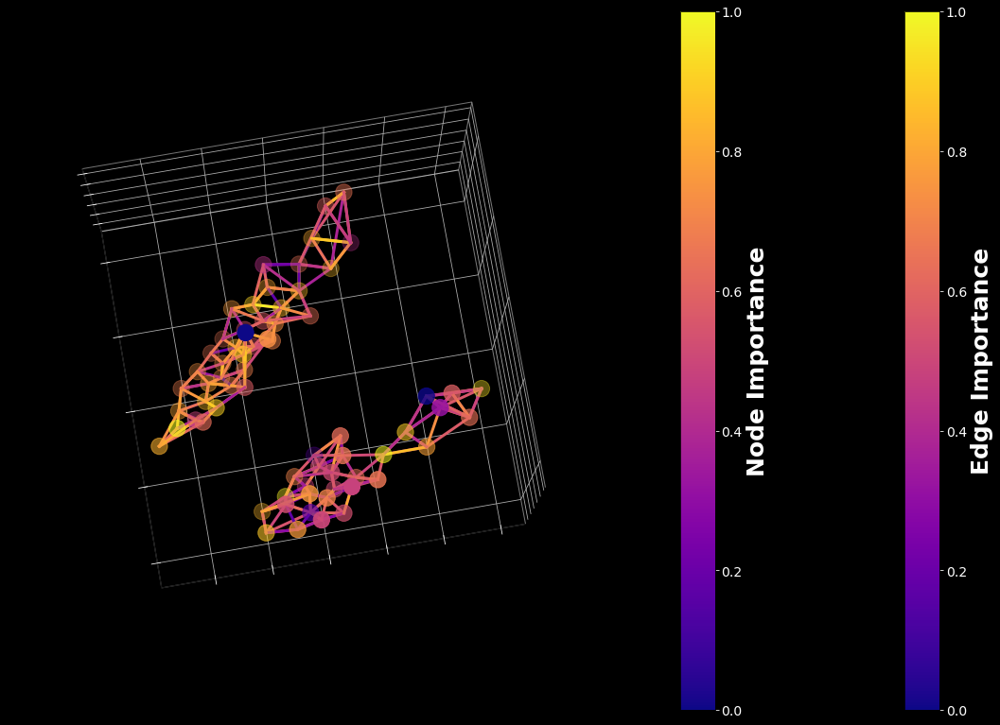

In [678]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,17))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    node_cmap = plt.cm.plasma

    node_c = node_cmap(cell1_node_colors)
    ax.scatter(cell1_proxi['row']*scale, cell1_proxi['col']*scale, cell1_proxi['z']*z_scale, '.', c=node_c, s=300)
    
    node_c = node_cmap(cell2_node_colors)
    ax.scatter(cell2_proxi['row']*scale, cell2_proxi['col']*scale, cell2_proxi['z']*z_scale, '.', c=node_c, s=300)
    # ax.plot(edge_row*scale, edge_col*scale, edge_z*scale, color='r')

    edge_cmap = plt.cm.plasma
    for i in range(len(cell1_filtered_edges)):
        item = cell1_filtered_edges[i]
        edge_c = edge_cmap(uc_034_2_edge_colors[i])
        ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    for i in range(len(cell2_filtered_edges)):
        item = cell2_filtered_edges[i]
        edge_c = edge_cmap(cell2_edge_colors[i])
        ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
                c=edge_c,linewidth=3)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])
    
    edge_mappable = plt.cm.ScalarMappable(cmap=edge_cmap)
    edge_cb = plt.colorbar(edge_mappable, ax=ax, label='Edge Importance', pad=0.1, shrink=0.8)
    edge_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    edge_cb.set_label('Edge Importance', color='white', weight='bold', fontsize=25)

    node_mappable = plt.cm.ScalarMappable(cmap=node_cmap)
    node_cb = plt.colorbar(node_mappable, ax=ax, label='Node Importance', pad=0.1, shrink=0.8)
    node_cb.ax.yaxis.set_tick_params(labelsize=14, color='white')
    node_cb.set_label('Node Importance', color='white', weight='bold', fontsize=25)

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_031_12_15_graph_importance.png')

#### neighboring patches networks, uc_031_12 and uc_031_15

In [679]:
cell1_embedding = embedding[embedding['cellID']==cell1]
cell2_embedding = embedding[embedding['cellID']==cell2]
fov_patches = pd.concat([cell1_embedding,cell2_embedding])

In [680]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\031_mask.tif')
mask = (mask==12).astype('int') + (mask==15).astype('int')

dapi_mip = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\imgs\031_image.tif')
dapi_mip = dapi_mip[2,:,:]

masked_dapi = mask * dapi_mip
thre = threshold_otsu(masked_dapi)
dapi_mask = masked_dapi > thre

dapi_coor = np.where(dapi_mask)
dapi_row = dapi_coor[0].astype('float') * scale
dapi_col = dapi_coor[1].astype('float') * scale

dapi_z = 12 * z_scale

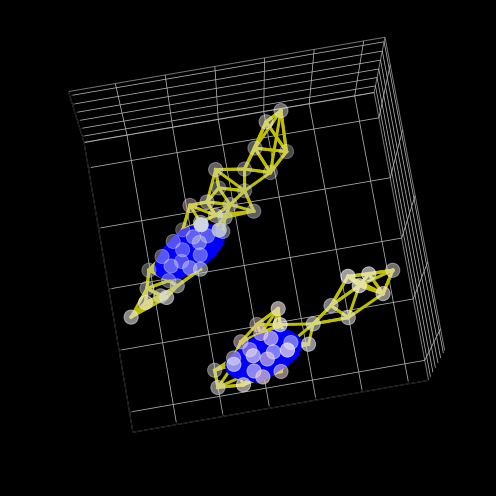

In [681]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['24'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_031_12-15_embedding_24_interactions.png')

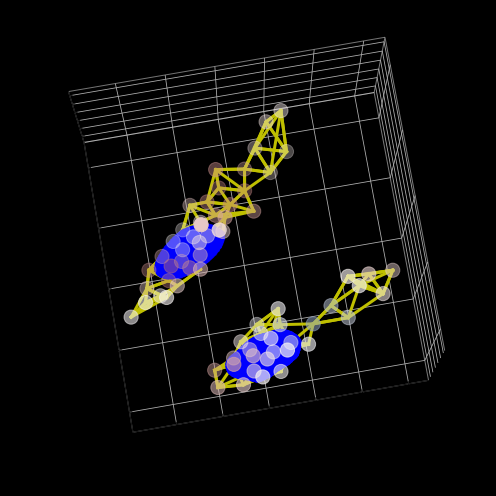

In [682]:

fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = fov_patches['59'],cmap='vlag',vmin=-0.5,vmax=0.5)

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_031_12-15_embedding_59_interactions.png')

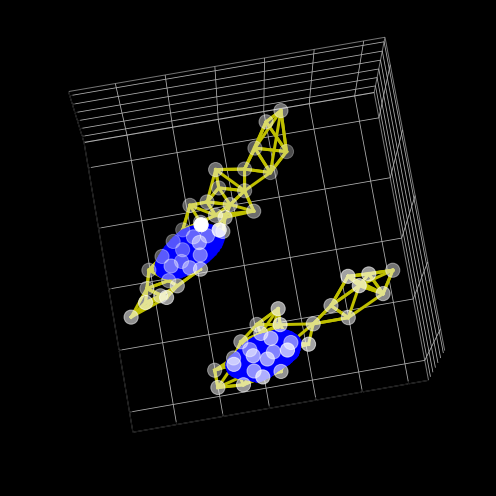

In [683]:
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1)
ax.scatter(fov_patches['row']*scale,fov_patches['col']*scale,fov_patches['z']*z_scale,s=200,
           c = 'w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()
plt.savefig(r'.\figures\bm_031_12-15_patch_networks.png')

In [684]:
patch_labels = []
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
for item in cell1_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

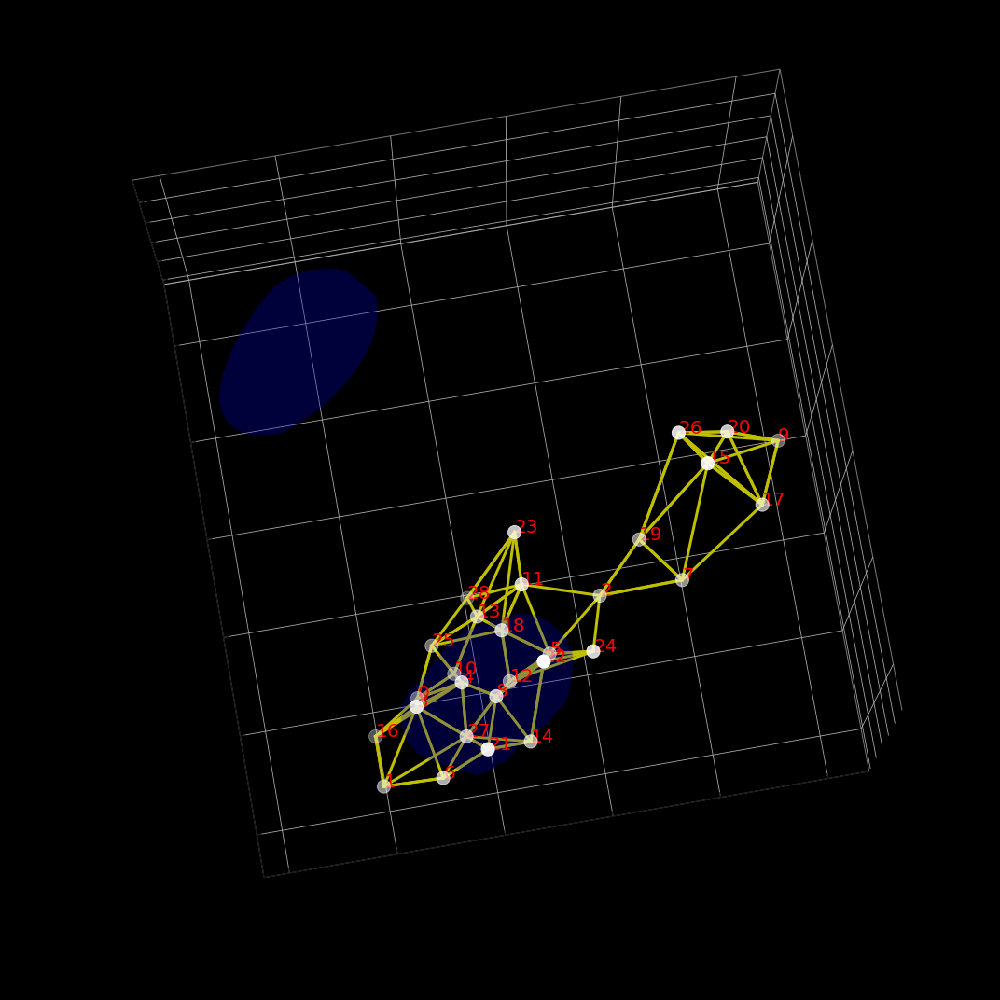

In [685]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell1_patches = fov_patches[fov_patches['cellID']==cell1]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell1_filtered_edges)):
    item = cell1_filtered_edges[i]
    edge_c = edge_cmap(cell1_edge_colors[i])
    ax.plot([cell1_proxi.loc[item[0]]['row'].astype('float')*scale, cell1_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['col'].astype('float')*scale, cell1_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell1_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=20)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [686]:
patch_labels = []
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
for item in cell2_patches.index.tolist():
    patch_labels.append(item.split('_')[-1])

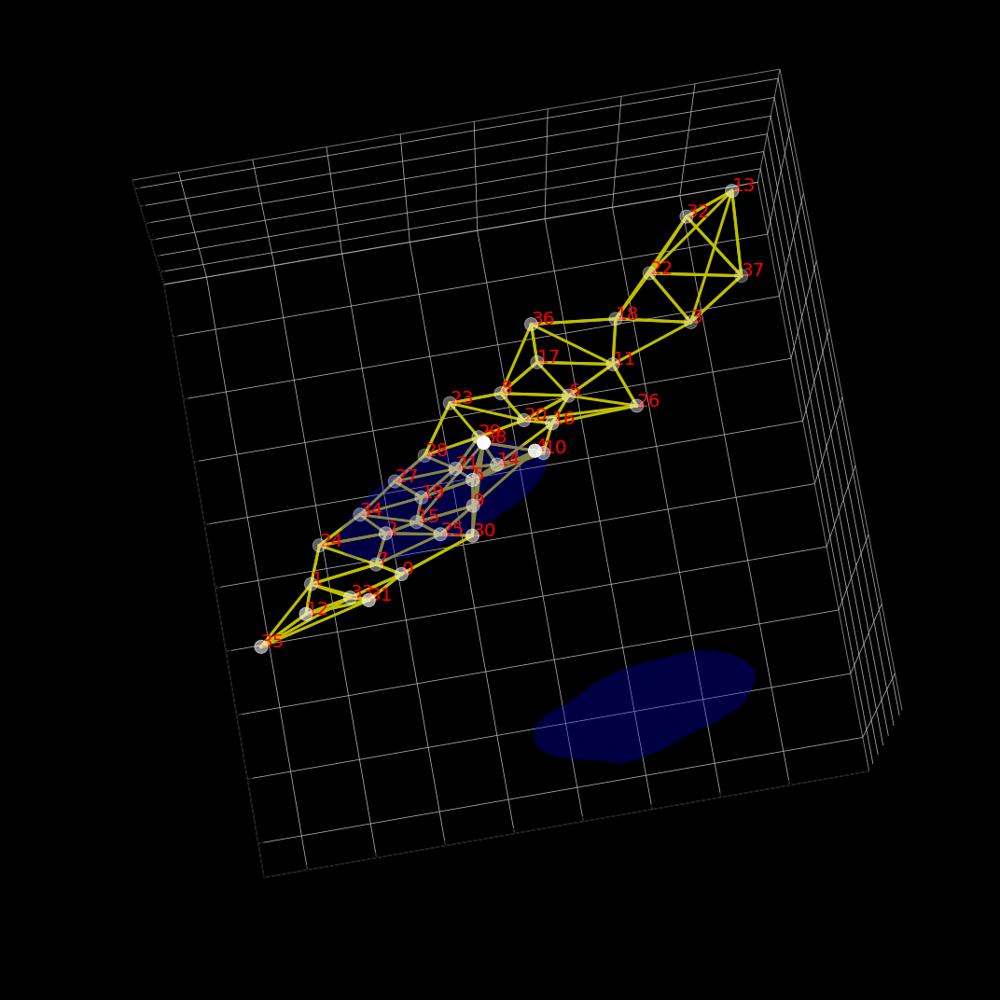

In [688]:
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)
cell2_patches = fov_patches[fov_patches['cellID']==cell2]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=200,
           color='w')

for i in range(len(cell2_filtered_edges)):
    item = cell2_filtered_edges[i]
    edge_c = edge_cmap(cell2_edge_colors[i])
    ax.plot([cell2_proxi.loc[item[0]]['row'].astype('float')*scale, cell2_proxi.loc[item[1]]['row'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['col'].astype('float')*scale, cell2_proxi.loc[item[1]]['col'].astype('float')*scale],
            [cell2_proxi.loc[item[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[item[1]]['z'].astype('float')*z_scale],
            color='y',linewidth=3)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=20)
ax.view_init(-100, 100)
plt.tight_layout()
# plt.savefig(r'.\figures\uc_003_01_patches_with_label.png')

In [689]:
cell1_boarder = [23,28,25,0,3,10,13,11]
cell2_boarder = [31,33,0,7,1,30,25,9]

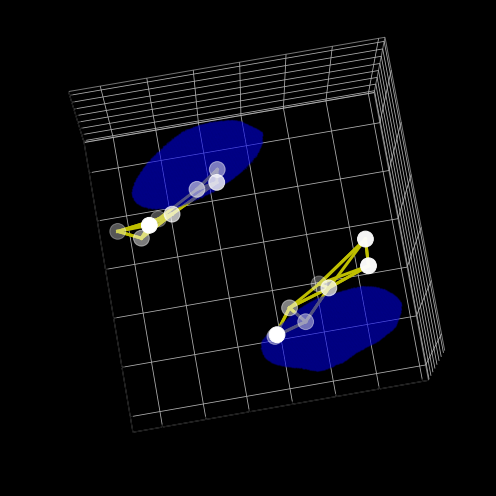

In [693]:
# Plot boarder patches
fig = plt.figure(figsize=(7,7))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.1)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

ax.view_init(-100, 100)
plt.tight_layout()

plt.savefig(r'.\figures\bm_031_12-15_boarder_patches.png')

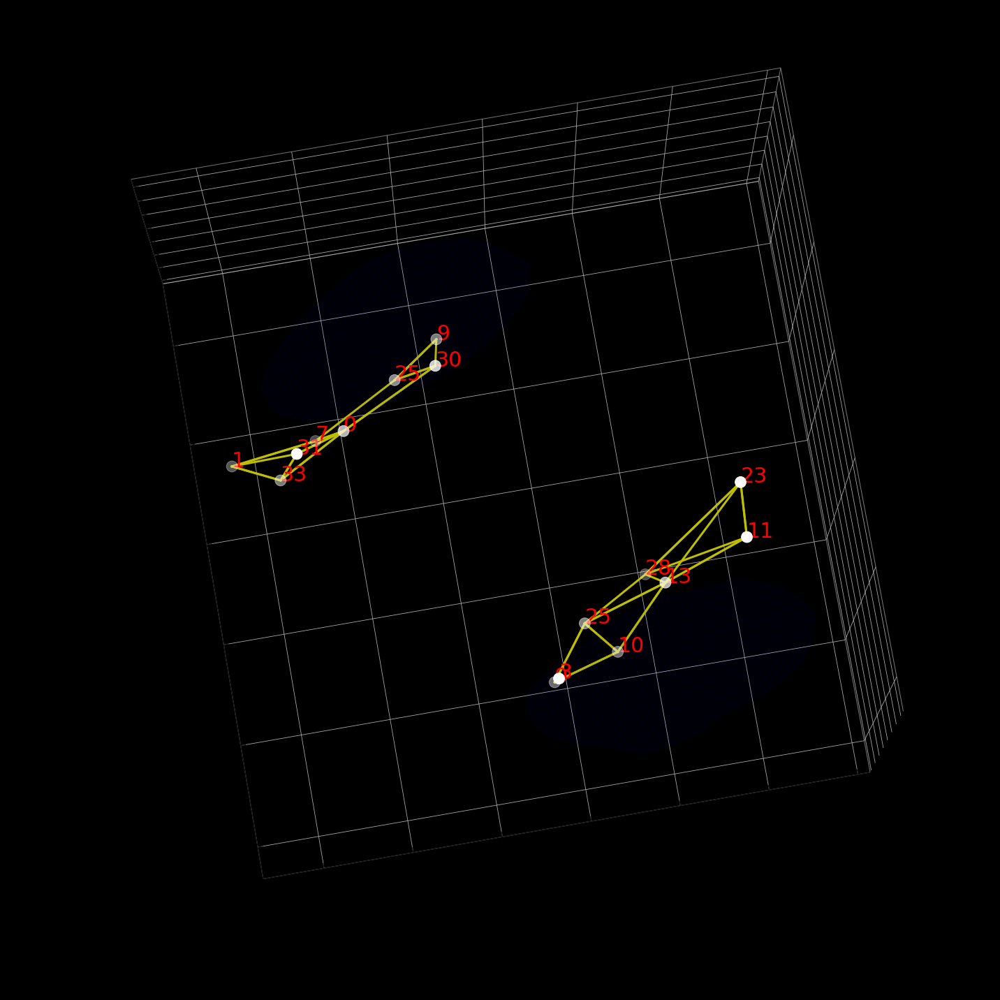

In [694]:
# Plot boarder patches
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(dapi_row,dapi_col,dapi_z,color='b',s=1,alpha=0.05)

cell1_patches = fov_patches[fov_patches['cellID']==cell1]
boarder_index = []
for p in cell1_boarder:
    boarder_index.append(cell1+'_'+str(p))
cell1_patches = cell1_patches.loc[boarder_index]
ax.scatter(cell1_patches['row']*scale,cell1_patches['col']*scale,cell1_patches['z']*z_scale,s=250,
           color='w')

cell2_patches = fov_patches[fov_patches['cellID']==cell2]
boarder_index = []
for p in cell2_boarder:
    boarder_index.append(cell2+'_'+str(p))
cell2_patches = cell2_patches.loc[boarder_index]
ax.scatter(cell2_patches['row']*scale,cell2_patches['col']*scale,cell2_patches['z']*z_scale,s=250,
           color='w')


for edge in cell1_filtered_edges:
    patch1 = cell1_proxi.loc[edge[0]]['patch_name']
    patch2 = cell1_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell1_patches.index.tolist() and patch2 in cell1_patches.index.tolist():
        ax.plot([cell1_proxi.loc[edge[0]]['row'].astype('float')*scale, cell1_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['col'].astype('float')*scale, cell1_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell1_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell1_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for edge in cell2_filtered_edges:
    patch1 = cell2_proxi.loc[edge[0]]['patch_name']
    patch2 = cell2_proxi.loc[edge[1]]['patch_name']
    if patch1 in cell2_patches.index.tolist() and patch2 in cell2_patches.index.tolist():
        ax.plot([cell2_proxi.loc[edge[0]]['row'].astype('float')*scale, cell2_proxi.loc[edge[1]]['row'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['col'].astype('float')*scale, cell2_proxi.loc[edge[1]]['col'].astype('float')*scale],
                [cell2_proxi.loc[edge[0]]['z'].astype('float')*z_scale, cell2_proxi.loc[edge[1]]['z'].astype('float')*z_scale],
                color='y',linewidth=3)

for idx in cell1_patches.index.tolist():
    ax.text(cell1_patches.loc[idx]['row']*scale,
            cell1_patches.loc[idx]['col']*scale,
            cell1_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

for idx in cell2_patches.index.tolist():
    ax.text(cell2_patches.loc[idx]['row']*scale,
            cell2_patches.loc[idx]['col']*scale,
            cell2_patches.loc[idx]['z']*z_scale,
            idx.split('_')[-1],color='r',fontsize=30)

ax.view_init(-100, 100)
plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_01-03_boarder_patches.png')

### bm 020 cluster 0, 8 far

In [369]:
distance_df[distance_df['cluster_pair']=='0_8']

,distance,cell_1,cell_2,cluster_pair,corr_cluster_pair,variability_cluster_pair,embedding_cluster_pair,count_similarity
734,161.987374,bm_020_01,bm_020_06,0_8,1_0,2_2,3_1,0.897912
739,238.378716,bm_020_02,bm_020_06,0_8,0_0,2_2,0_1,0.707091
743,194.432684,bm_020_03,bm_020_06,0_8,6_0,2_2,6_1,0.857500
746,123.577797,bm_020_04,bm_020_06,0_8,7_0,2_2,3_1,0.873095
748,58.024229,bm_020_05,bm_020_06,0_8,6_0,2_2,0_1,0.774561


In [246]:
cells = ['bm_020_01','bm_020_02','bm_020_03','bm_020_04','bm_020_05','bm_020_06']
bm_020_dist = distance_df[distance_df['cluster_pair']=='0_8']

clusters = {}
for item in cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = count_adata.obs['leiden'].tolist()[idx]

In [264]:
bm_020_dots = []
clustering = []
for item in cells:
    bm_020_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
bm_020_dots = pd.concat(bm_020_dots)

In [265]:
bm_020_dots.insert(loc=bm_020_dots.shape[1], column='clustering', value=clustering)

In [266]:
dots_by_cluster = bm_020_dots.groupby('clustering')

In [267]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\020_mask.tif')
mask = (mask==1).astype('int') + (mask==2).astype('int') + (mask==3).astype('int') + (mask==4).astype('int') + (mask==5).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
outline_row = []
outline_col = []
for i in range(1,7):
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

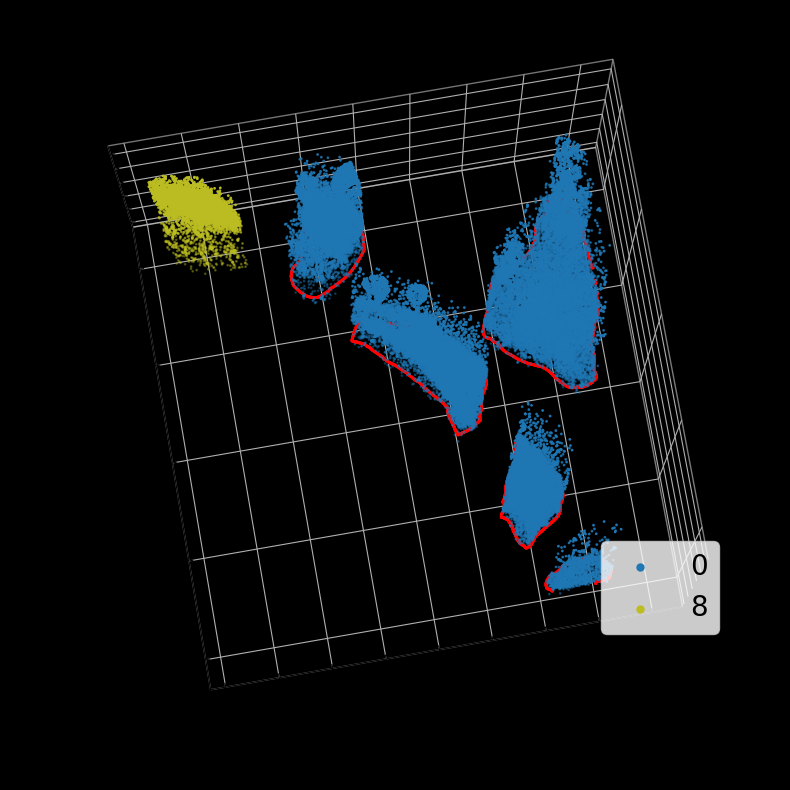

In [271]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='r')

for cluster in bm_020_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster)]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=1,color=color,label=cluster)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=5)

plt.tight_layout()

plt.savefig(r'.\figures\bm_020_count_cluster_dist.png',dpi=300)

## shorter distance between count cluster 2 and patch correlation cluster 7

In [123]:
intercluster_distances.insert(loc=0, column='cell1', value=distance_df['cell_1'].tolist()+distance_df['cell_1'].tolist())
intercluster_distances.insert(loc=1, column='cell2', value=distance_df['cell_2'].tolist()+distance_df['cell_2'].tolist())

In [190]:
intercluster_distances[intercluster_distances['count_corr']=='2_7']

,cell1,cell2,distance,count_corr,count_var,count_embedding
1773,uc_005_01,uc_005_02,126.692742,2_7,2_0,2_1
1779,uc_006_01,uc_006_02,106.873070,2_7,2_0,2_5
1780,uc_006_01,uc_006_03,88.996691,2_7,2_0,2_5
1782,uc_006_02,uc_006_03,54.214154,2_7,2_0,2_5
1785,uc_007_01,uc_007_02,75.653131,2_7,2_0,2_5
...,...,...,...,...,...,...
4985,uc_008_09,uc_008_11,46.028493,2_7,2_0,2_5
5031,uc_009_17,uc_009_18,96.155499,2_7,2_0,2_1
5600,uc_033_10,uc_033_13,116.169005,2_7,2_1,2_0
5602,uc_033_10,uc_033_15,68.492582,2_7,2_1,2_0


In [272]:
fovs = []
for item in intercluster_distances['cell1'].tolist():
    fovs.append(item.split('_')[0]+'_'+item.split('_')[1])
intercluster_distances.insert(loc=2, column='fov', value=fovs)

### bm_030 count count5 corr6 near

In [277]:
intercluster_distances['fov']=='bm_030'

0       False
1       False
2       False
3       False
4       False
        ...  
6179    False
6180    False
6181    False
6182    False
6183    False
Name: fov, Length: 6184, dtype: bool

In [279]:
temp = intercluster_distances[intercluster_distances['fov']=='bm_030']
temp[temp['count_corr']=='5_6']

,cell1,cell2,fov,distance,count_corr,count_var,count_embedding
1335,bm_030_07,bm_030_08,bm_030,86.795990,5_6,5_3,5_2
1336,bm_030_07,bm_030_09,bm_030,30.493156,5_6,5_3,5_2
1337,bm_030_07,bm_030_10,bm_030,43.821191,5_6,5_3,5_2
1348,bm_030_09,bm_030_10,bm_030,43.072405,5_6,5_3,5_2
4369,bm_030_01,bm_030_07,bm_030,125.819301,5_6,5_3,5_2
4371,bm_030_01,bm_030_09,bm_030,146.463928,5_6,5_3,5_2
4372,bm_030_01,bm_030_10,bm_030,168.387009,5_6,5_3,5_2
4373,bm_030_01,bm_030_11,bm_030,158.137723,5_6,5_3,5_2
4392,bm_030_03,bm_030_07,bm_030,89.012969,5_6,5_3,5_2
4394,bm_030_03,bm_030_09,bm_030,119.171900,5_6,5_3,5_2


In [287]:
count_cells = ['bm_030_01']
corr_cells = ['bm_030_07','bm_030_09','bm_030_10','bm_030_11']
count_clusters = {}
for item in count_cells:
    idx = count_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = 'count '+count_adata.obs['leiden'].tolist()[idx]
corr_clusters = {}
for item in corr_cells:
    idx = corr_adata.obs['cell_id'].tolist().index(item)
    clusters[item] = 'correlation '+corr_adata.obs['leiden'].tolist()[idx]

In [288]:
bm_030_dots = []
clustering = []
for item in count_cells:
    bm_030_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
for item in corr_cells:
    bm_030_dots.append(dots[dots['cellID']==item])
    clustering = clustering + [clusters[item]] * dots[dots['cellID']==item].shape[0]
bm_030_dots = pd.concat(bm_030_dots)

In [289]:
bm_030_dots.insert(loc=bm_030_dots.shape[1], column='clustering', value=clustering)

In [290]:
dots_by_cluster = bm_030_dots.groupby('clustering')

In [291]:
mask = tifffile.imread(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_segmentation\cellpose\combined_rna\bm_rgb_combined\masks\030_mask.tif')
mask = (mask==1).astype('int') + (mask==2).astype('int') + (mask==3).astype('int') + (mask==4).astype('int') + (mask==5).astype('int')

# Outline of cells 1, 2, 3, 4, 5 from mask
cells = [1,7,9,10,11]
outline_row = []
outline_col = []
for item in cells:
    boundarie = find_boundaries(mask==i, mode='thick')
    coors = np.where(boundarie==1)
    outline_row = outline_row + list(coors[0])
    outline_col = outline_col + list(coors[1])

outline_row = np.array(outline_row)
outline_col = np.array(outline_col)

outline_z = np.ones(len(outline_row)) * 12 * 0.3

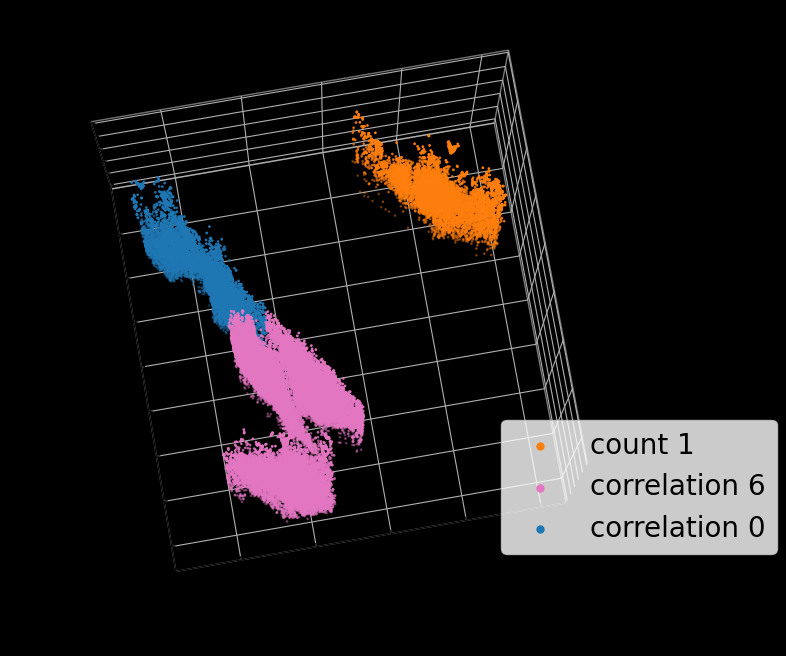

In [294]:
# subset of gnes
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(outline_row*scale,outline_col*scale,outline_z,s=1,color='r')

for cluster in bm_030_dots['clustering'].unique():
    sub_group = dots_by_cluster.get_group(cluster)
    color = count_colors[int(cluster[-1])]
    ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=1,color=color,label=cluster)
        
ax.view_init(-100, 100)

ax.legend(loc='center left',bbox_to_anchor=(0.75,0.25),ncol=1,fontsize=20,markerscale=5)

plt.tight_layout()

plt.savefig(r'.\figures\bm_030_count_cluster_dist.png',dpi=300)

### uc_033 count3 corr7 near

### uc_007 count1 corr7 far

### bm_020 count8 corr6 far

# Find patches closer to homotypic cells

In [19]:
distance_df

,distance,cell_1,cell_2,cluster_pair,corr_cluster_pair,variability_cluster_pair,embedding_cluster_pair,fov
0,0.000000,bm_001_01,bm_001_01,5_5,0_0,0_0,6_6,bm_001
1,48.764390,bm_001_01,bm_001_02,5_5,0_0,0_2,6_2,bm_001
2,80.216085,bm_001_03,bm_001_01,0_5,5_0,2_0,4_6,bm_001
3,165.992095,bm_001_04,bm_001_01,0_5,0_0,2_0,4_6,bm_001
4,181.111975,bm_001_05,bm_001_01,0_5,1_0,2_0,4_6,bm_001
...,...,...,...,...,...,...,...,...
3640,86.530027,uc_047_03,uc_047_04,3_3,4_4,1_1,0_0,uc_047
3641,95.420655,uc_047_03,uc_047_05,3_3,4_4,1_1,0_0,uc_047
3642,0.000000,uc_047_04,uc_047_04,3_3,4_4,1_1,0_0,uc_047
3643,58.542860,uc_047_04,uc_047_05,3_3,4_4,1_1,0_0,uc_047


In [20]:
homotypic_pairs = []
for i in range(distance_df.shape[0]):
    cluster_pair = distance_df.iloc[i]['cluster_pair']
    if cluster_pair.split('_')[0] == cluster_pair.split('_')[1]:
        homotypic_pairs.append(True)
    else:
        homotypic_pairs.append(False)

homotypic = distance_df[homotypic_pairs]
heterotypic = distance_df[~np.array(homotypic_pairs)]

homotypic_cell_type = []
for item in homotypic['cell_1'].tolist():
    homotypic_cell_type.append(item.split('_')[0])
homotypic.insert(loc=0, column='cell_type', value=homotypic_cell_type)
homotypic_bm = homotypic[homotypic['cell_type']=='bm']
homotypic_uc = homotypic[homotypic['cell_type']=='uc']

heterotypic_cell_type = []
for item in heterotypic['cell_1'].tolist():
    heterotypic_cell_type.append(item.split('_')[0])
heterotypic.insert(loc=0, column='cell_type', value=heterotypic_cell_type)
heterotypic_bm = heterotypic[heterotypic['cell_type']=='bm']
heterotypic_uc = heterotypic[heterotypic['cell_type']=='uc']

In [21]:
print("homotypic bm: ",homotypic_bm.shape[0])
print("homotypic uc: ",homotypic_uc.shape[0])
print("heterotypic bm: ",heterotypic_bm.shape[0])
print("heterotypic uc: ",heterotypic_uc.shape[0])


homotypic bm:  1673
homotypic uc:  996
heterotypic bm:  284
heterotypic uc:  692


In [23]:
homotypic_bm

,cell_type,distance,cell_1,cell_2,cluster_pair,corr_cluster_pair,variability_cluster_pair,embedding_cluster_pair,fov
0,bm,0.000000,bm_001_01,bm_001_01,5_5,0_0,0_0,6_6,bm_001
1,bm,48.764390,bm_001_01,bm_001_02,5_5,0_0,0_2,6_2,bm_001
5,bm,0.000000,bm_001_02,bm_001_02,5_5,0_0,2_2,2_2,bm_001
9,bm,0.000000,bm_001_03,bm_001_03,0_0,5_5,2_2,4_4,bm_001
10,bm,147.443309,bm_001_03,bm_001_04,0_0,5_0,2_2,4_4,bm_001
...,...,...,...,...,...,...,...,...,...
1948,bm,80.931119,bm_036_04,bm_036_05,5_5,6_6,3_3,2_2,bm_036
1951,bm,0.000000,bm_036_05,bm_036_05,5_5,6_6,3_3,2_2,bm_036
1954,bm,0.000000,bm_036_06,bm_036_06,1_1,6_6,3_3,2_2,bm_036
1955,bm,43.008623,bm_036_06,bm_036_07,1_1,6_0,3_3,2_2,bm_036


## find patches that faces other cells

In [22]:
bm_distances = pd.concat([homotypic_bm,heterotypic_bm])
uc_distances = pd.concat([homotypic_uc,heterotypic_uc])

In [116]:
# bm_fov = []
# for item in bm_distances['cell_1'].tolist():
#     bm_fov.append(item.split('_')[0]+'_'+item.split('_')[1])
# bm_distances.insert(loc=0, column='fov', value=bm_fov)

# uc_fov = []
# for item in uc_distances['cell_1'].tolist():
#     uc_fov.append(item.split('_')[0]+'_'+item.split('_')[1])
# # uc_distances.insert(loc=0, column='fov', value=uc_fov)

### single-fov example

In [60]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

bm_001_l = []
cell_ids = []
for item in cell_l:
    if 'bm_001' in item:
        cell_ids.append(item.split('.')[0])
        bm_001_l.append(pd.read_csv(os.path.join(in_dir,item),index_col=0))

patch_row = []
patch_col = []
patch_z = []
patch_id = []
for i,item in enumerate(bm_001_l):
    
    cell_patches = item.groupby('patch')
    centers = cell_patches.mean()
    patch_row = patch_row + centers['row'].tolist()
    patch_col = patch_col + centers['col'].tolist()
    patch_z = patch_z + centers['z'].tolist()
    
    for j in range(centers.shape[0]):
        patch_id.append(cell_ids[i] + '_' + str(centers.index[j]).zfill(2))

In [61]:
fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)

In [68]:
from scipy.spatial import Voronoi

In [121]:
vor = Voronoi(fov_patch_df[['row','col']].values)

In [64]:
fov_patch_df

,row,col,z
bm_001_01_00,167.983607,580.934426,13.459016
bm_001_01_01,219.658333,492.091667,16.541667
bm_001_01_02,137.956522,548.521739,13.391304
bm_001_01_03,176.945455,526.390909,10.318182
bm_001_01_04,148.495413,575.954128,14.669725
...,...,...,...
bm_001_05_50,1634.890845,1166.630282,8.538732
bm_001_05_51,1735.058608,1178.446886,9.256410
bm_001_05_52,1711.211111,850.774074,8.570370
bm_001_05_53,1682.809717,1012.931174,8.348178


In [65]:
vor.ridge_points.shape

(1096, 2)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_250292\3739402199.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


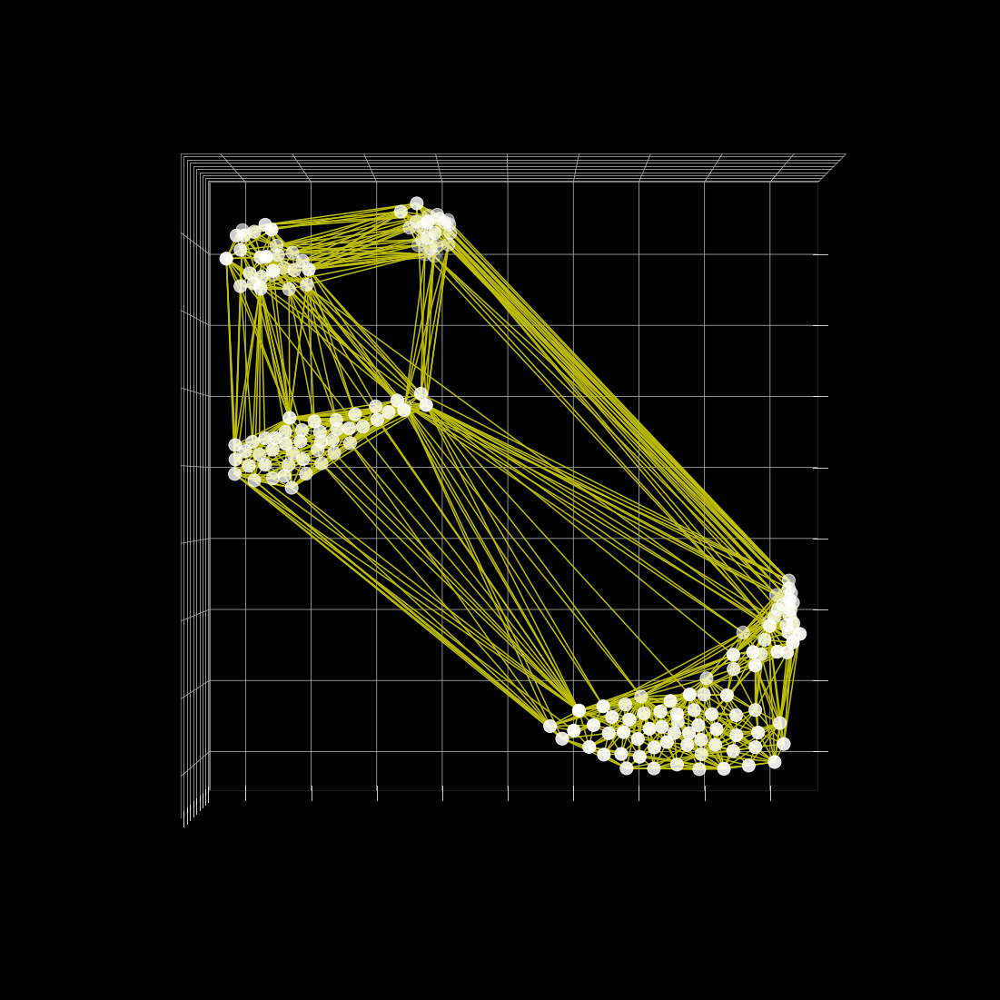

In [66]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_patch_df['row']*scale,fov_patch_df['col']*scale,fov_patch_df['z']*z_scale,s=200,color='w')
    for i in range(vor.ridge_points.shape[0]):
        ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color='y')
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(90, 0)
    plt.tight_layout()

In [67]:
# Find patch id that connects with another cell
boarder_patch = []
for i in range(vor.ridge_points.shape[0]):
    patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
    temp = patch1.split('_')
    cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
    patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
    temp = patch2.split('_')
    cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
    if cell1 != cell2:
        boarder_patch.append([patch1,patch2])
print(len(boarder_patch))

197


### Visualize an example fov

#### uc 003

In [32]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

uc_003_l = []
cells = ['uc_003_01', 'uc_003_02', 'uc_003_03', 'uc_003_04', 'uc_003_05']
cell_ids = []
for item in cell_l:
    if item.split('.')[0] in cells:
        cell_ids.append(item.split('.')[0])
        uc_003_l.append(pd.read_csv(os.path.join(in_dir,item),index_col=0))

patch_row = []
patch_col = []
patch_z = []
patch_id = []
for i,item in enumerate(uc_003_l):
    
    cell_patches = item.groupby('patch')
    centers = cell_patches.mean()
    patch_row = patch_row + centers['row'].tolist()
    patch_col = patch_col + centers['col'].tolist()
    patch_z = patch_z + centers['z'].tolist()
    
    for j in range(centers.shape[0]):
        patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))

In [33]:
fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)

In [34]:
vor = Voronoi(fov_patch_df[['row','col']].values)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2723289374.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


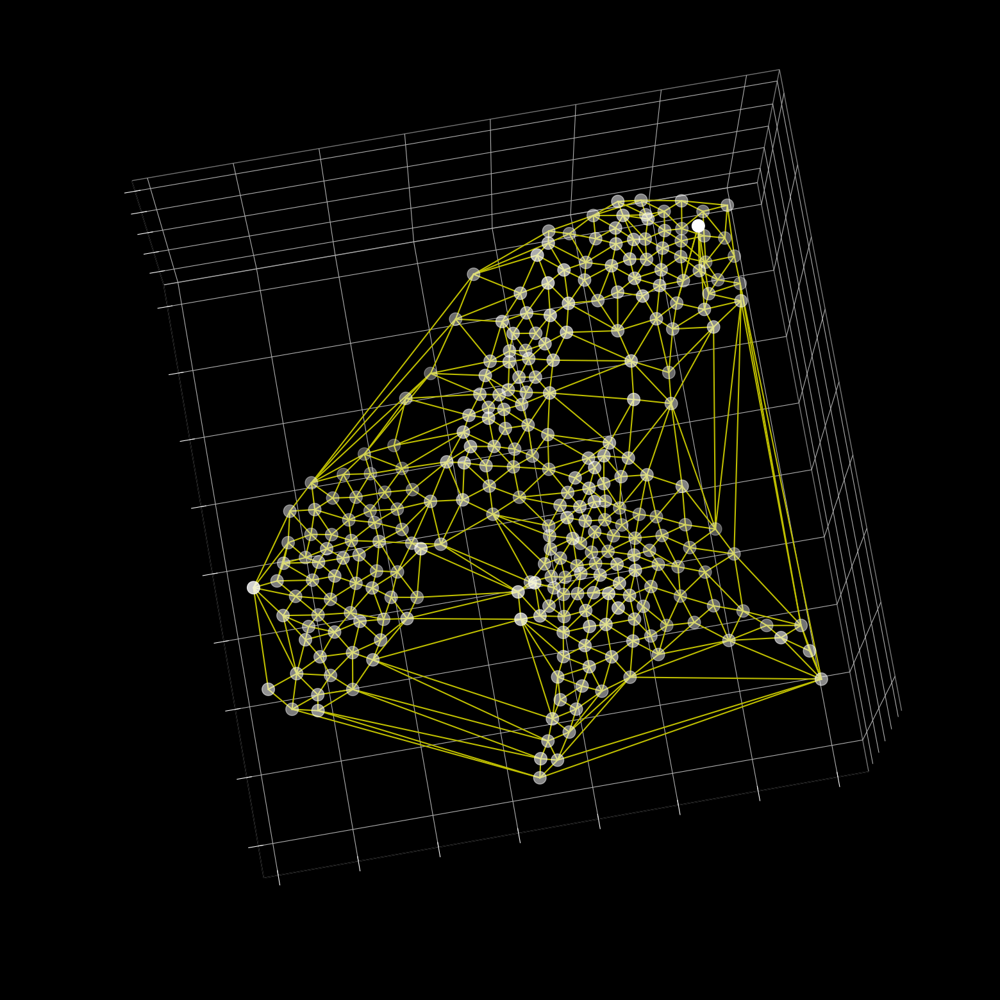

In [35]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_patch_df['row']*scale,fov_patch_df['col']*scale,fov_patch_df['z']*z_scale,s=200,color='w')
    for i in range(vor.ridge_points.shape[0]):
        ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color='y')
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

In [36]:
uc_003_boarder_patch = []
for i in range(vor.ridge_points.shape[0]):
    patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
    temp = patch1.split('_')
    cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
    patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
    temp = patch2.split('_')
    cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
    if cell1 != cell2:
        if not patch1 in uc_003_boarder_patch:
            uc_003_boarder_patch.append(patch1)
        if not patch2 in uc_003_boarder_patch:
            uc_003_boarder_patch.append(patch2)

In [37]:
fov_patch_df

,row,col,z
uc_003_01_0,590.242857,459.603571,13.028571
uc_003_01_1,571.906667,540.277576,14.372121
uc_003_01_2,739.241798,155.462940,11.187120
uc_003_01_3,649.526245,589.196501,11.946164
uc_003_01_4,528.685083,651.845304,12.712707
...,...,...,...
uc_003_05_63,1062.777778,774.820513,15.329060
uc_003_05_64,1181.792350,1003.868852,10.131148
uc_003_05_65,1546.050000,441.818750,12.931250
uc_003_05_66,1404.566879,1022.331210,11.815287


C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2210586424.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


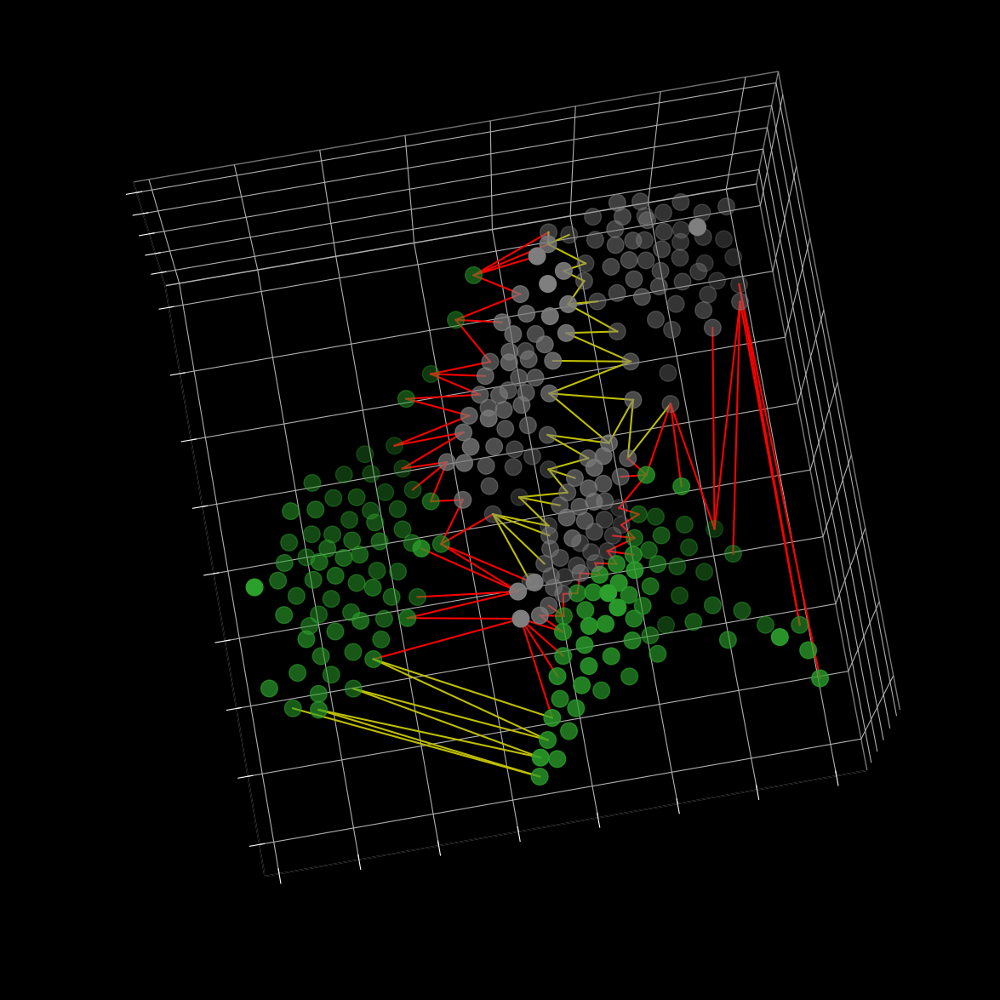

In [38]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=200,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if count_adata.obs['leiden'][cell1_idx] == count_adata.obs['leiden'][cell2_idx]:
                color = 'y'
            else:
                color='r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1477368486.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


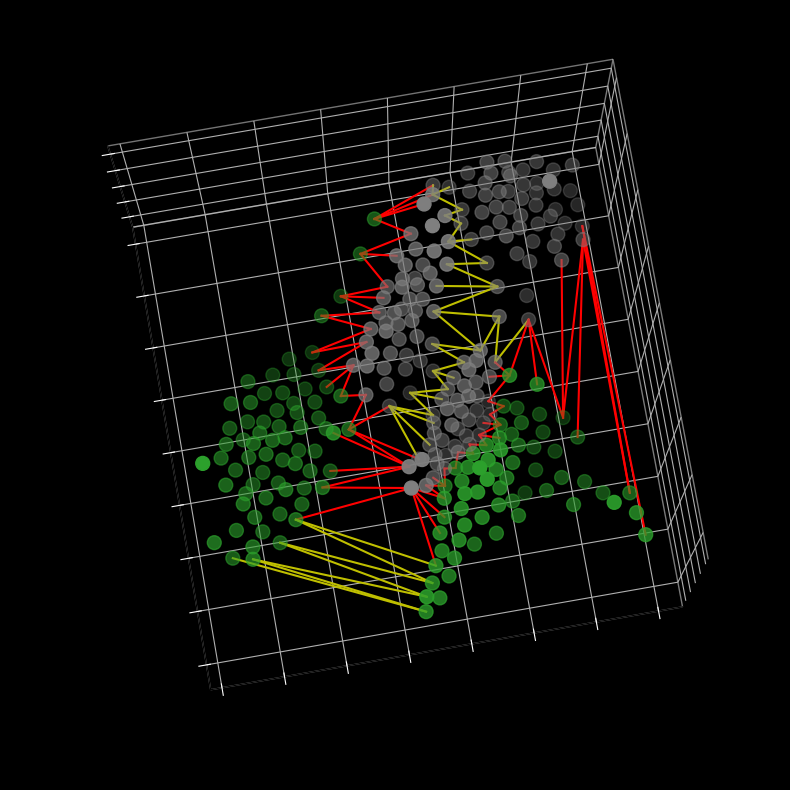

In [40]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=100,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if count_adata.obs['leiden'][cell1_idx] == count_adata.obs['leiden'][cell2_idx]:
                color = 'y'
            else:
                color='r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_003_boarder_patches.png',dpi=300)

#### uc 002

In [9]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

in_fov_l = []
cells = ['uc_002_01', 'uc_002_03', 'uc_002_04', 'uc_002_05']
cell_ids = []
for item in cell_l:
    if item.split('.')[0] in cells:
        cell_ids.append(item.split('.')[0])
        in_fov_l.append(pd.read_csv(os.path.join(in_dir,item),index_col=0))

patch_row = []
patch_col = []
patch_z = []
patch_id = []
for i,item in enumerate(in_fov_l):
    
    cell_patches = item.groupby('patch')
    centers = cell_patches.mean()
    patch_row = patch_row + centers['row'].tolist()
    patch_col = patch_col + centers['col'].tolist()
    patch_z = patch_z + centers['z'].tolist()
    
    for j in range(centers.shape[0]):
        patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))

In [10]:
fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)

In [14]:
vor = Voronoi(fov_patch_df[['row','col']].values)

In [19]:
proxi_df

,index,ACAN_ACTb,ACAN_ALPL,ACAN_CCL11,ACAN_CCL19,ACAN_CD105,ACAN_CD11B,ACAN_CD19,ACAN_CD34,ACAN_CD45,...,RUNX1_SOX9,RUNX1_SPP1,SOX9_SPP1,SPP1_SPP1,cluster,row,col,z,cellID,patch_name
0,bm_001_01_0,0.000000,0.000000,0.000000,0.000000,2.848236,0.000000,-1.133975,-0.945549,0.000000,...,0.000000,0.000000,0.000000,0.000000,0,167.983607,580.934426,13.459016,bm_001_01,bm_001_01_0
1,bm_001_01_1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.333996,2.560510,-0.389507,0.000000,5,219.658333,492.091667,16.541667,bm_001_01,bm_001_01_1
2,bm_001_01_2,0.000000,0.000000,0.848949,0.000000,-0.968066,0.000000,0.000000,2.190913,0.000000,...,-0.229416,0.000000,0.000000,0.000000,1,137.956522,548.521739,13.391304,bm_001_01,bm_001_01_2
3,bm_001_01_3,0.000000,-0.280918,0.000000,-0.252646,-0.365896,-0.298339,-0.400994,-0.730901,0.000000,...,0.000000,0.000000,0.000000,5.843122,9,176.945455,526.390909,10.318182,bm_001_01,bm_001_01_3
4,bm_001_01_4,-0.198547,-0.262222,0.000000,3.404948,0.836933,-0.385988,-0.463018,-0.473670,0.000000,...,-0.278070,0.000000,0.000000,0.000000,0,148.495413,575.954128,14.669725,bm_001_01,bm_001_01_4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25436,uc_047_05_46,-0.892481,-0.241702,-0.740149,-0.147904,4.127215,-0.166987,-0.148583,-0.872376,-0.850557,...,0.000000,1.842718,0.000000,8.325613,2,1724.725000,472.520000,12.935000,uc_047_05,uc_047_05_46
25437,uc_047_05_47,-1.753374,-0.306139,0.000000,-0.594225,-0.872577,-0.400392,-0.804755,-0.488768,-1.069667,...,0.000000,-0.399104,0.000000,-0.352473,8,1602.498728,531.333333,9.824427,uc_047_05,uc_047_05_47
25438,uc_047_05_48,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,6.739067,6,1488.423280,691.671958,10.142857,uc_047_05,uc_047_05_48
25439,uc_047_05_49,-1.193224,-0.274122,-0.386556,0.000000,-0.467144,-0.361698,2.846123,-0.415236,-0.290445,...,1.780727,0.922715,-0.521675,-0.487505,0,1857.138365,673.716981,10.062893,uc_047_05,uc_047_05_49


C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2723289374.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


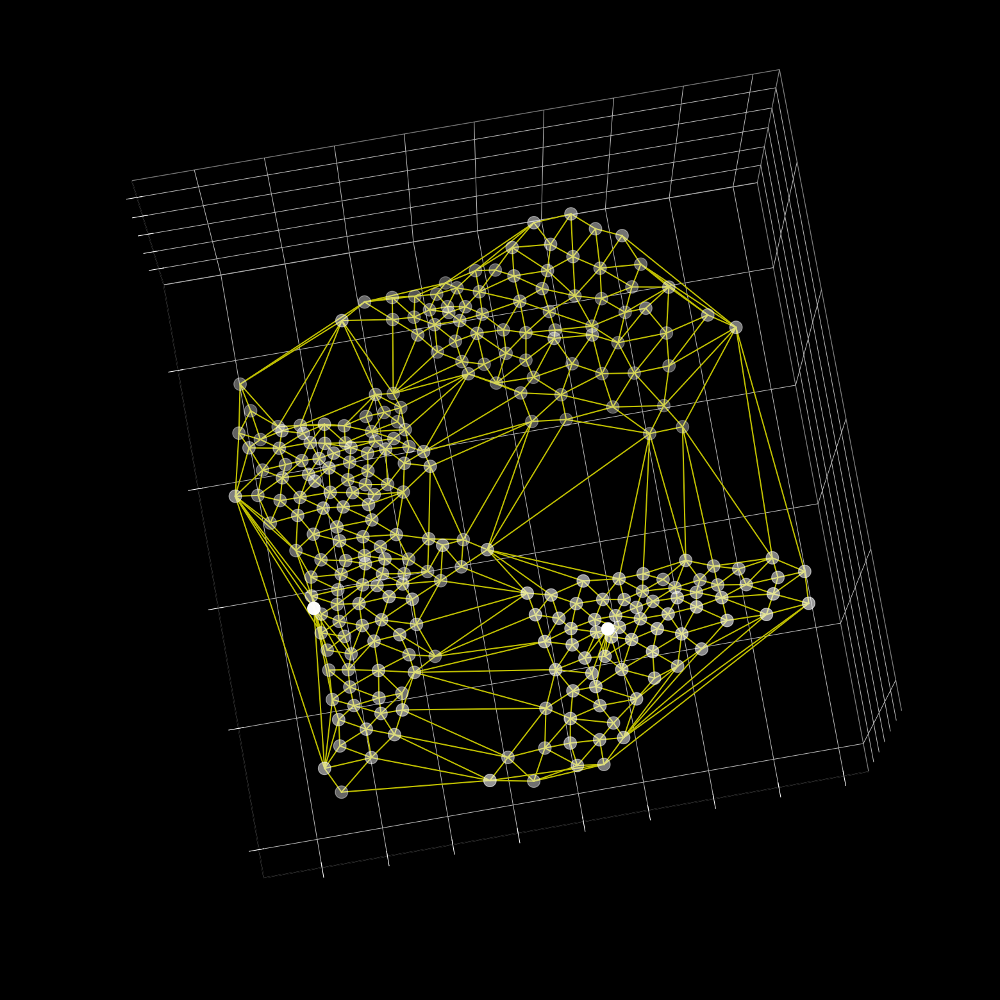

In [22]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_patch_df['row']*scale,fov_patch_df['col']*scale,fov_patch_df['z']*z_scale,s=200,color='w')
    for i in range(vor.ridge_points.shape[0]):
        ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color='y')
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

In [23]:
boarder_patch = []
for i in range(vor.ridge_points.shape[0]):
    patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
    temp = patch1.split('_')
    cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
    patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
    temp = patch2.split('_')
    cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
    if cell1 != cell2:
        if not patch1 in boarder_patch:
            boarder_patch.append(patch1)
        if not patch2 in boarder_patch:
            boarder_patch.append(patch2)

In [24]:
fov_patch_df

,row,col,z
uc_002_01_0,548.860750,247.379509,12.491342
uc_002_01_1,627.679160,497.747376,13.847826
uc_002_01_2,753.680061,394.037149,13.338135
uc_002_01_3,501.302844,527.566487,13.103766
uc_002_01_4,197.757952,591.720714,12.554694
...,...,...,...
uc_002_05_54,1089.659517,1506.876676,9.412869
uc_002_05_55,1311.262295,1244.412568,12.571038
uc_002_05_56,1471.584302,1694.526163,10.066860
uc_002_05_57,1416.053892,1224.940120,10.685629


In [25]:
vor.ridge_points

array([[137,  68],
       [137, 142],
       [137, 132],
       ...,
       [244, 243],
       [243, 213],
       [213, 235]], dtype=int32)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1850218459.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


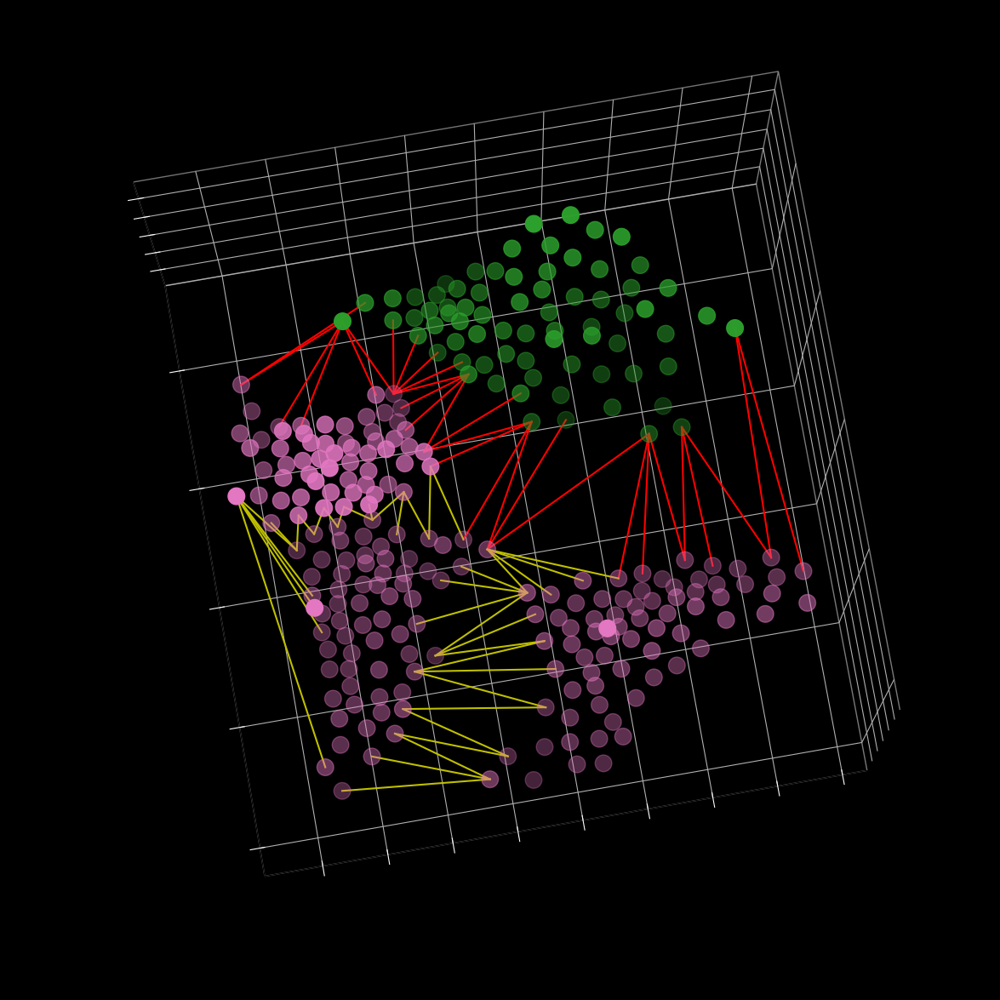

In [30]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_002_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=200,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1055345319.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


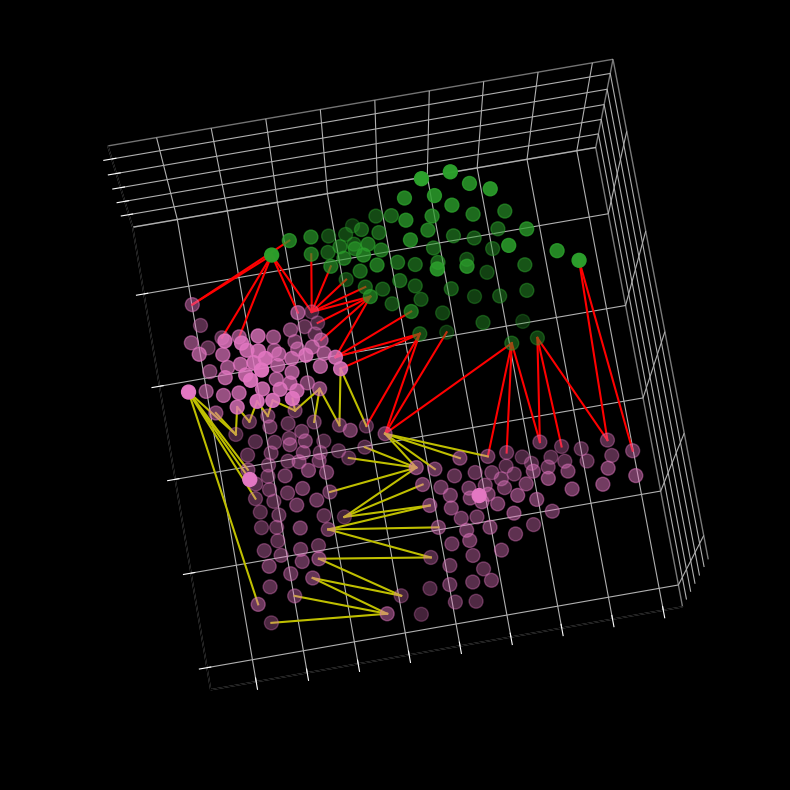

In [31]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=100,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_002_boarder_patches.png',dpi=300)

#### uc 012

In [41]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

in_fov_l = []
cells = ['uc_012_04', 'uc_012_07', 'uc_012_08']
cell_ids = []
for item in cell_l:
    if item.split('.')[0] in cells:
        cell_ids.append(item.split('.')[0])
        in_fov_l.append(pd.read_csv(os.path.join(in_dir,item),index_col=0))

patch_row = []
patch_col = []
patch_z = []
patch_id = []
for i,item in enumerate(in_fov_l):
    
    cell_patches = item.groupby('patch')
    centers = cell_patches.mean()
    patch_row = patch_row + centers['row'].tolist()
    patch_col = patch_col + centers['col'].tolist()
    patch_z = patch_z + centers['z'].tolist()
    
    for j in range(centers.shape[0]):
        patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))

In [42]:
fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)

In [43]:
vor = Voronoi(fov_patch_df[['row','col']].values)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2723289374.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


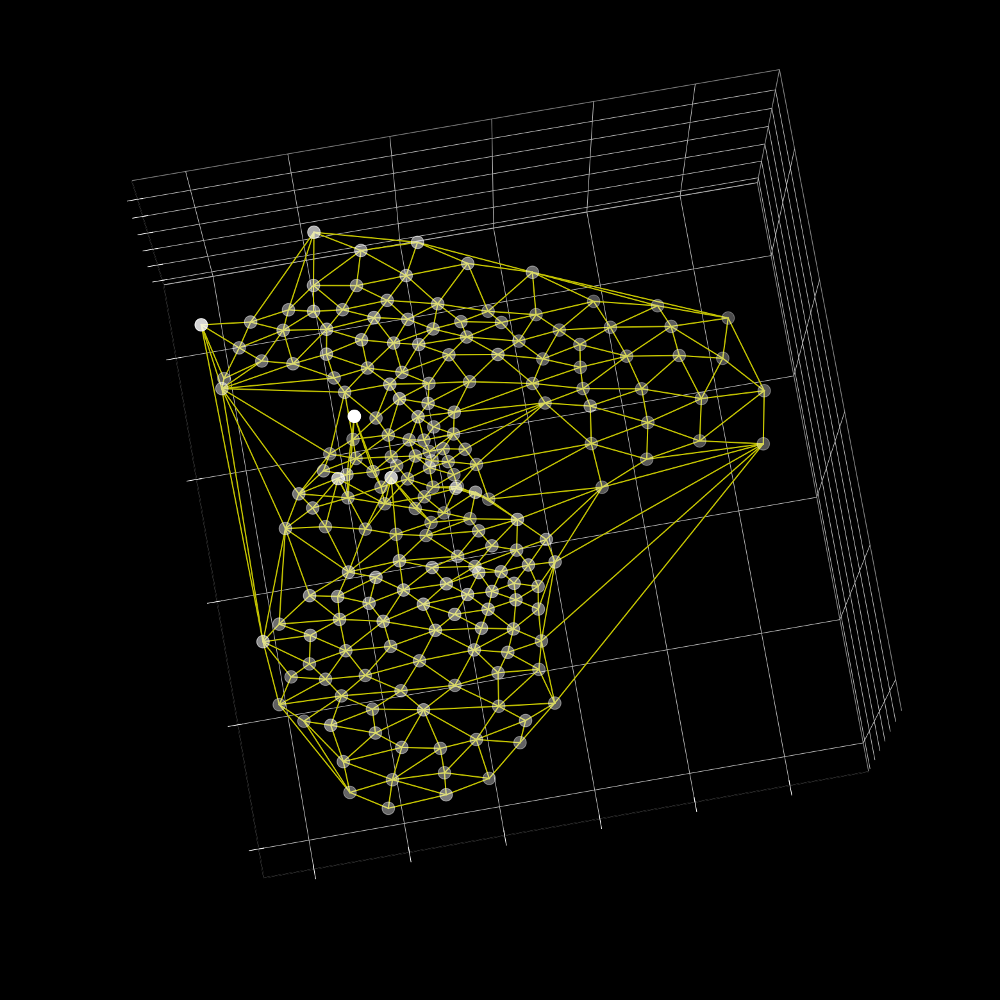

In [45]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_patch_df['row']*scale,fov_patch_df['col']*scale,fov_patch_df['z']*z_scale,s=200,color='w')
    for i in range(vor.ridge_points.shape[0]):
        ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color='y')
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

In [46]:
boarder_patch = []
for i in range(vor.ridge_points.shape[0]):
    patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
    temp = patch1.split('_')
    cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
    patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
    temp = patch2.split('_')
    cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
    if cell1 != cell2:
        if not patch1 in boarder_patch:
            boarder_patch.append(patch1)
        if not patch2 in boarder_patch:
            boarder_patch.append(patch2)

In [47]:
fov_patch_df

,row,col,z
uc_012_04_0,1555.283851,1726.387578,14.329193
uc_012_04_1,1363.986037,1871.073138,13.846410
uc_012_04_2,1526.656124,1644.623822,12.977120
uc_012_04_3,1646.331480,1727.446143,13.488534
uc_012_04_4,1524.831549,1800.132762,13.124911
...,...,...,...
uc_012_08_46,1661.376106,1165.336283,9.601770
uc_012_08_47,1500.602740,1314.013699,10.465753
uc_012_08_48,1698.014634,1259.775610,10.897561
uc_012_08_49,1559.825301,1238.614458,10.481928


In [48]:
vor.ridge_points

array([[ 42,  67],
       [ 42,  41],
       [ 42,  51],
       ...,
       [182, 175],
       [171, 184],
       [175, 184]], dtype=int32)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1850218459.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


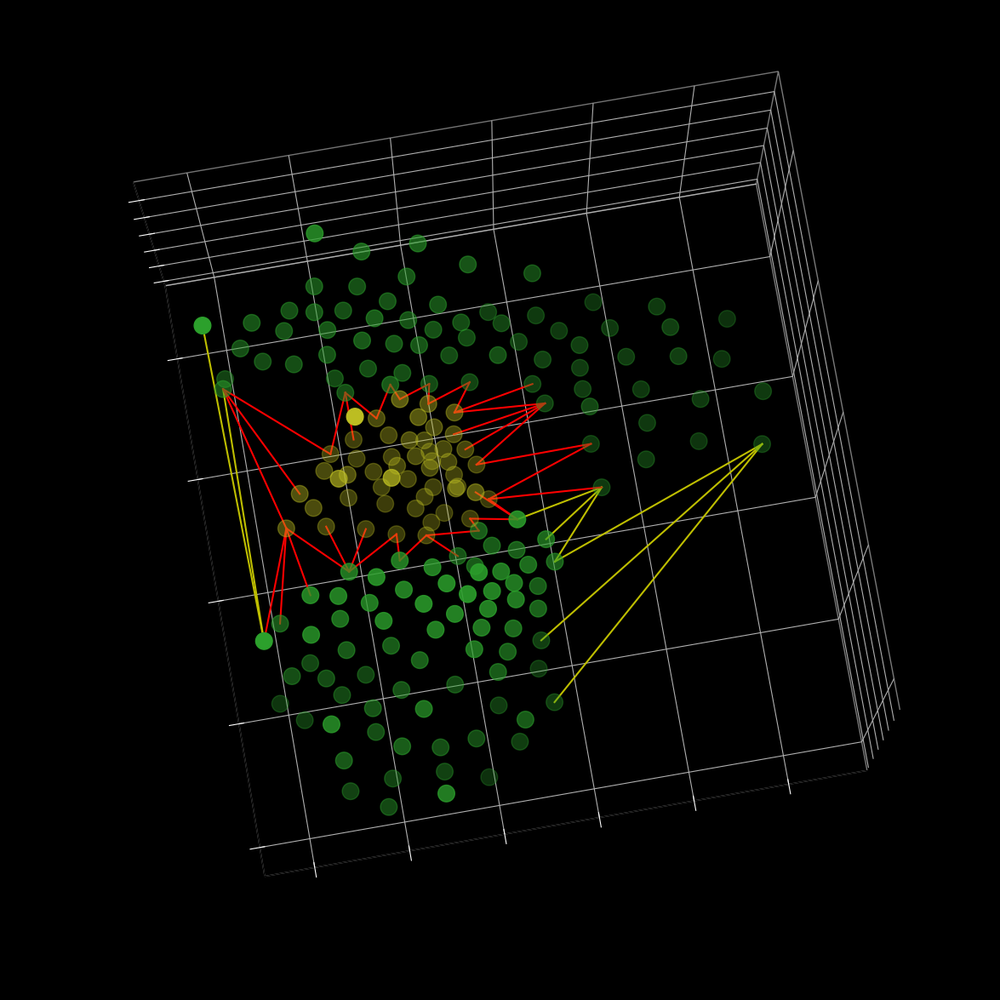

In [49]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_002_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=200,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1529571867.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


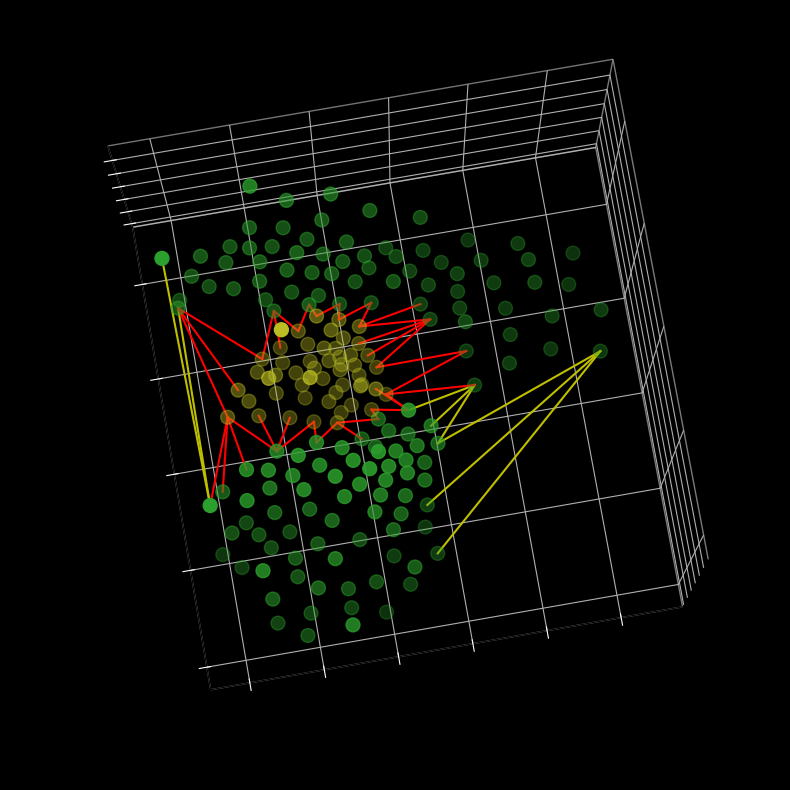

In [50]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=100,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_012_boarder_patches.png',dpi=300)

#### uc 034

In [51]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

in_fov_l = []
cells = ['uc_034_01', 'uc_034_02', 'uc_034_08']
cell_ids = []
for item in cell_l:
    if item.split('.')[0] in cells:
        cell_ids.append(item.split('.')[0])
        in_fov_l.append(pd.read_csv(os.path.join(in_dir,item),index_col=0))

patch_row = []
patch_col = []
patch_z = []
patch_id = []
for i,item in enumerate(in_fov_l):
    
    cell_patches = item.groupby('patch')
    centers = cell_patches.mean()
    patch_row = patch_row + centers['row'].tolist()
    patch_col = patch_col + centers['col'].tolist()
    patch_z = patch_z + centers['z'].tolist()
    
    for j in range(centers.shape[0]):
        patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))

In [52]:
fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)

In [53]:
vor = Voronoi(fov_patch_df[['row','col']].values)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2723289374.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


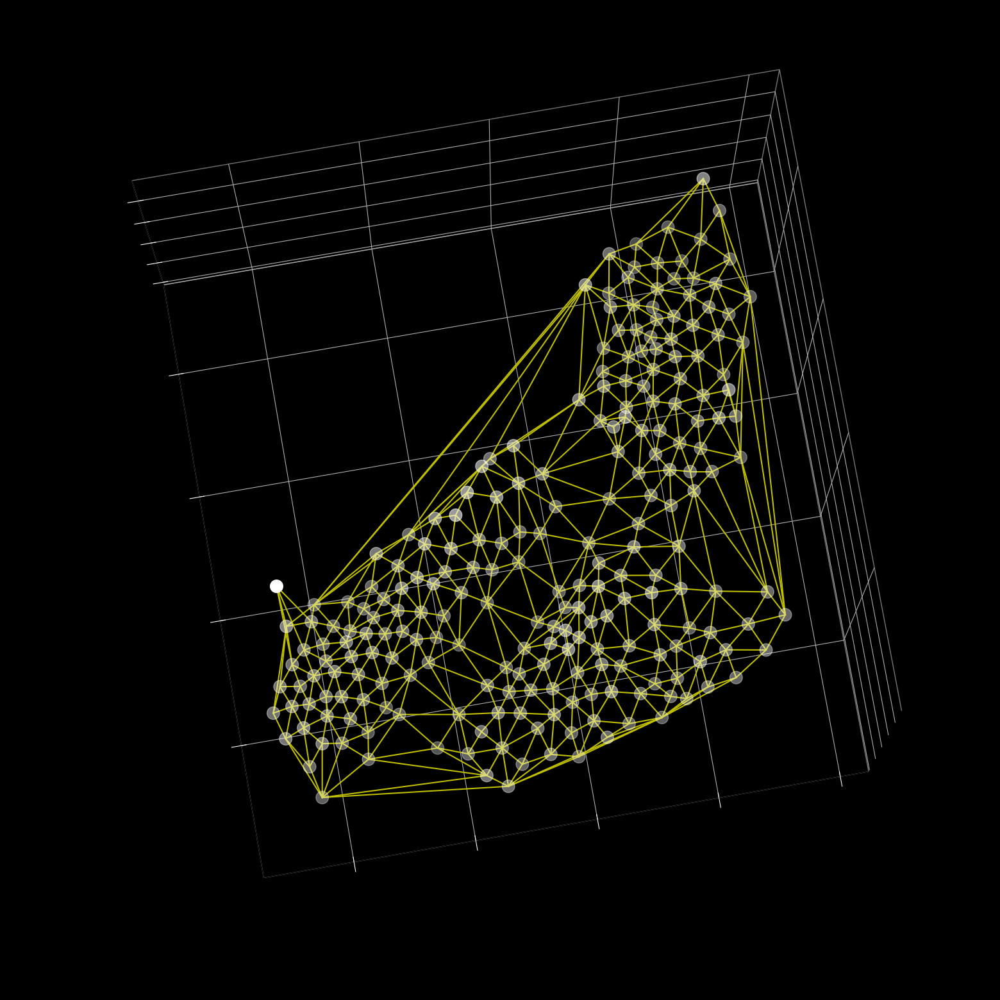

In [54]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_patch_df['row']*scale,fov_patch_df['col']*scale,fov_patch_df['z']*z_scale,s=200,color='w')
    for i in range(vor.ridge_points.shape[0]):
        ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color='y')
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

In [55]:
boarder_patch = []
for i in range(vor.ridge_points.shape[0]):
    patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
    temp = patch1.split('_')
    cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
    patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
    temp = patch2.split('_')
    cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
    if cell1 != cell2:
        if not patch1 in boarder_patch:
            boarder_patch.append(patch1)
        if not patch2 in boarder_patch:
            boarder_patch.append(patch2)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1850218459.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


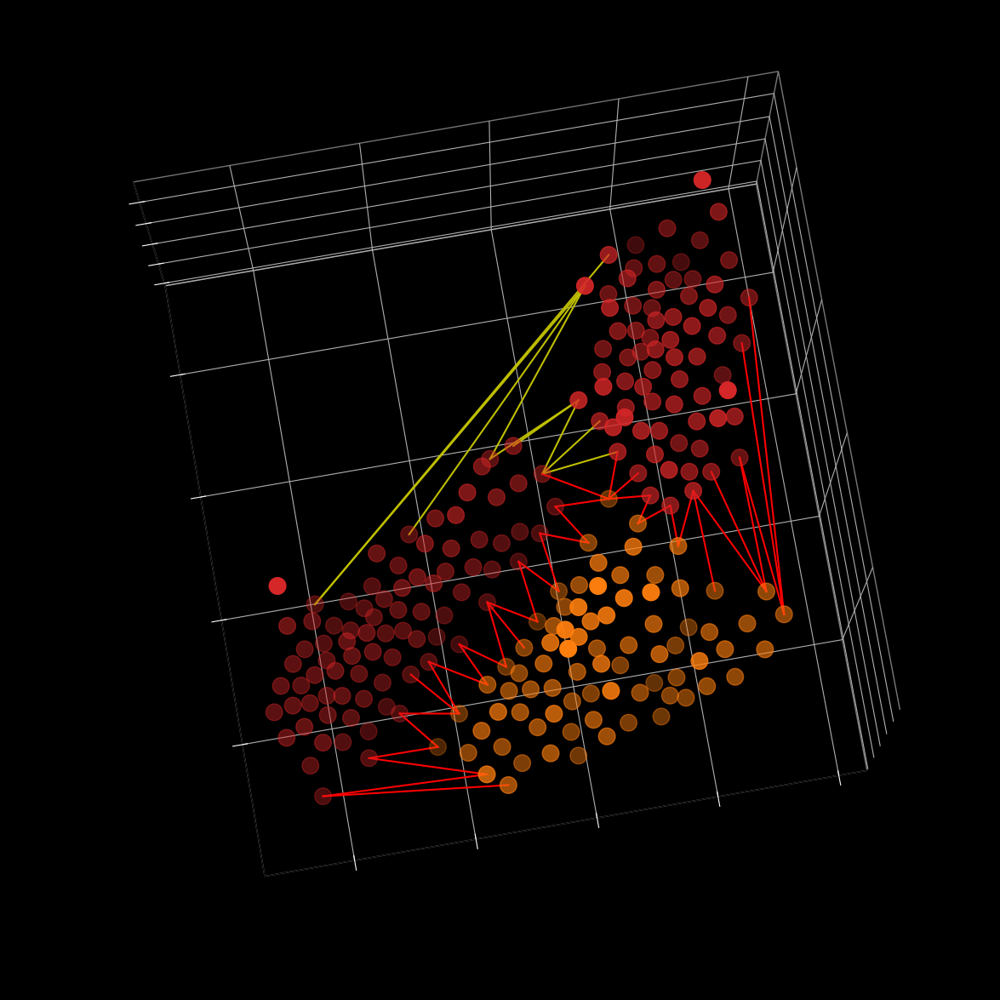

In [56]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_002_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=200,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\3352718115.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


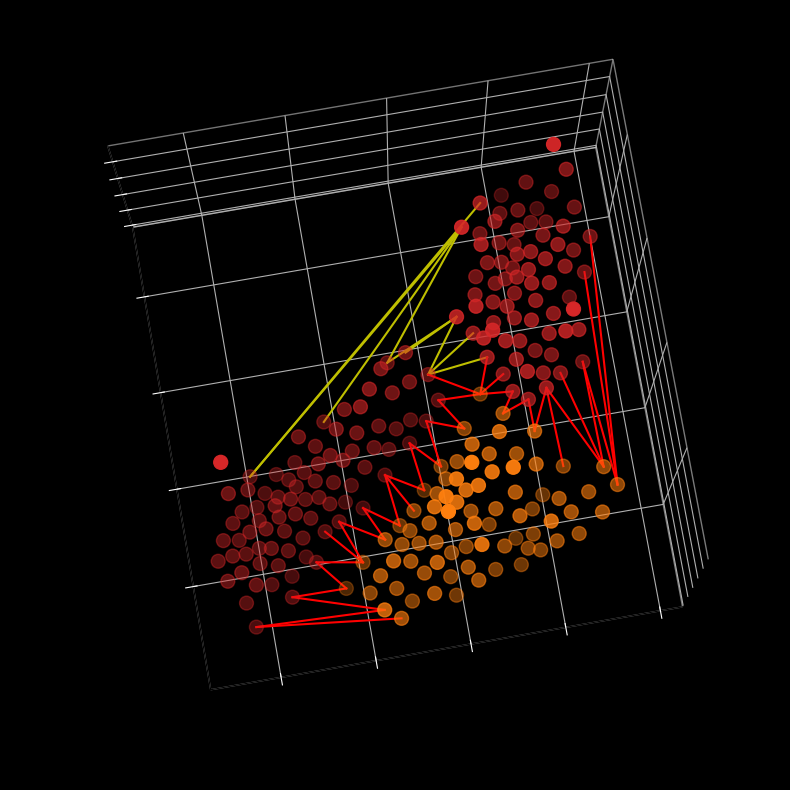

In [57]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=100,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_034_boarder_patches.png',dpi=300)

#### bm 006

In [58]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

in_fov_l = []
cells = ['bm_006_10', 'bm_006_11', 'bm_006_12']
cell_ids = []
for item in cell_l:
    if item.split('.')[0] in cells:
        cell_ids.append(item.split('.')[0])
        in_fov_l.append(pd.read_csv(os.path.join(in_dir,item),index_col=0))

patch_row = []
patch_col = []
patch_z = []
patch_id = []
for i,item in enumerate(in_fov_l):
    
    cell_patches = item.groupby('patch')
    centers = cell_patches.mean()
    patch_row = patch_row + centers['row'].tolist()
    patch_col = patch_col + centers['col'].tolist()
    patch_z = patch_z + centers['z'].tolist()
    
    for j in range(centers.shape[0]):
        patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))

In [59]:
fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)

In [60]:
vor = Voronoi(fov_patch_df[['row','col']].values)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2723289374.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


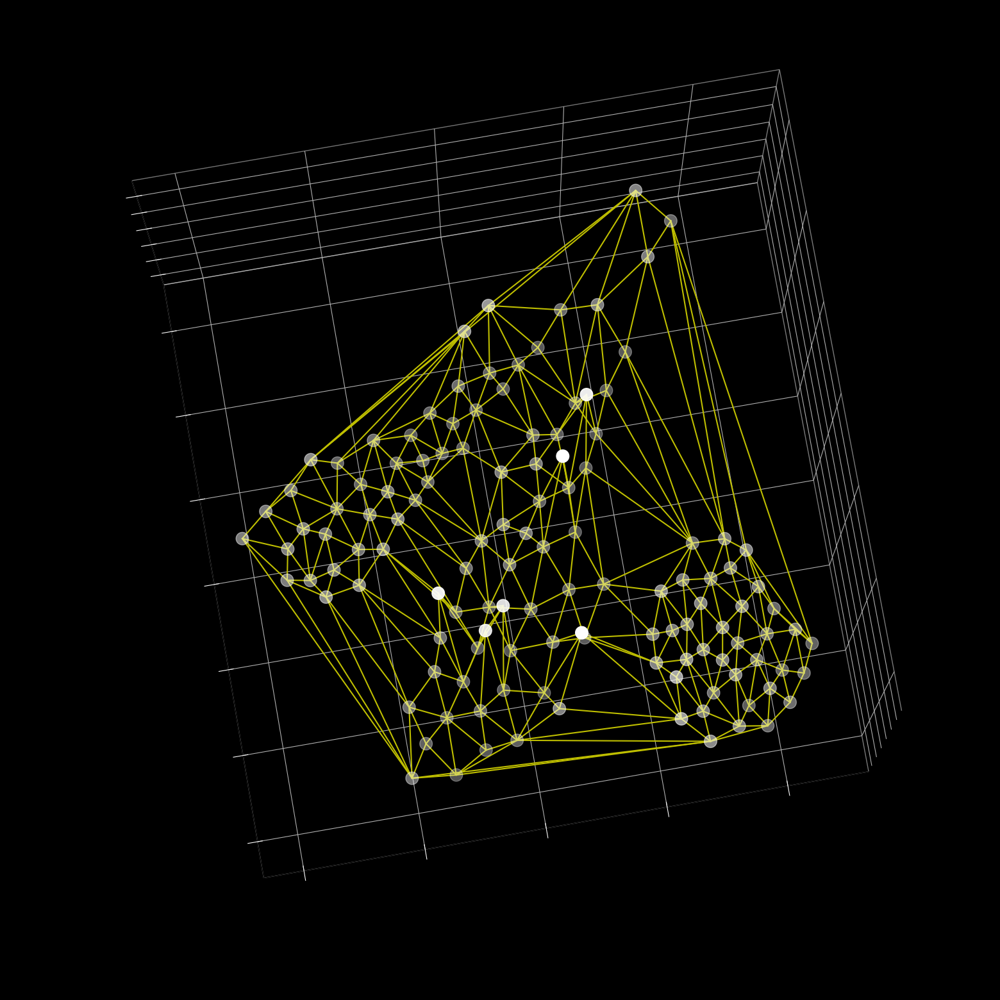

In [61]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_patch_df['row']*scale,fov_patch_df['col']*scale,fov_patch_df['z']*z_scale,s=200,color='w')
    for i in range(vor.ridge_points.shape[0]):
        ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color='y')
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

In [62]:
boarder_patch = []
for i in range(vor.ridge_points.shape[0]):
    patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
    temp = patch1.split('_')
    cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
    patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
    temp = patch2.split('_')
    cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
    if cell1 != cell2:
        if not patch1 in boarder_patch:
            boarder_patch.append(patch1)
        if not patch2 in boarder_patch:
            boarder_patch.append(patch2)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1850218459.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


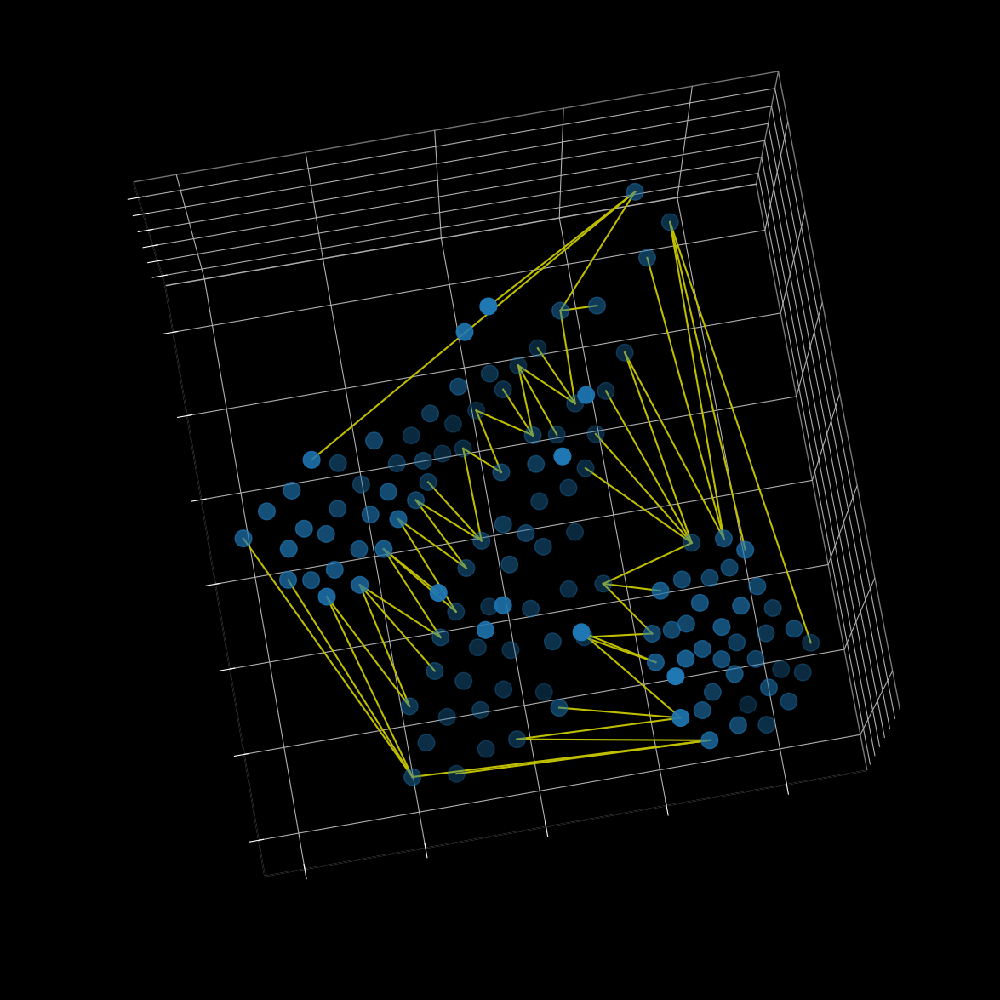

In [63]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_002_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=200,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\384930991.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


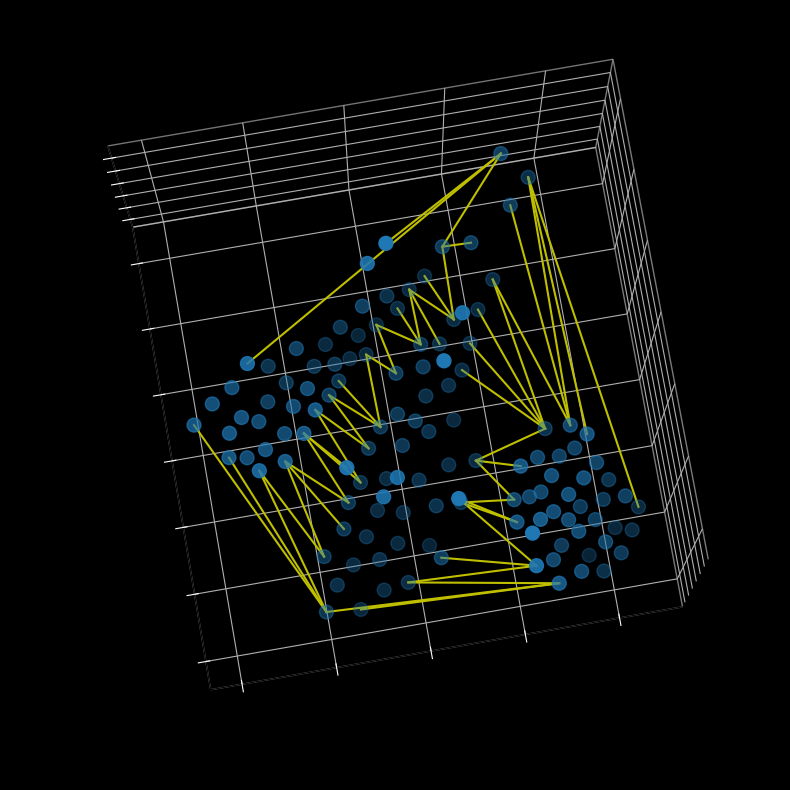

In [64]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=100,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_006_boarder_patches.png',dpi=300)

#### bm 007 10,11,14

In [65]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

in_fov_l = []
cells = ['bm_007_10', 'bm_007_11', 'bm_007_14']
cell_ids = []
for item in cell_l:
    if item.split('.')[0] in cells:
        cell_ids.append(item.split('.')[0])
        in_fov_l.append(pd.read_csv(os.path.join(in_dir,item),index_col=0))

patch_row = []
patch_col = []
patch_z = []
patch_id = []
for i,item in enumerate(in_fov_l):
    
    cell_patches = item.groupby('patch')
    centers = cell_patches.mean()
    patch_row = patch_row + centers['row'].tolist()
    patch_col = patch_col + centers['col'].tolist()
    patch_z = patch_z + centers['z'].tolist()
    
    for j in range(centers.shape[0]):
        patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))

In [66]:
fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)

In [67]:
vor = Voronoi(fov_patch_df[['row','col']].values)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2723289374.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


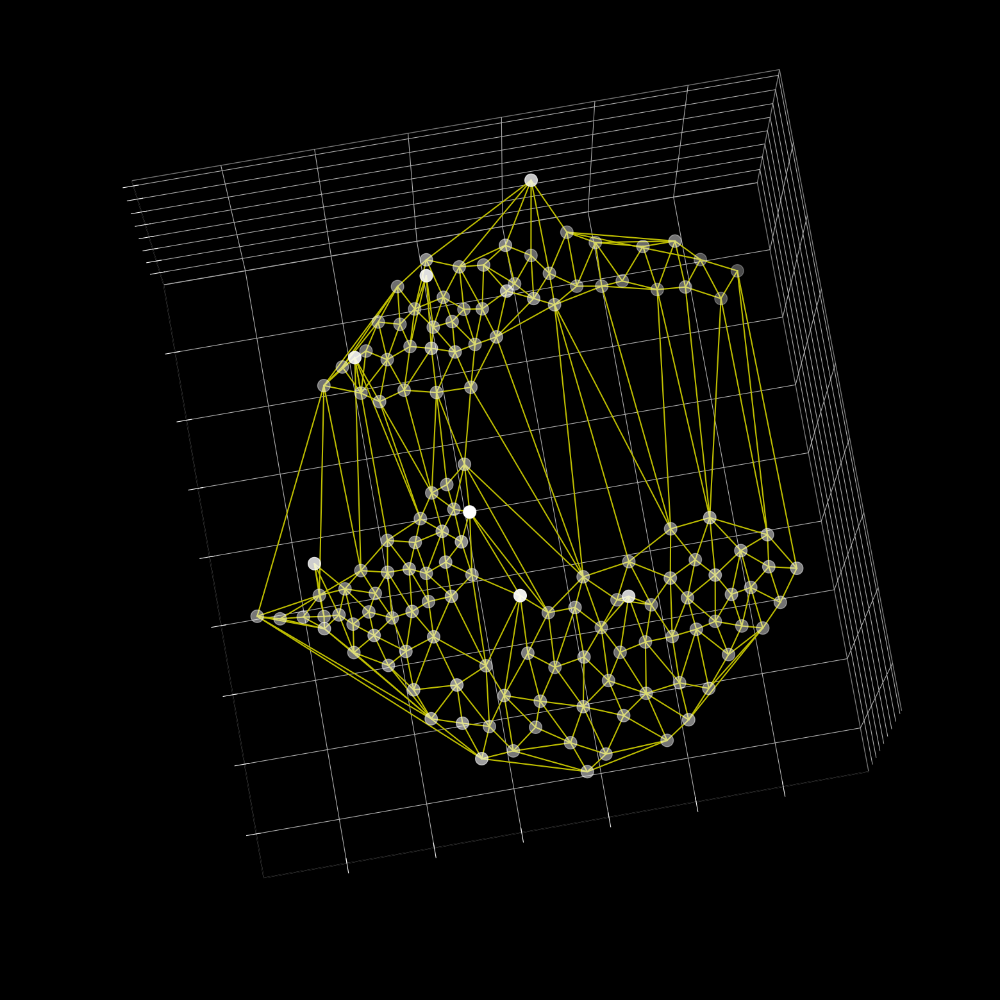

In [68]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_patch_df['row']*scale,fov_patch_df['col']*scale,fov_patch_df['z']*z_scale,s=200,color='w')
    for i in range(vor.ridge_points.shape[0]):
        ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color='y')
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

In [69]:
boarder_patch = []
for i in range(vor.ridge_points.shape[0]):
    patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
    temp = patch1.split('_')
    cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
    patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
    temp = patch2.split('_')
    cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
    if cell1 != cell2:
        if not patch1 in boarder_patch:
            boarder_patch.append(patch1)
        if not patch2 in boarder_patch:
            boarder_patch.append(patch2)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1850218459.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


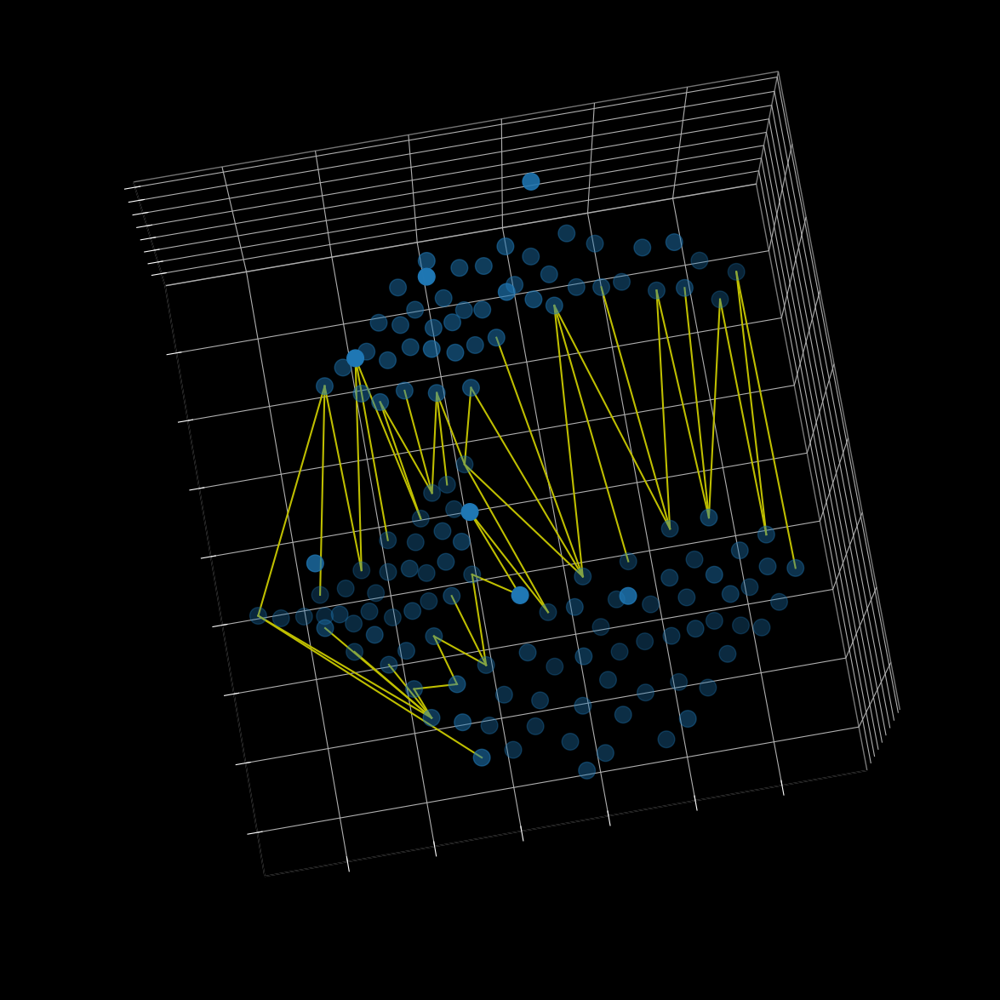

In [70]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_002_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=200,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2156604648.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


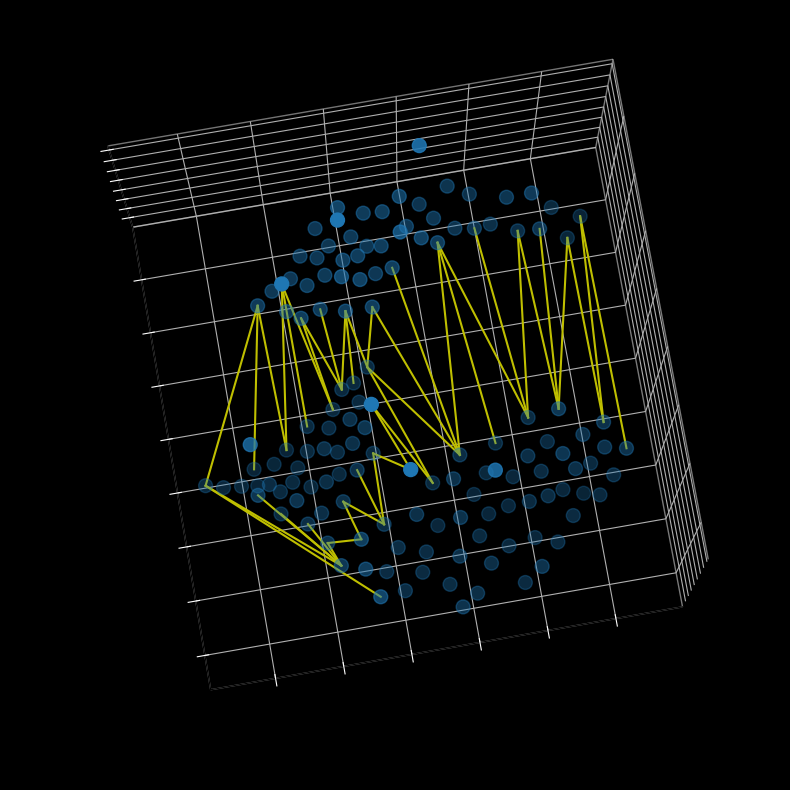

In [71]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=100,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_007_boarder_patches.png',dpi=300)

#### bm 020 5,6

In [72]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

in_fov_l = []
cells = ['bm_020_05', 'bm_020_06']
cell_ids = []
for item in cell_l:
    if item.split('.')[0] in cells:
        cell_ids.append(item.split('.')[0])
        in_fov_l.append(pd.read_csv(os.path.join(in_dir,item),index_col=0))

patch_row = []
patch_col = []
patch_z = []
patch_id = []
for i,item in enumerate(in_fov_l):
    
    cell_patches = item.groupby('patch')
    centers = cell_patches.mean()
    patch_row = patch_row + centers['row'].tolist()
    patch_col = patch_col + centers['col'].tolist()
    patch_z = patch_z + centers['z'].tolist()
    
    for j in range(centers.shape[0]):
        patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))

In [73]:
fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)

In [74]:
vor = Voronoi(fov_patch_df[['row','col']].values)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2723289374.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


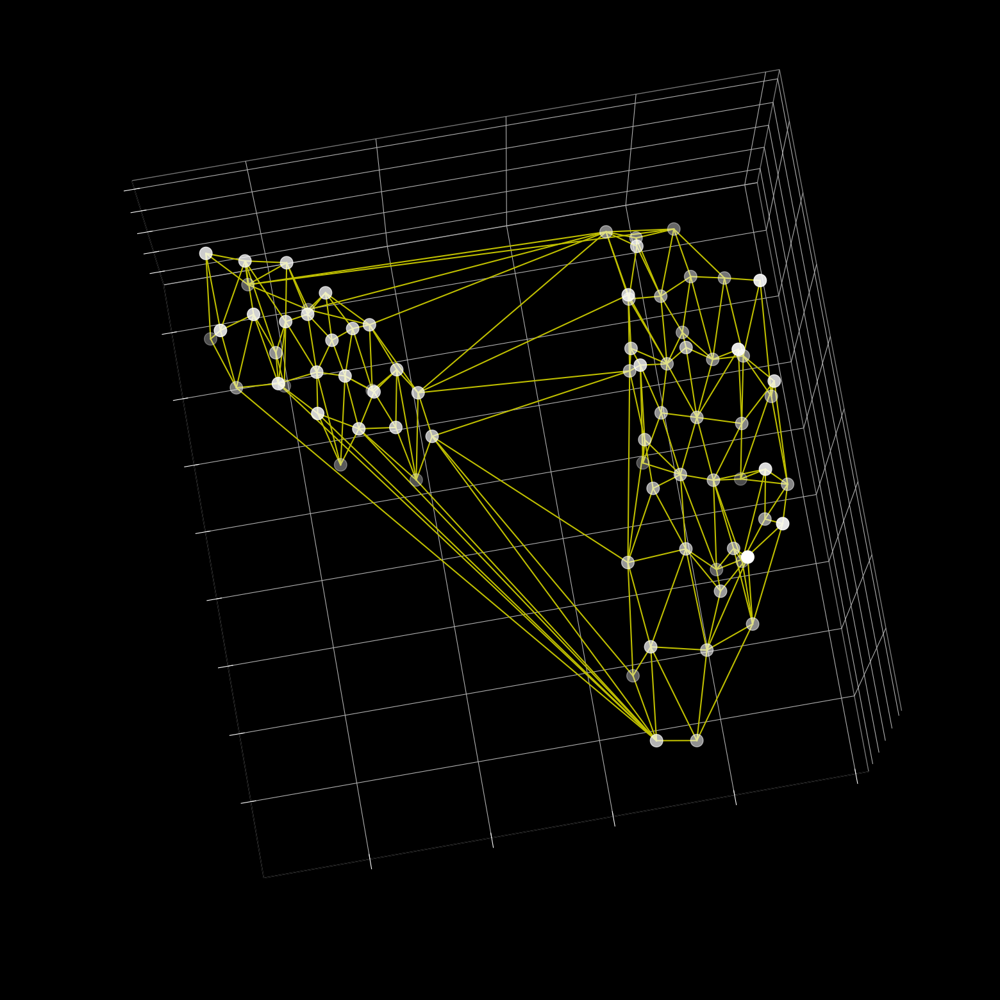

In [75]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_patch_df['row']*scale,fov_patch_df['col']*scale,fov_patch_df['z']*z_scale,s=200,color='w')
    for i in range(vor.ridge_points.shape[0]):
        ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color='y')
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

In [76]:
boarder_patch = []
for i in range(vor.ridge_points.shape[0]):
    patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
    temp = patch1.split('_')
    cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
    patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
    temp = patch2.split('_')
    cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
    if cell1 != cell2:
        if not patch1 in boarder_patch:
            boarder_patch.append(patch1)
        if not patch2 in boarder_patch:
            boarder_patch.append(patch2)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1850218459.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


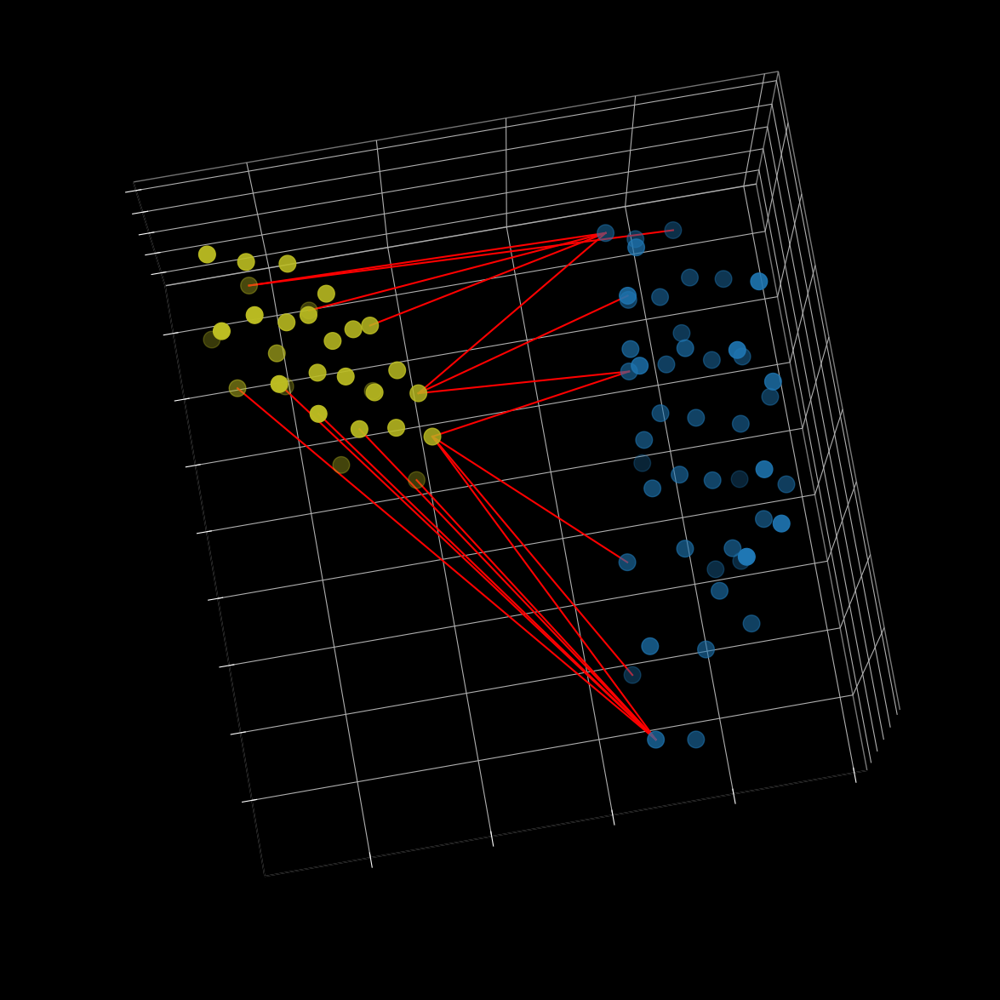

In [77]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_002_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=200,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1143026771.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


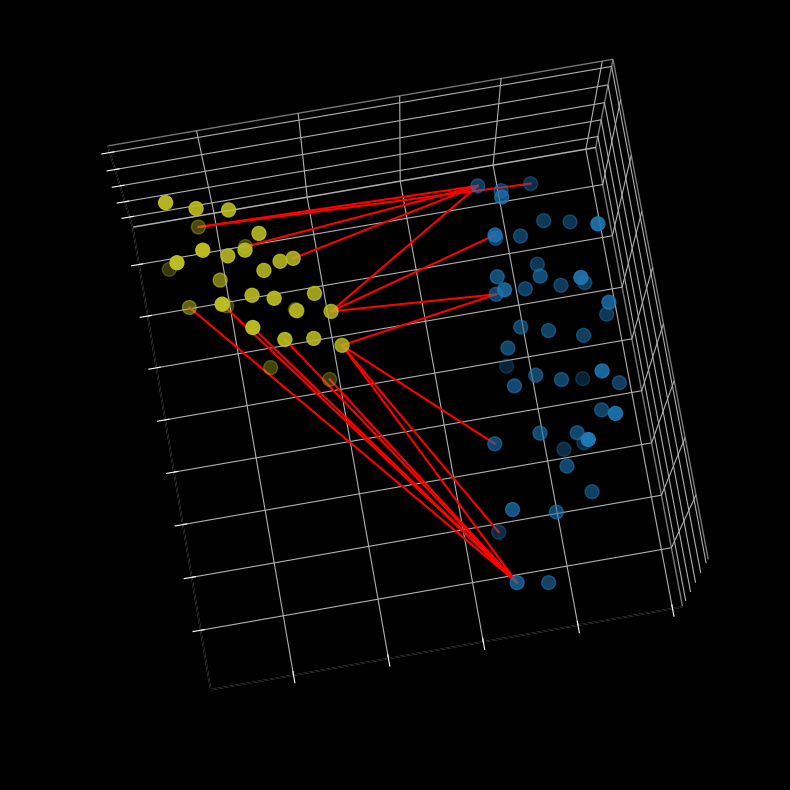

In [78]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=100,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_020_boarder_patches.png',dpi=300)

#### bm 031 12, 15

In [79]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

in_fov_l = []
cells = ['bm_031_12', 'bm_031_15']
cell_ids = []
for item in cell_l:
    if item.split('.')[0] in cells:
        cell_ids.append(item.split('.')[0])
        in_fov_l.append(pd.read_csv(os.path.join(in_dir,item),index_col=0))

patch_row = []
patch_col = []
patch_z = []
patch_id = []
for i,item in enumerate(in_fov_l):
    
    cell_patches = item.groupby('patch')
    centers = cell_patches.mean()
    patch_row = patch_row + centers['row'].tolist()
    patch_col = patch_col + centers['col'].tolist()
    patch_z = patch_z + centers['z'].tolist()
    
    for j in range(centers.shape[0]):
        patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))

In [80]:
fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)

In [81]:
vor = Voronoi(fov_patch_df[['row','col']].values)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2723289374.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


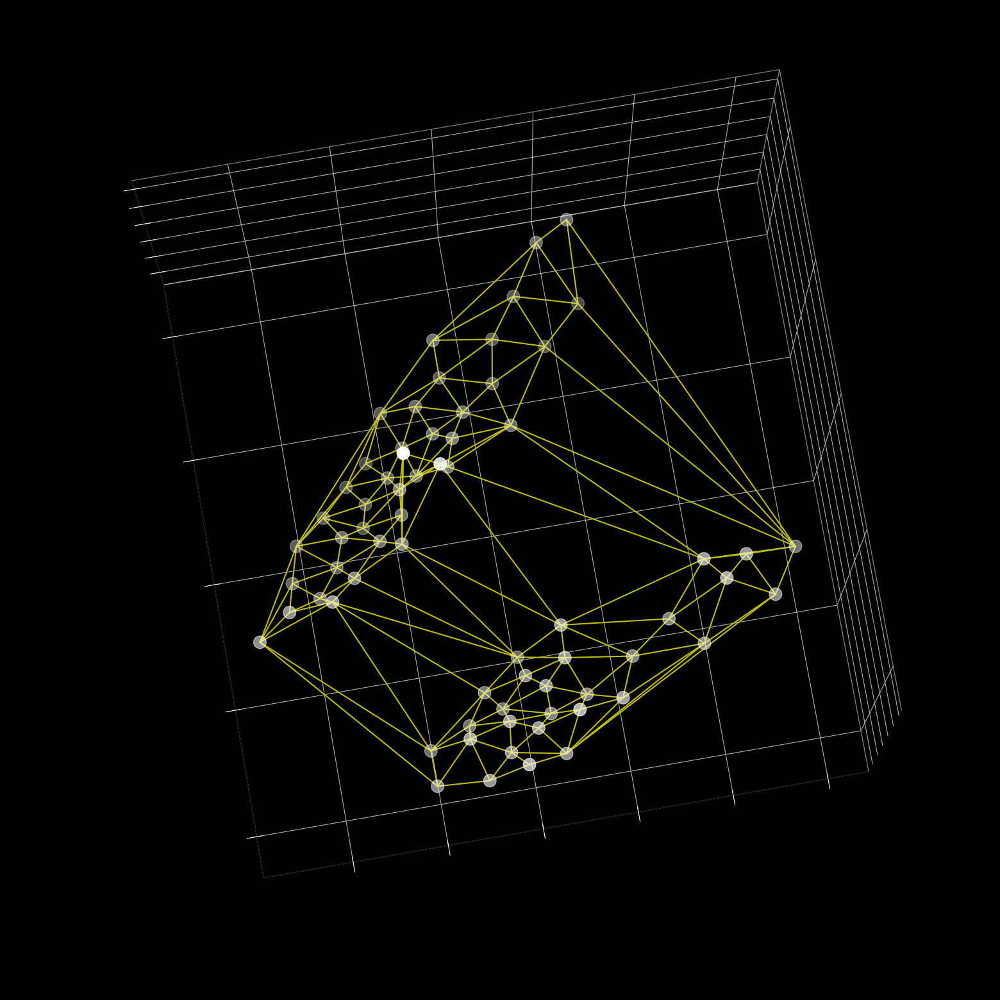

In [82]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_patch_df['row']*scale,fov_patch_df['col']*scale,fov_patch_df['z']*z_scale,s=200,color='w')
    for i in range(vor.ridge_points.shape[0]):
        ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color='y')
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

In [83]:
boarder_patch = []
for i in range(vor.ridge_points.shape[0]):
    patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
    temp = patch1.split('_')
    cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
    patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
    temp = patch2.split('_')
    cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
    if cell1 != cell2:
        if not patch1 in boarder_patch:
            boarder_patch.append(patch1)
        if not patch2 in boarder_patch:
            boarder_patch.append(patch2)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1850218459.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


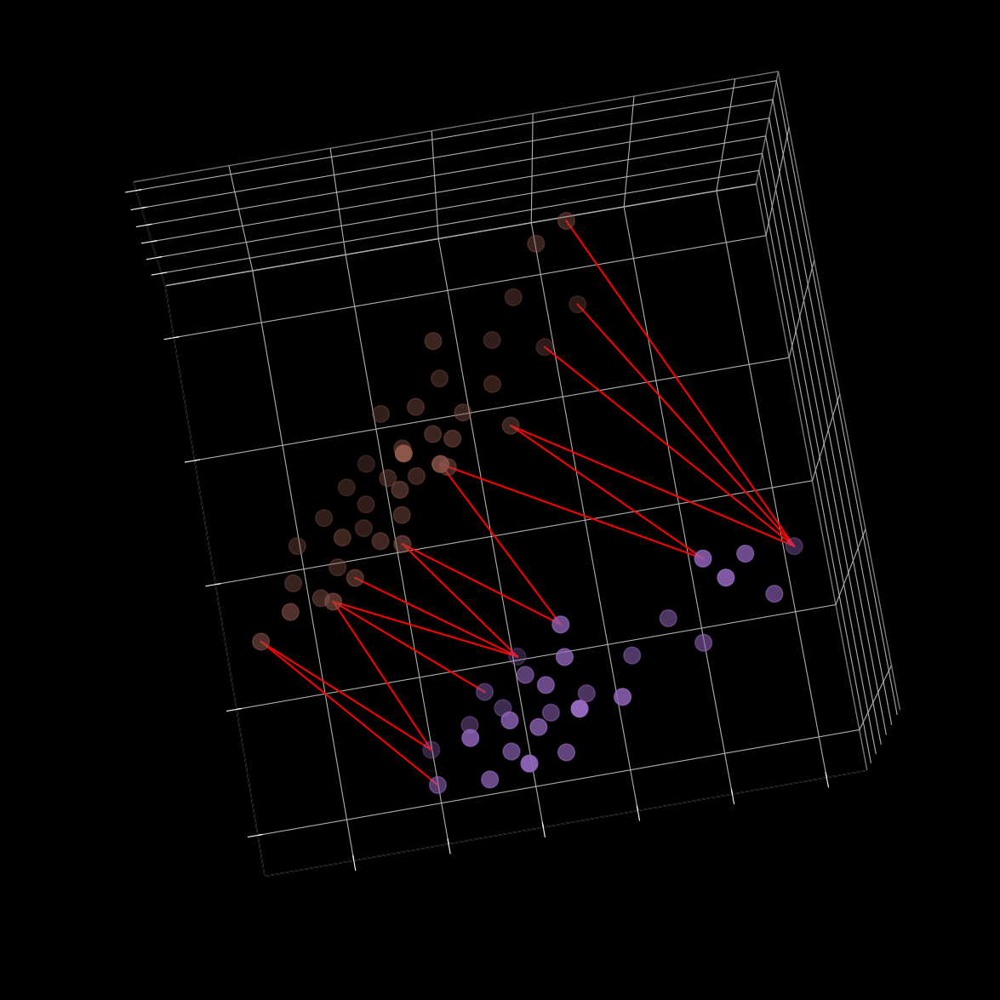

In [84]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_002_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=200,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2868057970.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


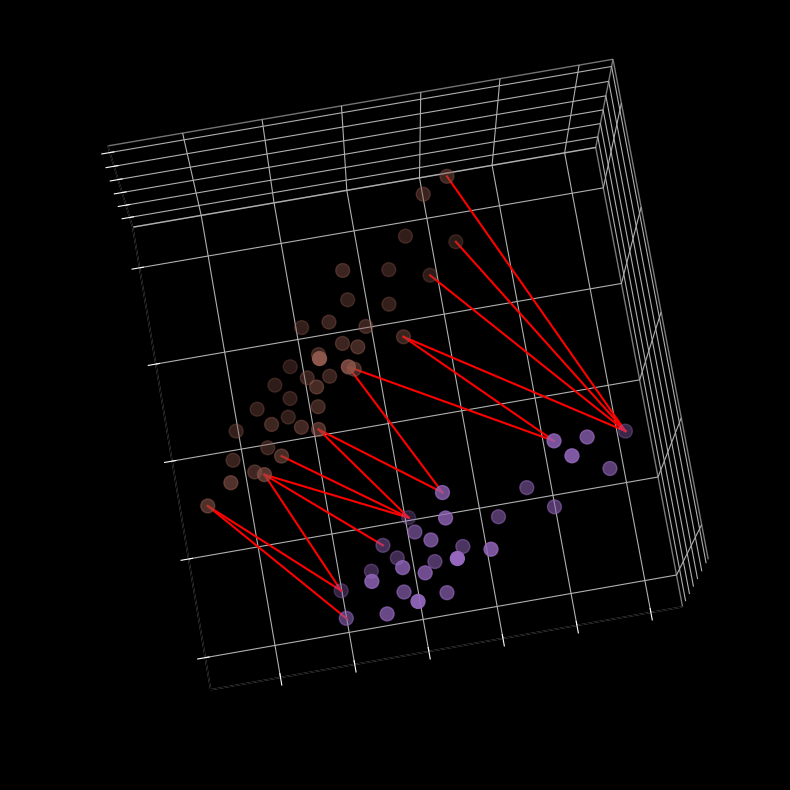

In [85]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=100,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_031_boarder_patches.png',dpi=300)

#### bm 032 1 2 3 4 5

In [86]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

in_fov_l = []
cells = ['bm_032_01', 'bm_032_02', 'bm_032_03', 'bm_032_04', 'bm_032_05']
cell_ids = []
for item in cell_l:
    if item.split('.')[0] in cells:
        cell_ids.append(item.split('.')[0])
        in_fov_l.append(pd.read_csv(os.path.join(in_dir,item),index_col=0))

patch_row = []
patch_col = []
patch_z = []
patch_id = []
for i,item in enumerate(in_fov_l):
    
    cell_patches = item.groupby('patch')
    centers = cell_patches.mean()
    patch_row = patch_row + centers['row'].tolist()
    patch_col = patch_col + centers['col'].tolist()
    patch_z = patch_z + centers['z'].tolist()
    
    for j in range(centers.shape[0]):
        patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))

In [87]:
fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)

In [88]:
vor = Voronoi(fov_patch_df[['row','col']].values)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2723289374.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


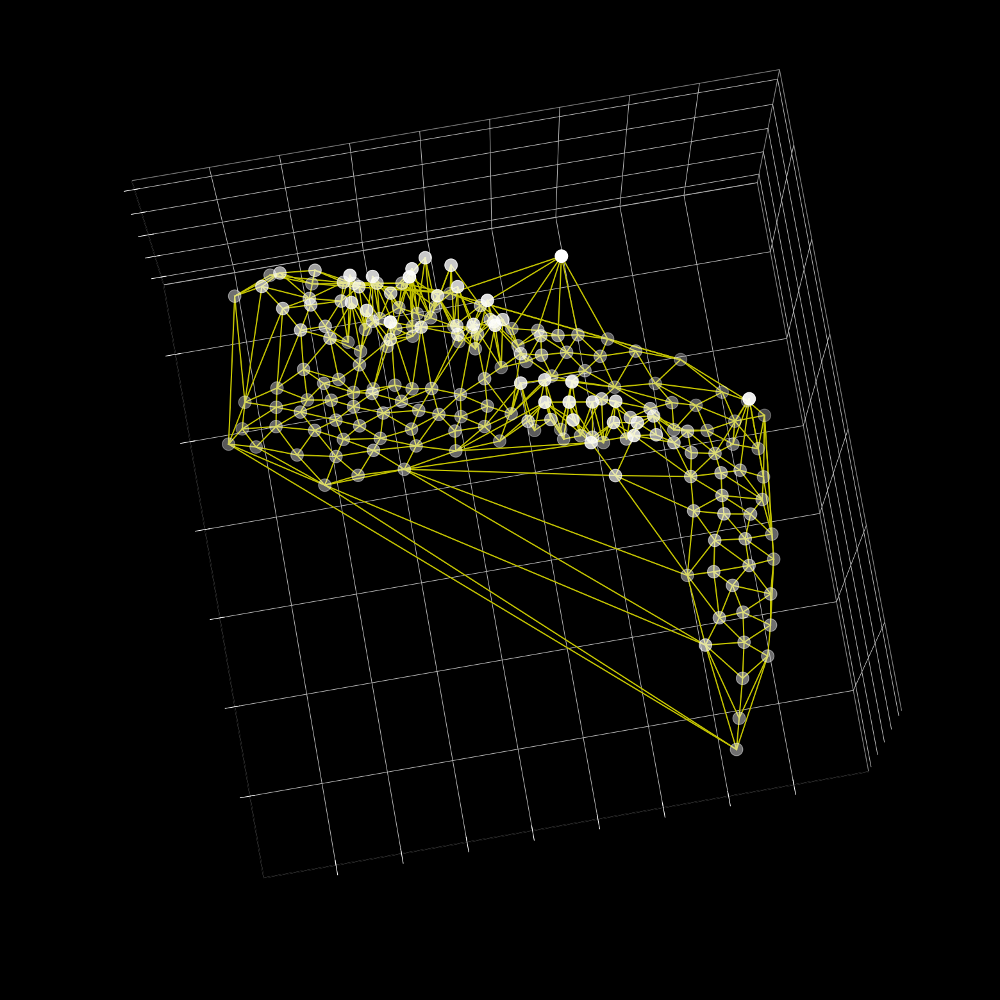

In [89]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_patch_df['row']*scale,fov_patch_df['col']*scale,fov_patch_df['z']*z_scale,s=200,color='w')
    for i in range(vor.ridge_points.shape[0]):
        ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color='y')
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

In [90]:
boarder_patch = []
for i in range(vor.ridge_points.shape[0]):
    patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
    temp = patch1.split('_')
    cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
    patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
    temp = patch2.split('_')
    cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
    if cell1 != cell2:
        if not patch1 in boarder_patch:
            boarder_patch.append(patch1)
        if not patch2 in boarder_patch:
            boarder_patch.append(patch2)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1850218459.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


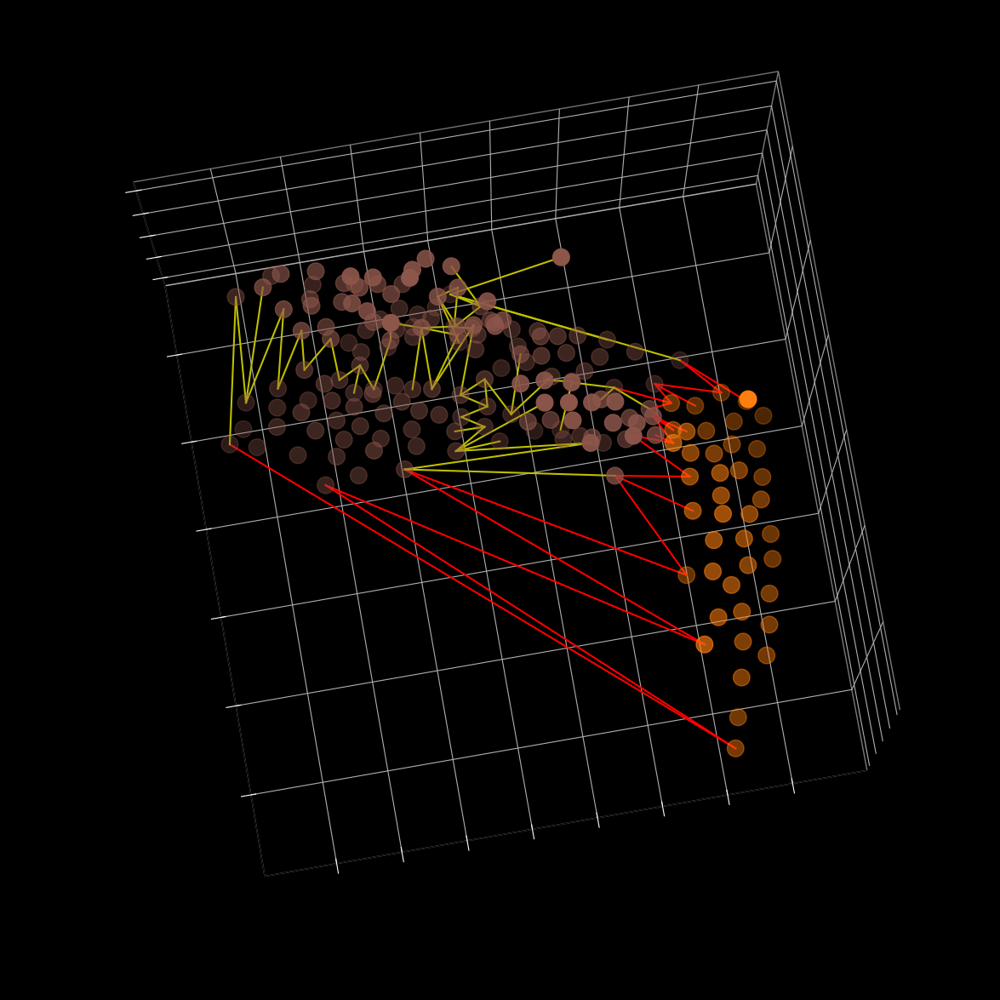

In [91]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_002_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=200,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1241260868.py:42: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


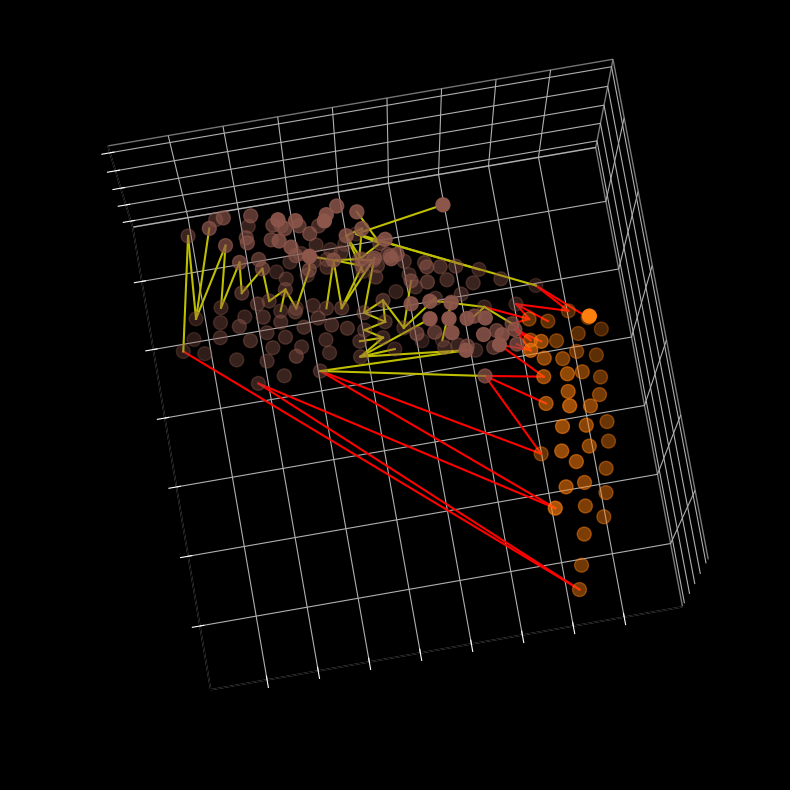

In [92]:
# Plot patch color by cell cluster
patch_by_cell = proxi_df.groupby('cellID')
# cells = ['uc_003_01','uc_003_02','uc_003_03','uc_003_04','uc_003_05']

with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    for cell in cells:
        sub_group = patch_by_cell.get_group(cell)
        cell_idx = count_adata.obs['cell_id'].tolist().index(cell)
        color = count_adata.uns['leiden_colors'][int(count_adata.obs['leiden'][cell_idx])]
        ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=100,color=color,label=cell)
    
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
        cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
        if not cell1 == cell2:
            cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
            cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
            if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                color = 'y'
            else:
                color = 'r'
            ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                    fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
    
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_032_boarder_patches.png',dpi=300)

#### Plot legends

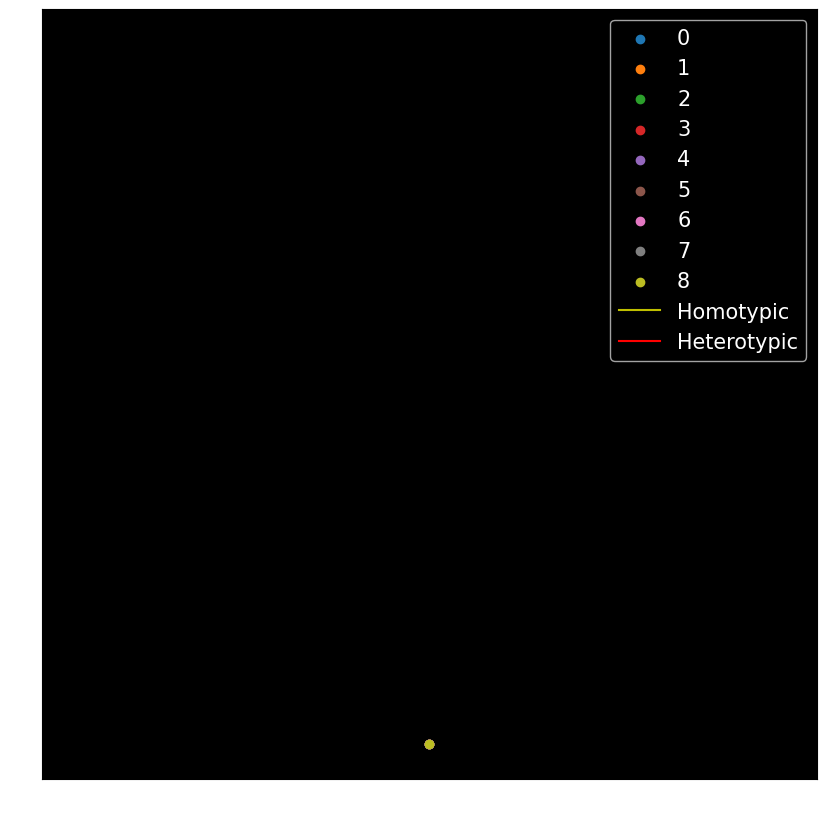

In [112]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white', 'axes.facecolor': 'black'}):
    fig = plt.figure(figsize=(10,10))
    for i,c in enumerate(count_adata.uns['leiden_colors']):
        plt.scatter(0,0,color=c,label=str(i))
    plt.plot([0,0],[1,1],color='y',label='Homotypic')
    plt.plot([0,0],[1,1],color='r',label='Heterotypic')
    plt.legend(fontsize=15)
    plt.savefig(r'.\figures\leiden_color.png',dpi=300)

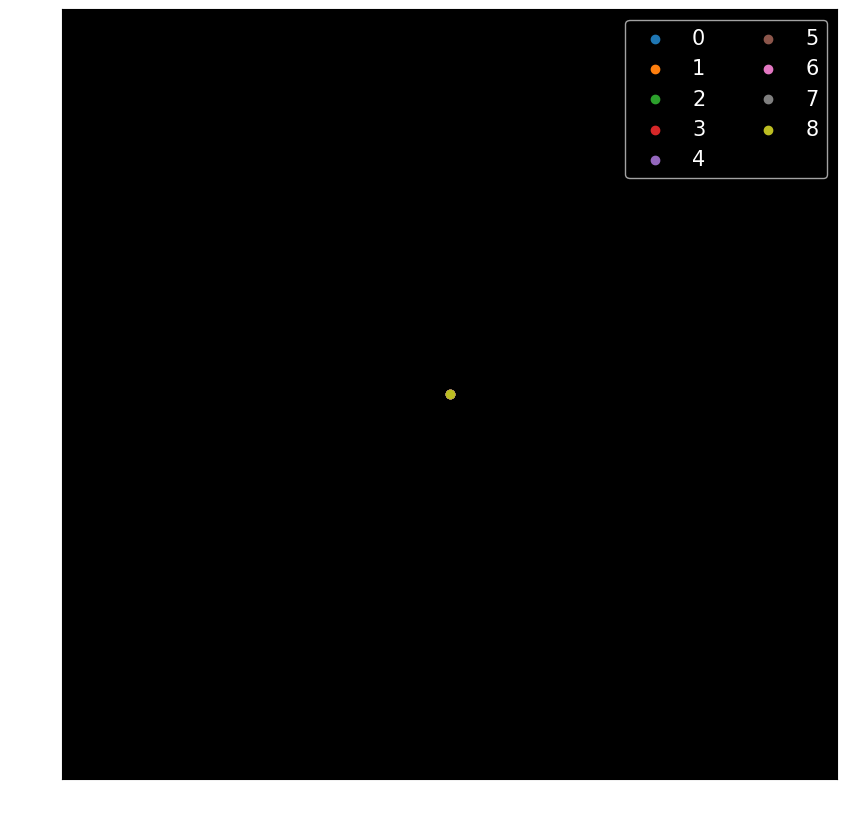

In [149]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white', 'axes.facecolor': 'black'}):
    fig = plt.figure(figsize=(10,10))
    for i,c in enumerate(count_adata.uns['leiden_colors']):
        plt.scatter(0,0,color=c,label=str(i))

    plt.legend(fontsize=15,ncol=2)
    plt.savefig(r'.\figures\dots_leiden_color.png',dpi=300)

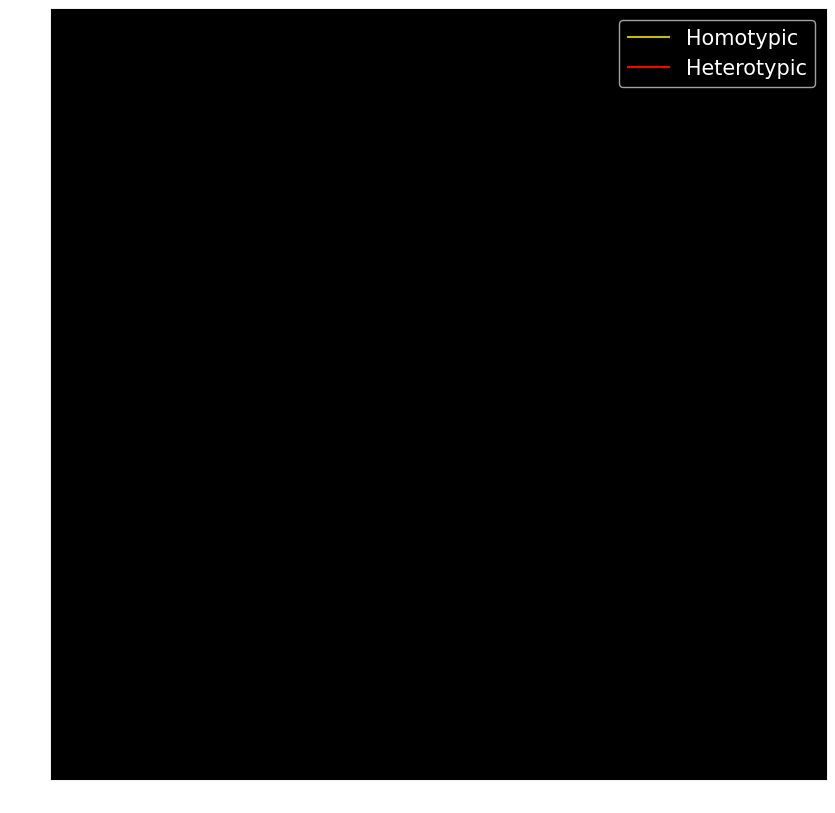

In [150]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white', 'axes.facecolor': 'black'}):
    fig = plt.figure(figsize=(10,10))
    plt.plot([0,0],[1,1],color='y',label='Homotypic')
    plt.plot([0,0],[1,1],color='r',label='Heterotypic')
    plt.legend(fontsize=15)
    plt.savefig(r'.\figures\edge_leiden_color.png',dpi=300)

#### Center of fovs

In [93]:
fov_center = pd.read_csv(r'..\fov_pos.csv', index_col=0)

In [95]:
fov_center

,fov,x,y,z,well
0,bm_001,-22392.8,-15796.7,4161.02,well_1
1,bm_002,-22547.3,-15952.6,4159.18,well_1
2,bm_003,-22631.1,-15771.7,4155.90,well_1
3,bm_004,-22823.3,-15939.4,4152.90,well_1
4,bm_005,-22816.8,-15619.9,4151.02,well_1
...,...,...,...,...,...
62,uc_043,-29646.7,4585.2,4108.78,well_5
63,uc_044,-29693.6,4846.8,4108.00,well_5
64,uc_045,-29813.3,5115.1,4107.14,well_5
65,uc_046,-30256.5,5417.2,4106.58,well_5


C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\1696257447.py:17: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


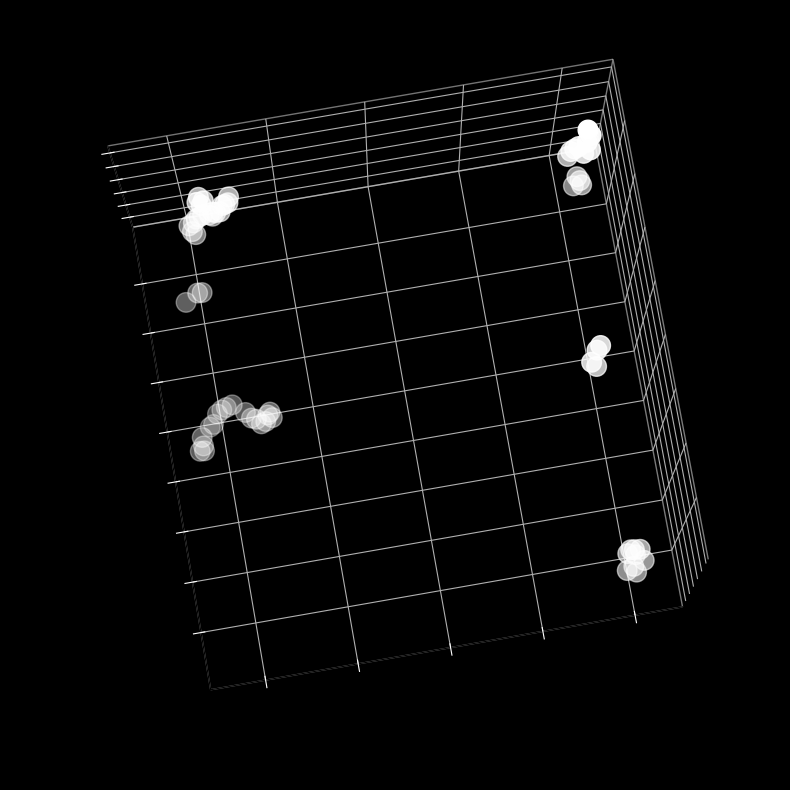

In [101]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(fov_center['y'], fov_center['x'], fov_center['z'], s=200, color='w')
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    # plt.savefig(r'.\figures\bm_032_boarder_patches.png',dpi=300)

In [120]:
bm_fovs = ['bm_006', 'bm_007', 'bm_020', 'bm_031', 'bm_032']
uc_fovs = ['uc_002', 'uc_003', 'uc_012', 'uc_034']
well1_uc_fovs = ['uc_002', 'uc_003', 'uc_012']

In [121]:
uc_l = []
for fov in uc_fovs:
    uc_l.append(fov_center[fov_center['fov'] == fov])
uc_fov_center = pd.concat(uc_l)

bm_l = []
for fov in bm_fovs:
    bm_l.append(fov_center[fov_center['fov'] == fov])
bm_fov_center = pd.concat(bm_l)

well1_uc_l = []
for fov in well1_uc_fovs:
    well1_uc_l.append(fov_center[fov_center['fov'] == fov])
well1_uc_fov_center = pd.concat(well1_uc_l)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2645025446.py:17: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


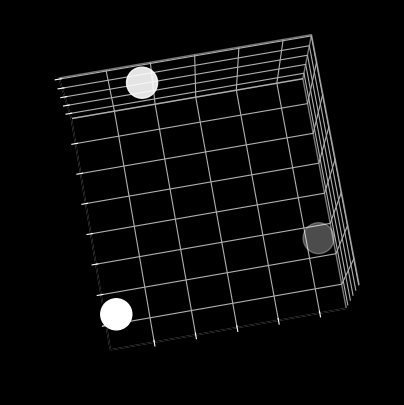

In [125]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(5,5))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(well1_uc_fov_center['y'], well1_uc_fov_center['x'], well1_uc_fov_center['z'], s=500, color='w')
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_well1_fovs.png',dpi=300)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\3338383931.py:22: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


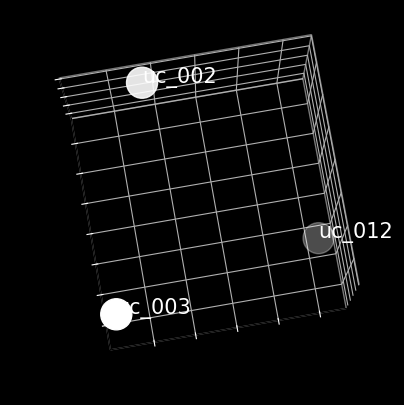

In [126]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(5,5))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(well1_uc_fov_center['y'], well1_uc_fov_center['x'], well1_uc_fov_center['z'], s=500, color='w')
    for item in well1_uc_fov_center['fov'].tolist():
        ax.text(well1_uc_fov_center[well1_uc_fov_center['fov'] == item]['y'].values[0],
                well1_uc_fov_center[well1_uc_fov_center['fov'] == item]['x'].values[0],
                well1_uc_fov_center[well1_uc_fov_center['fov'] == item]['z'].values[0],
                item, color='w', fontsize=15)
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(-100, 100)
    plt.tight_layout()

In [127]:
well1_uc_all = []
for fov in fov_center['fov'].tolist():
    if fov.split('_')[0] == 'uc' and int(fov.split('_')[1])<15:
        well1_uc_all.append(fov)

In [128]:
well1_uc_centers = []
for fov in well1_uc_all:
    well1_uc_centers.append(fov_center[fov_center['fov'] == fov])
well1_uc_centers = pd.concat(well1_uc_centers)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\3366917451.py:18: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


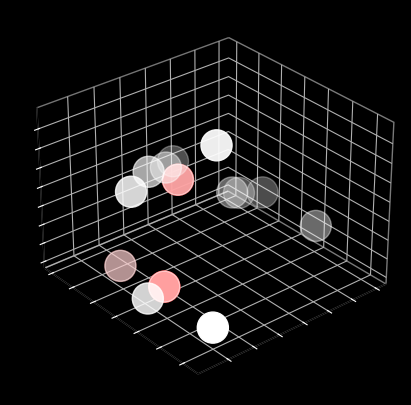

In [144]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(5,5))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(well1_uc_centers['y'], well1_uc_centers['x'], well1_uc_centers['z'], s=500, color='w')
    ax.scatter(well1_uc_fov_center['y'], well1_uc_fov_center['x'], well1_uc_fov_center['z'], s=500, color='r')
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(30, 50)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_well1_all_fovs.png',dpi=300)

C:\Users\zfang38\AppData\Local\Temp\ipykernel_8184\2774098147.py:23: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


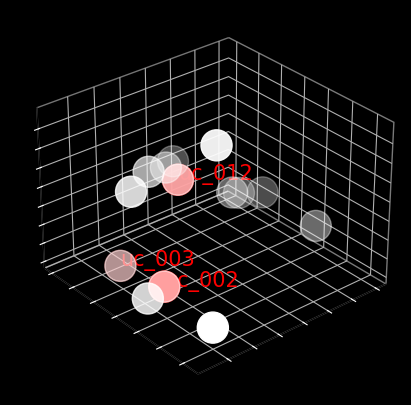

In [145]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(5,5))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(well1_uc_centers['y'], well1_uc_centers['x'], well1_uc_centers['z'], s=500, color='w')
    ax.scatter(well1_uc_fov_center['y'], well1_uc_fov_center['x'], well1_uc_fov_center['z'], s=500, color='r')
    for fov in well1_uc_fov_center['fov'].tolist():
        ax.text(well1_uc_fov_center[well1_uc_fov_center['fov'] == fov]['y'].values[0],
                well1_uc_fov_center[well1_uc_fov_center['fov'] == fov]['x'].values[0],
                well1_uc_fov_center[well1_uc_fov_center['fov'] == fov]['z'].values[0],
                fov, color='r', fontsize=15)
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(30, 50)
    plt.tight_layout()
    # plt.savefig(r'.\figures\uc_well1_all_fovs.png',dpi=300)

In [ ]:
with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
    fig = plt.figure(figsize=(5,5))
    ax = fig.add_subplot(projection='3d')
    fig.set_facecolor('black')
    ax.set_facecolor('black')
    ax.w_xaxis.pane.fill = False
    ax.w_yaxis.pane.fill = False
    ax.w_zaxis.pane.fill = False
    ax.invert_zaxis()

    ax.scatter(well1_uc_centers['y'], well1_uc_centers['x'], well1_uc_centers['z'], s=500, color='w')
    ax.scatter(well1_uc_fov_center['y'], well1_uc_fov_center['x'], well1_uc_fov_center['z'], s=500, color='y')
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax.set_zticklabels([])

    ax.view_init(50, 50)
    plt.tight_layout()
    # plt.savefig(r'.\figures\uc_well1_all_fovs.png',dpi=300)

### process all fovs

In [69]:
from scipy.stats import ttest_ind
from joblib import Parallel, delayed

In [25]:
bm_fov = bm_distances['fov'].unique()

In [26]:
cell_df_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_df_l = os.listdir(cell_df_dir)
bm_boarder_patch = []
for fov in tqdm(bm_fov):
    cell_ids = []
    cell_l = []
    for item in cell_df_l:
        if fov in item: 
            cell_ids.append(item.split('.')[0])
            cell_l.append(pd.read_csv(os.path.join(cell_df_dir,item),index_col=0))
    
    patch_row = []
    patch_col = []
    patch_z = []
    patch_id = []
    for i,item in enumerate(cell_l):
        
        cell_patches = item.groupby('patch')
        centers = cell_patches.mean()
        patch_row = patch_row + centers['row'].tolist()
        patch_col = patch_col + centers['col'].tolist()
        patch_z = patch_z + centers['z'].tolist()
        
        for j in range(centers.shape[0]):
            patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))
    fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)
    vor = Voronoi(fov_patch_df[['row','col']].values)
    
    boarder_patch = []
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        temp = patch1.split('_')
        cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        temp = patch2.split('_')
        cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
        if cell1 != cell2:
            boarder_patch.append([patch1,patch2])
    bm_boarder_patch = bm_boarder_patch + boarder_patch

100%|██████████| 25/25 [00:09<00:00,  2.65it/s]


In [27]:
uc_fov = uc_distances['fov'].unique()

In [28]:
cell_df_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_df_l = os.listdir(cell_df_dir)
uc_boarder_patch = []
for fov in tqdm(uc_fov):
    cell_ids = []
    cell_l = []
    for item in cell_df_l:
        if fov in item:
            cell_ids.append(item.split('.')[0])
            cell_l.append(pd.read_csv(os.path.join(cell_df_dir,item),index_col=0))
    
    patch_row = []
    patch_col = []
    patch_z = []
    patch_id = []
    for i,item in enumerate(cell_l):
        
        cell_patches = item.groupby('patch')
        centers = cell_patches.mean()
        patch_row = patch_row + centers['row'].tolist()
        patch_col = patch_col + centers['col'].tolist()
        patch_z = patch_z + centers['z'].tolist()
        
        for j in range(centers.shape[0]):
            patch_id.append(cell_ids[i] + '_' + str(centers.index[j]))
    fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)
    vor = Voronoi(fov_patch_df[['row','col']].values)
    
    boarder_patch = []
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        temp = patch1.split('_')
        cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        temp = patch2.split('_')
        cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
        if cell1 != cell2:
            boarder_patch.append([patch1,patch2])
    uc_boarder_patch = uc_boarder_patch + boarder_patch

100%|██████████| 35/35 [00:15<00:00,  2.32it/s]


In [29]:
print(len(bm_boarder_patch))
print(len(uc_boarder_patch))

4752
5789


In [32]:
bm_interaction_type = []
for item in tqdm(bm_boarder_patch):
    patch1 = item[0]
    cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
    patch2 = item[1]
    cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
    idx1 = count_adata.obs['cell_id'].tolist().index(cell1)
    idx2 = count_adata.obs['cell_id'].tolist().index(cell2)
    cluster1 = count_adata.obs['leiden'].tolist()[idx1]
    cluster2 = count_adata.obs['leiden'].tolist()[idx2]
    if cluster1 == cluster2:
        bm_interaction_type.append('homotypic')
    else:
        bm_interaction_type.append('heterotypic')

uc_interaction_type = []
for item in tqdm(uc_boarder_patch):
    patch1 = item[0]
    cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
    patch2 = item[1]
    cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
    idx1 = count_adata.obs['cell_id'].tolist().index(cell1)
    idx2 = count_adata.obs['cell_id'].tolist().index(cell2)
    cluster1 = count_adata.obs['leiden'].tolist()[idx1]
    cluster2 = count_adata.obs['leiden'].tolist()[idx2]
    if cluster1 == cluster2:
        uc_interaction_type.append('homotypic')
    else:
        uc_interaction_type.append('heterotypic')

100%|██████████| 5789/5789 [00:00<00:00, 10010.58it/s]


In [70]:
proxi_df = pd.read_csv(r'.\results\proxi_df.csv',index_col=0)

In [71]:
gene_pairs = proxi_df.columns.tolist()[1:proxi_df.shape[1]-6]

In [72]:
def calculate_bm_p_value(p):
    bm_pair_proxi = proxi_df[p].to_numpy()
    homotypic_proxi = []
    curr_homotypic_patch = []
    heterotypic_proxi = []
    curr_heterotypic_patch = []
    for i in range(len(bm_boarder_patch)):
        int_type = bm_interaction_type[i]
        idx1 = proxi_df['index'].tolist().index(bm_boarder_patch[i][0])
        idx2 = proxi_df['index'].tolist().index(bm_boarder_patch[i][1])
        if bm_interaction_type[i] == 'homotypic':
            proxi1 = bm_pair_proxi[idx1]
            if (not bm_boarder_patch[i][0] in curr_homotypic_patch) and (not proxi1 == 0):
                homotypic_proxi.append(proxi1)
                curr_homotypic_patch.append(bm_boarder_patch[i][0])
            proxi2 = bm_pair_proxi[idx2]
            if (not bm_boarder_patch[i][1] in curr_homotypic_patch) and (not proxi2 == 0):
                homotypic_proxi.append(proxi2)
                curr_homotypic_patch.append(bm_boarder_patch[i][1])
        else:
            proxi1 = bm_pair_proxi[idx1]
            if (not bm_boarder_patch[i][0] in curr_heterotypic_patch) and (not proxi1 == 0):
                heterotypic_proxi.append(proxi1)
                curr_heterotypic_patch.append(bm_boarder_patch[i][0])
            proxi2 = bm_pair_proxi[idx2]
            if (not bm_boarder_patch[i][1] in curr_heterotypic_patch) and (not proxi2 == 0):
                heterotypic_proxi.append(proxi2)
                curr_heterotypic_patch.append(bm_boarder_patch[i][1])
    t_statistics, p_value = ttest_ind(homotypic_proxi,heterotypic_proxi)
    idx1 = count_adata.var_names.tolist().index(p.split('_')[0])
    idx2 = count_adata.var_names.tolist().index(p.split('_')[1])
    return p_value

def calculate_uc_p_value(p):
    uc_pair_proxi = proxi_df[p].to_numpy()
    homotypic_proxi = []
    heterotypic_proxi = []
    for i in range(len(uc_boarder_patch)):
        int_type = uc_interaction_type[i]
        idx1 = proxi_df['index'].tolist().index(uc_boarder_patch[i][0])
        idx2 = proxi_df['index'].tolist().index(uc_boarder_patch[i][1])
        if uc_interaction_type[i] == 'homotypic':
            proxi1 = uc_pair_proxi[idx1]
            if not proxi1 == 0:
                homotypic_proxi.append(proxi1)
            proxi2 = uc_pair_proxi[idx2]
            if not proxi2 == 0:
                homotypic_proxi.append(proxi2)
        else:
            proxi1 = uc_pair_proxi[idx1]
            if not proxi1 == 0:
                heterotypic_proxi.append(proxi1)
            proxi2 = uc_pair_proxi[idx2]
            if not proxi2 == 0:
                heterotypic_proxi.append(proxi2)
    t_statistics, p_value = ttest_ind(homotypic_proxi,heterotypic_proxi)
    idx1 = count_adata.var_names.tolist().index(p.split('_')[0])
    idx2 = count_adata.var_names.tolist().index(p.split('_')[1])
    return p_value

In [143]:
bm_p_values = Parallel(n_jobs=-2, verbose=100)(delayed(calculate_bm_p_value)(p) for p in gene_pairs)
uc_p_values = Parallel(n_jobs=-2, verbose=100)(delayed(calculate_uc_p_value)(p) for p in gene_pairs)

[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.


[Parallel(n_jobs=-2)]: Done   1 tasks      | elapsed:   10.3s
[Parallel(n_jobs=-2)]: Done   2 tasks      | elapsed:   10.5s
[Parallel(n_jobs=-2)]: Done   3 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-2)]: Done   4 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-2)]: Done   5 tasks      | elapsed:   11.1s
[Parallel(n_jobs=-2)]: Done   6 tasks      | elapsed:   11.9s
[Parallel(n_jobs=-2)]: Done   7 tasks      | elapsed:   12.2s
[Parallel(n_jobs=-2)]: Done   8 tasks      | elapsed:   17.7s
[Parallel(n_jobs=-2)]: Done   9 tasks      | elapsed:   18.4s
[Parallel(n_jobs=-2)]: Done  10 tasks      | elapsed:   18.6s
[Parallel(n_jobs=-2)]: Done  11 tasks      | elapsed:   18.9s
[Parallel(n_jobs=-2)]: Done  12 tasks      | elapsed:   18.9s
[Parallel(n_jobs=-2)]: Done  13 tasks      | elapsed:   19.6s
[Parallel(n_jobs=-2)]: Done  14 tasks      | elapsed:   21.1s
[Parallel(n_jobs=-2)]: Done  15 tasks      | elapsed:   24.3s
[Parallel(n_jobs=-2)]: Done  16 tasks      | elapsed:   25.4s
[Paralle

In [144]:
bm_p_values_arr = np.zeros((count_adata.var_names.shape[0],count_adata.var_names.shape[0]))
for i,p in enumerate(gene_pairs):
    idx1 = count_adata.var_names.tolist().index(p.split('_')[0])
    idx2 = count_adata.var_names.tolist().index(p.split('_')[1])
    bm_p_values_arr[idx1,idx2] = bm_p_values[i]
    bm_p_values_arr[idx2,idx1] = bm_p_values[i]

uc_p_values_arr = np.zeros((count_adata.var_names.shape[0],count_adata.var_names.shape[0]))
for i,p in enumerate(gene_pairs):
    idx1 = count_adata.var_names.tolist().index(p.split('_')[0])
    idx2 = count_adata.var_names.tolist().index(p.split('_')[1])
    uc_p_values_arr[idx1,idx2] = uc_p_values[i]
    uc_p_values_arr[idx2,idx1] = uc_p_values[i]

In [73]:
import pickle

In [34]:
# Dave data used for the analysis
with open(r'.\results\signaling_analysis.pkl','wb') as f:
    pickle.dump({'bm_boarder_patch':bm_boarder_patch,
                 'uc_boarder_patch':uc_boarder_patch,
                 'bm_interaction_type':bm_interaction_type,
                 'uc_interaction_type':uc_interaction_type},f)

In [74]:
temp = pd.read_pickle(r'.\results\signaling_analysis.pkl')
bm_boarder_patch = temp['bm_boarder_patch']
uc_boarder_patch = temp['uc_boarder_patch']
bm_interaction_type = temp['bm_interaction_type']
uc_interaction_type = temp['uc_interaction_type']

In [75]:
# bm_p_values = np.maximum(bm_p_values_arr,bm_p_values_arr.T)
# uc_p_values = np.maximum(uc_p_values_arr,uc_p_values_arr.T)

In [76]:
bm_p_values_df = pd.DataFrame(bm_p_values_arr,columns=count_adata.var_names.tolist(),index=count_adata.var_names.tolist())
uc_p_values_df = pd.DataFrame(uc_p_values_arr,columns=count_adata.var_names.tolist(),index=count_adata.var_names.tolist())

NameError: name 'bm_p_values_arr' is not defined

NameError: name 'bm_p_values_df' is not defined

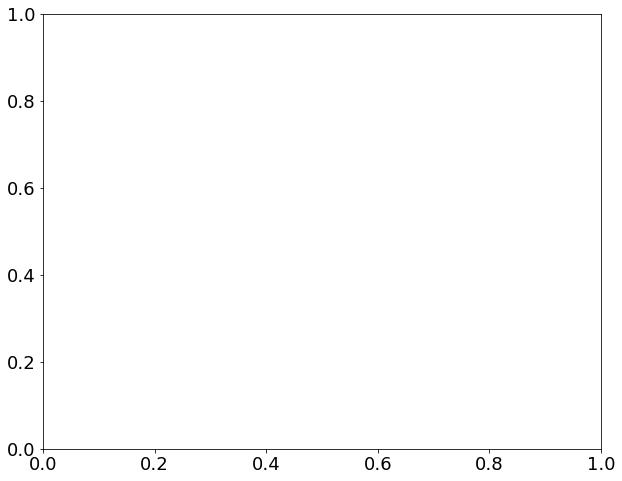

In [77]:
with rc_context({'figure.figsize':(10,8),'font.size':18}):
    fig, ax = plt.subplots()
    sns.heatmap(bm_p_values_df,cmap='inferno_r',ax=ax,xticklabels=True,yticklabels=True)
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=40)
    plt.tight_layout()
    # plt.savefig(r'.\figures\bm_homotypic_v_heterotypic_proximity.png',dpi=300)
    plt.show()

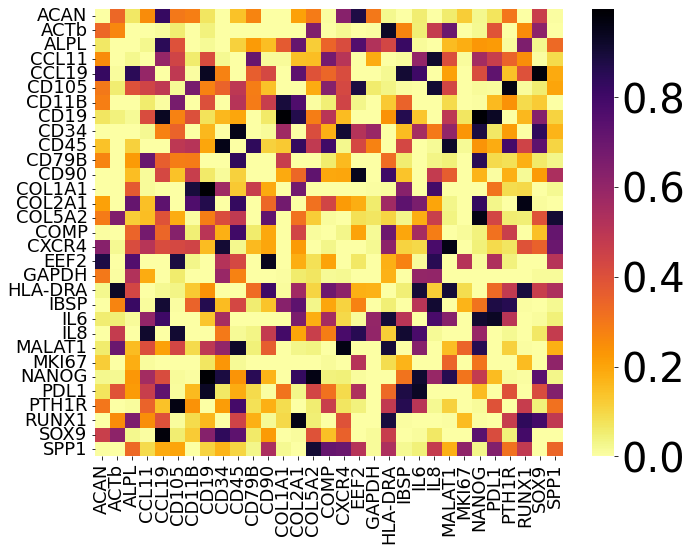

In [148]:
with rc_context({'figure.figsize':(10,8),'font.size':18}):
    fig, ax = plt.subplots()
    sns.heatmap(uc_p_values_df,cmap='inferno_r',ax=ax,xticklabels=True,yticklabels=True)
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=40)
    plt.tight_layout()
    # plt.savefig(r'.\figures\uc_homotypic_v_heterotypic_proximity.png',dpi=300)
    plt.show()

In [165]:
from statsmodels.stats.multitest import multipletests

In [166]:
adjusted_bm = multipletests(bm_p_values, method='fdr_bh')
adjusted_uc = multipletests(uc_p_values, method='fdr_bh')

In [167]:
adjusted_bm_arr = np.zeros((count_adata.var_names.shape[0],count_adata.var_names.shape[0]))
for i,p in enumerate(gene_pairs):
    idx1 = count_adata.var_names.tolist().index(p.split('_')[0])
    idx2 = count_adata.var_names.tolist().index(p.split('_')[1])
    adjusted_bm_arr[idx1,idx2] = adjusted_bm[1][i]
    adjusted_bm_arr[idx2,idx1] = adjusted_bm[1][i]
adjusted_bm_df = pd.DataFrame(adjusted_bm_arr,columns=count_adata.var_names.tolist(),index=count_adata.var_names.tolist())
adjusted_uc_arr = np.zeros((count_adata.var_names.shape[0],count_adata.var_names.shape[0]))
for i,p in enumerate(gene_pairs):
    idx1 = count_adata.var_names.tolist().index(p.split('_')[0])
    idx2 = count_adata.var_names.tolist().index(p.split('_')[1])
    adjusted_uc_arr[idx1,idx2] = adjusted_uc[1][i]
    adjusted_uc_arr[idx2,idx1] = adjusted_uc[1][i]
adjusted_uc_df = pd.DataFrame(adjusted_uc_arr,columns=count_adata.var_names.tolist(),index=count_adata.var_names.tolist())

In [174]:
bm_significance = bm_p_values_arr < (0.05/len(bm_p_values))
bm_significance = pd.DataFrame(bm_significance,columns=count_adata.var_names.tolist(),index=count_adata.var_names.tolist())

uc_significance = uc_p_values_arr < (0.05/len(uc_p_values))
uc_significance = pd.DataFrame(uc_significance,columns=count_adata.var_names.tolist(),index=count_adata.var_names.tolist())

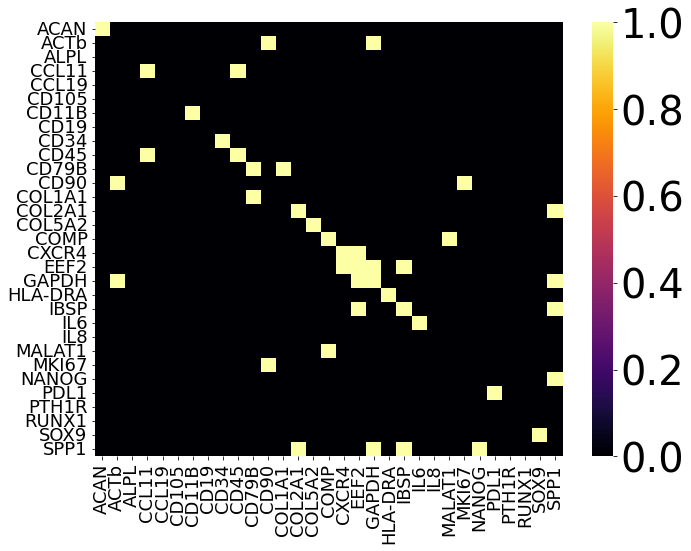

In [202]:
with rc_context({'figure.figsize':(10,8),'font.size':18}):
    fig, ax = plt.subplots()
    sns.heatmap(bm_significance,cmap='inferno',ax=ax,xticklabels=True,yticklabels=True)
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=40)
    plt.tight_layout()
    plt.savefig(r'.\figures\bm_homotypic_v_heterotypic_proximity_corrected_significance.png',dpi=300)
    plt.show()

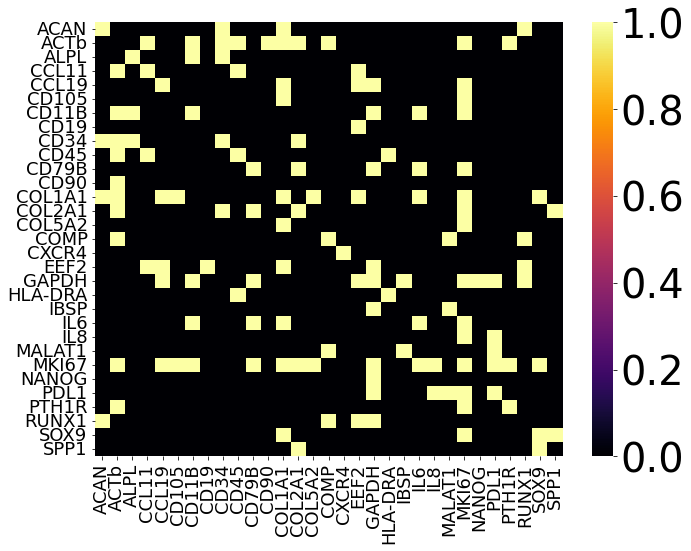

In [201]:
with rc_context({'figure.figsize':(10,8),'font.size':18}):
    fig, ax = plt.subplots()
    sns.heatmap(uc_significance,cmap='inferno',ax=ax,xticklabels=True,yticklabels=True)
    cbar = ax.collections[0].colorbar
    cbar.ax.tick_params(labelsize=40)
    plt.tight_layout()
    plt.savefig(r'.\figures\uc_homotypic_v_heterotypic_proximity_corrected_significance.png',dpi=300)
    plt.show()

#### homo v. hetero patches bm

In [78]:
from statannot import add_stat_annotation

##### set1

In [154]:
gene_pairs = ['COL1A1_COMP','COL1A1_COL5A2','IL6_COL1A1','CXCR4_COL1A1','IL8_CCL19', 'IL6_IL8']

In [155]:
bm_proxi = []
bm_pairs = []
bm_int_type = []

for p in tqdm(gene_pairs):
    if not p in proxi_df.columns.tolist():
        p = p.split('_')[1] + '_' + p.split('_')[0]
    bm_pair_proxi = proxi_df[p].to_numpy()
    homotypic_proxi = []
    curr_homotypic_patch = []
    heterotypic_proxi = []
    curr_heterotypic_patch = []
    for i in range(len(bm_boarder_patch)):
        int_type = bm_interaction_type[i]
        idx1 = proxi_df['index'].tolist().index(bm_boarder_patch[i][0])
        idx2 = proxi_df['index'].tolist().index(bm_boarder_patch[i][1])
        if bm_interaction_type[i] == 'homotypic':
            proxi1 = bm_pair_proxi[idx1]
            if (not bm_boarder_patch[i][0] in curr_homotypic_patch) and (not proxi1 == 0):
                homotypic_proxi.append(proxi1)
                curr_homotypic_patch.append(bm_boarder_patch[i][0])
            proxi2 = bm_pair_proxi[idx2]
            if (not bm_boarder_patch[i][1] in curr_homotypic_patch) and (not proxi2 == 0):
                homotypic_proxi.append(proxi2)
                curr_homotypic_patch.append(bm_boarder_patch[i][1])
        else:
            proxi1 = bm_pair_proxi[idx1]
            if (not bm_boarder_patch[i][0] in curr_heterotypic_patch) and (not proxi1 == 0):
                heterotypic_proxi.append(proxi1)
                curr_heterotypic_patch.append(bm_boarder_patch[i][0])
            proxi2 = bm_pair_proxi[idx2]
            if (not bm_boarder_patch[i][1] in curr_heterotypic_patch) and (not proxi2 == 0):
                heterotypic_proxi.append(proxi2)
                curr_heterotypic_patch.append(bm_boarder_patch[i][1])
        
    bm_proxi = bm_proxi + homotypic_proxi
    bm_int_type = bm_int_type + ['Homotypic']*len(homotypic_proxi)
    bm_pairs = bm_pairs + [p]*len(homotypic_proxi)
    
    bm_proxi = bm_proxi + heterotypic_proxi
    bm_int_type = bm_int_type + ['Heterotypic']*len(heterotypic_proxi)
    bm_pairs = bm_pairs + [p]*len(heterotypic_proxi)
        
    assert(len(bm_proxi) == len(bm_int_type))
    assert(len(bm_proxi) == len(bm_pairs))

  0%|          | 0/6 [00:00<?, ?it/s]

100%|██████████| 6/6 [00:12<00:00,  2.01s/it]


In [156]:
bm_bar_df = pd.DataFrame({'Proximity':bm_proxi,'Interaction Type':bm_int_type,'Gene Pair':bm_pairs})

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

COL1A1_COL5A2_Homotypic v.s. COL1A1_COL5A2_Heterotypic: t-test independent samples with Bonferroni correction, P_val=8.156e-01 stat=1.491e+00
COL1A1_COMP_Homotypic v.s. COL1A1_COMP_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.108e-01 stat=2.358e+00
COL1A1_IL6_Homotypic v.s. COL1A1_IL6_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=5.050e-01
COL1A1_CXCR4_Homotypic v.s. COL1A1_CXCR4_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=-6.122e-01
CCL19_IL8_Homotypic v.s. CCL19_IL8_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.815e-01 stat=2.168e+00
IL6_IL8_Homotypic v.s. IL6_IL8_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=7.161e-01


C:\Users\zfang38\AppData\Local\Temp\ipykernel_22548\3918647851.py:26: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)


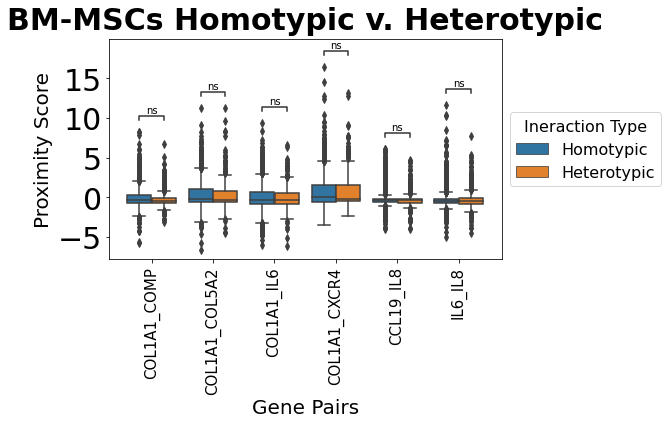

In [159]:
channel_pairs = bm_bar_df["Gene Pair"].unique()
hue = "Interaction Type"
x = "Gene Pair"
gp = bm_bar_df["Gene Pair"].unique()
y = "Proximity"
hue_order=['Homotypic','Heterotypic']
plt.figure(figsize=(9, 6))
plt.title('BM-MSCs Homotypic v. Heterotypic',fontsize= 30, pad=10, fontweight ="bold")

comparisons = [((p, "Homotypic"),(p, "Heterotypic")) for p in channel_pairs]
box_pairs = comparisons
# box_pairs = []
# for chan in channel_pairs:
#     for c in comparisons:
#         box_pair = ((chan, c[0]), (chan, c[1]))
#         box_pairs.append(box_pair)

g = sns.boxplot(data=bm_bar_df, hue=hue, x=x, y=y)
# locs, labels = plt.xticks()
# plt.setp(labels, rotation=90)

add_stat_annotation(g, data=bm_bar_df, x=x, y=y, hue=hue, box_pairs=box_pairs, comparisons_correction='bonferroni',
                    test='t-test_ind', loc='inside', verbose=2)
g.figure.axes[-1].yaxis.label.set_size(20)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize = 15, rotation=90)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)
g.set_xlabel("Gene Pairs",fontsize=20)
g.set_ylabel("Proximity Score",fontsize=20)
handles, labels = g.get_legend_handles_labels()
g.legend(handles, labels, title='Ineraction Type', fontsize=16, title_fontsize=16, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
# plt.savefig(r'.\figures\bm homo v hetero interaction proximity.png', bbox_inches="tight")
plt.show()

In [160]:
uc_proxi = []
uc_pairs = []
uc_int_type = []

for p in tqdm(gene_pairs):
    if not p in proxi_df.columns.tolist():
        p = p.split('_')[1] + '_' + p.split('_')[0]
    uc_pair_proxi = proxi_df[p].to_numpy()
    homotypic_proxi = []
    curr_homotypic_patch = []
    heterotypic_proxi = []
    curr_heterotypic_patch = []
    for i in range(len(uc_boarder_patch)):
        int_type = uc_interaction_type[i]
        idx1 = proxi_df['index'].tolist().index(uc_boarder_patch[i][0])
        idx2 = proxi_df['index'].tolist().index(uc_boarder_patch[i][1])
        if uc_interaction_type[i] == 'homotypic':
            proxi1 = uc_pair_proxi[idx1]
            if (not uc_boarder_patch[i][0] in curr_homotypic_patch) and (not proxi1 == 0):
                homotypic_proxi.append(proxi1)
                curr_homotypic_patch.append(uc_boarder_patch[i][0])
            proxi2 = uc_pair_proxi[idx2]
            if (not uc_boarder_patch[i][1] in curr_homotypic_patch) and (not proxi2 == 0):
                homotypic_proxi.append(proxi2)
                curr_homotypic_patch.append(uc_boarder_patch[i][1])
        else:
            proxi1 = uc_pair_proxi[idx1]
            if (not uc_boarder_patch[i][0] in curr_heterotypic_patch) and (not proxi1 == 0):
                heterotypic_proxi.append(proxi1)
                curr_heterotypic_patch.append(uc_boarder_patch[i][0])
            proxi2 = uc_pair_proxi[idx2]
            if (not uc_boarder_patch[i][1] in curr_heterotypic_patch) and (not proxi2 == 0):
                heterotypic_proxi.append(proxi2)
                curr_heterotypic_patch.append(uc_boarder_patch[i][1])
        
    uc_proxi = uc_proxi + homotypic_proxi
    uc_int_type = uc_int_type + ['Homotypic']*len(homotypic_proxi)
    uc_pairs = uc_pairs + [p]*len(homotypic_proxi)
    
    uc_proxi = uc_proxi + heterotypic_proxi
    uc_int_type = uc_int_type + ['Heterotypic']*len(heterotypic_proxi)
    uc_pairs = uc_pairs + [p]*len(heterotypic_proxi)
        
    assert(len(uc_proxi) == len(uc_int_type))
    assert(len(uc_proxi) == len(uc_pairs))

  0%|          | 0/6 [00:00<?, ?it/s]

100%|██████████| 6/6 [00:26<00:00,  4.48s/it]


In [161]:
uc_bar_df = pd.DataFrame({'Proximity':uc_proxi,'Interaction Type':uc_int_type,'Gene Pair':uc_pairs})

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

COL1A1_COL5A2_Homotypic v.s. COL1A1_COL5A2_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.921e-04 stat=4.163e+00
COL1A1_COMP_Homotypic v.s. COL1A1_COMP_Heterotypic: t-test independent samples with Bonferroni correction, P_val=3.085e-01 stat=1.949e+00
COL1A1_IL6_Homotypic v.s. COL1A1_IL6_Heterotypic: t-test independent samples with Bonferroni correction, P_val=2.640e-04 stat=4.090e+00
COL1A1_CXCR4_Homotypic v.s. COL1A1_CXCR4_Heterotypic: t-test independent samples with Bonferroni correction, P_val=2.676e-02 stat=2.845e+00
CCL19_IL8_Homotypic v.s. CCL19_IL8_Heterotypic: t-test independent samples with Bonferroni correction, P_val=6.351e-01 stat=-1.617e+00
IL6_IL8_Homotypic v.s. IL6_IL8_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=5.463e-02


C:\Users\zfang38\AppData\Local\Temp\ipykernel_22548\640322376.py:26: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)


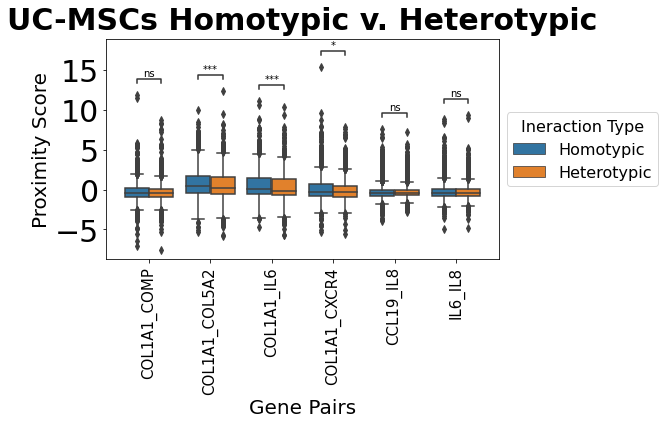

In [162]:
channel_pairs = uc_bar_df["Gene Pair"].unique()
hue = "Interaction Type"
x = "Gene Pair"
gp = uc_bar_df["Gene Pair"].unique()
y = "Proximity"
hue_order=['Homotypic','Heterotypic']
plt.figure(figsize=(9, 6))
plt.title('UC-MSCs Homotypic v. Heterotypic',fontsize= 30, pad=10, fontweight ="bold")

comparisons = [((p, "Homotypic"),(p, "Heterotypic")) for p in channel_pairs]
box_pairs = comparisons
# box_pairs = []
# for chan in channel_pairs:
#     for c in comparisons:
#         box_pair = ((chan, c[0]), (chan, c[1]))
#         box_pairs.append(box_pair)

g = sns.boxplot(data=uc_bar_df, hue=hue, x=x, y=y)
# locs, labels = plt.xticks()
# plt.setp(labels, rotation=90)

add_stat_annotation(g, data=uc_bar_df, x=x, y=y, hue=hue, box_pairs=box_pairs, comparisons_correction='bonferroni',
                    test='t-test_ind', loc='inside', verbose=2)
g.figure.axes[-1].yaxis.label.set_size(20)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize = 15, rotation=90)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)
g.set_xlabel("Gene Pairs",fontsize=20)
g.set_ylabel("Proximity Score",fontsize=20)
handles, labels = g.get_legend_handles_labels()
g.legend(handles, labels, title='Ineraction Type', fontsize=16, title_fontsize=16, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
# plt.savefig(r'.\figures\uc homo v hetero interaction proximity.png', bbox_inches="tight")
plt.show()

##### set2, multicomparison corrected

In [192]:
gene_pairs = ['EEF2_IBSP','MKI67_CD90','IL6_COL1A1','PDL1_MKI67', 'COL5A2_COL1A1']

In [193]:
bm_proxi = []
bm_pairs = []
bm_int_type = []

for p in tqdm(gene_pairs):
    if not p in proxi_df.columns.tolist():
        p = p.split('_')[1] + '_' + p.split('_')[0]
    bm_pair_proxi = proxi_df[p].to_numpy()
    homotypic_proxi = []
    curr_homotypic_patch = []
    heterotypic_proxi = []
    curr_heterotypic_patch = []
    for i in range(len(bm_boarder_patch)):
        int_type = bm_interaction_type[i]
        idx1 = proxi_df['index'].tolist().index(bm_boarder_patch[i][0])
        idx2 = proxi_df['index'].tolist().index(bm_boarder_patch[i][1])
        if bm_interaction_type[i] == 'homotypic':
            proxi1 = bm_pair_proxi[idx1]
            if (not bm_boarder_patch[i][0] in curr_homotypic_patch) and (not proxi1 == 0):
                homotypic_proxi.append(proxi1)
                curr_homotypic_patch.append(bm_boarder_patch[i][0])
            proxi2 = bm_pair_proxi[idx2]
            if (not bm_boarder_patch[i][1] in curr_homotypic_patch) and (not proxi2 == 0):
                homotypic_proxi.append(proxi2)
                curr_homotypic_patch.append(bm_boarder_patch[i][1])
        else:
            proxi1 = bm_pair_proxi[idx1]
            if (not bm_boarder_patch[i][0] in curr_heterotypic_patch) and (not proxi1 == 0):
                heterotypic_proxi.append(proxi1)
                curr_heterotypic_patch.append(bm_boarder_patch[i][0])
            proxi2 = bm_pair_proxi[idx2]
            if (not bm_boarder_patch[i][1] in curr_heterotypic_patch) and (not proxi2 == 0):
                heterotypic_proxi.append(proxi2)
                curr_heterotypic_patch.append(bm_boarder_patch[i][1])
        
    bm_proxi = bm_proxi + homotypic_proxi
    bm_int_type = bm_int_type + ['Homotypic']*len(homotypic_proxi)
    bm_pairs = bm_pairs + [p]*len(homotypic_proxi)
    
    bm_proxi = bm_proxi + heterotypic_proxi
    bm_int_type = bm_int_type + ['Heterotypic']*len(heterotypic_proxi)
    bm_pairs = bm_pairs + [p]*len(heterotypic_proxi)
        
    assert(len(bm_proxi) == len(bm_int_type))
    assert(len(bm_proxi) == len(bm_pairs))

100%|██████████| 5/5 [00:12<00:00,  2.42s/it]


In [194]:
bm_bar_df = pd.DataFrame({'Proximity':bm_proxi,'Interaction Type':bm_int_type,'Gene Pair':bm_pairs})

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

CD90_MKI67_Homotypic v.s. CD90_MKI67_Heterotypic: t-test independent samples with Bonferroni correction, P_val=5.763e-05 stat=-4.393e+00
EEF2_IBSP_Homotypic v.s. EEF2_IBSP_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.211e-05 stat=4.722e+00
COL1A1_IL6_Homotypic v.s. COL1A1_IL6_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=5.050e-01
MKI67_PDL1_Homotypic v.s. MKI67_PDL1_Heterotypic: t-test independent samples with Bonferroni correction, P_val=2.522e-01 stat=1.957e+00
COL1A1_COL5A2_Homotypic v.s. COL1A1_COL5A2_Heterotypic: t-test independent samples with Bonferroni correction, P_val=6.797e-01 stat=1.491e+00


C:\Users\zfang38\AppData\Local\Temp\ipykernel_22548\3398569796.py:26: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)


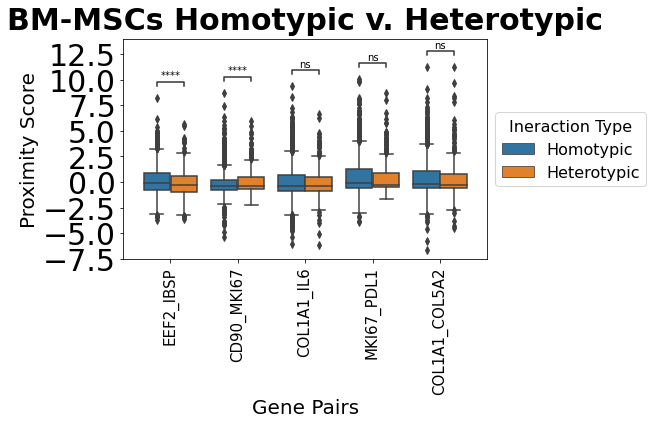

In [199]:
channel_pairs = bm_bar_df["Gene Pair"].unique()
hue = "Interaction Type"
x = "Gene Pair"
gp = bm_bar_df["Gene Pair"].unique()
y = "Proximity"
hue_order=['Homotypic','Heterotypic']
plt.figure(figsize=(9, 6))
plt.title('BM-MSCs Homotypic v. Heterotypic',fontsize= 30, pad=10, fontweight ="bold")

comparisons = [((p, "Homotypic"),(p, "Heterotypic")) for p in channel_pairs]
box_pairs = comparisons
# box_pairs = []
# for chan in channel_pairs:
#     for c in comparisons:
#         box_pair = ((chan, c[0]), (chan, c[1]))
#         box_pairs.append(box_pair)

g = sns.boxplot(data=bm_bar_df, hue=hue, x=x, y=y)
# locs, labels = plt.xticks()
# plt.setp(labels, rotation=90)

add_stat_annotation(g, data=bm_bar_df, x=x, y=y, hue=hue, box_pairs=box_pairs, comparisons_correction='bonferroni',
                    test='t-test_ind', loc='inside', verbose=2)
g.figure.axes[-1].yaxis.label.set_size(20)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize = 15, rotation=90)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)
g.set_xlabel("Gene Pairs",fontsize=20)
g.set_ylabel("Proximity Score",fontsize=20)
handles, labels = g.get_legend_handles_labels()
g.legend(handles, labels, title='Ineraction Type', fontsize=16, title_fontsize=16, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.savefig(r'.\figures\bm homo v hetero interaction proximity corrected.png', bbox_inches="tight")
plt.show()

In [196]:
uc_proxi = []
uc_pairs = []
uc_int_type = []

for p in tqdm(gene_pairs):
    if not p in proxi_df.columns.tolist():
        p = p.split('_')[1] + '_' + p.split('_')[0]
    uc_pair_proxi = proxi_df[p].to_numpy()
    homotypic_proxi = []
    curr_homotypic_patch = []
    heterotypic_proxi = []
    curr_heterotypic_patch = []
    for i in range(len(uc_boarder_patch)):
        int_type = uc_interaction_type[i]
        idx1 = proxi_df['index'].tolist().index(uc_boarder_patch[i][0])
        idx2 = proxi_df['index'].tolist().index(uc_boarder_patch[i][1])
        if uc_interaction_type[i] == 'homotypic':
            proxi1 = uc_pair_proxi[idx1]
            if (not uc_boarder_patch[i][0] in curr_homotypic_patch) and (not proxi1 == 0):
                homotypic_proxi.append(proxi1)
                curr_homotypic_patch.append(uc_boarder_patch[i][0])
            proxi2 = uc_pair_proxi[idx2]
            if (not uc_boarder_patch[i][1] in curr_homotypic_patch) and (not proxi2 == 0):
                homotypic_proxi.append(proxi2)
                curr_homotypic_patch.append(uc_boarder_patch[i][1])
        else:
            proxi1 = uc_pair_proxi[idx1]
            if (not uc_boarder_patch[i][0] in curr_heterotypic_patch) and (not proxi1 == 0):
                heterotypic_proxi.append(proxi1)
                curr_heterotypic_patch.append(uc_boarder_patch[i][0])
            proxi2 = uc_pair_proxi[idx2]
            if (not uc_boarder_patch[i][1] in curr_heterotypic_patch) and (not proxi2 == 0):
                heterotypic_proxi.append(proxi2)
                curr_heterotypic_patch.append(uc_boarder_patch[i][1])
        
    uc_proxi = uc_proxi + homotypic_proxi
    uc_int_type = uc_int_type + ['Homotypic']*len(homotypic_proxi)
    uc_pairs = uc_pairs + [p]*len(homotypic_proxi)
    
    uc_proxi = uc_proxi + heterotypic_proxi
    uc_int_type = uc_int_type + ['Heterotypic']*len(heterotypic_proxi)
    uc_pairs = uc_pairs + [p]*len(heterotypic_proxi)
        
    assert(len(uc_proxi) == len(uc_int_type))
    assert(len(uc_proxi) == len(uc_pairs))

  0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 5/5 [00:24<00:00,  4.99s/it]


In [197]:
uc_bar_df = pd.DataFrame({'Proximity':uc_proxi,'Interaction Type':uc_int_type,'Gene Pair':uc_pairs})

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

CD90_MKI67_Homotypic v.s. CD90_MKI67_Heterotypic: t-test independent samples with Bonferroni correction, P_val=5.151e-02 stat=-2.567e+00
EEF2_IBSP_Homotypic v.s. EEF2_IBSP_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.000e+00 stat=1.060e+00
COL1A1_IL6_Homotypic v.s. COL1A1_IL6_Heterotypic: t-test independent samples with Bonferroni correction, P_val=2.200e-04 stat=4.090e+00
MKI67_PDL1_Homotypic v.s. MKI67_PDL1_Heterotypic: t-test independent samples with Bonferroni correction, P_val=8.286e-04 stat=3.769e+00
COL1A1_COL5A2_Homotypic v.s. COL1A1_COL5A2_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.601e-04 stat=4.163e+00


C:\Users\zfang38\AppData\Local\Temp\ipykernel_22548\2855436571.py:26: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)


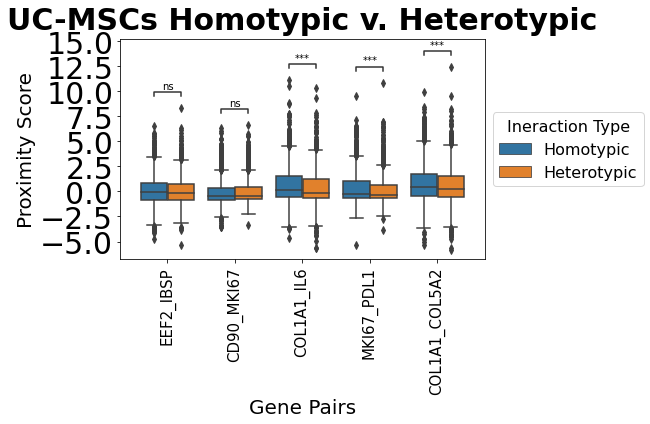

In [200]:
channel_pairs = uc_bar_df["Gene Pair"].unique()
hue = "Interaction Type"
x = "Gene Pair"
gp = uc_bar_df["Gene Pair"].unique()
y = "Proximity"
hue_order=['Homotypic','Heterotypic']
plt.figure(figsize=(9, 6))
plt.title('UC-MSCs Homotypic v. Heterotypic',fontsize= 30, pad=10, fontweight ="bold")

comparisons = [((p, "Homotypic"),(p, "Heterotypic")) for p in channel_pairs]
box_pairs = comparisons
# box_pairs = []
# for chan in channel_pairs:
#     for c in comparisons:
#         box_pair = ((chan, c[0]), (chan, c[1]))
#         box_pairs.append(box_pair)

g = sns.boxplot(data=uc_bar_df, hue=hue, x=x, y=y)
# locs, labels = plt.xticks()
# plt.setp(labels, rotation=90)

add_stat_annotation(g, data=uc_bar_df, x=x, y=y, hue=hue, box_pairs=box_pairs, comparisons_correction='bonferroni',
                    test='t-test_ind', loc='inside', verbose=2)
g.figure.axes[-1].yaxis.label.set_size(20)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize = 15, rotation=90)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)
g.set_xlabel("Gene Pairs",fontsize=20)
g.set_ylabel("Proximity Score",fontsize=20)
handles, labels = g.get_legend_handles_labels()
g.legend(handles, labels, title='Ineraction Type', fontsize=16, title_fontsize=16, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.savefig(r'.\figures\uc homo v hetero interaction proximity corrected.png', bbox_inches="tight")
plt.show()

# Single-transcripts example of homo and hetero typic patches

In [79]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rc_context
import util
import neighborhoodAnalysis as nha

In [80]:
scale = 249.6/2304
z_scale = 0.3/1

In [81]:
uc_003_1_df = pd.read_csv(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df\uc_003_01.csv',index_col=0)
uc_003_3_df = pd.read_csv(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df\uc_003_03.csv',index_col=0)
uc_003_4_df = pd.read_csv(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df\uc_003_04.csv',index_col=0)

In [82]:
gene_color_dict = {'ACAN':'#ffffff', 'ACTb':'#b60000', 'ALPL':'#008c00', 'CCL11':'#c34fff',
                   'CCL19':'#01a5ca', 'CD105':'#ec9d00', 'CD11B':'#76ff00', 'CD19':'#ff7598',
                   'CD34':'#940073', 'CD45':'#00f3cc', 'CD79B':'#4853ff', 'CD90':'#a6a19a',
                   'COL1A1':'#edb7ff', 'COL2A1':'#8a6800', 'COL5A2':'#6100a3', 'COMP':'#fff585',
                   'CXCR4':'#007b69', 'EEF2':'#92b853', 'GAPDH':'#abd4ff', 'HLA-DRA':'#7e79a3',
                   'IBSP':'#ff5401', 'IL6':'#0a577d', 'IL8':'#a8615c', 'MALAT1':'#e700b9',
                   'MKI67':'#ffc3a6', 'NANOG':'#00b485', 'PDL1':'#7e9eff', 'PTH1R':'#b8d8b7',
                   'RUNX1':'#c082b7', 'SOX9':'#6f895b', 'SPP1':'#8a48a2'}

## uc 003-03, p21, 23, uc003-04, p21,26

In [21]:
uc_003_3_21 = uc_003_3_df[uc_003_3_df['patch']==21]
uc_003_3_21.reset_index(drop=True,inplace=True)

uc_003_3_23 = uc_003_3_df[uc_003_3_df['patch']==23]
uc_003_3_23.reset_index(drop=True,inplace=True)

uc_003_4_21 = uc_003_4_df[uc_003_4_df['patch']==21]
uc_003_4_21.reset_index(drop=True,inplace=True)

uc_003_4_26 = uc_003_4_df[uc_003_4_df['patch']==26]
uc_003_4_26.reset_index(drop=True,inplace=True)

In [22]:
uc_003_3_21_pairs = nha.find_connected_pairs(uc_003_3_21,5,'row','col','z')
uc_003_3_23_pairs = nha.find_connected_pairs(uc_003_3_23,5,'row','col','z')
uc_003_4_21_pairs = nha.find_connected_pairs(uc_003_4_21,5,'row','col','z')
uc_003_4_26_pairs = nha.find_connected_pairs(uc_003_4_26,5,'row','col','z')

In [23]:
gene_pairs = [('COL1A1','IL6'),('COL1A1','COL5A2'),('MKI67','PDL1')]

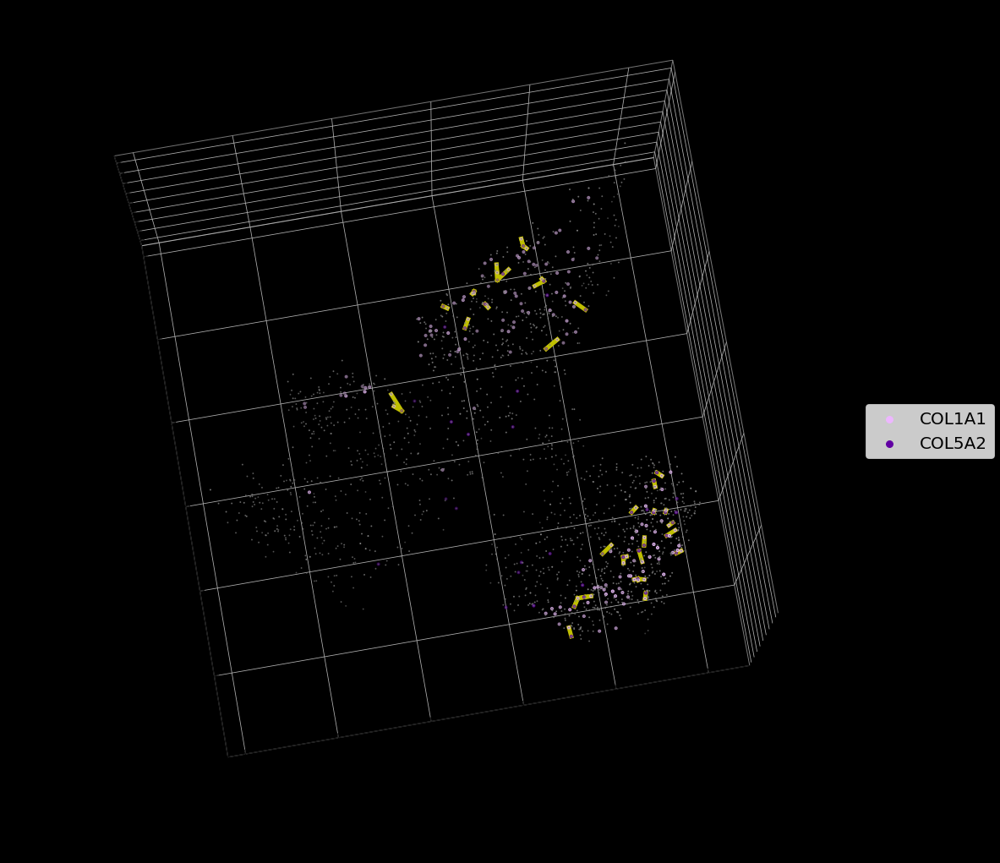

In [62]:
fig = plt.figure(figsize=(16,15))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_003_3_21['row']*scale,uc_003_3_21['col']*scale,uc_003_3_21['z']*z_scale,color='gray',s=1)
ax.scatter(uc_003_3_23['row']*scale,uc_003_3_23['col']*scale,uc_003_3_23['z']*z_scale,color='gray',s=1)
ax.scatter(uc_003_4_21['row']*scale,uc_003_4_21['col']*scale,uc_003_4_21['z']*z_scale,color='gray',s=1)
ax.scatter(uc_003_4_26['row']*scale,uc_003_4_26['col']*scale,uc_003_4_26['z']*z_scale,color='gray',s=1)

p = gene_pairs[1]

uc_003_3_21_col1a1 = uc_003_3_21[uc_003_3_21['gene']==p[0]]
uc_003_3_23_col1a1 = uc_003_3_23[uc_003_3_23['gene']==p[0]]
uc_003_4_21_col1a1 = uc_003_4_21[uc_003_4_21['gene']==p[0]]
uc_003_4_26_col1a1 = uc_003_4_26[uc_003_4_26['gene']==p[0]]

col1a1_df = pd.concat([uc_003_3_21_col1a1,uc_003_3_23_col1a1,uc_003_4_21_col1a1,uc_003_4_26_col1a1])
ax.scatter(col1a1_df['row']*scale,col1a1_df['col']*scale,col1a1_df['z']*z_scale,color=gene_color_dict[p[0]],s=10,label=p[0])

uc_003_3_21_il6 = uc_003_3_21[uc_003_3_21['gene']==p[1]]
uc_003_3_23_il6 = uc_003_3_23[uc_003_3_23['gene']==p[1]]
uc_003_4_21_il6 = uc_003_4_21[uc_003_4_21['gene']==p[1]]
uc_003_4_26_il6 = uc_003_4_26[uc_003_4_26['gene']==p[1]]

il6_df = pd.concat([uc_003_3_21_il6,uc_003_3_23_il6,uc_003_4_21_il6,uc_003_4_26_il6])
ax.scatter(il6_df['row']*scale,il6_df['col']*scale,il6_df['z']*z_scale,color=gene_color_dict[p[1]],s=10,label=p[1])

for i in range(len(uc_003_3_21_pairs)):
    gene1 = uc_003_3_21_pairs[i][0]
    gene2 = uc_003_3_21_pairs[i][1]
    if (uc_003_3_21.iloc[gene1]['gene'] in p) and (uc_003_3_21.iloc[gene2]['gene'] in p) and (uc_003_3_21.iloc[gene1]['gene'] != uc_003_3_21.iloc[gene2]['gene']):
        ax.plot([uc_003_3_21.iloc[gene1]['row']*scale,uc_003_3_21.iloc[gene2]['row']*scale],
                [uc_003_3_21.iloc[gene1]['col']*scale,uc_003_3_21.iloc[gene2]['col']*scale],
                [uc_003_3_21.iloc[gene1]['z']*z_scale,uc_003_3_21.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)

for i in range(len(uc_003_3_23_pairs)):
    gene1 = uc_003_3_23_pairs[i][0]
    gene2 = uc_003_3_23_pairs[i][1]
    if (uc_003_3_23.iloc[gene1]['gene'] in p) and (uc_003_3_23.iloc[gene2]['gene'] in p) and (uc_003_3_23.iloc[gene1]['gene'] != uc_003_3_23.iloc[gene2]['gene']):
        ax.plot([uc_003_3_23.iloc[gene1]['row']*scale,uc_003_3_23.iloc[gene2]['row']*scale],
                [uc_003_3_23.iloc[gene1]['col']*scale,uc_003_3_23.iloc[gene2]['col']*scale],
                [uc_003_3_23.iloc[gene1]['z']*z_scale,uc_003_3_23.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)

for i in range(len(uc_003_4_21_pairs)):
    gene1 = uc_003_4_21_pairs[i][0]
    gene2 = uc_003_4_21_pairs[i][1]
    if (uc_003_4_21.iloc[gene1]['gene'] in p) and (uc_003_4_21.iloc[gene2]['gene'] in p) and (uc_003_4_21.iloc[gene1]['gene'] != uc_003_4_21.iloc[gene2]['gene']):
        ax.plot([uc_003_4_21.iloc[gene1]['row']*scale,uc_003_4_21.iloc[gene2]['row']*scale],
                [uc_003_4_21.iloc[gene1]['col']*scale,uc_003_4_21.iloc[gene2]['col']*scale],
                [uc_003_4_21.iloc[gene1]['z']*z_scale,uc_003_4_21.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)

for i in range(len(uc_003_4_26_pairs)):
    gene1 = uc_003_4_26_pairs[i][0]
    gene2 = uc_003_4_26_pairs[i][1]
    if (uc_003_4_26.iloc[gene1]['gene'] in p) and (uc_003_4_26.iloc[gene2]['gene'] in p) and (uc_003_4_26.iloc[gene1]['gene'] != uc_003_4_26.iloc[gene2]['gene']):
        ax.plot([uc_003_4_26.iloc[gene1]['row']*scale,uc_003_4_26.iloc[gene2]['row']*scale],
                [uc_003_4_26.iloc[gene1]['col']*scale,uc_003_4_26.iloc[gene2]['col']*scale],
                [uc_003_4_26.iloc[gene1]['z']*z_scale,uc_003_4_26.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

# plt.savefig(r'.\figures\uc_003_03_04_boarder_patches_rna.png',dpi=300)

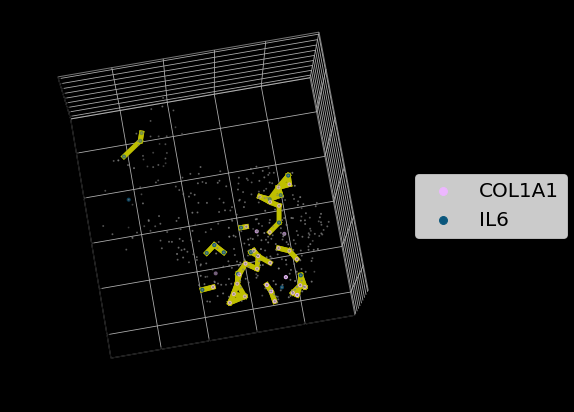

In [11]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_003_3_21['row']*scale,uc_003_3_21['col']*scale,uc_003_3_21['z']*z_scale,color='gray',s=1)

uc_003_3_21_col1a1 = uc_003_3_21[uc_003_3_21['gene']=='COL1A1']
ax.scatter(uc_003_3_21_col1a1['row']*scale,uc_003_3_21_col1a1['col']*scale,uc_003_3_21_col1a1['z']*z_scale,color=gene_color_dict['COL1A1'],s=10,label='COL1A1')

uc_003_3_21_il6 = uc_003_3_21[uc_003_3_21['gene']=='IL6']
ax.scatter(uc_003_3_21_il6['row']*scale,uc_003_3_21_il6['col']*scale,uc_003_3_21_il6['z']*z_scale,color=gene_color_dict['IL6'],s=10,label='IL6')

total_edges = 0
for i in range(len(uc_003_3_21_pairs)):
    gene1 = uc_003_3_21_pairs[i][0]
    gene2 = uc_003_3_21_pairs[i][1]
    if uc_003_3_21.iloc[gene1]['gene'] in ['COL1A1','IL6'] and uc_003_3_21.iloc[gene2]['gene'] in ['COL1A1','IL6']:
        total_edges = total_edges + 1
        ax.plot([uc_003_3_21.iloc[gene1]['row']*scale,uc_003_3_21.iloc[gene2]['row']*scale],
                [uc_003_3_21.iloc[gene1]['col']*scale,uc_003_3_21.iloc[gene2]['col']*scale],
                [uc_003_3_21.iloc[gene1]['z']*z_scale,uc_003_3_21.iloc[gene2]['z']*z_scale],color='y',linewidth=5)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

# plt.savefig(r'.\figures\uc_018_01_5sets.png',dpi=300)

## uc003-03, p17,37, uc003-01, p4,7

In [51]:
uc_003_3_17 = uc_003_3_df[uc_003_3_df['patch']==17]
uc_003_3_17.reset_index(drop=True,inplace=True)

uc_003_3_37 = uc_003_3_df[uc_003_3_df['patch']==37]
uc_003_3_37.reset_index(drop=True,inplace=True)

uc_003_1_4 = uc_003_1_df[uc_003_1_df['patch']==4]
uc_003_1_4.reset_index(drop=True,inplace=True)

uc_003_1_7 = uc_003_1_df[uc_003_1_df['patch']==7]
uc_003_1_7.reset_index(drop=True,inplace=True)

In [52]:
uc_003_3_17_pairs = nha.find_connected_pairs(uc_003_3_17,5,'row','col','z')
uc_003_3_37_pairs = nha.find_connected_pairs(uc_003_3_37,5,'row','col','z')
uc_003_1_4_pairs = nha.find_connected_pairs(uc_003_1_4,5,'row','col','z')
uc_003_1_7_pairs = nha.find_connected_pairs(uc_003_1_7,5,'row','col','z')

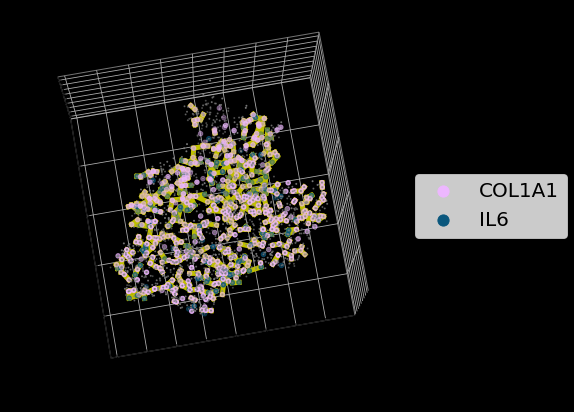

In [53]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_003_3_17['row']*scale,uc_003_3_17['col']*scale,uc_003_3_17['z']*z_scale,color='gray',s=1)
ax.scatter(uc_003_3_37['row']*scale,uc_003_3_37['col']*scale,uc_003_3_37['z']*z_scale,color='gray',s=1)
ax.scatter(uc_003_1_4['row']*scale,uc_003_1_4['col']*scale,uc_003_1_4['z']*z_scale,color='gray',s=1)
ax.scatter(uc_003_1_7['row']*scale,uc_003_1_7['col']*scale,uc_003_1_7['z']*z_scale,color='gray',s=1)

p = gene_pairs[0]

uc_003_3_17_col1a1 = uc_003_3_17[uc_003_3_17['gene']==p[0]]
uc_003_3_37_col1a1 = uc_003_3_37[uc_003_3_37['gene']==p[0]]
uc_003_1_4_col1a1 = uc_003_1_4[uc_003_1_4['gene']==p[0]]
uc_003_1_7_col1a1 = uc_003_1_7[uc_003_1_7['gene']==p[0]]

col1a1_df = pd.concat([uc_003_3_17_col1a1,uc_003_3_37_col1a1,uc_003_1_4_col1a1,uc_003_1_7_col1a1])
ax.scatter(col1a1_df['row']*scale,
           col1a1_df['col']*scale,
           col1a1_df['z']*z_scale,
           color=gene_color_dict[p[0]],s=20,label=p[0])

uc_003_3_17_il6 = uc_003_3_17[uc_003_3_17['gene']==p[1]]
uc_003_3_37_il6 = uc_003_3_37[uc_003_3_37['gene']==p[1]]
uc_003_1_4_il6 = uc_003_1_4[uc_003_1_4['gene']==p[1]]
uc_003_1_7_il6 = uc_003_1_7[uc_003_1_7['gene']==p[1]]

il6_df = pd.concat([uc_003_3_17_il6,uc_003_3_37_il6,uc_003_1_4_il6,uc_003_1_7_il6])
ax.scatter(il6_df['row']*scale,
           il6_df['col']*scale,
           il6_df['z']*z_scale,
           color=gene_color_dict[p[1]],s=20,label=p[1])

for i in range(len(uc_003_3_17_pairs)):
    gene1 = uc_003_3_17_pairs[i][0]
    gene2 = uc_003_3_17_pairs[i][1]
    if uc_003_3_17.iloc[gene1]['gene'] in p and uc_003_3_17.iloc[gene2]['gene'] in p:
        ax.plot([uc_003_3_17.iloc[gene1]['row']*scale,uc_003_3_17.iloc[gene2]['row']*scale],
                [uc_003_3_17.iloc[gene1]['col']*scale,uc_003_3_17.iloc[gene2]['col']*scale],
                [uc_003_3_17.iloc[gene1]['z']*z_scale,uc_003_3_17.iloc[gene2]['z']*z_scale]
                ,color='y',linewidth=5)

for i in range(len(uc_003_3_37_pairs)):
    gene1 = uc_003_3_37_pairs[i][0]
    gene2 = uc_003_3_37_pairs[i][1]
    if uc_003_3_37.iloc[gene1]['gene'] in p and uc_003_3_37.iloc[gene2]['gene'] in p:
        ax.plot([uc_003_3_37.iloc[gene1]['row']*scale,uc_003_3_37.iloc[gene2]['row']*scale],
                [uc_003_3_37.iloc[gene1]['col']*scale,uc_003_3_37.iloc[gene2]['col']*scale],
                [uc_003_3_37.iloc[gene1]['z']*z_scale,uc_003_3_37.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)
        
for i in range(len(uc_003_1_4_pairs)):
    gene1 = uc_003_1_4_pairs[i][0]
    gene2 = uc_003_1_4_pairs[i][1]
    if uc_003_1_4.iloc[gene1]['gene'] in p and uc_003_1_4.iloc[gene2]['gene'] in p:
        ax.plot([uc_003_1_4.iloc[gene1]['row']*scale,uc_003_1_4.iloc[gene2]['row']*scale],
                [uc_003_1_4.iloc[gene1]['col']*scale,uc_003_1_4.iloc[gene2]['col']*scale],
                [uc_003_1_4.iloc[gene1]['z']*z_scale,uc_003_1_4.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)

for i in range(len(uc_003_1_7_pairs)):
    gene1 = uc_003_1_7_pairs[i][0]
    gene2 = uc_003_1_7_pairs[i][1]
    if uc_003_1_7.iloc[gene1]['gene'] in p and uc_003_1_7.iloc[gene2]['gene'] in p:
        ax.plot([uc_003_1_7.iloc[gene1]['row']*scale,uc_003_1_7.iloc[gene2]['row']*scale],
                [uc_003_1_7.iloc[gene1]['col']*scale,uc_003_1_7.iloc[gene2]['col']*scale],
                [uc_003_1_7.iloc[gene1]['z']*z_scale,uc_003_1_7.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

plt.savefig(r'.\figures\uc_003_01_03_boarder_col1a1_il6.png',dpi=300)

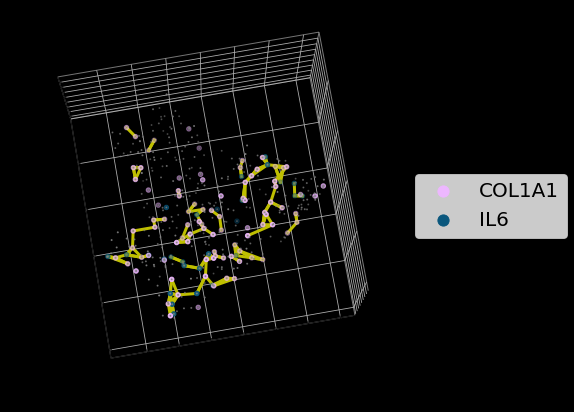

In [55]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_003_3_17['row']*scale,uc_003_3_17['col']*scale,uc_003_3_17['z']*z_scale,color='gray',s=1)

p = gene_pairs[0]

uc_003_3_17_col1a1 = uc_003_3_17[uc_003_3_17['gene']==p[0]]
ax.scatter(uc_003_3_17_col1a1['row']*scale,
           uc_003_3_17_col1a1['col']*scale,
           uc_003_3_17_col1a1['z']*z_scale,
           color=gene_color_dict[p[0]],s=20,label=p[0])

uc_003_3_17_il6 = uc_003_3_17[uc_003_3_17['gene']==p[1]]
ax.scatter(uc_003_3_17_il6['row']*scale,
           uc_003_3_17_il6['col']*scale,
           uc_003_3_17_il6['z']*z_scale,
           color=gene_color_dict[p[1]],s=20,label=p[1])

for i in range(len(uc_003_3_17_pairs)):
    gene1 = uc_003_3_17_pairs[i][0]
    gene2 = uc_003_3_17_pairs[i][1]
    if uc_003_3_17.iloc[gene1]['gene'] in p and uc_003_3_17.iloc[gene2]['gene'] in p:
        ax.plot([uc_003_3_17.iloc[gene1]['row']*scale,uc_003_3_17.iloc[gene2]['row']*scale],
                [uc_003_3_17.iloc[gene1]['col']*scale,uc_003_3_17.iloc[gene2]['col']*scale],
                [uc_003_3_17.iloc[gene1]['z']*z_scale,uc_003_3_17.iloc[gene2]['z']*z_scale]
                ,color='y',linewidth=3)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

plt.savefig(r'.\figures\uc_003_03_17_col1a1_il6.png',dpi=300)

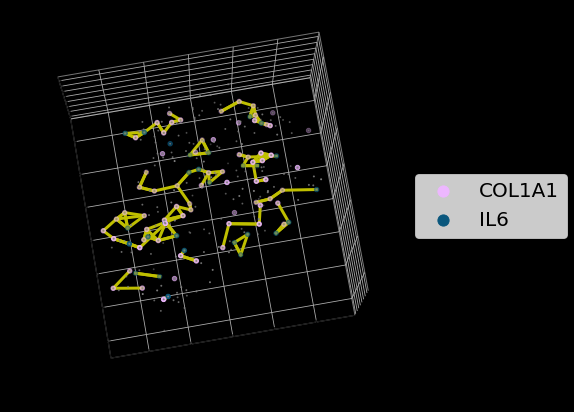

In [57]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_003_3_37['row']*scale,uc_003_3_37['col']*scale,uc_003_3_37['z']*z_scale,color='gray',s=1)

p = gene_pairs[0]

uc_003_3_37_col1a1 = uc_003_3_37[uc_003_3_37['gene']==p[0]]
ax.scatter(uc_003_3_37_col1a1['row']*scale,
           uc_003_3_37_col1a1['col']*scale,
           uc_003_3_37_col1a1['z']*z_scale,
           color=gene_color_dict[p[0]],s=20,label=p[0])

uc_003_3_37_il6 = uc_003_3_37[uc_003_3_37['gene']==p[1]]
ax.scatter(uc_003_3_37_il6['row']*scale,
           uc_003_3_37_il6['col']*scale,
           uc_003_3_37_il6['z']*z_scale,
           color=gene_color_dict[p[1]],s=20,label=p[1])

for i in range(len(uc_003_3_37_pairs)):
    gene1 = uc_003_3_37_pairs[i][0]
    gene2 = uc_003_3_37_pairs[i][1]
    if uc_003_3_37.iloc[gene1]['gene'] in p and uc_003_3_37.iloc[gene2]['gene'] in p:
        ax.plot([uc_003_3_37.iloc[gene1]['row']*scale,uc_003_3_37.iloc[gene2]['row']*scale],
                [uc_003_3_37.iloc[gene1]['col']*scale,uc_003_3_37.iloc[gene2]['col']*scale],
                [uc_003_3_37.iloc[gene1]['z']*z_scale,uc_003_3_37.iloc[gene2]['z']*z_scale],
                color='y',linewidth=3)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

plt.savefig(r'.\figures\uc_003_03_37_col1a1_il6.png',dpi=300)

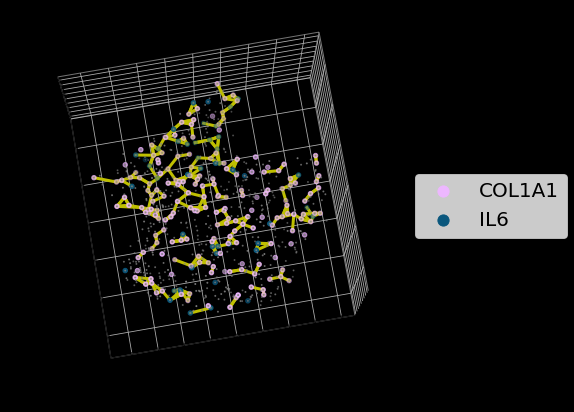

In [59]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_003_1_4['row']*scale,uc_003_1_4['col']*scale,uc_003_1_4['z']*z_scale,color='gray',s=1)

p = gene_pairs[0]

uc_003_1_4_col1a1 = uc_003_1_4[uc_003_1_4['gene']==p[0]]
ax.scatter(uc_003_1_4_col1a1['row']*scale,
           uc_003_1_4_col1a1['col']*scale,
           uc_003_1_4_col1a1['z']*z_scale,
           color=gene_color_dict[p[0]],s=20,label=p[0])

uc_003_1_4_il6 = uc_003_1_4[uc_003_1_4['gene']==p[1]]
ax.scatter(uc_003_1_4_il6['row']*scale,
           uc_003_1_4_il6['col']*scale,
           uc_003_1_4_il6['z']*z_scale,
           color=gene_color_dict[p[1]],s=20,label=p[1])
        
for i in range(len(uc_003_1_4_pairs)):
    gene1 = uc_003_1_4_pairs[i][0]
    gene2 = uc_003_1_4_pairs[i][1]
    if uc_003_1_4.iloc[gene1]['gene'] in p and uc_003_1_4.iloc[gene2]['gene'] in p:
        ax.plot([uc_003_1_4.iloc[gene1]['row']*scale,uc_003_1_4.iloc[gene2]['row']*scale],
                [uc_003_1_4.iloc[gene1]['col']*scale,uc_003_1_4.iloc[gene2]['col']*scale],
                [uc_003_1_4.iloc[gene1]['z']*z_scale,uc_003_1_4.iloc[gene2]['z']*z_scale],
                color='y',linewidth=3)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

plt.savefig(r'.\figures\uc_003_01_4_col1a1_il6.png',dpi=300)

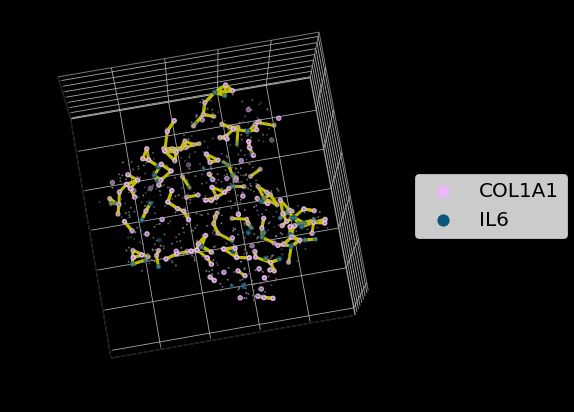

In [61]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_003_1_7['row']*scale,uc_003_1_7['col']*scale,uc_003_1_7['z']*z_scale,color='gray',s=1)

p = gene_pairs[0]

uc_003_1_7_col1a1 = uc_003_1_7[uc_003_1_7['gene']==p[0]]
ax.scatter(uc_003_1_7_col1a1['row']*scale,
           uc_003_1_7_col1a1['col']*scale,
           uc_003_1_7_col1a1['z']*z_scale,
           color=gene_color_dict[p[0]],s=20,label=p[0])

uc_003_1_7_il6 = uc_003_1_7[uc_003_1_7['gene']==p[1]]
ax.scatter(uc_003_1_7_il6['row']*scale,
           uc_003_1_7_il6['col']*scale,
           uc_003_1_7_il6['z']*z_scale,
           color=gene_color_dict[p[1]],s=20,label=p[1])

for i in range(len(uc_003_1_7_pairs)):
    gene1 = uc_003_1_7_pairs[i][0]
    gene2 = uc_003_1_7_pairs[i][1]
    if uc_003_1_7.iloc[gene1]['gene'] in p and uc_003_1_7.iloc[gene2]['gene'] in p:
        ax.plot([uc_003_1_7.iloc[gene1]['row']*scale,uc_003_1_7.iloc[gene2]['row']*scale],
                [uc_003_1_7.iloc[gene1]['col']*scale,uc_003_1_7.iloc[gene2]['col']*scale],
                [uc_003_1_7.iloc[gene1]['z']*z_scale,uc_003_1_7.iloc[gene2]['z']*z_scale],
                color='y',linewidth=3)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

plt.savefig(r'.\figures\uc_003_01_7_col1a1_il6.png',dpi=300)

## uc012 07 p14,35,49,  14 p60

In [31]:
uc_012_4_df = pd.read_csv(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df\uc_012_04.csv',index_col=0)
uc_012_7_df = pd.read_csv(r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df\uc_012_07.csv',index_col=0)

In [33]:
uc_012_7_14 = uc_012_7_df[uc_012_7_df['patch']==14]
uc_012_7_14.reset_index(drop=True,inplace=True)

uc_012_7_35 = uc_012_7_df[uc_012_7_df['patch']==35]
uc_012_7_35.reset_index(drop=True,inplace=True)

uc_012_7_49 = uc_012_7_df[uc_012_7_df['patch']==49]
uc_012_7_49.reset_index(drop=True,inplace=True)

uc_012_14_60 = uc_012_4_df[uc_012_4_df['patch']==60]
uc_012_14_60.reset_index(drop=True,inplace=True)

In [34]:
uc_012_7_14_pairs = nha.find_connected_pairs(uc_012_7_14,5,'row','col','z')
uc_012_7_35_pairs = nha.find_connected_pairs(uc_012_7_35,5,'row','col','z')
uc_012_7_49_pairs = nha.find_connected_pairs(uc_012_7_49,5,'row','col','z')
uc_012_14_60_pairs = nha.find_connected_pairs(uc_012_14_60,5,'row','col','z')

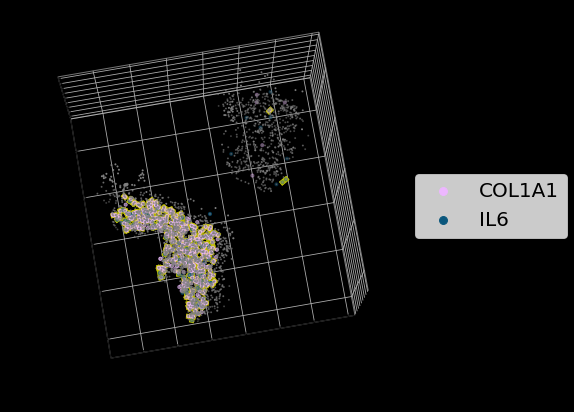

In [37]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_012_7_14['row']*scale,uc_012_7_14['col']*scale,uc_012_7_14['z']*z_scale,color='gray',s=1)
ax.scatter(uc_012_7_35['row']*scale,uc_012_7_35['col']*scale,uc_012_7_35['z']*z_scale,color='gray',s=1)
ax.scatter(uc_012_7_49['row']*scale,uc_012_7_49['col']*scale,uc_012_7_49['z']*z_scale,color='gray',s=1)
ax.scatter(uc_012_14_60['row']*scale,uc_012_14_60['col']*scale,uc_012_14_60['z']*z_scale,color='gray',s=1)

p = gene_pairs[0]

uc_012_7_14_col1a1 = uc_012_7_14[uc_012_7_14['gene']==p[0]]
uc_012_7_35_col1a1 = uc_012_7_35[uc_012_7_35['gene']==p[0]]
uc_012_7_49_col1a1 = uc_012_7_49[uc_012_7_49['gene']==p[0]]
uc_012_14_60_col1a1 = uc_012_14_60[uc_012_14_60['gene']==p[0]]

col1a1_df = pd.concat([uc_012_7_14_col1a1,uc_012_7_35_col1a1,uc_012_7_49_col1a1,uc_012_14_60_col1a1])
ax.scatter(col1a1_df['row']*scale,
           col1a1_df['col']*scale,
           col1a1_df['z']*z_scale,
           color=gene_color_dict[p[0]],s=10,label=p[0])

uc_012_7_14_il6 = uc_012_7_14[uc_012_7_14['gene']==p[1]]
uc_012_7_35_il6 = uc_012_7_35[uc_012_7_35['gene']==p[1]]
uc_012_7_49_il6 = uc_012_7_49[uc_012_7_49['gene']==p[1]]
uc_012_14_60_il6 = uc_012_14_60[uc_012_14_60['gene']==p[1]]

il6_df = pd.concat([uc_012_7_14_il6,uc_012_7_35_il6,uc_012_7_49_il6,uc_012_14_60_il6])
ax.scatter(il6_df['row']*scale,
           il6_df['col']*scale,
           il6_df['z']*z_scale,
           color=gene_color_dict[p[1]],s=10,label=p[1])

for i in range(len(uc_012_7_14_pairs)):
    gene1 = uc_012_7_14_pairs[i][0]
    gene2 = uc_012_7_14_pairs[i][1]
    if uc_012_7_14.iloc[gene1]['gene'] in p and uc_012_7_14.iloc[gene2]['gene'] in p:
        ax.plot([uc_012_7_14.iloc[gene1]['row']*scale,uc_012_7_14.iloc[gene2]['row']*scale],
                [uc_012_7_14.iloc[gene1]['col']*scale,uc_012_7_14.iloc[gene2]['col']*scale],
                [uc_012_7_14.iloc[gene1]['z']*z_scale,uc_012_7_14.iloc[gene2]['z']*z_scale]
                ,color='y',linewidth=5)

for i in range(len(uc_012_7_35_pairs)):
    gene1 = uc_012_7_35_pairs[i][0]
    gene2 = uc_012_7_35_pairs[i][1]
    if uc_012_7_35.iloc[gene1]['gene'] in p and uc_012_7_35.iloc[gene2]['gene'] in p:
        ax.plot([uc_012_7_35.iloc[gene1]['row']*scale,uc_012_7_35.iloc[gene2]['row']*scale],
                [uc_012_7_35.iloc[gene1]['col']*scale,uc_012_7_35.iloc[gene2]['col']*scale],
                [uc_012_7_35.iloc[gene1]['z']*z_scale,uc_012_7_35.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)
        
for i in range(len(uc_012_7_49_pairs)):
    gene1 = uc_012_7_49_pairs[i][0]
    gene2 = uc_012_7_49_pairs[i][1]
    if uc_012_7_49.iloc[gene1]['gene'] in p and uc_012_7_49.iloc[gene2]['gene'] in p:
        ax.plot([uc_012_7_49.iloc[gene1]['row']*scale,uc_012_7_49.iloc[gene2]['row']*scale],
                [uc_012_7_49.iloc[gene1]['col']*scale,uc_012_7_49.iloc[gene2]['col']*scale],
                [uc_012_7_49.iloc[gene1]['z']*z_scale,uc_012_7_49.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)

for i in range(len(uc_012_14_60_pairs)):
    gene1 = uc_012_14_60_pairs[i][0]
    gene2 = uc_012_14_60_pairs[i][1]
    if uc_012_14_60.iloc[gene1]['gene'] in p and uc_012_14_60.iloc[gene2]['gene'] in p:
        ax.plot([uc_012_14_60.iloc[gene1]['row']*scale,uc_012_14_60.iloc[gene2]['row']*scale],
                [uc_012_14_60.iloc[gene1]['col']*scale,uc_012_14_60.iloc[gene2]['col']*scale],
                [uc_012_14_60.iloc[gene1]['z']*z_scale,uc_012_14_60.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

plt.savefig(r'.\figures\uc_012_04_07_boarder_col1a1_il6.png',dpi=300)

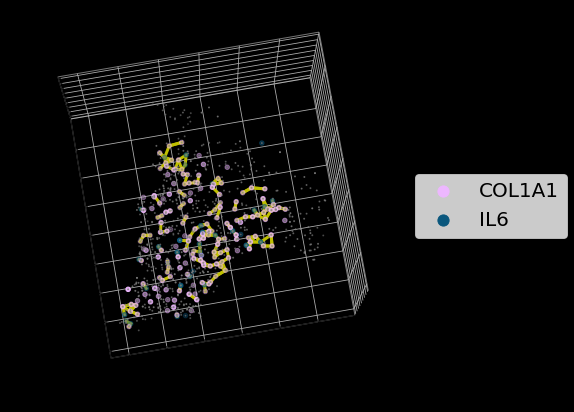

In [50]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_012_7_14['row']*scale,uc_012_7_14['col']*scale,uc_012_7_14['z']*z_scale,color='gray',s=1)

p = gene_pairs[0]

uc_012_7_14_col1a1 = uc_012_7_14[uc_012_7_14['gene']==p[0]]
ax.scatter(uc_012_7_14_col1a1['row']*scale,
           uc_012_7_14_col1a1['col']*scale,
           uc_012_7_14_col1a1['z']*z_scale,
           color=gene_color_dict[p[0]],s=20,label=p[0])

uc_012_7_14_il6 = uc_012_7_14[uc_012_7_14['gene']==p[1]]

ax.scatter(uc_012_7_14_il6['row']*scale,
           uc_012_7_14_il6['col']*scale,
           uc_012_7_14_il6['z']*z_scale,
           color=gene_color_dict[p[1]],s=20,label=p[1])

for i in range(len(uc_012_7_14_pairs)):
    gene1 = uc_012_7_14_pairs[i][0]
    gene2 = uc_012_7_14_pairs[i][1]
    if uc_012_7_14.iloc[gene1]['gene'] in p and uc_012_7_14.iloc[gene2]['gene'] in p:
        ax.plot([uc_012_7_14.iloc[gene1]['row']*scale,uc_012_7_14.iloc[gene2]['row']*scale],
                [uc_012_7_14.iloc[gene1]['col']*scale,uc_012_7_14.iloc[gene2]['col']*scale],
                [uc_012_7_14.iloc[gene1]['z']*z_scale,uc_012_7_14.iloc[gene2]['z']*z_scale]
                ,color='y',linewidth=3)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

plt.savefig(r'.\figures\uc_012_07_14_col1a1_il6.png',dpi=300)

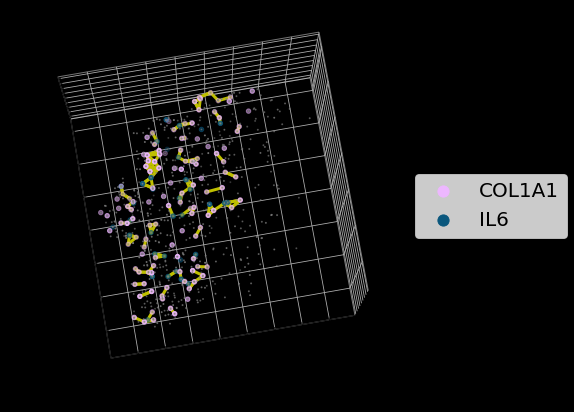

In [45]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_012_7_35['row']*scale,uc_012_7_35['col']*scale,uc_012_7_35['z']*z_scale,color='gray',s=1)

p = gene_pairs[0]

uc_012_7_35_col1a1 = uc_012_7_35[uc_012_7_35['gene']==p[0]]
ax.scatter(uc_012_7_35_col1a1['row']*scale,
           uc_012_7_35_col1a1['col']*scale,
           uc_012_7_35_col1a1['z']*z_scale,
           color=gene_color_dict[p[0]],s=20,label=p[0])

uc_012_7_35_il6 = uc_012_7_35[uc_012_7_35['gene']==p[1]]
ax.scatter(uc_012_7_35_il6['row']*scale,
           uc_012_7_35_il6['col']*scale,
           uc_012_7_35_il6['z']*z_scale,
           color=gene_color_dict[p[1]],s=20,label=p[1])

for i in range(len(uc_012_7_35_pairs)):
    gene1 = uc_012_7_35_pairs[i][0]
    gene2 = uc_012_7_35_pairs[i][1]
    if uc_012_7_35.iloc[gene1]['gene'] in p and uc_012_7_35.iloc[gene2]['gene'] in p:
        ax.plot([uc_012_7_35.iloc[gene1]['row']*scale,uc_012_7_35.iloc[gene2]['row']*scale],
                [uc_012_7_35.iloc[gene1]['col']*scale,uc_012_7_35.iloc[gene2]['col']*scale],
                [uc_012_7_35.iloc[gene1]['z']*z_scale,uc_012_7_35.iloc[gene2]['z']*z_scale],
                color='y',linewidth=3)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

plt.savefig(r'.\figures\uc_012_07_35_col1a1_il6.png',dpi=300)

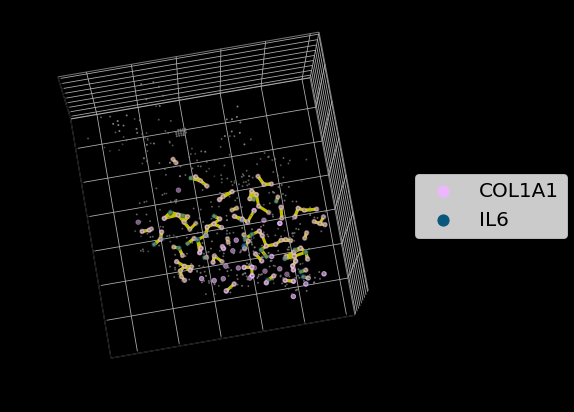

In [46]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_012_7_49['row']*scale,uc_012_7_49['col']*scale,uc_012_7_49['z']*z_scale,color='gray',s=1)

p = gene_pairs[0]

uc_012_7_49_col1a1 = uc_012_7_49[uc_012_7_49['gene']==p[0]]
ax.scatter(uc_012_7_49_col1a1['row']*scale,
           uc_012_7_49_col1a1['col']*scale,
           uc_012_7_49_col1a1['z']*z_scale,
           color=gene_color_dict[p[0]],s=20,label=p[0])

uc_012_7_49_il6 = uc_012_7_49[uc_012_7_49['gene']==p[1]]
ax.scatter(uc_012_7_49_il6['row']*scale,
           uc_012_7_49_il6['col']*scale,
           uc_012_7_49_il6['z']*z_scale,
           color=gene_color_dict[p[1]],s=20,label=p[1])
        
for i in range(len(uc_012_7_49_pairs)):
    gene1 = uc_012_7_49_pairs[i][0]
    gene2 = uc_012_7_49_pairs[i][1]
    if uc_012_7_49.iloc[gene1]['gene'] in p and uc_012_7_49.iloc[gene2]['gene'] in p:
        ax.plot([uc_012_7_49.iloc[gene1]['row']*scale,uc_012_7_49.iloc[gene2]['row']*scale],
                [uc_012_7_49.iloc[gene1]['col']*scale,uc_012_7_49.iloc[gene2]['col']*scale],
                [uc_012_7_49.iloc[gene1]['z']*z_scale,uc_012_7_49.iloc[gene2]['z']*z_scale],
                color='y',linewidth=3)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()

plt.savefig(r'.\figures\uc_012_07_49_col1a1_il6.png',dpi=300)

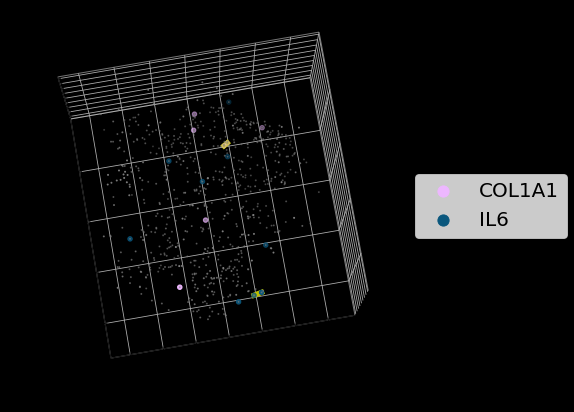

In [47]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(projection='3d')
fig.set_facecolor('black')
ax.set_facecolor('black')
ax.w_xaxis.pane.fill = False
ax.w_yaxis.pane.fill = False
ax.w_zaxis.pane.fill = False
ax.invert_zaxis()

ax.scatter(uc_012_14_60['row']*scale,uc_012_14_60['col']*scale,uc_012_14_60['z']*z_scale,color='gray',s=1)

p = gene_pairs[0]

uc_012_14_60_col1a1 = uc_012_14_60[uc_012_14_60['gene']==p[0]]
ax.scatter(uc_012_14_60_col1a1['row']*scale,
           uc_012_14_60_col1a1['col']*scale,
           uc_012_14_60_col1a1['z']*z_scale,
           color=gene_color_dict[p[0]],s=20,label=p[0])

uc_012_14_60_il6 = uc_012_14_60[uc_012_14_60['gene']==p[1]]
ax.scatter(uc_012_14_60_il6['row']*scale,
           uc_012_14_60_il6['col']*scale,
           uc_012_14_60_il6['z']*z_scale,
           color=gene_color_dict[p[1]],s=20,label=p[1])

for i in range(len(uc_012_14_60_pairs)):
    gene1 = uc_012_14_60_pairs[i][0]
    gene2 = uc_012_14_60_pairs[i][1]
    if uc_012_14_60.iloc[gene1]['gene'] in p and uc_012_14_60.iloc[gene2]['gene'] in p:
        ax.plot([uc_012_14_60.iloc[gene1]['row']*scale,uc_012_14_60.iloc[gene2]['row']*scale],
                [uc_012_14_60.iloc[gene1]['col']*scale,uc_012_14_60.iloc[gene2]['col']*scale],
                [uc_012_14_60.iloc[gene1]['z']*z_scale,uc_012_14_60.iloc[gene2]['z']*z_scale],
                color='y',linewidth=5)
        
ax.view_init(-100, 100)
ax.legend(loc='center left',bbox_to_anchor=(1,0.5),ncol=1,fontsize=20,markerscale=2.5)

plt.tight_layout()


plt.savefig(r'.\figures\uc_012_04_60_col1a1_il6.png',dpi=300)

# border patch embedding feature values

## Compute

In [83]:
embedding = pd.read_csv(r'.\results\gae_embedded_features.csv',index_col=0)

In [84]:
def calculate_bm_embedding_p_value(feature):
    bm_embedding = embedding[feature].to_numpy()
    homotypic_embedding = []
    curr_homotypic_patch = []
    heterotypic_embedding = []
    curr_heterotypic_patch = []
    for i in range(len(bm_boarder_patch)):
        idx1 = embedding.index.tolist().index(bm_boarder_patch[i][0])
        idx2 = embedding.index.tolist().index(bm_boarder_patch[i][1])
        if bm_interaction_type[i] == 'homotypic':
            embedding1 = bm_embedding[idx1]
            if (not bm_boarder_patch[i][0] in curr_homotypic_patch):
                homotypic_embedding.append(embedding1)
                curr_homotypic_patch.append(bm_boarder_patch[i][0])
            embedding2 = bm_embedding[idx2]
            if (not bm_boarder_patch[i][1] in curr_homotypic_patch):
                homotypic_embedding.append(embedding2)
                curr_homotypic_patch.append(bm_boarder_patch[i][1])
        else:
            embedding1 = bm_embedding[idx1]
            if (not bm_boarder_patch[i][0] in curr_heterotypic_patch):
                heterotypic_embedding.append(embedding1)
                curr_heterotypic_patch.append(bm_boarder_patch[i][0])
            embedding2 = bm_embedding[idx2]
            if (not bm_boarder_patch[i][1] in curr_heterotypic_patch):
                heterotypic_embedding.append(embedding2)
                curr_heterotypic_patch.append(bm_boarder_patch[i][1])
    t_statistics, p_value = ttest_ind(homotypic_embedding,heterotypic_embedding)
    return p_value

def calculate_uc_embedding_p_value(feature):
    uc_embedding = embedding[feature].to_numpy()
    homotypic_embedding = []
    curr_homotypic_patch = []
    heterotypic_embedding = []
    curr_heterotypic_patch = []
    for i in range(len(uc_boarder_patch)):
        idx1 = embedding.index.tolist().index(uc_boarder_patch[i][0])
        idx2 = embedding.index.tolist().index(uc_boarder_patch[i][1])
        if uc_interaction_type[i] == 'homotypic':
            embedding1 = uc_embedding[idx1]
            if (not uc_boarder_patch[i][0] in curr_homotypic_patch):
                homotypic_embedding.append(embedding1)
                curr_homotypic_patch.append(uc_boarder_patch[i][0])
            embedding2 = uc_embedding[idx2]
            if (not uc_boarder_patch[i][1] in curr_homotypic_patch):
                homotypic_embedding.append(embedding2)
                curr_homotypic_patch.append(uc_boarder_patch[i][1])
        else:
            embedding1 = uc_embedding[idx1]
            if (not uc_boarder_patch[i][0] in curr_heterotypic_patch):
                heterotypic_embedding.append(embedding1)
                curr_heterotypic_patch.append(uc_boarder_patch[i][0])
            embedding2 = uc_embedding[idx2]
            if (not uc_boarder_patch[i][1] in curr_heterotypic_patch):
                heterotypic_embedding.append(embedding2)
                curr_heterotypic_patch.append(uc_boarder_patch[i][1])
    t_statistics, p_value = ttest_ind(homotypic_embedding,heterotypic_embedding)
    return p_value

In [85]:
bm_embedding_p_values = Parallel(n_jobs=-2, verbose=100)(delayed(calculate_bm_embedding_p_value)(str(f+1)) for f in range(100))
uc_embedding_p_values = Parallel(n_jobs=-2, verbose=100)(delayed(calculate_uc_embedding_p_value)(str(f+1)) for f in range(100))

[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done   1 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-2)]: Done   2 tasks      | elapsed:   10.4s
[Parallel(n_jobs=-2)]: Done   3 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-2)]: Done   4 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-2)]: Done   5 tasks      | elapsed:   10.8s
[Parallel(n_jobs=-2)]: Done   6 tasks      | elapsed:   10.8s
[Parallel(n_jobs=-2)]: Done   7 tasks      | elapsed:   11.3s
[Parallel(n_jobs=-2)]: Done   8 tasks      | elapsed:   18.4s
[Parallel(n_jobs=-2)]: Done   9 tasks      | elapsed:   18.5s
[Parallel(n_jobs=-2)]: Done  10 tasks      | elapsed:   18.5s
[Parallel(n_jobs=-2)]: Done  11 tasks      | elapsed:   19.0s
[Parallel(n_jobs=-2)]: Done  12 tasks      | elapsed:   19.3s
[Parallel(n_jobs=-2)]: Done  13 tasks      | elapsed:   19.5s
[Parallel(n_jobs=-2)]: Done  14 tasks      | elapsed:   19.7s
[Parallel(n_jobs=-2)]: Done  15 tasks      | elapsed:   

In [86]:
bm_embedding_p_values = np.array(bm_embedding_p_values)
uc_embedding_p_values = np.array(uc_embedding_p_values)

bm_embedding_significance = bm_embedding_p_values < (0.05/100)
uc_embedding_significance = uc_embedding_p_values < (0.05/100)

In [87]:
print(np.sum(bm_embedding_significance))
print(np.sum(uc_embedding_significance))

37
28


## boxplot

In [88]:
significant_features = np.where(bm_embedding_significance & uc_embedding_significance)[0]

In [89]:
significant_features

array([ 8, 14, 17, 34, 43, 82, 84, 95, 97], dtype=int64)

In [90]:
significant_features = significant_features + 1
significant_features = significant_features.astype(str)
sub_df = embedding[list(significant_features)]

In [91]:
unique_bm_homotypic = []
unique_bm_heterotypic = []
for i in range(len(bm_boarder_patch)):
    if bm_interaction_type[i] == 'homotypic':
        if not bm_boarder_patch[i][0] in unique_bm_homotypic:
            unique_bm_homotypic.append(bm_boarder_patch[i][0])
        if not bm_boarder_patch[i][1] in unique_bm_homotypic:
            unique_bm_homotypic.append(bm_boarder_patch[i][1])
    else:
        if not bm_boarder_patch[i][0] in unique_bm_heterotypic:
            unique_bm_heterotypic.append(bm_boarder_patch[i][0])
        if not bm_boarder_patch[i][1] in unique_bm_heterotypic:
            unique_bm_heterotypic.append(bm_boarder_patch[i][1])
            
unique_uc_homotypic = []
unique_uc_heterotypic = []
for i in range(len(uc_boarder_patch)):
    if uc_interaction_type[i] == 'homotypic':
        if not uc_boarder_patch[i][0] in unique_uc_homotypic:
            unique_uc_homotypic.append(uc_boarder_patch[i][0])
        if not uc_boarder_patch[i][1] in unique_uc_homotypic:
            unique_uc_homotypic.append(uc_boarder_patch[i][1])
    else:
        if not uc_boarder_patch[i][0] in unique_uc_heterotypic:
            unique_uc_heterotypic.append(uc_boarder_patch[i][0])
        if not uc_boarder_patch[i][1] in unique_uc_heterotypic:
            unique_uc_heterotypic.append(uc_boarder_patch[i][1])

In [92]:
embedding_sub_df = {'Patch':[],'Interaction Type':[],'Feature':[],'Value':[]}
for item in tqdm(unique_bm_homotypic):
    embedding_sub_df['Patch'] = embedding_sub_df['Patch'] + [item]*9
    embedding_sub_df['Interaction Type'] = embedding_sub_df['Interaction Type'] + ['Homotypic']*9
    embedding_sub_df['Feature'] = embedding_sub_df['Feature'] + significant_features.tolist()
    embedding_sub_df['Value'] = embedding_sub_df['Value'] + sub_df.loc[item].tolist()
for item in tqdm(unique_bm_heterotypic):
    embedding_sub_df['Patch'] = embedding_sub_df['Patch'] + [item]*9
    embedding_sub_df['Interaction Type'] = embedding_sub_df['Interaction Type'] + ['Heterotypic']*9
    embedding_sub_df['Feature'] = embedding_sub_df['Feature'] + significant_features.tolist()
    embedding_sub_df['Value'] = embedding_sub_df['Value'] + sub_df.loc[item].tolist()
for item in tqdm(unique_uc_homotypic):
    embedding_sub_df['Patch'] = embedding_sub_df['Patch'] + [item]*9
    embedding_sub_df['Interaction Type'] = embedding_sub_df['Interaction Type'] + ['Homotypic']*9
    embedding_sub_df['Feature'] = embedding_sub_df['Feature'] + significant_features.tolist()
    embedding_sub_df['Value'] = embedding_sub_df['Value'] + sub_df.loc[item].tolist()
for item in tqdm(unique_uc_heterotypic):
    embedding_sub_df['Patch'] = embedding_sub_df['Patch'] + [item]*9
    embedding_sub_df['Interaction Type'] = embedding_sub_df['Interaction Type'] + ['Heterotypic']*9
    embedding_sub_df['Feature'] = embedding_sub_df['Feature'] + significant_features.tolist()
    embedding_sub_df['Value'] = embedding_sub_df['Value'] + sub_df.loc[item].tolist()

 25%|██▍       | 907/3654 [00:00<00:00, 9004.21it/s]

100%|██████████| 2448/2448 [00:03<00:00, 670.03it/s]


In [93]:
embedding_sub_df = pd.DataFrame(embedding_sub_df)

In [94]:
cell_types = []
for item in embedding_sub_df['Patch']:
    cell_types.append(item.split('_')[0])
embedding_sub_df.insert(loc=0,column='Cell Type',value=cell_types)

In [95]:
# embedding_sub_df.to_csv(r'.\results\embedding_border_patches.csv')

In [96]:
embedding_sub_df

,Cell Type,Patch,Interaction Type,Feature,Value
0,bm,bm_001_05_20,Homotypic,9,-0.172160
1,bm,bm_001_05_20,Homotypic,15,-0.090757
2,bm,bm_001_05_20,Homotypic,18,-0.047709
3,bm,bm_001_05_20,Homotypic,35,-0.186539
4,bm,bm_001_05_20,Homotypic,44,0.421819
...,...,...,...,...,...
90688,uc,uc_046_12_9,Heterotypic,44,-0.082418
90689,uc,uc_046_12_9,Heterotypic,83,0.004580
90690,uc,uc_046_12_9,Heterotypic,85,-0.195186
90691,uc,uc_046_12_9,Heterotypic,96,0.164434


In [97]:
bm_sub_df = embedding_sub_df[embedding_sub_df['Cell Type']=='bm']

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

98_Homotypic v.s. 98_Heterotypic: t-test independent samples with Bonferroni correction, P_val=2.502e-12 stat=7.327e+00
15_Homotypic v.s. 15_Heterotypic: t-test independent samples with Bonferroni correction, P_val=8.527e-06 stat=-4.909e+00
9_Homotypic v.s. 9_Heterotypic: t-test independent samples with Bonferroni correction, P_val=6.104e-13 stat=-7.516e+00
18_Homotypic v.s. 18_Heterotypic: t-test independent samples with Bonferroni correction, P_val=4.395e-04 stat=-4.065e+00


35_Homotypic v.s. 35_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.521e-13 stat=-7.698e+00
44_Homotypic v.s. 44_Heterotypic: t-test independent samples with Bonferroni correction, P_val=2.143e-04 stat=-4.230e+00
83_Homotypic v.s. 83_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.538e-14 stat=7.990e+00
85_Homotypic v.s. 85_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.501e-06 stat=5.241e+00
96_Homotypic v.s. 96_Heterotypic: t-test independent samples with Bonferroni correction, P_val=9.481e-05 stat=4.411e+00


C:\Users\zfang38\AppData\Local\Temp\ipykernel_110088\847806311.py:26: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)


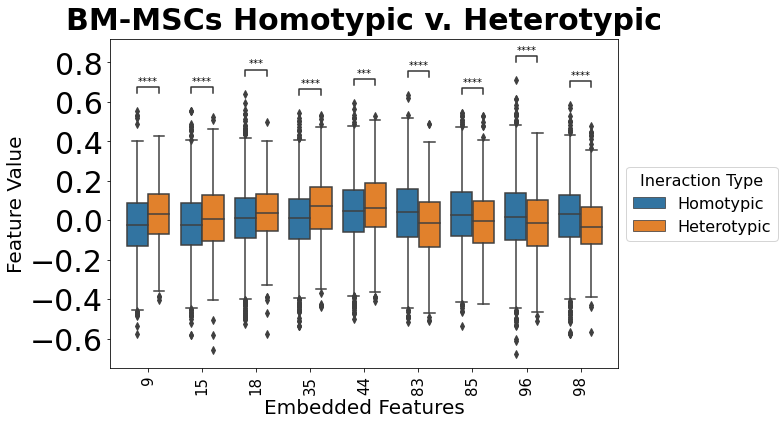

In [98]:
channel_pairs = bm_sub_df["Feature"].unique()
hue = "Interaction Type"
x = "Feature"
gp = bm_sub_df["Feature"].unique()
y = "Value"
hue_order=['Homotypic','Heterotypic']
plt.figure(figsize=(11, 6))
plt.title('BM-MSCs Homotypic v. Heterotypic',fontsize= 30, pad=10, fontweight ="bold")

comparisons = [((p, "Homotypic"),(p, "Heterotypic")) for p in channel_pairs]
box_pairs = comparisons
# box_pairs = []
# for chan in channel_pairs:
#     for c in comparisons:
#         box_pair = ((chan, c[0]), (chan, c[1]))
#         box_pairs.append(box_pair)

g = sns.boxplot(data=bm_sub_df, hue=hue, x=x, y=y)
# locs, labels = plt.xticks()
# plt.setp(labels, rotation=90)

add_stat_annotation(g, data=bm_sub_df, x=x, y=y, hue=hue, box_pairs=box_pairs, comparisons_correction='bonferroni',
                    test='t-test_ind', loc='inside', verbose=2)
g.figure.axes[-1].yaxis.label.set_size(20)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize = 15, rotation=90)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)
g.set_xlabel("Embedded Features",fontsize=20)
g.set_ylabel("Feature Value",fontsize=20)
handles, labels = g.get_legend_handles_labels()
g.legend(handles, labels, title='Ineraction Type', fontsize=16, title_fontsize=16, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
# plt.savefig(r'.\figures\bm homo v hetero interaction embedding.png', bbox_inches="tight")
plt.show()

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

98_Homotypic v.s. 98_Heterotypic: t-test independent samples with Bonferroni correction, P_val=4.340e-08 stat=-5.862e+00
15_Homotypic v.s. 15_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.377e-04 stat=-4.328e+00
9_Homotypic v.s. 9_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.391e-08 stat=-6.050e+00
18_Homotypic v.s. 18_Heterotypic: t-test independent samples with Bonferroni correction, P_val=3.625e-14 stat=-7.876e+00
35_Homotypic v.s. 35_Heterotypic: t-test independent samples with Bonferroni correction, P_val=1.672e-05 stat=-4.773e+00
44_Homotypic v.s. 44_Heterotypic: t-test independent samples with Bonferroni correction, P_val=6.509e-10 stat=-6.528e+00
83_Homotypic v.s. 83_Heterotypic: t-test independent samples with Bonferroni correction, P_val=9.542e-07 stat=-5

C:\Users\zfang38\AppData\Local\Temp\ipykernel_110088\1156191693.py:27: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)


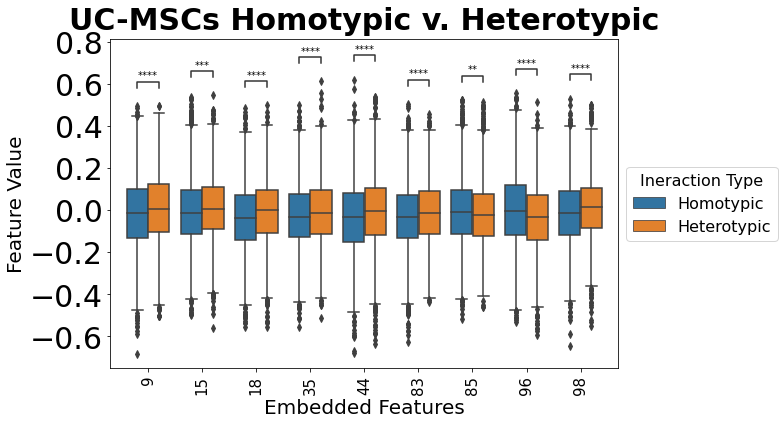

In [99]:
uc_sub_df = embedding_sub_df[embedding_sub_df['Cell Type']=='uc']
channel_pairs = uc_sub_df["Feature"].unique()
hue = "Interaction Type"
x = "Feature"
gp = uc_sub_df["Feature"].unique()
y = "Value"
hue_order=['Homotypic','Heterotypic']
plt.figure(figsize=(11, 6))
plt.title('UC-MSCs Homotypic v. Heterotypic',fontsize= 30, pad=10, fontweight ="bold")

comparisons = [((p, "Homotypic"),(p, "Heterotypic")) for p in channel_pairs]
box_pairs = comparisons
# box_pairs = []
# for chan in channel_pairs:
#     for c in comparisons:
#         box_pair = ((chan, c[0]), (chan, c[1]))
#         box_pairs.append(box_pair)

g = sns.boxplot(data=uc_sub_df, hue=hue, x=x, y=y)
# locs, labels = plt.xticks()
# plt.setp(labels, rotation=90)

add_stat_annotation(g, data=uc_sub_df, x=x, y=y, hue=hue, box_pairs=box_pairs, comparisons_correction='bonferroni',
                    test='t-test_ind', loc='inside', verbose=2)
g.figure.axes[-1].yaxis.label.set_size(20)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize = 15, rotation=90)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize = 30)
g.set_xlabel("Embedded Features",fontsize=20)
g.set_ylabel("Feature Value",fontsize=20)
handles, labels = g.get_legend_handles_labels()
g.legend(handles, labels, title='Ineraction Type', fontsize=16, title_fontsize=16, loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
# plt.savefig(r'.\figures\uc homo v hetero interaction embedding.png', bbox_inches="tight")
plt.show()

## fov visuals

In [106]:
in_dir = r'Y:\coskun-lab\Zhou\4_HCR\20220211_MSC_hydrogel\00_analysis\spagnn\cell_df'
cell_l = os.listdir(in_dir)
cell_l.sort()

In [107]:
embedding

,1,2,3,4,5,6,7,8,9,10,...,96,97,98,99,100,row,col,z,cluster,cellID
bm_001_01_0,0.133491,0.049819,-0.216774,0.015934,-0.083404,0.150778,0.288539,0.058014,-0.011838,0.066314,...,0.251209,0.047553,0.160021,0.113359,0.050917,167.983607,580.934426,13.459016,0,bm_001_01
bm_001_01_1,-0.175297,0.057750,-0.045509,0.187772,-0.073505,-0.048532,0.123248,-0.066662,0.321819,-0.226296,...,0.356954,-0.061827,-0.047485,0.196687,-0.118396,219.658333,492.091667,16.541667,5,bm_001_01
bm_001_01_2,-0.094484,-0.035670,-0.064323,0.000226,-0.140458,0.104816,0.068818,0.140446,-0.051742,0.002350,...,0.118130,-0.097594,-0.044369,0.038023,0.057828,137.956522,548.521739,13.391304,1,bm_001_01
bm_001_01_3,-0.211751,-0.005190,-0.031677,0.066307,-0.111203,-0.012707,0.027698,0.088333,0.122412,-0.158073,...,0.114330,-0.030061,-0.007405,0.253388,-0.006455,176.945455,526.390909,10.318182,9,bm_001_01
bm_001_01_4,0.102304,0.059926,-0.180779,0.010392,-0.101629,0.113652,0.209493,0.034273,-0.047150,0.045001,...,0.225894,-0.016591,0.116273,0.069692,0.089192,148.495413,575.954128,14.669725,0,bm_001_01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
uc_047_05_46,-0.259811,-0.167347,0.103615,-0.202420,-0.195573,-0.049169,-0.301129,0.228135,0.059822,-0.144613,...,-0.035543,-0.266260,-0.111388,0.056950,-0.147607,1724.725000,472.520000,12.935000,2,uc_047_05
uc_047_05_47,0.154123,-0.178316,-0.122551,-0.015987,-0.124164,-0.068107,-0.020095,-0.171674,0.093814,-0.010315,...,0.049071,0.154365,-0.063477,-0.249080,-0.277742,1602.498728,531.333333,9.824427,8,uc_047_05
uc_047_05_48,0.124094,0.152764,0.031000,-0.089696,-0.358432,-0.169728,0.326231,0.135734,-0.333806,-0.057691,...,-0.095819,-0.056547,-0.126515,0.011176,0.158422,1488.423280,691.671958,10.142857,6,uc_047_05
uc_047_05_49,0.066837,-0.056448,0.023526,0.046105,-0.232864,0.119689,0.166379,0.157568,0.230702,0.079585,...,0.008037,-0.108842,0.060741,-0.070457,-0.087670,1857.138365,673.716981,10.062893,0,uc_047_05


In [108]:
cells = ['bm_032_01', 'bm_032_02', 'bm_032_03', 'bm_032_04', 'bm_032_05']

In [111]:
embedding[embedding['cellID'].isin(cells)]

,1,2,3,4,5,6,7,8,9,10,...,96,97,98,99,100,row,col,z,cluster,cellID
bm_032_01_0,0.106769,0.028200,0.313281,0.157262,-0.174679,0.320703,-0.008626,0.032498,0.171116,0.005105,...,-0.142639,-0.069553,0.155215,0.005030,0.157762,126.613913,674.504348,11.704348,2,bm_032_01
bm_032_01_1,-0.087849,0.055692,0.155943,0.193985,-0.010394,0.073696,0.115671,0.153525,0.153316,-0.097010,...,-0.127679,0.052624,-0.015441,0.086046,0.128131,131.188645,576.450549,14.130037,10,bm_032_01
bm_032_01_2,0.073275,0.016030,0.259415,-0.119912,-0.182161,0.245389,0.280359,0.157760,0.041996,0.133606,...,-0.137203,0.129548,-0.066417,0.078843,0.020799,137.842505,400.749526,12.908918,9,bm_032_01
bm_032_01_3,0.065072,0.107241,0.226640,0.127703,-0.133342,0.200036,0.061981,0.140928,0.124145,-0.021405,...,-0.081242,0.066818,0.278624,-0.006498,0.121111,185.687747,685.122530,16.531621,2,bm_032_01
bm_032_01_4,0.153882,0.015321,0.258059,-0.027696,-0.242920,0.185854,0.191384,0.127563,0.151852,0.173092,...,-0.146501,0.041276,-0.107040,-0.018516,0.051889,108.746535,439.611881,11.702970,0,bm_032_01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
bm_032_05_37,-0.280072,0.057580,0.112852,0.057646,-0.311553,0.181778,-0.116677,-0.136532,0.239310,-0.107294,...,-0.077202,-0.287228,0.013667,-0.086823,0.197104,667.147541,935.532787,9.573770,0,bm_032_05
bm_032_05_38,0.033337,-0.044478,-0.179834,-0.123807,-0.025843,-0.069567,-0.220611,-0.001728,0.129871,0.031834,...,-0.168276,-0.057152,-0.165908,0.014350,-0.219183,589.318966,788.698276,13.629310,6,bm_032_05
bm_032_05_39,-0.140114,0.031432,0.023782,0.022720,0.024450,0.123321,-0.163012,0.097082,0.160226,0.017470,...,-0.076364,-0.214787,0.105438,0.097302,0.198166,753.543860,959.859649,8.333333,3,bm_032_05
bm_032_05_40,0.022850,-0.015984,-0.127569,-0.021671,-0.000049,-0.072124,-0.243904,0.014733,0.139220,-0.055733,...,-0.122511,0.050272,-0.134760,0.052482,-0.252376,551.525253,757.020202,10.474747,0,bm_032_05


In [112]:
embedding_by_cell = embedding.groupby('cellID')

In [121]:
def plot_embedding_color(fov,cells,out_dir=None,feature='5'):
    cells_embedding = embedding[embedding['cellID'].isin(cells)]
    patch_row = cells_embedding['row'].tolist()
    patch_col = cells_embedding['col'].tolist()
    patch_z = cells_embedding['z'].tolist()
    patch_id = cells_embedding.index.tolist()
    fov_patch_df = pd.DataFrame({'row':patch_row,'col':patch_col,'z':patch_z},index=patch_id)
    vor = Voronoi(fov_patch_df[['row','col']].values.astype('float'))
    boarder_patch = []
    for i in range(vor.ridge_points.shape[0]):
        patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
        temp = patch1.split('_')
        cell1 = temp[0]+'_'+temp[1]+'_'+temp[2]
        patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
        temp = patch2.split('_')
        cell2 = temp[0]+'_'+temp[1]+'_'+temp[2]
        if cell1 != cell2:
            if not patch1 in boarder_patch:
                boarder_patch.append(patch1)
            if not patch2 in boarder_patch:
                boarder_patch.append(patch2)
    with plt.rc_context({'text.color': 'white', 'axes.labelcolor': 'white', 'xtick.color': 'white', 'ytick.color': 'white'}):
        fig = plt.figure(figsize=(10,10))
        ax = fig.add_subplot(projection='3d')
        fig.set_facecolor('black')
        ax.set_facecolor('black')
        ax.w_xaxis.pane.fill = False
        ax.w_yaxis.pane.fill = False
        ax.w_zaxis.pane.fill = False
        ax.invert_zaxis()

        for cell in cells:
            sub_group = embedding_by_cell.get_group(cell)
            color = sub_group[feature].tolist()
            ax.scatter(sub_group['row']*scale,sub_group['col']*scale,sub_group['z']*z_scale,s=200,c=color,cmap='vlag',vmin=-0.4,vmax=0.4,label=cell)
        
        for i in range(vor.ridge_points.shape[0]):
            patch1 = fov_patch_df.index[vor.ridge_points[i][0]]
            patch2 = fov_patch_df.index[vor.ridge_points[i][1]]
            cell1 = patch1.split('_')[0]+'_'+patch1.split('_')[1]+'_'+patch1.split('_')[2]
            cell2 = patch2.split('_')[0]+'_'+patch2.split('_')[1]+'_'+patch2.split('_')[2]
            if not cell1 == cell2:
                cell1_idx = count_adata.obs['cell_id'].tolist().index(cell1)
                cell2_idx = count_adata.obs['cell_id'].tolist().index(cell2)
                if int(count_adata.obs['leiden'][cell1_idx]) == int(count_adata.obs['leiden'][cell2_idx]):
                    color = 'y'
                else:
                    color = 'r'
                ax.plot(fov_patch_df.iloc[vor.ridge_points[i]]['row']*scale,
                        fov_patch_df.iloc[vor.ridge_points[i]]['col']*scale,
                        fov_patch_df.iloc[vor.ridge_points[i]]['z']*z_scale,color=color)
        
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_zticklabels([])

        ax.view_init(-100, 100)
        plt.tight_layout()
        if not out_dir is None:
            plt.savefig(os.path.join(out_dir,fov+'_'+'feature'+str(feature)+'.png'),dpi=300)
        plt.show()

In [122]:
cells

['bm_032_01', 'bm_032_02', 'bm_032_03', 'bm_032_04', 'bm_032_05']

C:\Users\zfang38\AppData\Local\Temp\ipykernel_183496\2289307712.py:58: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


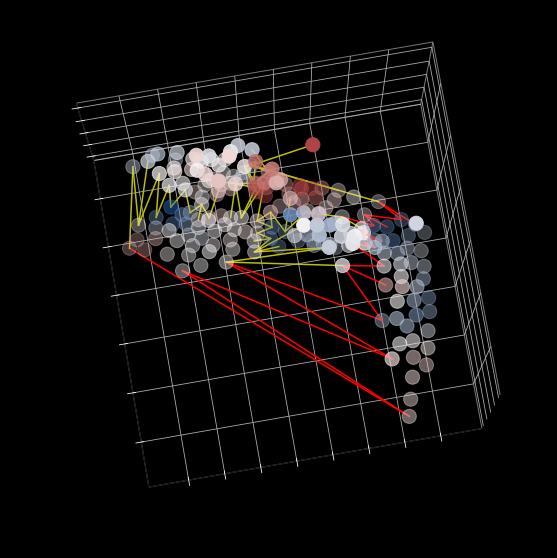

In [124]:
plot_embedding_color(fov='bm_032',cells=cells,out_dir=r'.\figures',feature='5')

C:\Users\zfang38\AppData\Local\Temp\ipykernel_183496\2289307712.py:58: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


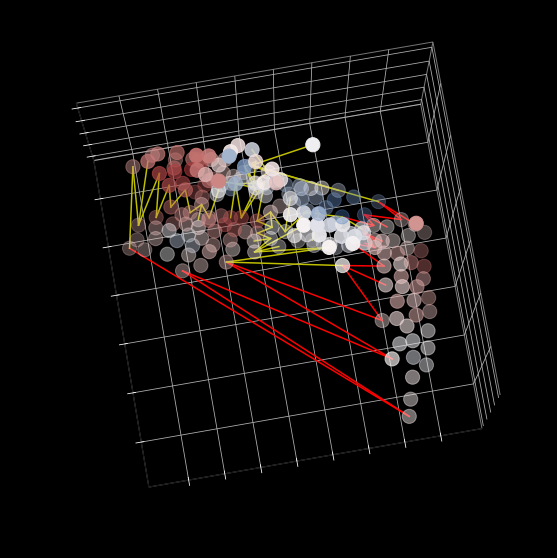

C:\Users\zfang38\AppData\Local\Temp\ipykernel_183496\2289307712.py:58: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


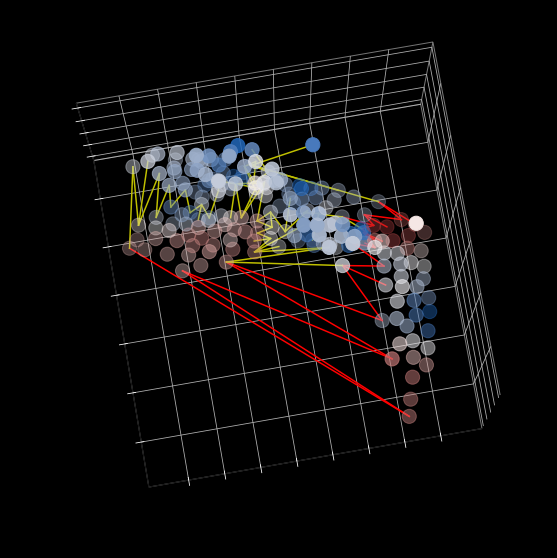

C:\Users\zfang38\AppData\Local\Temp\ipykernel_183496\2289307712.py:58: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


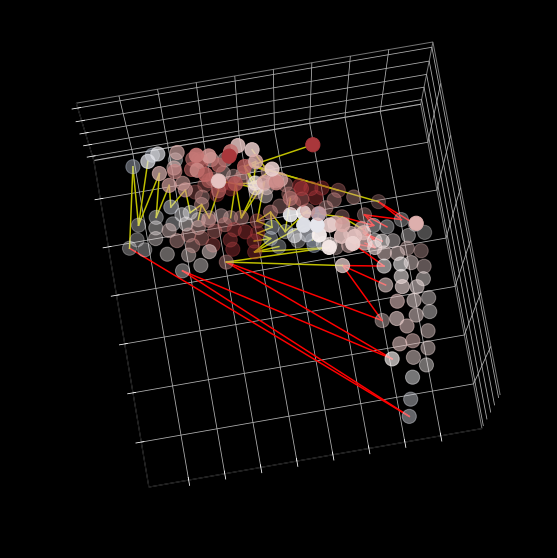

C:\Users\zfang38\AppData\Local\Temp\ipykernel_183496\2289307712.py:58: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


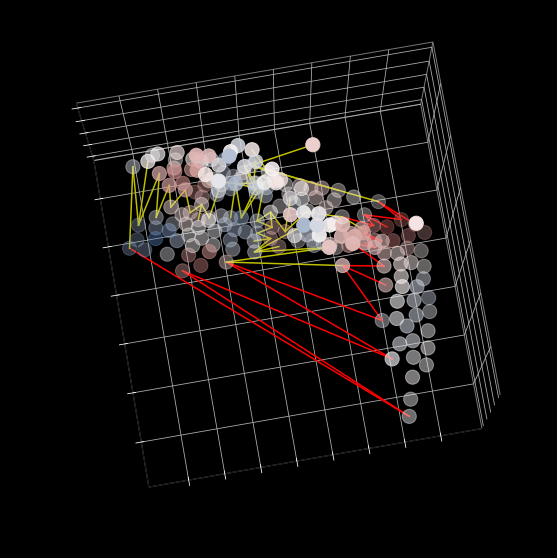

C:\Users\zfang38\AppData\Local\Temp\ipykernel_183496\2289307712.py:58: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


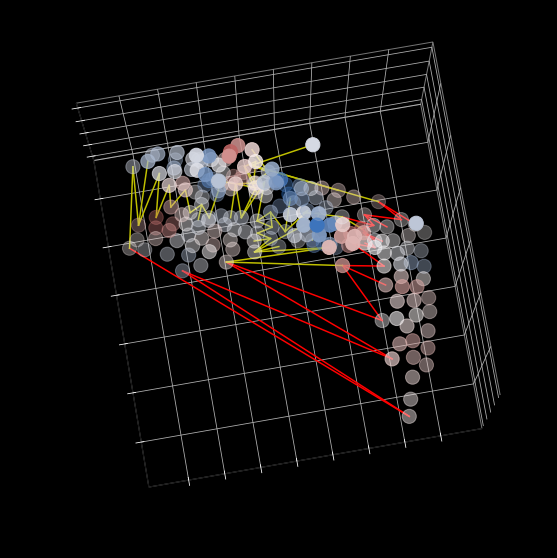

C:\Users\zfang38\AppData\Local\Temp\ipykernel_183496\2289307712.py:58: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


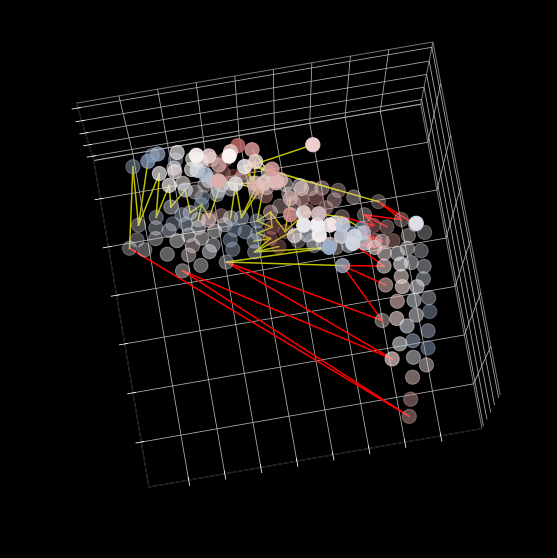

C:\Users\zfang38\AppData\Local\Temp\ipykernel_183496\2289307712.py:58: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


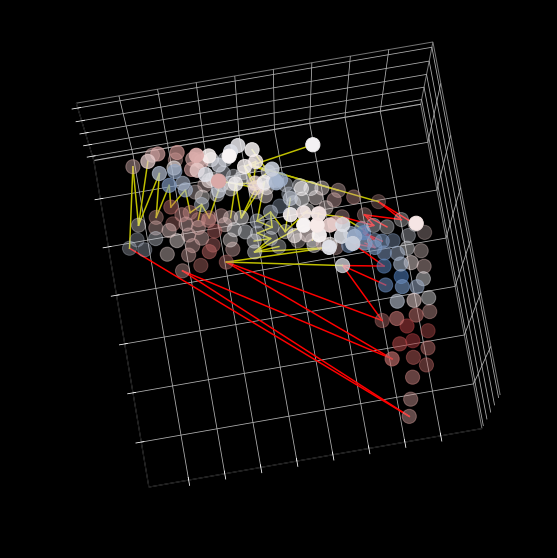

C:\Users\zfang38\AppData\Local\Temp\ipykernel_183496\2289307712.py:58: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


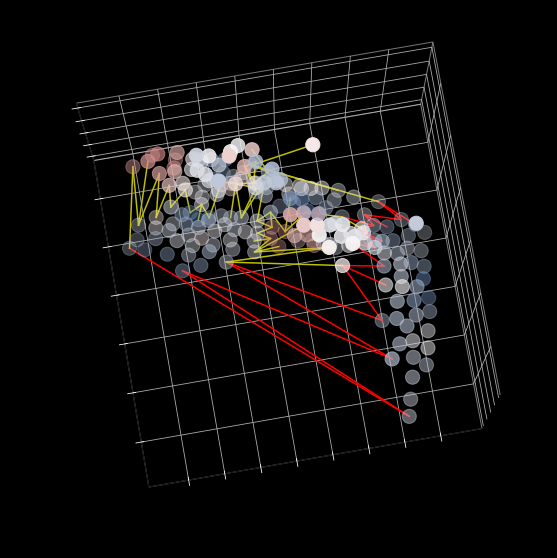

C:\Users\zfang38\AppData\Local\Temp\ipykernel_183496\2289307712.py:58: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


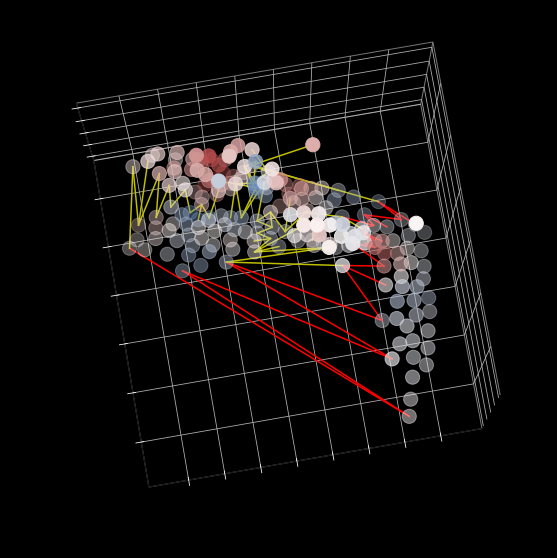

In [125]:
for item in significant_features:
    plot_embedding_color(fov='bm_032',cells=cells,out_dir=r'.\figures',feature=item)

## border patch embedding clustering

In [100]:
embedding

,1,2,3,4,5,6,7,8,9,10,...,96,97,98,99,100,row,col,z,cluster,cellID
bm_001_01_0,0.133491,0.049819,-0.216774,0.015934,-0.083404,0.150778,0.288539,0.058014,-0.011838,0.066314,...,0.251209,0.047553,0.160021,0.113359,0.050917,167.983607,580.934426,13.459016,0,bm_001_01
bm_001_01_1,-0.175297,0.057750,-0.045509,0.187772,-0.073505,-0.048532,0.123248,-0.066662,0.321819,-0.226296,...,0.356954,-0.061827,-0.047485,0.196687,-0.118396,219.658333,492.091667,16.541667,5,bm_001_01
bm_001_01_2,-0.094484,-0.035670,-0.064323,0.000226,-0.140458,0.104816,0.068818,0.140446,-0.051742,0.002350,...,0.118130,-0.097594,-0.044369,0.038023,0.057828,137.956522,548.521739,13.391304,1,bm_001_01
bm_001_01_3,-0.211751,-0.005190,-0.031677,0.066307,-0.111203,-0.012707,0.027698,0.088333,0.122412,-0.158073,...,0.114330,-0.030061,-0.007405,0.253388,-0.006455,176.945455,526.390909,10.318182,9,bm_001_01
bm_001_01_4,0.102304,0.059926,-0.180779,0.010392,-0.101629,0.113652,0.209493,0.034273,-0.047150,0.045001,...,0.225894,-0.016591,0.116273,0.069692,0.089192,148.495413,575.954128,14.669725,0,bm_001_01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
uc_047_05_46,-0.259811,-0.167347,0.103615,-0.202420,-0.195573,-0.049169,-0.301129,0.228135,0.059822,-0.144613,...,-0.035543,-0.266260,-0.111388,0.056950,-0.147607,1724.725000,472.520000,12.935000,2,uc_047_05
uc_047_05_47,0.154123,-0.178316,-0.122551,-0.015987,-0.124164,-0.068107,-0.020095,-0.171674,0.093814,-0.010315,...,0.049071,0.154365,-0.063477,-0.249080,-0.277742,1602.498728,531.333333,9.824427,8,uc_047_05
uc_047_05_48,0.124094,0.152764,0.031000,-0.089696,-0.358432,-0.169728,0.326231,0.135734,-0.333806,-0.057691,...,-0.095819,-0.056547,-0.126515,0.011176,0.158422,1488.423280,691.671958,10.142857,6,uc_047_05
uc_047_05_49,0.066837,-0.056448,0.023526,0.046105,-0.232864,0.119689,0.166379,0.157568,0.230702,0.079585,...,0.008037,-0.108842,0.060741,-0.070457,-0.087670,1857.138365,673.716981,10.062893,0,uc_047_05


In [101]:
patch_type = [''] * len(embedding)
for i in range(len(embedding)):
    item = embedding.index.tolist()[i]
    if item in unique_bm_homotypic:
        patch_type[i] = 'bm_homotypic'
    elif item in unique_bm_heterotypic:
        patch_type[i] = 'bm_heterotypic'
    elif item in unique_uc_homotypic:
        patch_type[i] = 'uc_homotypic'
    elif item in unique_uc_heterotypic:
        patch_type[i] = 'uc_heterotypic'
    else:
        patch_type[i] = 'unknown'
embedding['patch_type'] = patch_type

In [102]:
bm_homotypic_embedding = embedding[embedding['patch_type']=='bm_homotypic']
bm_heterotypic_embedding = embedding[embedding['patch_type']=='bm_heterotypic']
uc_homotypic_embedding = embedding[embedding['patch_type']=='uc_homotypic']
uc_heterotypic_embedding = embedding[embedding['patch_type']=='uc_heterotypic']
print("Analyzing "+str(len(bm_homotypic_embedding))+" bm homotypic patches")
print("Analyzing "+str(len(bm_heterotypic_embedding))+" bm heterotypic patches")
print("Analyzing "+str(len(uc_homotypic_embedding))+" uc homotypic patches")
print("Analyzing "+str(len(uc_heterotypic_embedding))+" uc heterotypic patches")

Analyzing 3654 bm homotypic patches
Analyzing 607 bm heterotypic patches
Analyzing 3213 uc homotypic patches
Analyzing 2137 uc heterotypic patches


In [103]:
x1 = bm_homotypic_embedding.values[:,:100].astype('float')
x2 = bm_heterotypic_embedding.values[:,:100].astype('float')
x = np.concatenate((x1,x2),axis=0)
bm_border_adata = sc.AnnData(x)
bm_border_adata.var_names = embedding.columns[:100].tolist()
bm_border_adata.obs['patch_id'] = bm_homotypic_embedding.index.tolist() + bm_heterotypic_embedding.index.tolist()
bm_border_adata.obs['patch_type'] = pd.Categorical(['bm_homotypic']*len(bm_homotypic_embedding) + ['bm_heterotypic']*len(bm_heterotypic_embedding), categories=['bm_homotypic','bm_heterotypic'])
bm_border_adata.uns['patch_type_colors'] = ['#1f77b4', '#ff7f0e']

In [104]:
sc.pp.neighbors(bm_border_adata, n_neighbors=15)

         Falling back to preprocessing with `sc.pp.pca` and default params.


c:\Users\zfang38\Anaconda3\envs\skim\lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\zfang38\Anaconda3\envs\skim\lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\zfang38\Anaconda3\envs\skim\lib\site-packages\umap\distances.py:1086: NumbaDepr

In [105]:
sc.tl.umap(bm_border_adata)
sc.tl.tsne(bm_border_adata)

c:\Users\zfang38\Anaconda3\envs\skim\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


In [106]:
sc.tl.leiden(bm_border_adata,resolution=1.0)

In [108]:
with rc_context({'figure.figsize': (6, 5)}):
    sc.pl.umap(bm_border_adata, color='leiden')

NameError: name 'rc_contect' is not defined

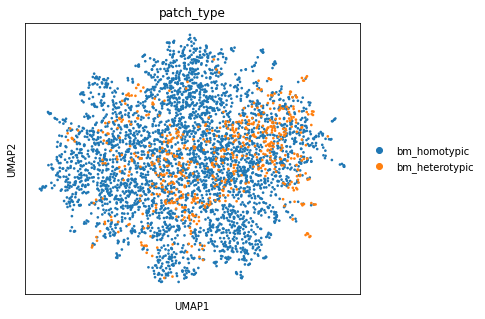

In [145]:
with rc_context({'figure.figsize': (6, 5)}):
    sc.pl.umap(bm_border_adata, color='patch_type', save='_bm_border_patch_type.png')

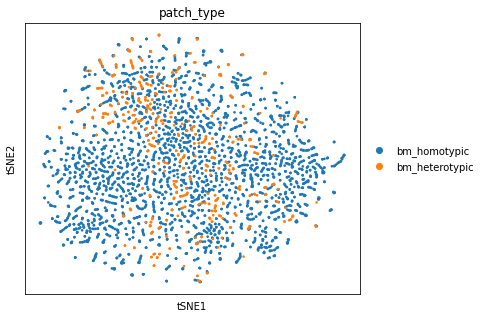

In [146]:
with rc_context({'figure.figsize': (6, 5)}):
    sc.pl.tsne(bm_border_adata, color='patch_type', save='_bm_border_patch_type.png')

## uc homo v. heterotypic patches

In [147]:
x1 = uc_homotypic_embedding.values[:,:100].astype('float')
x2 = uc_heterotypic_embedding.values[:,:100].astype('float')
x = np.concatenate((x1,x2),axis=0)
uc_border_adata = sc.AnnData(x)
uc_border_adata.var_names = embedding.columns[:100].tolist()
uc_border_adata.obs['patch_id'] = uc_homotypic_embedding.index.tolist() + uc_heterotypic_embedding.index.tolist()
uc_border_adata.obs['patch_type'] = pd.Categorical(['uc_homotypic']*len(uc_homotypic_embedding) + ['uc_heterotypic']*len(uc_heterotypic_embedding), categories=['uc_homotypic','uc_heterotypic'])
uc_border_adata.uns['patch_type_colors'] = ['#1f77b4', '#ff7f0e']

In [148]:
sc.pp.neighbors(uc_border_adata, n_neighbors=15)

         Falling back to preprocessing with `sc.pp.pca` and default params.


In [150]:
sc.tl.umap(uc_border_adata)
sc.tl.tsne(uc_border_adata)

c:\Users\zfang38\Anaconda3\envs\skim\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


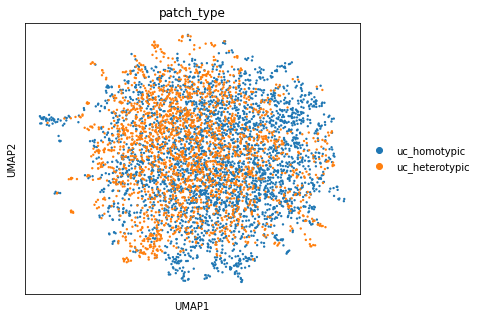

In [151]:
with rc_context({'figure.figsize': (6, 5)}):
    sc.pl.umap(uc_border_adata, color='patch_type', save='_uc_border_patch_type.png')

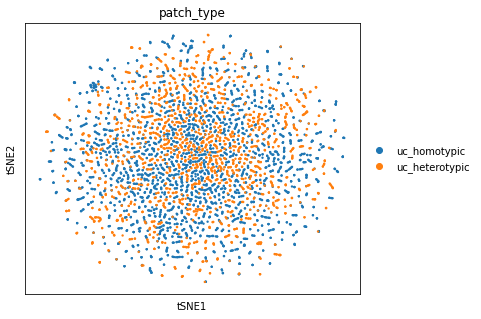

In [152]:
with rc_context({'figure.figsize': (6, 5)}):
    sc.pl.tsne(uc_border_adata, color='patch_type', save='_uc_border_patch_type.png')

## all bm_patches

In [154]:
cell_type = [''] * len(embedding)
for i,item in enumerate(embedding.index.tolist()):
    cell_type[i] = item.split('_')[0]
embedding['cell_type'] = cell_type

In [155]:
bm_patches = embedding[embedding['cell_type']=='bm']

In [156]:
bm_patches

,1,2,3,4,5,6,7,8,9,10,...,98,99,100,row,col,z,cluster,cellID,patch_type,cell_type
bm_001_01_0,0.133491,0.049819,-0.216774,0.015934,-0.083404,0.150778,0.288539,0.058014,-0.011838,0.066314,...,0.160021,0.113359,0.050917,167.983607,580.934426,13.459016,0,bm_001_01,bm_heterotypic,bm
bm_001_01_1,-0.175297,0.057750,-0.045509,0.187772,-0.073505,-0.048532,0.123248,-0.066662,0.321819,-0.226296,...,-0.047485,0.196687,-0.118396,219.658333,492.091667,16.541667,5,bm_001_01,bm_homotypic,bm
bm_001_01_2,-0.094484,-0.035670,-0.064323,0.000226,-0.140458,0.104816,0.068818,0.140446,-0.051742,0.002350,...,-0.044369,0.038023,0.057828,137.956522,548.521739,13.391304,1,bm_001_01,unknown,bm
bm_001_01_3,-0.211751,-0.005190,-0.031677,0.066307,-0.111203,-0.012707,0.027698,0.088333,0.122412,-0.158073,...,-0.007405,0.253388,-0.006455,176.945455,526.390909,10.318182,9,bm_001_01,unknown,bm
bm_001_01_4,0.102304,0.059926,-0.180779,0.010392,-0.101629,0.113652,0.209493,0.034273,-0.047150,0.045001,...,0.116273,0.069692,0.089192,148.495413,575.954128,14.669725,0,bm_001_01,bm_heterotypic,bm
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
bm_036_07_28,-0.249102,0.072819,0.203188,-0.030839,-0.130536,-0.070499,0.155868,0.017088,0.138753,-0.290976,...,0.033441,0.360811,-0.071805,1630.260870,640.884058,8.478261,3,bm_036_07,bm_homotypic,bm
bm_036_07_29,-0.165697,-0.064496,0.198438,-0.236976,-0.221648,-0.180551,0.348818,0.124119,-0.271193,-0.249264,...,-0.098195,0.083400,0.038266,1700.473684,621.719298,5.859649,0,bm_036_07,unknown,bm
bm_036_07_30,-0.065612,-0.013619,0.065116,-0.075079,-0.277845,-0.150946,0.189072,0.010386,0.224701,-0.283225,...,-0.205095,-0.333183,-0.005985,1809.428571,636.678571,18.107143,3,bm_036_07,bm_homotypic,bm
bm_036_07_31,-0.127702,-0.046377,0.112236,-0.184449,-0.085134,-0.089213,0.228920,0.044887,-0.137886,-0.189816,...,0.001910,0.261794,0.031104,1673.521739,654.391304,5.260870,3,bm_036_07,bm_homotypic,bm


In [173]:
bm_allpatch_adata = sc.AnnData(bm_patches.values[:,:100].astype('float'))
bm_allpatch_adata.var_names = embedding.columns[:100].tolist()
bm_allpatch_adata.obs['patch_id'] = bm_patches.index.tolist()
bm_allpatch_adata.obs['patch_type'] = pd.Categorical(bm_patches['patch_type'].tolist(), categories=['bm_homotypic','bm_heterotypic','unknown'])
bm_allpatch_adata.uns['patch_type_colors'] = ['#1f77b4', '#ff7f0e', '#7f7f7f']

In [174]:
sc.pp.neighbors(bm_allpatch_adata, n_neighbors=15)

         Falling back to preprocessing with `sc.pp.pca` and default params.


In [175]:
sc.tl.umap(bm_allpatch_adata)
sc.tl.tsne(bm_allpatch_adata)

c:\Users\zfang38\Anaconda3\envs\skim\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


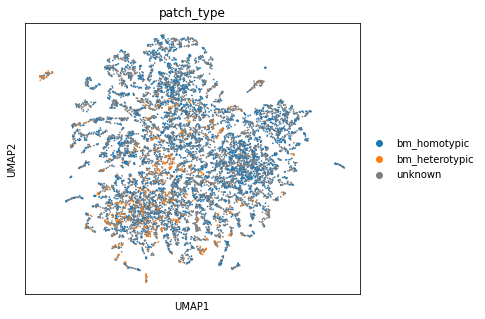

In [176]:
with rc_context({'figure.figsize': (6, 5)}):
    sc.pl.umap(bm_allpatch_adata, color='patch_type', save='_bm_all_patch_type.png')

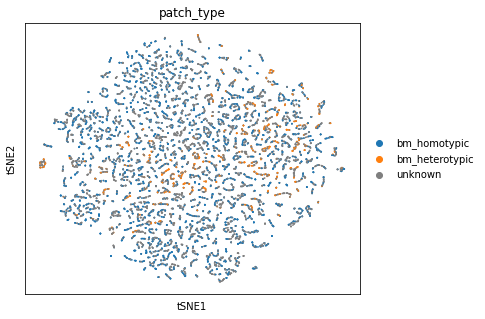

In [177]:
with rc_context({'figure.figsize': (6, 5)}):
    sc.pl.tsne(bm_allpatch_adata, color='patch_type', save='_bm_all_patch_type.png')

In [184]:
sc.tl.pca(bm_allpatch_adata)

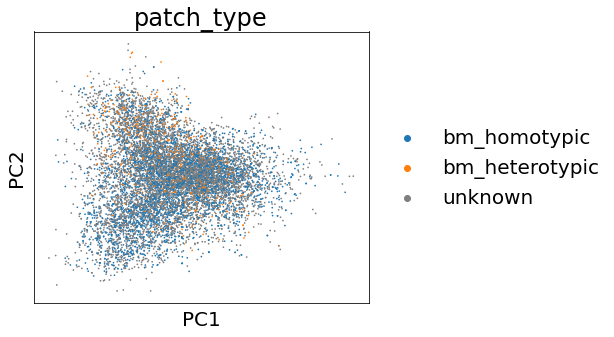

In [212]:
with rc_context({'figure.figsize': (6, 5), 'font.size': 20}):
    sc.pl.pca(bm_allpatch_adata, color='patch_type', save='_bm_all_patch_type.png')

In [188]:
bm_allpatch_adata.obsm['X_pca'].shape

(10377, 50)

### Distance to pc1 and pc2 mean

In [191]:
pc_df = pd.DataFrame(bm_allpatch_adata.obsm['X_pca'][:,:10],
                     index=bm_allpatch_adata.obs['patch_id'].tolist(),
                     columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8','PC9','PC10'])
pc_df['patch_type'] = bm_allpatch_adata.obs['patch_type'].tolist()

In [193]:
border_patch = pc_df[pc_df['patch_type']!='unknown']

In [204]:
border_pc = border_patch.values[:,:2].astype('float')
center_pc = np.mean(pc_df.values[:,:2].astype('float'),axis=0)
distance = np.sqrt(np.sum((border_pc - center_pc)**2,axis=1))

In [209]:
x = [1] * len(distance)
for i in range(len(distance)):
    if 'heterotypic' in border_patch.iloc[i]['patch_type']:
        x[i] = 2

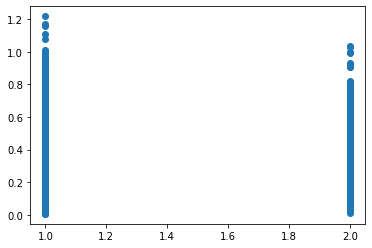

In [210]:
plt.scatter(x,distance)

## uc all patches

In [178]:
uc_patches = embedding[embedding['cell_type']=='uc']

In [179]:
uc_allpatch_adata = sc.AnnData(uc_patches.values[:,:100].astype('float'))
uc_allpatch_adata.var_names = embedding.columns[:100].tolist()
uc_allpatch_adata.obs['patch_id'] = uc_patches.index.tolist()
uc_allpatch_adata.obs['patch_type'] = pd.Categorical(uc_patches['patch_type'].tolist(), categories=['uc_homotypic','uc_heterotypic','unknown'])
uc_allpatch_adata.uns['patch_type_colors'] = ['#1f77b4', '#ff7f0e', '#7f7f7f']

In [180]:
sc.pp.neighbors(uc_allpatch_adata, n_neighbors=15)

         Falling back to preprocessing with `sc.pp.pca` and default params.


In [181]:
sc.tl.umap(uc_allpatch_adata)
sc.tl.tsne(uc_allpatch_adata)

c:\Users\zfang38\Anaconda3\envs\skim\lib\site-packages\sklearn\manifold\_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


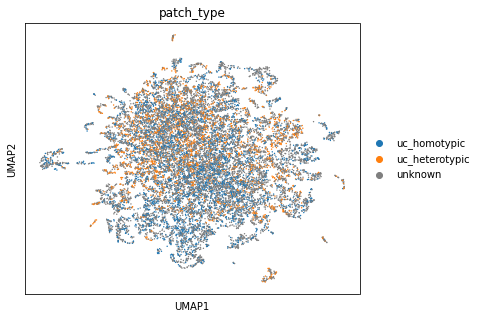

In [182]:
with rc_context({'figure.figsize': (6, 5)}):
    sc.pl.umap(uc_allpatch_adata, color='patch_type', save='_uc_all_patch_type.png')

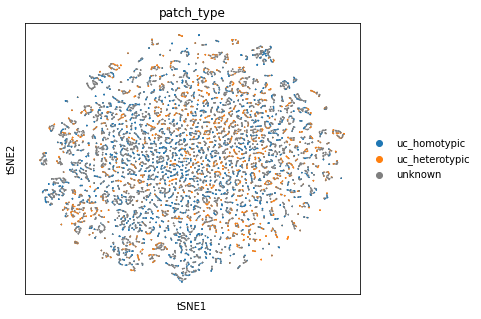

In [183]:
with rc_context({'figure.figsize': (6, 5)}):
    sc.pl.tsne(uc_allpatch_adata, color='patch_type', save='_uc_all_patch_type.png')